In [1]:
# Get the data for expeirment
import sklearn
import pandas as pd 
import numpy as np
import time

from sklearn import tree
from sklearn.metrics import r2_score
from sklearn.preprocessing import StandardScaler
from sklearn import preprocessing
from sklearn.metrics import explained_variance_score, mean_squared_error
from scipy.spatial.distance import cdist
from numpy.linalg import pinv
from math import sqrt

from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.neural_network import MLPRegressor
from sklearn.model_selection import KFold
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import geopy.distance as distance
from sklearn.preprocessing import MinMaxScaler
from scikeras.wrappers import KerasRegressor

import Data_utils
import matplotlib.ticker as ticker
from functools import reduce
from collections import Counter

In [2]:
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
from tensorflow.keras import datasets, layers, models, losses

print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  1


In [5]:
# Experiment results for all 6 features (precip is removed)

In [4]:
train_data = pd.read_csv('Data/processed_ab_no_precp_with_season_train.csv')
test_data = pd.read_csv('Data/processed_ab_no_precp_with_season_test.csv')

C:\Users\PPL\AppData\Local\Temp\ipykernel_31032\705027037.py:1: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  train_data = pd.read_csv('Data/processed_ab_no_precp_with_season_train.csv')
C:\Users\PPL\AppData\Local\Temp\ipykernel_31032\705027037.py:2: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  test_data = pd.read_csv('Data/processed_ab_no_precp_with_season_test.csv')


In [5]:
# Source: From the TSmodel
def preprocess_data(train, validation):
    scaler = StandardScaler()
    train_data = scaler.fit_transform(train)
    validation_data = scaler.transform(validation)
    
    return train_data, validation_data

In [6]:
def fcm_rule_model(train_x, train_y, validation_x, validation_y):
    start_time = time.time()

    # Fcm hyperparameters
    FCM_Nc = 30
    FCM_m = 2
    #tol = 1e-10
    max_iter = 200
        
    N = train_x.shape[0]
    U = np.random.rand(N, FCM_Nc)
    U = U / np.sum(U, axis=1, keepdims=True)
    qs = []

    # Fuzzy C-Means 聚类
    for _ in range(max_iter):
        U_old = U.copy()
        mf = U ** FCM_m
        cen = np.dot(mf.T, train_x) / np.sum(mf, axis=0, keepdims=True).T
        dists = cdist(train_x, cen)
        tmp = np.power(dists, -2 / (FCM_m - 1))
        U = tmp / np.sum(tmp, axis=1, keepdims=True)

        q = np.sum((U ** FCM_m) * (dists ** 2))
        qs.append(q)

        # 检查是否收敛
#         if np.linalg.norm(U - U_old) < tol:
#             break
    # 模型训练 find if this can be optimized
    z = np.hstack((np.ones((N, 1)), train_x))
    H = np.zeros((N, FCM_Nc * (train_x.shape[1] + 1)))

    # 生成模糊规则矩阵 H
    for j in range(FCM_Nc):
        Uj = np.tile(U[:, j], (train_x.shape[1] + 1, 1)).T
        H[:, (j * (train_x.shape[1] + 1)):((j + 1) * (train_x.shape[1] + 1))] = Uj * z

    # 计算权重 W
    W = pinv(np.dot(H.T, H)).dot(H.T).dot(train_y)

    time_used = time.time() - start_time
    # 在训练集上进行预测
    y_hat_train = np.dot(H, W)
    mse_train = mean_squared_error(train_y, y_hat_train)
    rmse_train = sqrt(mean_squared_error(train_y, y_hat_train))
    print("FCM traning RMSE:", rmse_train)
    
    # validation
    N_validation = validation_x.shape[0]
    z_validation = np.hstack((np.ones((N_validation, 1)), validation_x))
    H_validation = np.zeros((N_validation, FCM_Nc * (validation_x.shape[1] + 1)))
    dists_validation = cdist(validation_x, cen)
    tmp_validation = np.power(dists_validation, -2 / (FCM_m - 1))
    U_validation = tmp_validation / np.sum(tmp_validation, axis=1, keepdims=True)

    # 生成模糊规则矩阵 H_test
    for j in range(FCM_Nc):
        Uj_validation = np.tile(U_validation[:, j], (validation_x.shape[1] + 1, 1)).T
        H_validation[:, (j * (validation_x.shape[1] + 1)):((j + 1) * (validation_x.shape[1] + 1))] = Uj_validation * z_validation

    # validation set
    y_hat_validation = np.dot(H_validation, W)
    mse_validation = mean_squared_error(validation_y, y_hat_validation)
    rmse_validation = sqrt(mse_validation)
    print("FCM val RMSE:", rmse_validation)
    

    # 模型测试
#     N_test = test_x.shape[0]
#     z_test = np.hstack((np.ones((N_test, 1)), test_x))
#     H_test = np.zeros((N_test, FCM_Nc * (test_x.shape[1] + 1)))
#     dists_test = cdist(test_x, cen)
#     tmp_test = np.power(dists_test, -2 / (FCM_m - 1))
#     U_test = tmp_test / np.sum(tmp_test, axis=1, keepdims=True)

#     # 生成模糊规则矩阵 H_test
#     for j in range(FCM_Nc):
#         Uj_test = np.tile(U_test[:, j], (test_x.shape[1] + 1, 1)).T
#         H_test[:, (j * (test_x.shape[1] + 1)):((j + 1) * (test_x.shape[1] + 1))] = Uj_test * z_test

#     # 在测试集上进行预测
#     y_hat_test = np.dot(H_test, W)
#     mse_test = mean_squared_error(test_y, y_hat_test)
#     rmse_test = sqrt(mean_squared_error(test_y, y_hat_test))
#     print("test MSE:", mse_test)
#     print("test RMSE:", rmse_test)
#     test_results.append({'fcm_test':rmse_test})
    
        
#     print('r2 score')
#     print(r2_score(test_y, y_hat_test))


    # 绘制拟合曲线
#     plt.figure()
#     plt.subplot(1, 2, 1)
#     plt.plot([min(train_y),max(train_y)], [min(train_y),max(train_y)], 'k--')
#     plt.plot(train_y, y_hat_train, 'ro', alpha=.2)
#     plt.title('Training')
#     plt.legend()

#     plt.subplot(1, 2, 2)
#     plt.plot([min(validation_y),max(validation_y)], [min(validation_y),max(validation_y)], 'k--')
#     plt.plot(validation_y, y_hat_validation, 'ro', alpha=.2)
#     plt.title('Testing')
#     plt.legend()
#     plt.show()
    # Plot the prediction vs the true value
    plt.figure(figsize=(8,8))    
    plt.title('TS model prediction vs true value for testing data')
    plt.plot([min(validation_y),max(validation_y)], [min(validation_y),max(validation_y)], 'k--')
    plt.plot(validation_y, y_hat_validation, 'ro', alpha=.2)
    plt.show()
    
    #plt.legend()
    plt.figure(figsize=(8,8))
    plt.title('TS model optimization target Q v.s. iteration')
    plt.plot(qs)
    plt.show()

    return rmse_train, rmse_validation, time_used


In [7]:
def linear_model(train_x, train_y, validation_x, validation_y):
    start_time = time.time()

    reg = LinearRegression().fit(train_x, train_y)
    
    time_used = time.time() - start_time
        
    train_pred = reg.predict(train_x)
    
    validation_pred = reg.predict(validation_x)
    
    print("linear train")
    print(mean_squared_error(train_y, train_pred, squared = False))
    
    print("linear_validation")
    print(mean_squared_error(validation_y, validation_pred, squared = False))
    
    return mean_squared_error(train_y, train_pred, squared = False), mean_squared_error(validation_y, validation_pred, squared = False), time_used

In [8]:
def build_neural_network_model():
    model = models.Sequential()
    model.add(layers.Dense(30, activation=tf.keras.activations.tanh))    
    model.add(layers.Dense(1, activation=tf.keras.activations.relu))    
    
    return model

In [9]:
def neural_network_model(train_x, train_y, validation_x, validation_y):
    start_time = time.time()
    
    neural_network_model = build_neural_network_model()
    
    neural_network_model.compile(
        optimizer='adam',
        loss=tf.keras.losses.MeanSquaredError(),
        metrics=[tf.keras.metrics.RootMeanSquaredError(), KerasRegressor.r_squared]
    )
    
    history = neural_network_model.fit(
        train_x, 
        train_y, 
        epochs=number_of_epochs, 
        validation_data=(validation_x, validation_y)
    )
    
    time_used = time.time() - start_time
    
    return history, np.mean(np.array(history.history['root_mean_squared_error'])), np.mean(np.array(history.history['val_root_mean_squared_error'])), neural_network_model, time_used

In [10]:
# Filter and process the data suitable for the training/testing
def generate_exp_data(raw_data, number_of_stations, max_threshold_distance, min_threshold_distance):
    # First fitler the data based on the settings
    x = []
    y = []

    for station in raw_data['name'].unique():
        features, target = Data_utils.generate_data(
            raw_data, 
            station, 
            number_of_stations, 
            max_threshold_distance, 
            min_threshold_distance,
            features_to_use = ['wind_speed'],
            target_features_to_use=['wind_speed', 'wind_direction']
        )

        if (len(features)!=0) & (len(target)!=0):
            np_features = np.array(features)
            np_target = np.array(target)

            x.append(np_features)
            y.append(np_target)
    
    return x, y

In [11]:
# Save the current experiment result and resume when needed
# Modified from source: https://stackoverflow.com/questions/34342155/how-to-pickle-or-store-jupyter-ipython-notebook-session-for-later

# %store training_results
# %store training_times
# %store test_results
# %store nn_histories

#closing seesion, restarting kernel

# %store -r training_results
# %store -r training_times
# %store -r test_results
# %store -r nn_histories

In [12]:
# hyperparameters for the expeirment
# This experiment is completed until 10 stations

number_of_neighbour_stations = [1,2,3,4,5,6,7,8,9, 10,11,12,13,14, 15,20]
number_of_epochs = 50

# Expeirment related parameters
number_of_folds = 5 # have to be 10 fold
# General hyperparameter
max_threshold_distance = 100000 #km
min_threshold_distance = 0 #km

# Results containers
training_results = []
training_times = []
test_results = []
nn_histories = []

# Determine the optimal value for the given hyperparameter
def do_experiment(hyper_parameter_to_test_values, train_data, test_data):
    kf = KFold(n_splits=number_of_folds, shuffle=True)
    
    for hyperparameter_value in hyper_parameter_to_test_values:
        
        if hyperparameter_value <= 6:
            # Station data is generated already, only need to train the model
            flatten_train_x = pd.read_csv(f"Data/exp/{hyperparameter_value}x.csv", index_col=0).to_numpy()
            flatten_train_y = pd.read_csv(f"Data/exp/{hyperparameter_value}y.csv", index_col=0).to_numpy()
            
            # Test data should still need to be generated
            flatten_test_x = pd.read_csv(f"Data/exp/{hyperparameter_value}x_test.csv", index_col=0).to_numpy()
            flatten_test_y = pd.read_csv(f"Data/exp/{hyperparameter_value}y_test.csv", index_col=0).to_numpy()
            
        else:
            # First fitler the data based on the settings
            train_x, train_y = generate_exp_data(train_data, hyperparameter_value, max_threshold_distance, min_threshold_distance)
            test_x, test_y = generate_exp_data(test_data, hyperparameter_value, max_threshold_distance, min_threshold_distance)

            # After all stations are filtered, flatten the data into a huge list        
            flatten_train_x = np.array([data for sublist in train_x for data in sublist])
            flatten_train_y = np.array([data for sublist in train_y for data in sublist])
            
            flatten_test_x = np.array([data for sublist in test_x for data in sublist])
            flatten_test_y = np.array([data for sublist in test_y for data in sublist])
        
            # Save those computed data
            temp_x = pd.DataFrame(flatten_train_x)
            temp_x.to_csv(f"Data\exp\{hyperparameter_value}x.csv")
            temp_y = pd.DataFrame(flatten_train_y)
            temp_y.to_csv(f"Data\exp\{hyperparameter_value}y.csv")
            
            temp_x = pd.DataFrame(flatten_test_x)
            temp_x.to_csv(f"Data\exp\{hyperparameter_value}x_test.csv")
            temp_y = pd.DataFrame(flatten_test_y)
            temp_y.to_csv(f"Data\exp\{hyperparameter_value}y_test.csv")
 
        
        # After all data are ready, do a 10 fold cross validation
        training_results_fold = []
        training_times_fold = []
        test_results_fold = []
        nn_history_fold = []

        flatten_train_y = flatten_train_y[:,0]
        flatten_test_y = flatten_test_y[:,0]
            
        for i in range(0, number_of_folds):
            flatten_train_x, flatten_train_y = shuffle(flatten_train_x, flatten_train_y)
    
            flatten_train_x = np.asarray(flatten_train_x).astype('float32')
            flatten_train_y = np.asarray(flatten_train_y).astype('float32')
            flatten_test_x = np.asarray(flatten_test_x).astype('float32')
            flatten_test_y = np.asarray(flatten_test_y).astype('float32')
            
            print(f"Currently running fold {i} for {hyperparameter_value} stations")

            # Normalize the input
            flatten_train_x, flatten_test_x = preprocess_data(flatten_train_x, flatten_test_x)            
            # Linear model
            li_train_rmse, li_val_rmse, li_train_time = linear_model(flatten_train_x, flatten_train_y, flatten_test_x , flatten_test_y)
            training_results_fold.append({'linear_train' : li_train_rmse})
            training_times_fold.append({'linear_train' : li_train_time})
            test_results_fold.append({'linear_test' : li_val_rmse})
            
            # FCM model
            fcm_train_rmse, fcm_val_rmse,fcm_train_time = fcm_rule_model(flatten_train_x, flatten_train_y, flatten_test_x , flatten_test_y)
            training_results_fold.append({'fcm_train' : fcm_train_rmse})
            training_times_fold.append({'fcm_train' : fcm_train_time})
            test_results_fold.append({'fcm_test' : fcm_val_rmse})
            
            # NN
            nn_history, nn_train_rmse, nn_val_rmse, nn_model, nn_train_time = neural_network_model(flatten_train_x, flatten_train_y, flatten_test_x , flatten_test_y)
            
            nn_test_prediction = nn_model.predict(flatten_test_x)
            # Plot the prediction vs the true value for neural network
            plt.figure(figsize=(8,8))    
            plt.plot([min(flatten_test_y),max(flatten_test_y)], [min(flatten_test_y),max(flatten_test_y)], 'k--')
            plt.plot(flatten_test_y, nn_test_prediction, 'ro', alpha=.2)
            plt.title('Neural network prediction vs true value for test data')
            # Record results
            nn_history_fold.append(nn_history.history)
            training_results_fold.append({'nn_train' : nn_train_rmse})
            training_times_fold.append({'nn_train' : nn_train_time})
            test_results_fold.append({'nn_test' : nn_val_rmse})
        
        #After all folds are done, update the result containers
        training_results.append(training_results_fold)
        training_times.append(training_times_fold)
        test_results.append(test_results_fold)
        nn_histories.append(nn_history_fold)        
        

Currently running fold 0 for 1 stations
linear train
7.3230515
linear_validation
7.3328376
FCM traning RMSE: 7.07063072621048
FCM val RMSE: 7.085726563495064


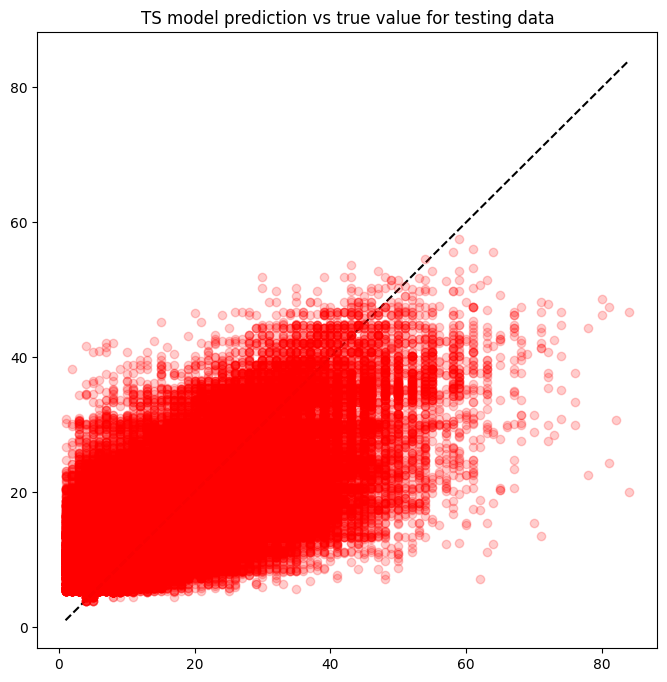

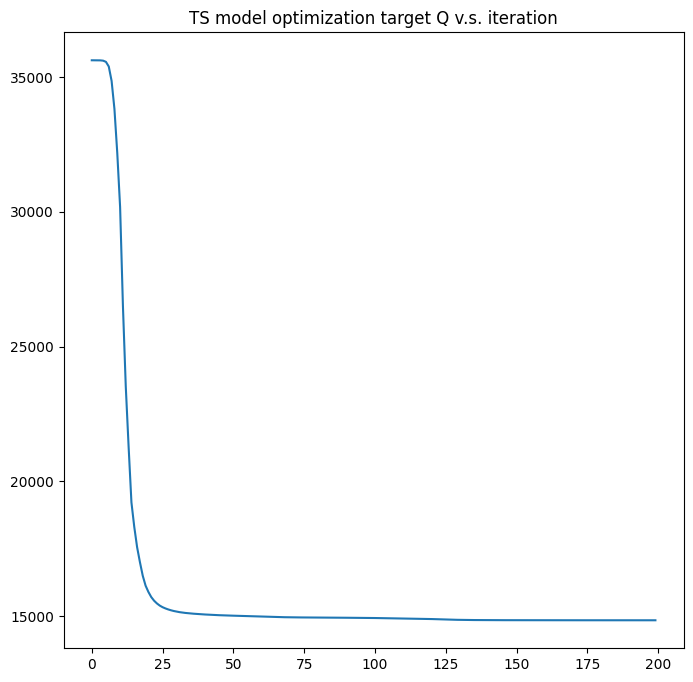

Epoch 1/50
16697/16697 [==============================] - 30s 2ms/step - loss: 59.1802 - root_mean_squared_error: 7.6929 - r_squared: 0.2712 - val_loss: 52.3328 - val_root_mean_squared_error: 7.2341 - val_r_squared: -0.1571
Epoch 2/50
16697/16697 [==============================] - 43s 3ms/step - loss: 51.2552 - root_mean_squared_error: 7.1593 - r_squared: 0.3641 - val_loss: 50.9749 - val_root_mean_squared_error: 7.1397 - val_r_squared: -0.1114
Epoch 3/50
16697/16697 [==============================] - 53s 3ms/step - loss: 50.8025 - root_mean_squared_error: 7.1276 - r_squared: 0.3675 - val_loss: 50.9714 - val_root_mean_squared_error: 7.1394 - val_r_squared: -0.0937
Epoch 4/50
16697/16697 [==============================] - 51s 3ms/step - loss: 50.7272 - root_mean_squared_error: 7.1223 - r_squared: 0.3684 - val_loss: 50.8356 - val_root_mean_squared_error: 7.1299 - val_r_squared: -0.1082
Epoch 5/50
16697/16697 [==============================] - 29s 2ms/step - loss: 50.7039 - root_mean_squar

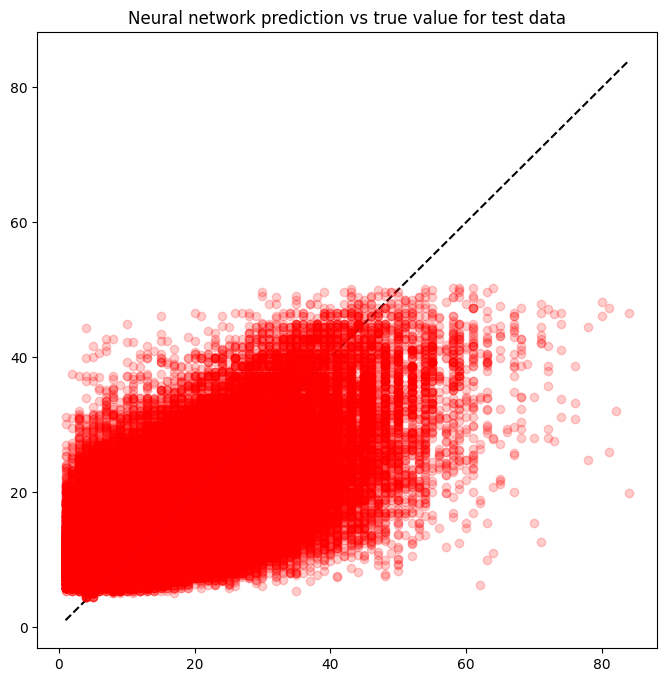

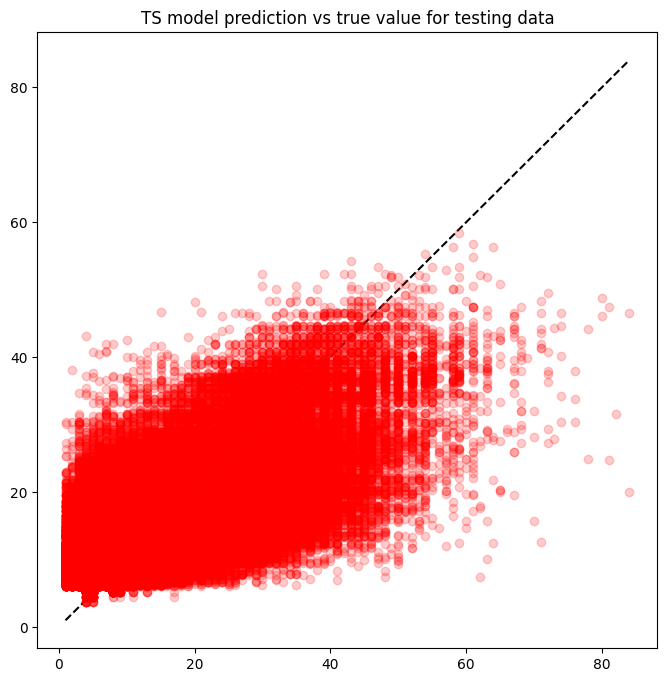

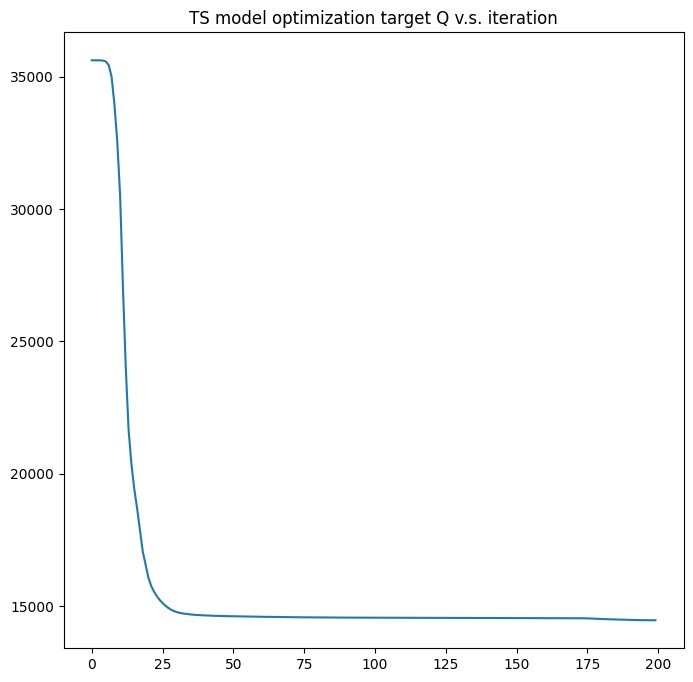

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 59.8413 - root_mean_squared_error: 7.7357 - r_squared: 0.2631 - val_loss: 53.2888 - val_root_mean_squared_error: 7.2999 - val_r_squared: -0.1272
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 51.5754 - root_mean_squared_error: 7.1816 - r_squared: 0.3604 - val_loss: 51.1509 - val_root_mean_squared_error: 7.1520 - val_r_squared: -0.1123
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 50.8317 - root_mean_squared_error: 7.1296 - r_squared: 0.3678 - val_loss: 50.9444 - val_root_mean_squared_error: 7.1375 - val_r_squared: -0.1025
Epoch 4/50
16697/16697 [==============================] - 31s 2ms/step - loss: 50.7540 - root_mean_squared_error: 7.1242 - r_squared: 0.3680 - val_loss: 50.8937 - val_root_mean_squared_error: 7.1340 - val_r_squared: -0.0935
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 50.7305 - root_mean_squar

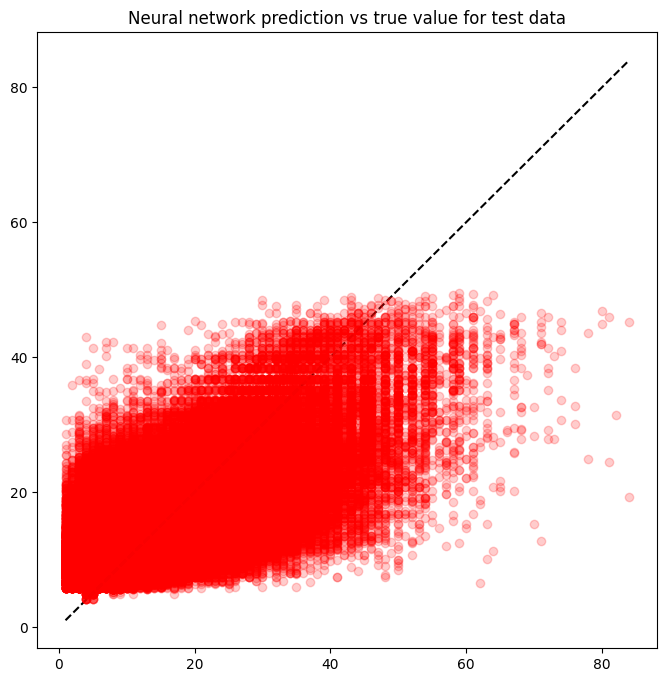

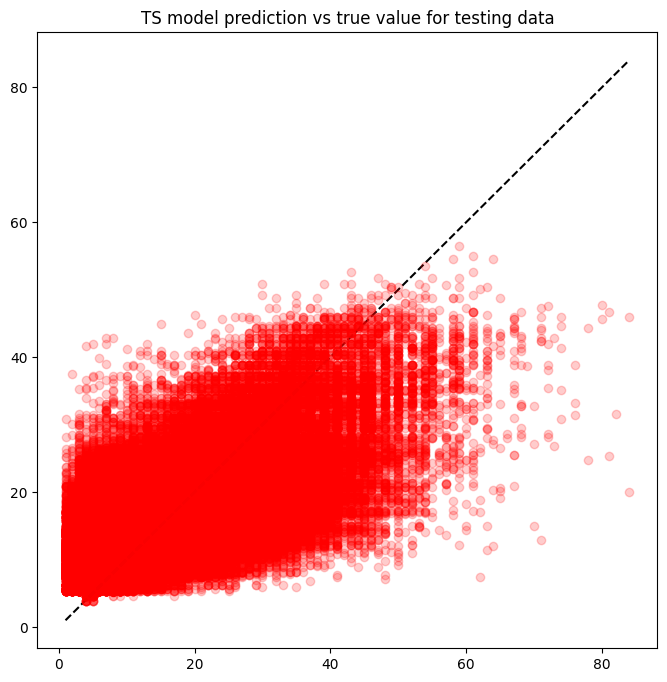

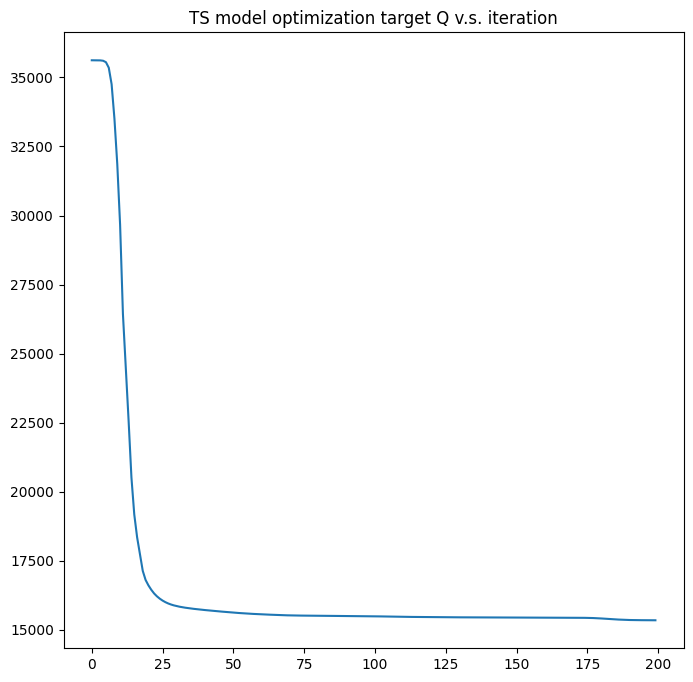

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 59.8734 - root_mean_squared_error: 7.7378 - r_squared: 0.2600 - val_loss: 53.8659 - val_root_mean_squared_error: 7.3393 - val_r_squared: -0.1346
Epoch 2/50
16697/16697 [==============================] - 32s 2ms/step - loss: 51.8319 - root_mean_squared_error: 7.1994 - r_squared: 0.3569 - val_loss: 51.2694 - val_root_mean_squared_error: 7.1603 - val_r_squared: -0.1217
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 50.8415 - root_mean_squared_error: 7.1303 - r_squared: 0.3669 - val_loss: 50.9808 - val_root_mean_squared_error: 7.1401 - val_r_squared: -0.0772
Epoch 4/50
16697/16697 [==============================] - 32s 2ms/step - loss: 50.7178 - root_mean_squared_error: 7.1216 - r_squared: 0.3685 - val_loss: 50.8598 - val_root_mean_squared_error: 7.1316 - val_r_squared: -0.0987
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 50.6772 - root_mean_squar

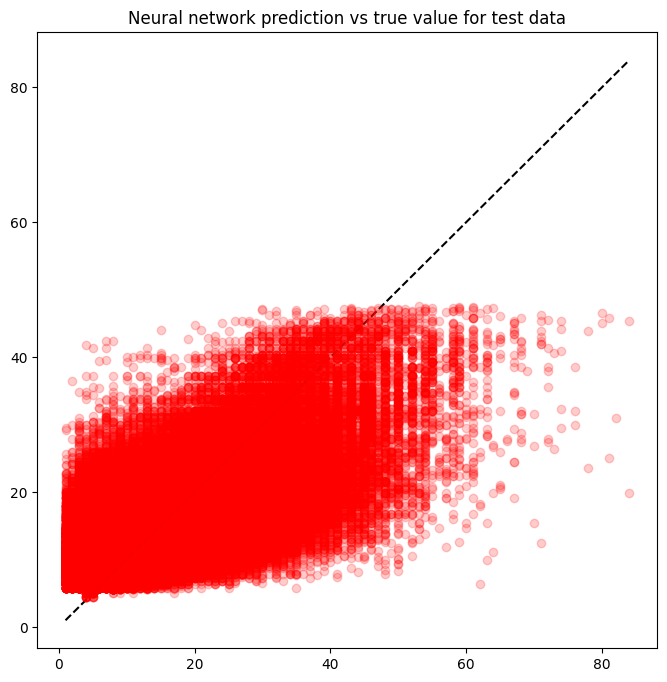

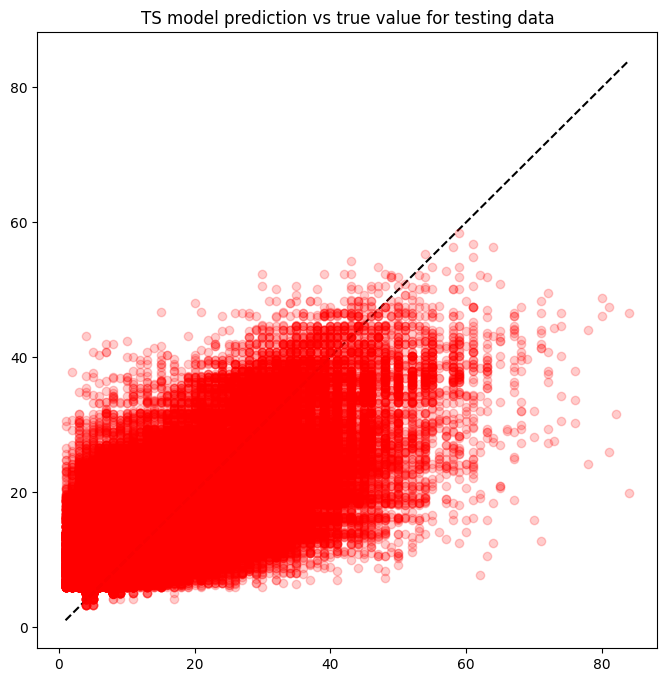

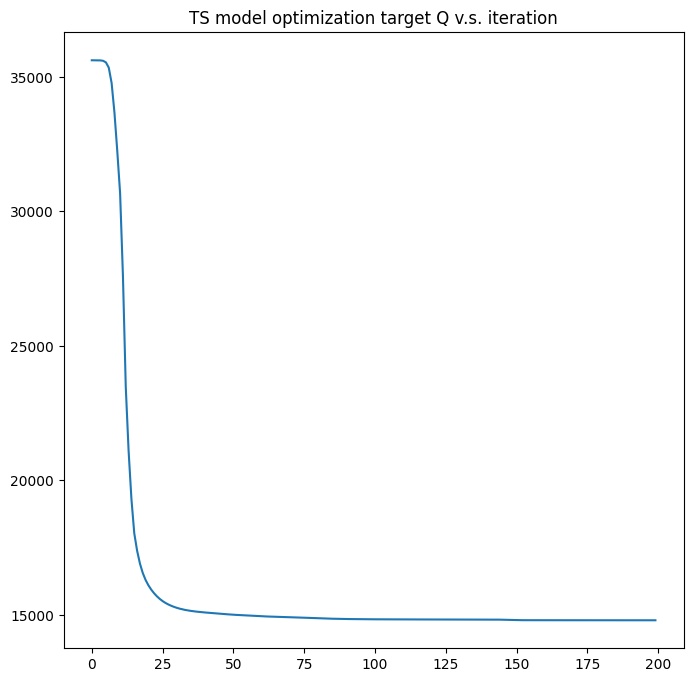

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 59.0388 - root_mean_squared_error: 7.6837 - r_squared: 0.2710 - val_loss: 52.1728 - val_root_mean_squared_error: 7.2231 - val_r_squared: -0.1430
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 51.6462 - root_mean_squared_error: 7.1865 - r_squared: 0.3596 - val_loss: 51.5345 - val_root_mean_squared_error: 7.1788 - val_r_squared: -0.1190
Epoch 3/50
16697/16697 [==============================] - 32s 2ms/step - loss: 51.3980 - root_mean_squared_error: 7.1692 - r_squared: 0.3601 - val_loss: 51.5316 - val_root_mean_squared_error: 7.1786 - val_r_squared: -0.0960
Epoch 4/50
16697/16697 [==============================] - 30s 2ms/step - loss: 51.3125 - root_mean_squared_error: 7.1633 - r_squared: 0.3623 - val_loss: 51.4274 - val_root_mean_squared_error: 7.1713 - val_r_squared: -0.1173
Epoch 5/50
16697/16697 [==============================] - 32s 2ms/step - loss: 51.2523 - root_mean_squar

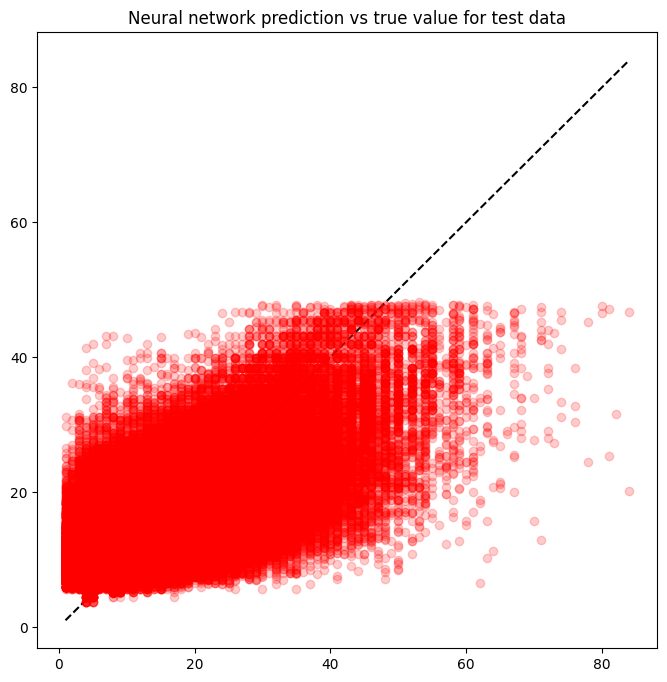

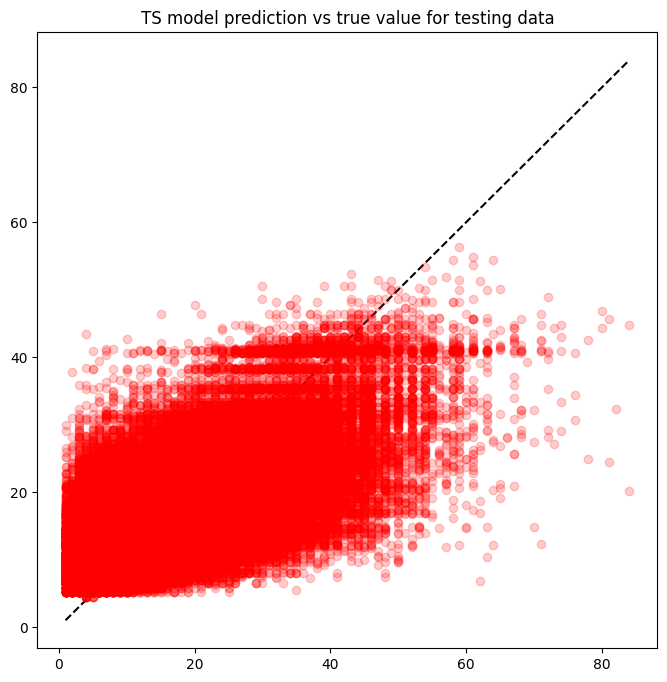

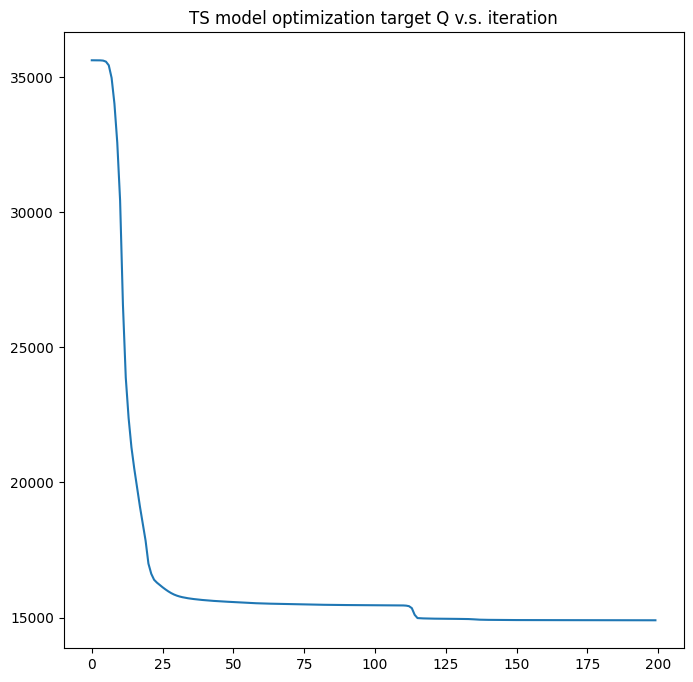

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 58.4022 - root_mean_squared_error: 7.6421 - r_squared: 0.2806 - val_loss: 51.8586 - val_root_mean_squared_error: 7.2013 - val_r_squared: -0.1202
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 51.5725 - root_mean_squared_error: 7.1814 - r_squared: 0.3595 - val_loss: 51.6666 - val_root_mean_squared_error: 7.1880 - val_r_squared: -0.1487
Epoch 3/50
16697/16697 [==============================] - 32s 2ms/step - loss: 51.3961 - root_mean_squared_error: 7.1691 - r_squared: 0.3620 - val_loss: 51.6019 - val_root_mean_squared_error: 7.1834 - val_r_squared: -0.0743
Epoch 4/50
16697/16697 [==============================] - 32s 2ms/step - loss: 51.3168 - root_mean_squared_error: 7.1636 - r_squared: 0.3623 - val_loss: 51.4426 - val_root_mean_squared_error: 7.1723 - val_r_squared: -0.0893
Epoch 5/50
16697/16697 [==============================] - 32s 2ms/step - loss: 51.2686 - root_mean_squar

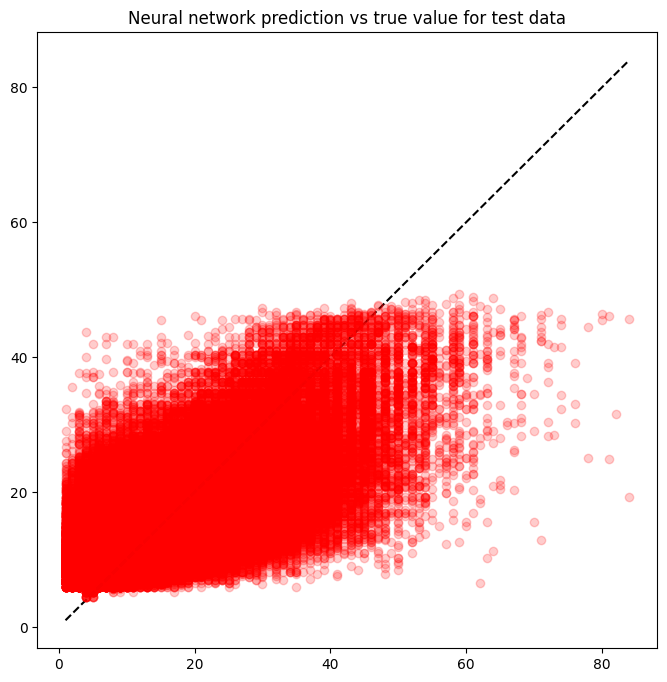

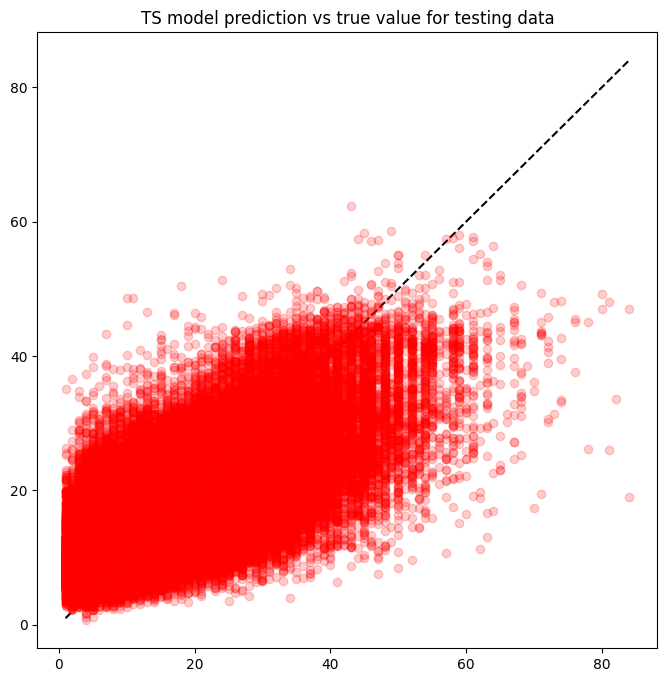

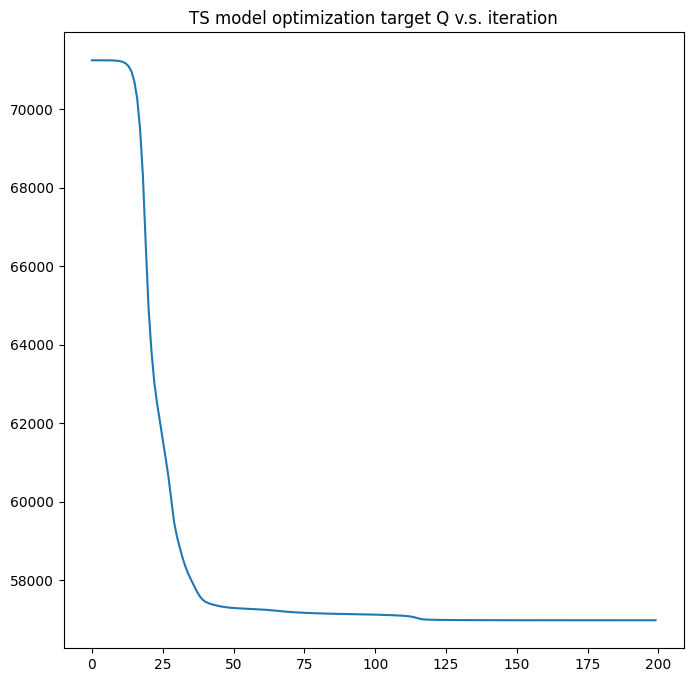

Epoch 1/50
16697/16697 [==============================] - 30s 2ms/step - loss: 55.1658 - root_mean_squared_error: 7.4274 - r_squared: 0.3179 - val_loss: 46.9093 - val_root_mean_squared_error: 6.8490 - val_r_squared: 0.0593
Epoch 2/50
16697/16697 [==============================] - 29s 2ms/step - loss: 46.0218 - root_mean_squared_error: 6.7839 - r_squared: 0.4282 - val_loss: 45.4097 - val_root_mean_squared_error: 6.7387 - val_r_squared: 0.1099
Epoch 3/50
16697/16697 [==============================] - 29s 2ms/step - loss: 44.9248 - root_mean_squared_error: 6.7026 - r_squared: 0.4405 - val_loss: 44.5336 - val_root_mean_squared_error: 6.6733 - val_r_squared: 0.1297
Epoch 4/50
16697/16697 [==============================] - 29s 2ms/step - loss: 44.2393 - root_mean_squared_error: 6.6513 - r_squared: 0.4482 - val_loss: 44.1715 - val_root_mean_squared_error: 6.6462 - val_r_squared: 0.1472
Epoch 5/50
16697/16697 [==============================] - 29s 2ms/step - loss: 43.9456 - root_mean_squared_e

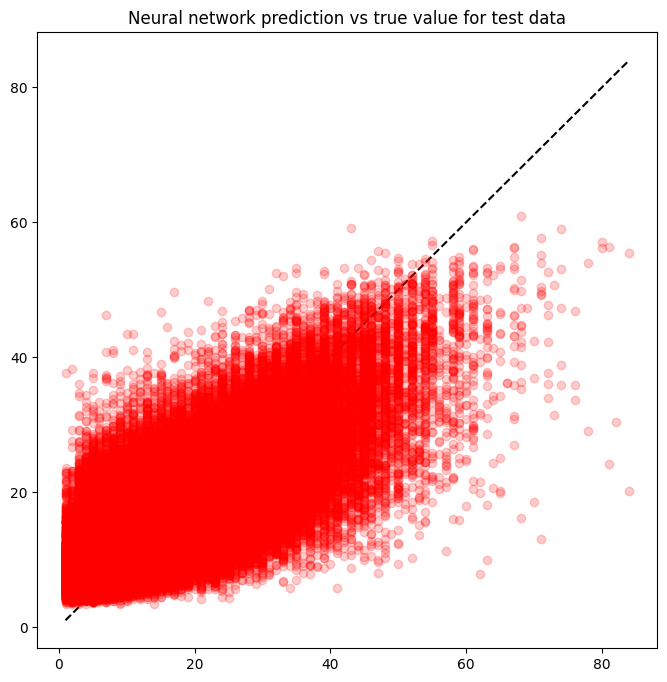

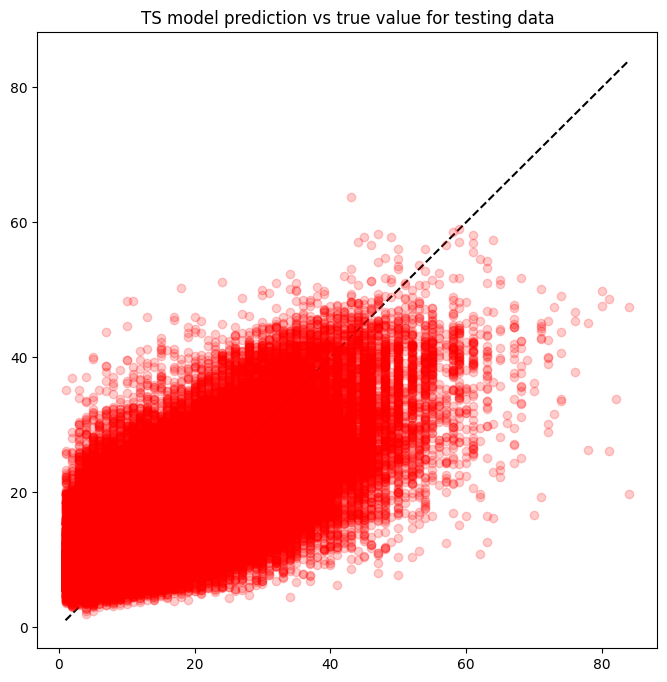

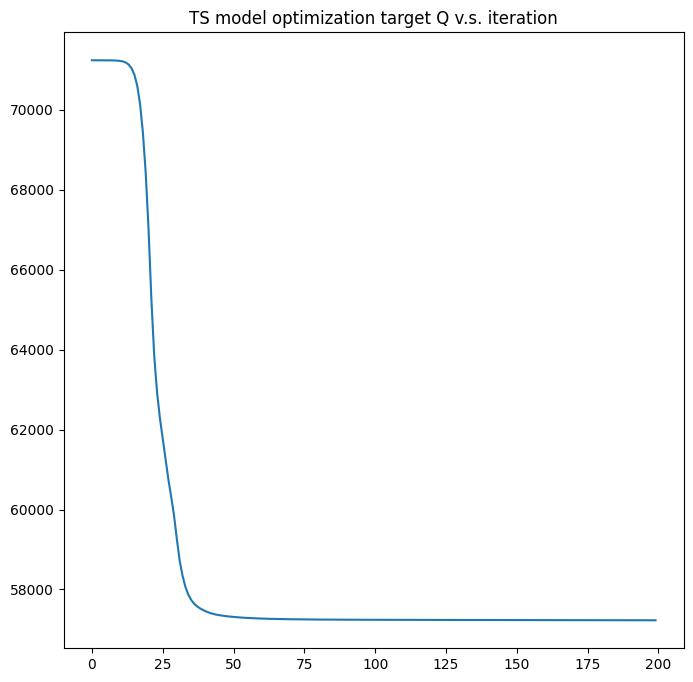

Epoch 1/50
16697/16697 [==============================] - 29s 2ms/step - loss: 56.7612 - root_mean_squared_error: 7.5340 - r_squared: 0.3014 - val_loss: 48.4941 - val_root_mean_squared_error: 6.9638 - val_r_squared: 0.0188
Epoch 2/50
16697/16697 [==============================] - 29s 2ms/step - loss: 46.5410 - root_mean_squared_error: 6.8221 - r_squared: 0.4228 - val_loss: 45.4289 - val_root_mean_squared_error: 6.7401 - val_r_squared: 0.1138
Epoch 3/50
16697/16697 [==============================] - 30s 2ms/step - loss: 44.9614 - root_mean_squared_error: 6.7053 - r_squared: 0.4401 - val_loss: 44.6225 - val_root_mean_squared_error: 6.6800 - val_r_squared: 0.1247
Epoch 4/50
16697/16697 [==============================] - 30s 2ms/step - loss: 44.5283 - root_mean_squared_error: 6.6730 - r_squared: 0.4448 - val_loss: 44.2610 - val_root_mean_squared_error: 6.6529 - val_r_squared: 0.1458
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 44.0823 - root_mean_squared_e

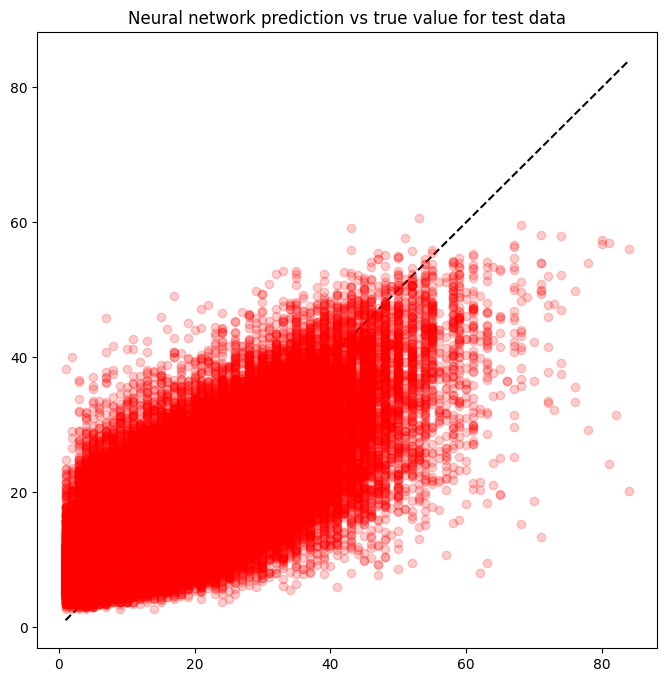

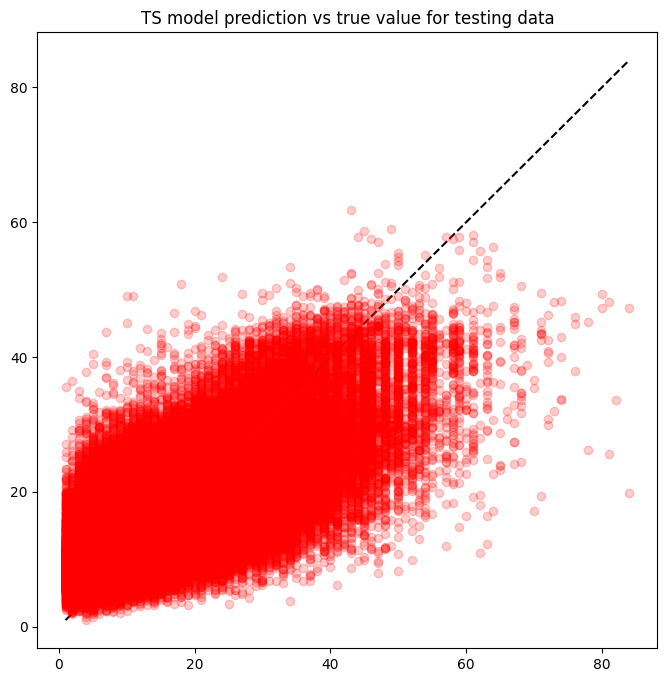

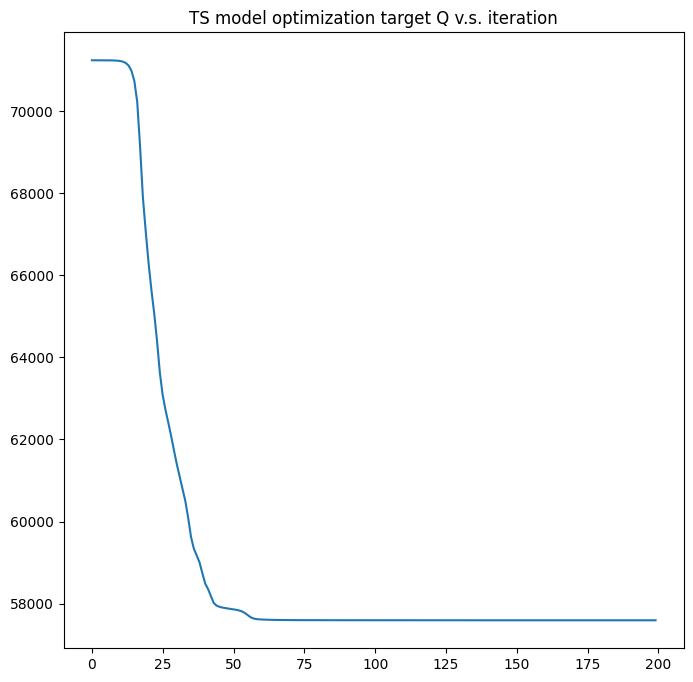

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 56.6291 - root_mean_squared_error: 7.5252 - r_squared: 0.3045 - val_loss: 47.0698 - val_root_mean_squared_error: 6.8607 - val_r_squared: 0.0861
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 45.8893 - root_mean_squared_error: 6.7742 - r_squared: 0.4297 - val_loss: 45.3237 - val_root_mean_squared_error: 6.7323 - val_r_squared: 0.0915
Epoch 3/50
16697/16697 [==============================] - 32s 2ms/step - loss: 44.9067 - root_mean_squared_error: 6.7012 - r_squared: 0.4403 - val_loss: 44.5863 - val_root_mean_squared_error: 6.6773 - val_r_squared: 0.1357
Epoch 4/50
16697/16697 [==============================] - 32s 2ms/step - loss: 44.4417 - root_mean_squared_error: 6.6665 - r_squared: 0.4456 - val_loss: 44.3964 - val_root_mean_squared_error: 6.6631 - val_r_squared: 0.1570
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 44.1670 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 32s 2ms/step - loss: 39.0264 - root_mean_squared_error: 6.2471 - r_squared: 0.5112 - val_loss: 39.1262 - val_root_mean_squared_error: 6.2551 - val_r_squared: 0.2688
Epoch 39/50
16697/16697 [==============================] - 31s 2ms/step - loss: 38.9643 - root_mean_squared_error: 6.2421 - r_squared: 0.5118 - val_loss: 38.9996 - val_root_mean_squared_error: 6.2450 - val_r_squared: 0.2631
Epoch 40/50
16697/16697 [==============================] - 32s 2ms/step - loss: 38.9070 - root_mean_squared_error: 6.2375 - r_squared: 0.5128 - val_loss: 38.9270 - val_root_mean_squared_error: 6.2391 - val_r_squared: 0.2682
Epoch 41/50
16697/16697 [==============================] - 32s 2ms/step - loss: 38.8548 - root_mean_squared_error: 6.2334 - r_squared: 0.5127 - val_loss: 38.9877 - val_root_mean_squared_error: 6.2440 - val_r_squared: 0.2566
Epoch 42/50
16697/16697 [==============================] - 32s 2ms/step - loss: 38.8023 - root_mean_squa

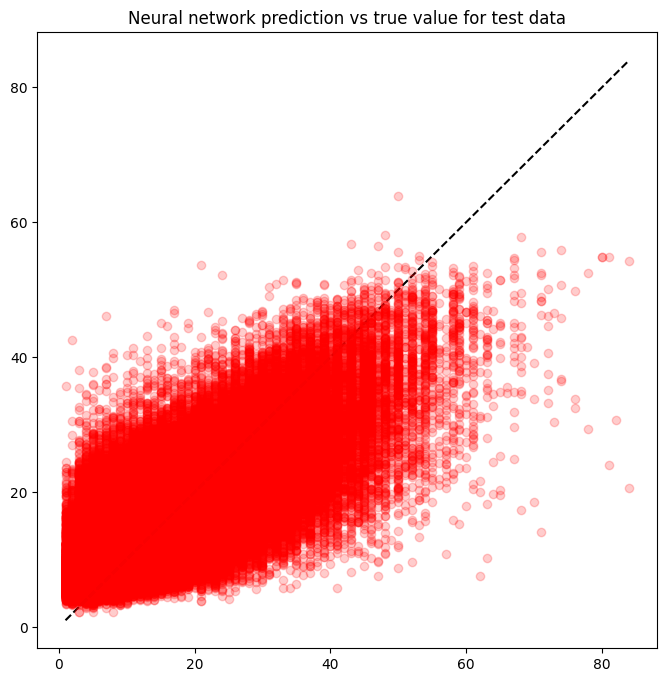

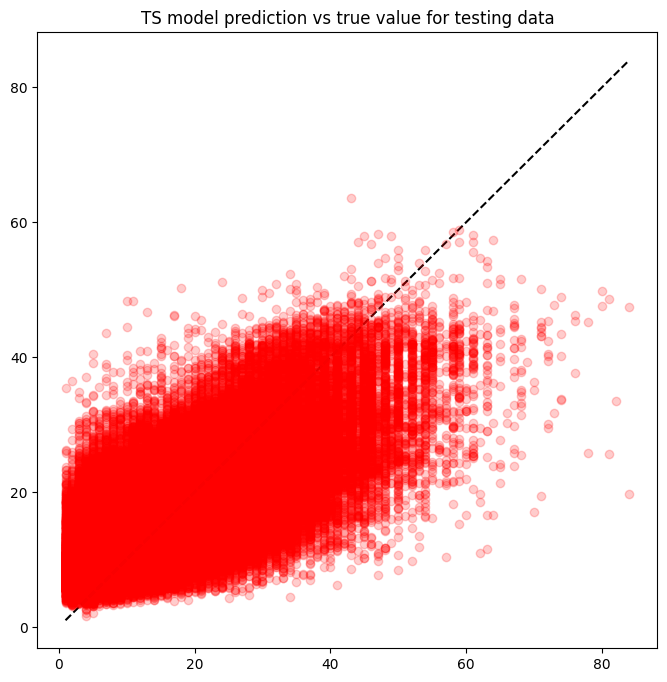

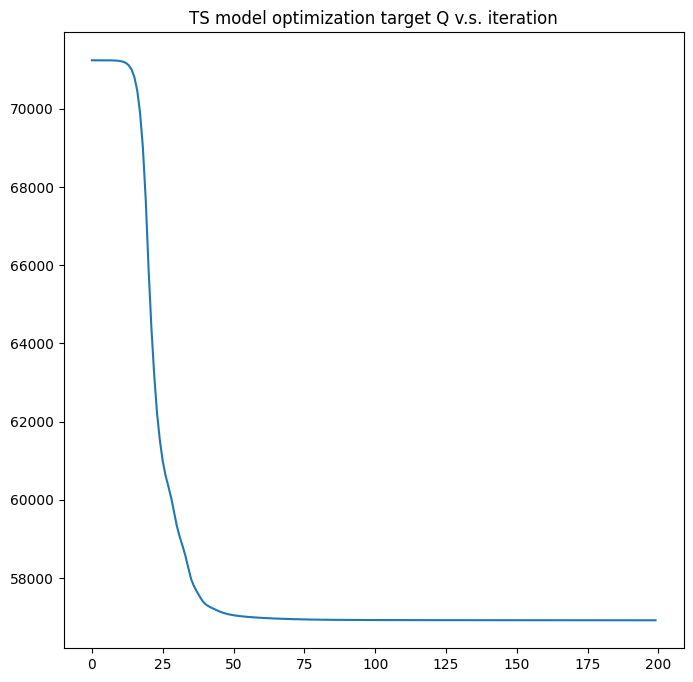

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 55.3686 - root_mean_squared_error: 7.4410 - r_squared: 0.3175 - val_loss: 46.8008 - val_root_mean_squared_error: 6.8411 - val_r_squared: 0.0575
Epoch 2/50
16697/16697 [==============================] - 32s 2ms/step - loss: 45.6328 - root_mean_squared_error: 6.7552 - r_squared: 0.4331 - val_loss: 44.9599 - val_root_mean_squared_error: 6.7052 - val_r_squared: 0.1366
Epoch 3/50
16697/16697 [==============================] - 30s 2ms/step - loss: 44.5337 - root_mean_squared_error: 6.6734 - r_squared: 0.4447 - val_loss: 44.3519 - val_root_mean_squared_error: 6.6597 - val_r_squared: 0.1251
Epoch 4/50
16697/16697 [==============================] - 31s 2ms/step - loss: 44.2448 - root_mean_squared_error: 6.6517 - r_squared: 0.4477 - val_loss: 44.2473 - val_root_mean_squared_error: 6.6519 - val_r_squared: 0.1200
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 44.0050 - root_mean_squared_e

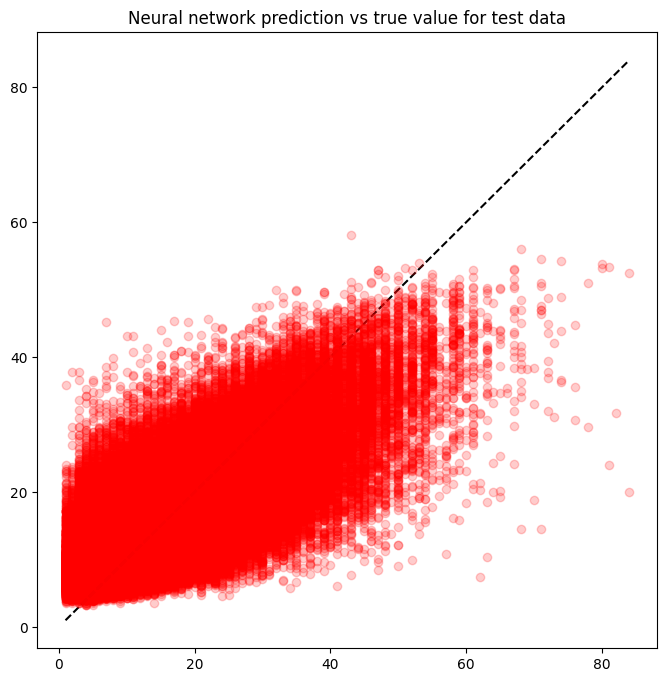

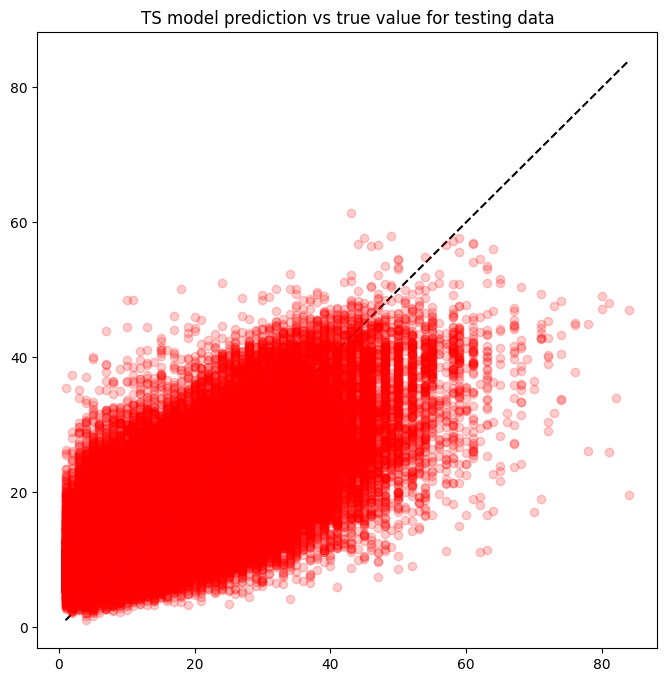

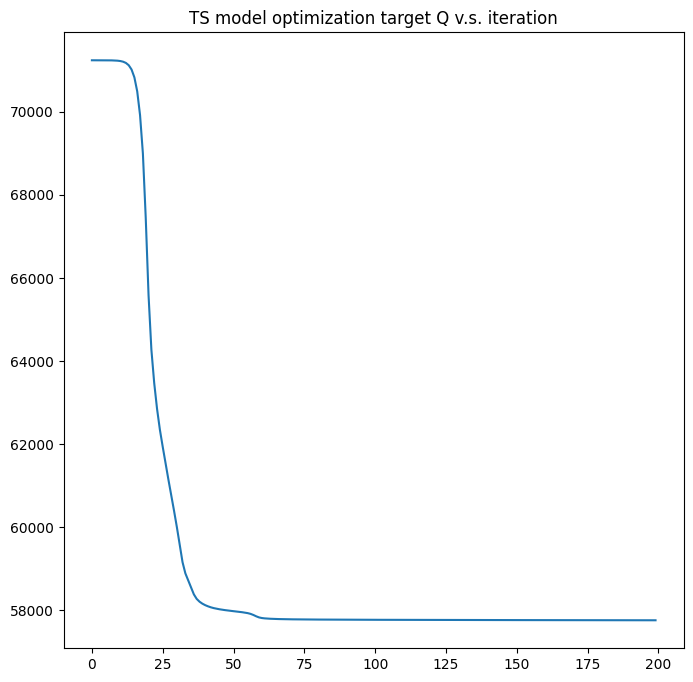

Epoch 1/50
16697/16697 [==============================] - 31s 2ms/step - loss: 56.6261 - root_mean_squared_error: 7.5250 - r_squared: 0.3050 - val_loss: 47.7902 - val_root_mean_squared_error: 6.9130 - val_r_squared: 0.0778
Epoch 2/50
16697/16697 [==============================] - 29s 2ms/step - loss: 46.3856 - root_mean_squared_error: 6.8107 - r_squared: 0.4223 - val_loss: 45.4092 - val_root_mean_squared_error: 6.7386 - val_r_squared: 0.1240
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 44.9877 - root_mean_squared_error: 6.7073 - r_squared: 0.4409 - val_loss: 44.5898 - val_root_mean_squared_error: 6.6776 - val_r_squared: 0.1349
Epoch 4/50
16697/16697 [==============================] - 31s 2ms/step - loss: 44.4092 - root_mean_squared_error: 6.6640 - r_squared: 0.4465 - val_loss: 44.2250 - val_root_mean_squared_error: 6.6502 - val_r_squared: 0.1307
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 44.0821 - root_mean_squared_e

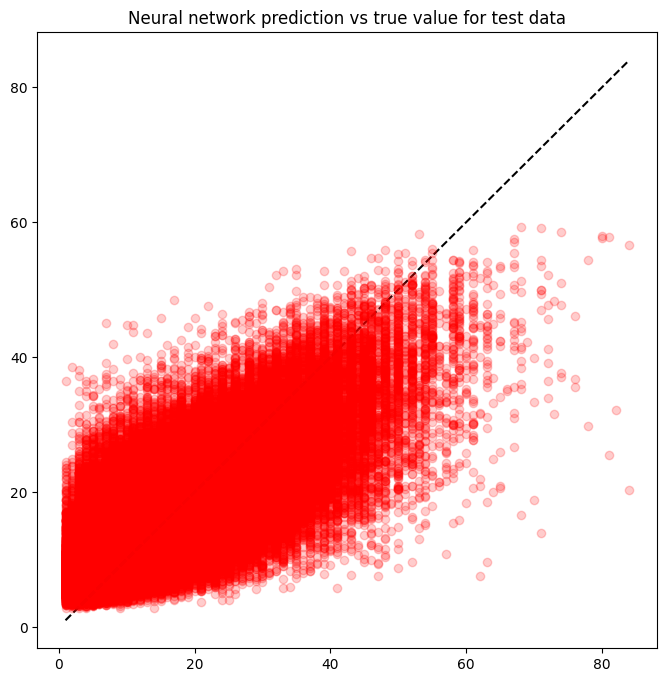

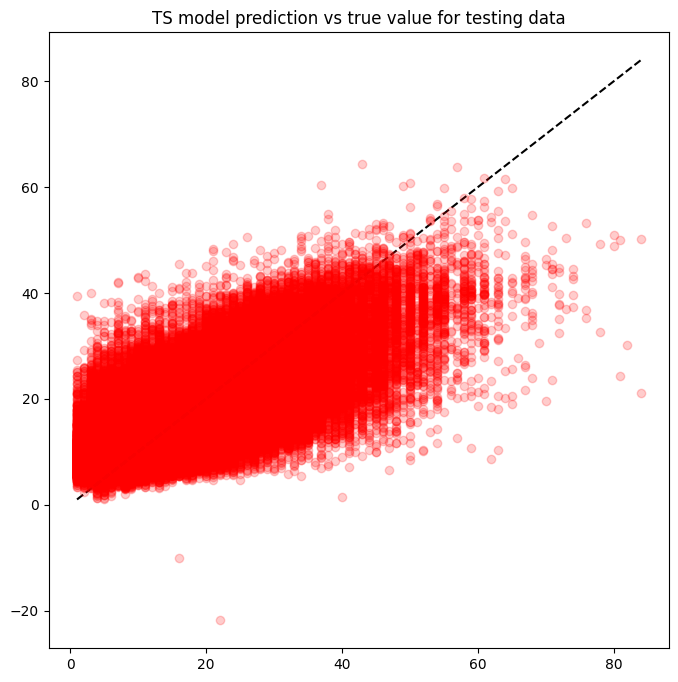

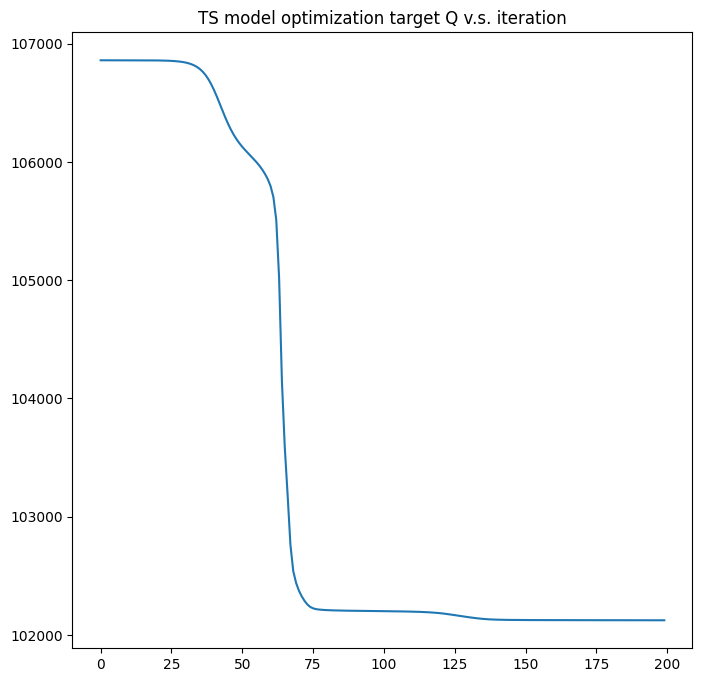

Epoch 1/50
16697/16697 [==============================] - 31s 2ms/step - loss: 50.2886 - root_mean_squared_error: 7.0914 - r_squared: 0.3739 - val_loss: 41.8779 - val_root_mean_squared_error: 6.4713 - val_r_squared: 0.1602
Epoch 2/50
16697/16697 [==============================] - 30s 2ms/step - loss: 40.3954 - root_mean_squared_error: 6.3557 - r_squared: 0.4945 - val_loss: 39.6684 - val_root_mean_squared_error: 6.2983 - val_r_squared: 0.2190
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 39.0226 - root_mean_squared_error: 6.2468 - r_squared: 0.5105 - val_loss: 38.6303 - val_root_mean_squared_error: 6.2153 - val_r_squared: 0.2551
Epoch 4/50
16697/16697 [==============================] - 29s 2ms/step - loss: 38.2724 - root_mean_squared_error: 6.1865 - r_squared: 0.5200 - val_loss: 38.0087 - val_root_mean_squared_error: 6.1651 - val_r_squared: 0.2597
Epoch 5/50
16697/16697 [==============================] - 29s 2ms/step - loss: 37.7669 - root_mean_squared_e

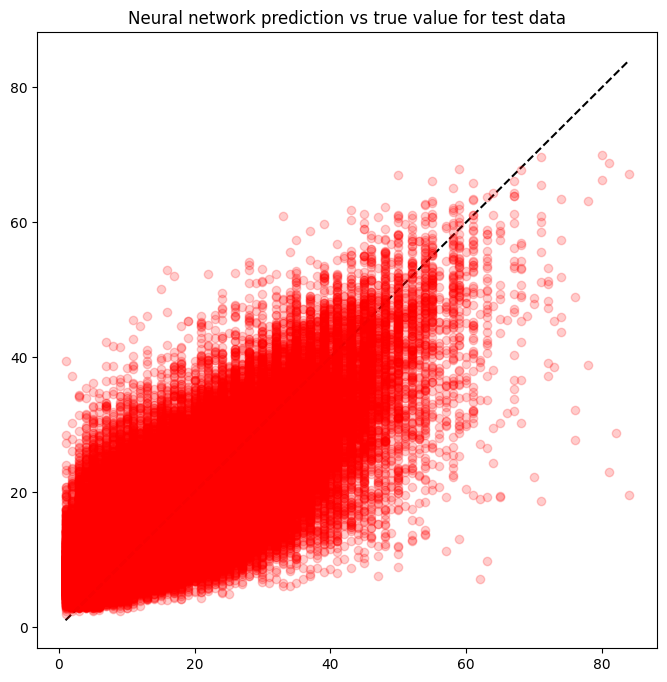

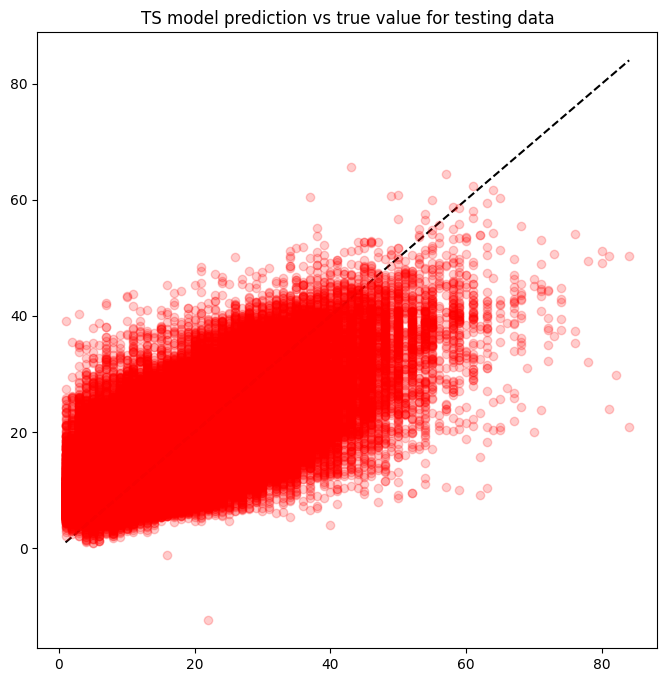

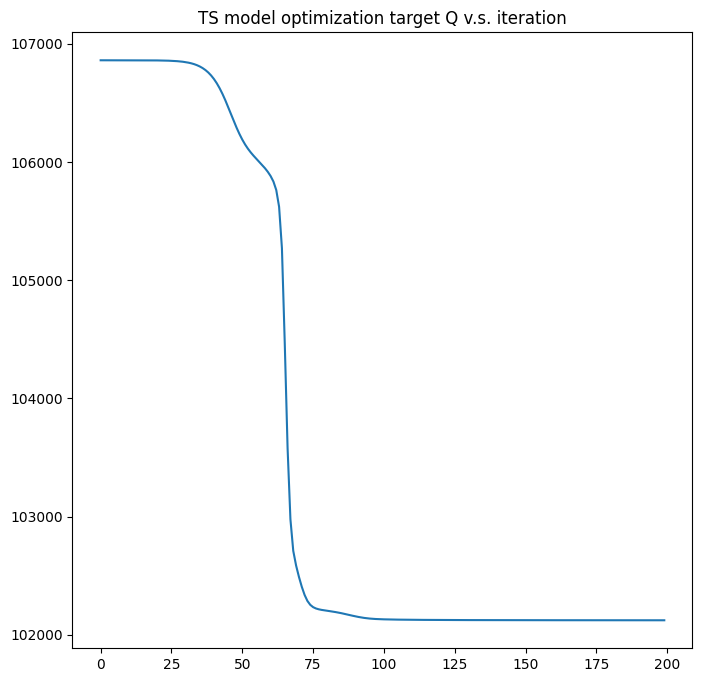

Epoch 1/50
16697/16697 [==============================] - 30s 2ms/step - loss: 50.8003 - root_mean_squared_error: 7.1274 - r_squared: 0.3697 - val_loss: 41.6785 - val_root_mean_squared_error: 6.4559 - val_r_squared: 0.1989
Epoch 2/50
16697/16697 [==============================] - 29s 2ms/step - loss: 40.2710 - root_mean_squared_error: 6.3459 - r_squared: 0.4961 - val_loss: 39.5773 - val_root_mean_squared_error: 6.2910 - val_r_squared: 0.2094
Epoch 3/50
16697/16697 [==============================] - 29s 2ms/step - loss: 38.9139 - root_mean_squared_error: 6.2381 - r_squared: 0.5122 - val_loss: 38.6538 - val_root_mean_squared_error: 6.2172 - val_r_squared: 0.2447
Epoch 4/50
16697/16697 [==============================] - 30s 2ms/step - loss: 38.1537 - root_mean_squared_error: 6.1769 - r_squared: 0.5211 - val_loss: 37.9541 - val_root_mean_squared_error: 6.1607 - val_r_squared: 0.2640
Epoch 5/50
16697/16697 [==============================] - 30s 2ms/step - loss: 37.6257 - root_mean_squared_e

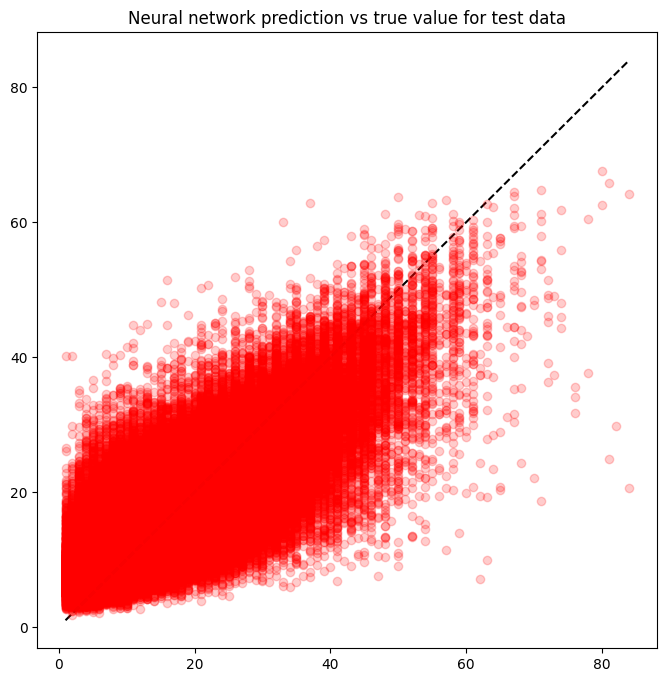

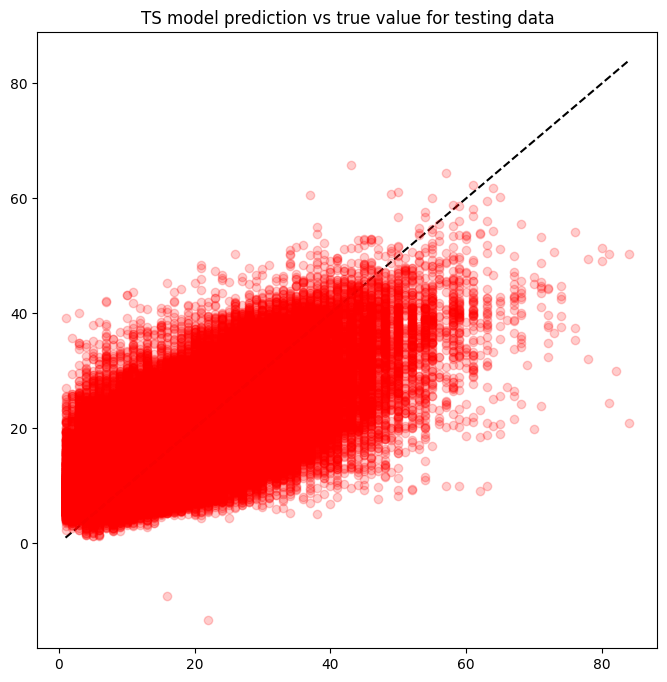

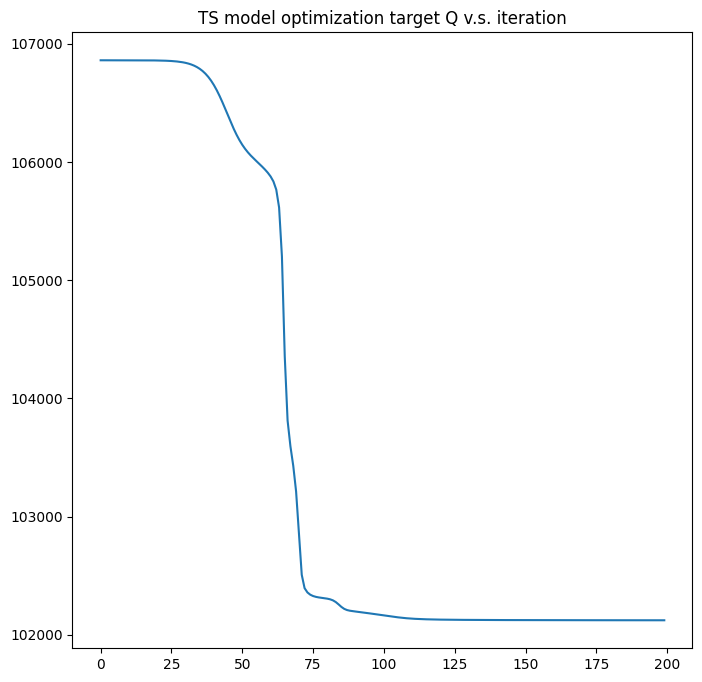

Epoch 1/50
16697/16697 [==============================] - 31s 2ms/step - loss: 51.1831 - root_mean_squared_error: 7.1542 - r_squared: 0.3645 - val_loss: 42.0821 - val_root_mean_squared_error: 6.4871 - val_r_squared: 0.1741
Epoch 2/50
16697/16697 [==============================] - 29s 2ms/step - loss: 40.4901 - root_mean_squared_error: 6.3632 - r_squared: 0.4941 - val_loss: 39.4515 - val_root_mean_squared_error: 6.2810 - val_r_squared: 0.2275
Epoch 3/50
16697/16697 [==============================] - 30s 2ms/step - loss: 38.8236 - root_mean_squared_error: 6.2309 - r_squared: 0.5144 - val_loss: 38.3655 - val_root_mean_squared_error: 6.1940 - val_r_squared: 0.2479
Epoch 4/50
16697/16697 [==============================] - 29s 2ms/step - loss: 38.0364 - root_mean_squared_error: 6.1674 - r_squared: 0.5229 - val_loss: 37.9805 - val_root_mean_squared_error: 6.1628 - val_r_squared: 0.2501
Epoch 5/50
16697/16697 [==============================] - 28s 2ms/step - loss: 37.5272 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 29s 2ms/step - loss: 34.0833 - root_mean_squared_error: 5.8381 - r_squared: 0.5690 - val_loss: 34.1569 - val_root_mean_squared_error: 5.8444 - val_r_squared: 0.3585
Epoch 39/50
16697/16697 [==============================] - 30s 2ms/step - loss: 34.0675 - root_mean_squared_error: 5.8367 - r_squared: 0.5693 - val_loss: 34.1067 - val_root_mean_squared_error: 5.8401 - val_r_squared: 0.3631
Epoch 40/50
16697/16697 [==============================] - 32s 2ms/step - loss: 34.0546 - root_mean_squared_error: 5.8356 - r_squared: 0.5693 - val_loss: 34.1521 - val_root_mean_squared_error: 5.8440 - val_r_squared: 0.3612
Epoch 41/50
16697/16697 [==============================] - 32s 2ms/step - loss: 34.0375 - root_mean_squared_error: 5.8342 - r_squared: 0.5697 - val_loss: 34.0927 - val_root_mean_squared_error: 5.8389 - val_r_squared: 0.3629
Epoch 42/50
16697/16697 [==============================] - 31s 2ms/step - loss: 34.0258 - root_mean_squa

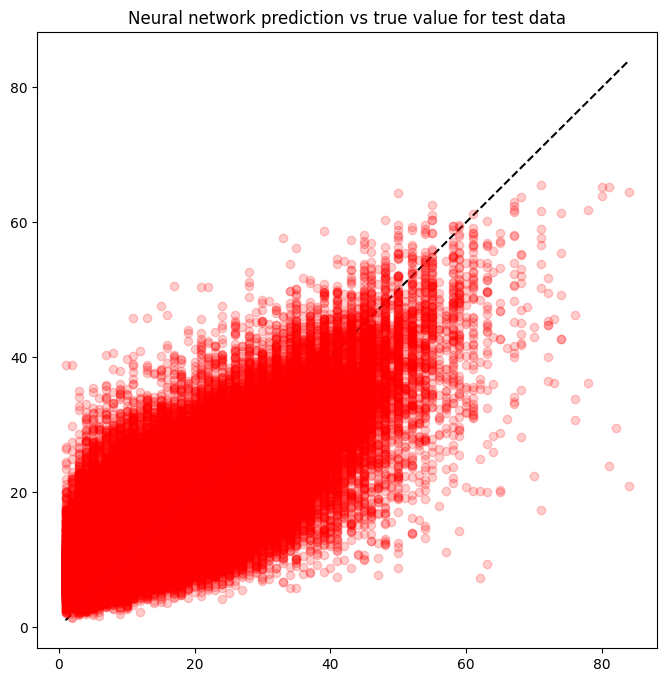

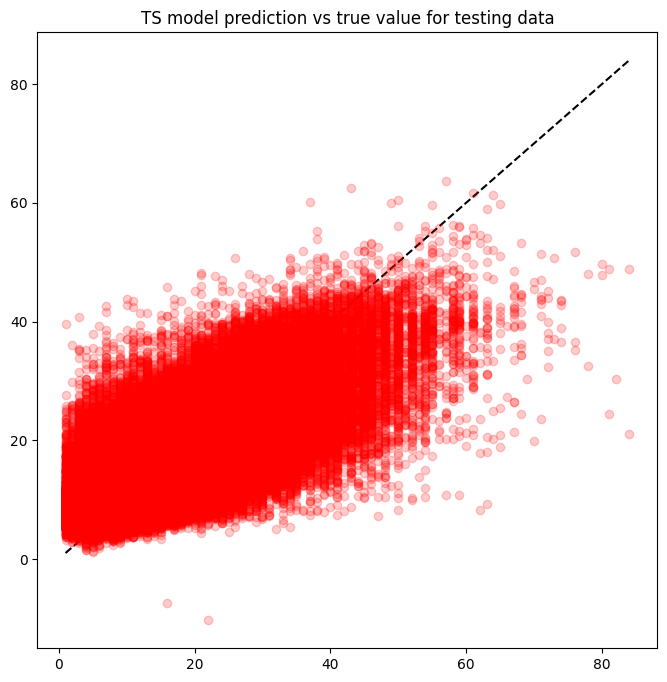

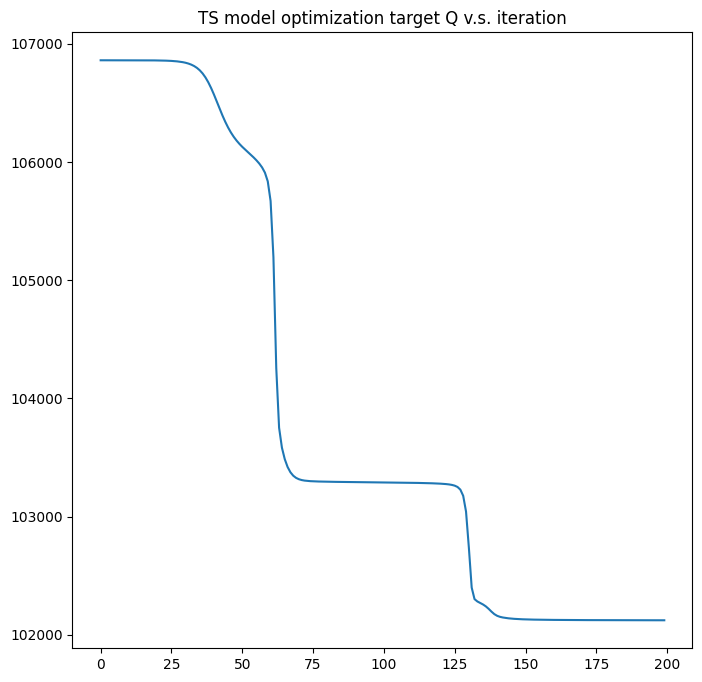

Epoch 1/50
16697/16697 [==============================] - 51s 3ms/step - loss: 50.8519 - root_mean_squared_error: 7.1311 - r_squared: 0.3709 - val_loss: 41.3580 - val_root_mean_squared_error: 6.4310 - val_r_squared: 0.1991
Epoch 2/50
16697/16697 [==============================] - 51s 3ms/step - loss: 39.9101 - root_mean_squared_error: 6.3174 - r_squared: 0.5010 - val_loss: 39.3161 - val_root_mean_squared_error: 6.2703 - val_r_squared: 0.2279
Epoch 3/50
16697/16697 [==============================] - 51s 3ms/step - loss: 38.6259 - root_mean_squared_error: 6.2150 - r_squared: 0.5156 - val_loss: 38.3594 - val_root_mean_squared_error: 6.1935 - val_r_squared: 0.2423
Epoch 4/50
16697/16697 [==============================] - 51s 3ms/step - loss: 38.0197 - root_mean_squared_error: 6.1660 - r_squared: 0.5219 - val_loss: 38.0161 - val_root_mean_squared_error: 6.1657 - val_r_squared: 0.2355
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 37.5486 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 54s 3ms/step - loss: 34.0849 - root_mean_squared_error: 5.8382 - r_squared: 0.5689 - val_loss: 34.1411 - val_root_mean_squared_error: 5.8430 - val_r_squared: 0.3595
Epoch 39/50
16697/16697 [==============================] - 55s 3ms/step - loss: 34.0644 - root_mean_squared_error: 5.8365 - r_squared: 0.5692 - val_loss: 34.1162 - val_root_mean_squared_error: 5.8409 - val_r_squared: 0.3557
Epoch 40/50
16697/16697 [==============================] - 54s 3ms/step - loss: 34.0569 - root_mean_squared_error: 5.8358 - r_squared: 0.5696 - val_loss: 34.1436 - val_root_mean_squared_error: 5.8433 - val_r_squared: 0.3549
Epoch 41/50
16697/16697 [==============================] - 55s 3ms/step - loss: 34.0364 - root_mean_squared_error: 5.8341 - r_squared: 0.5687 - val_loss: 34.1048 - val_root_mean_squared_error: 5.8399 - val_r_squared: 0.3628
Epoch 42/50
16697/16697 [==============================] - 54s 3ms/step - loss: 34.0337 - root_mean_squa

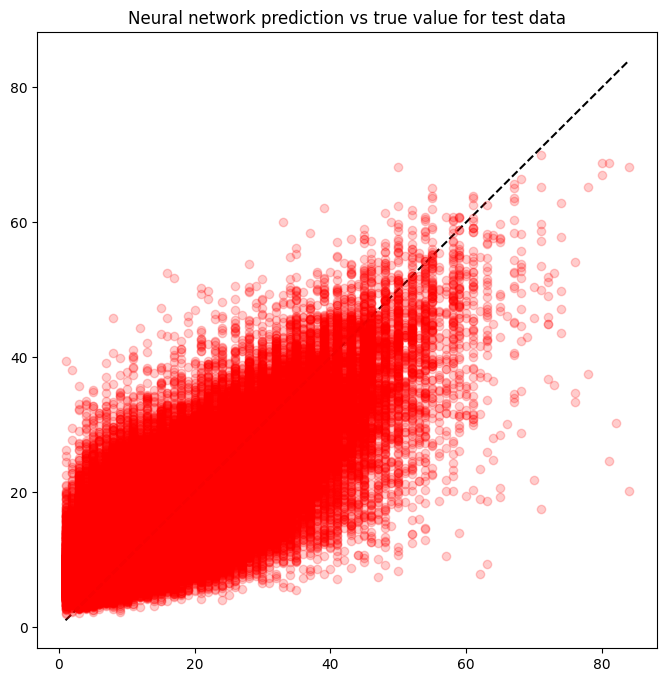

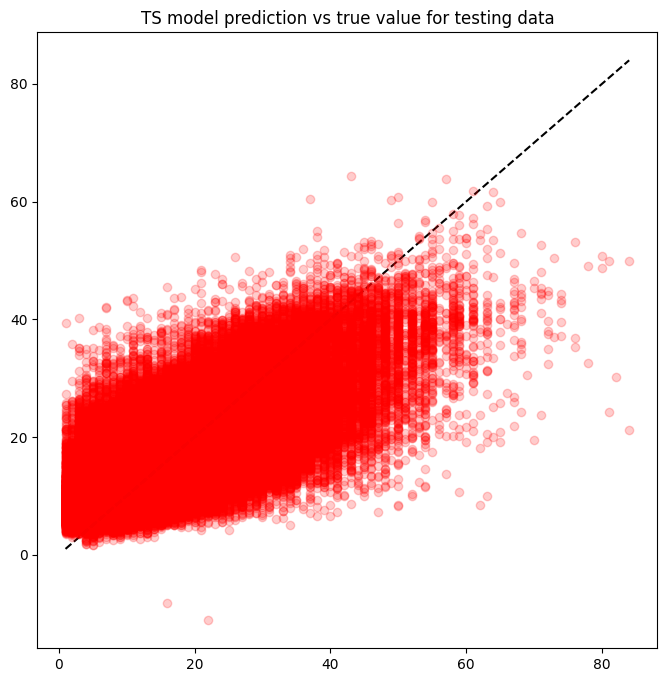

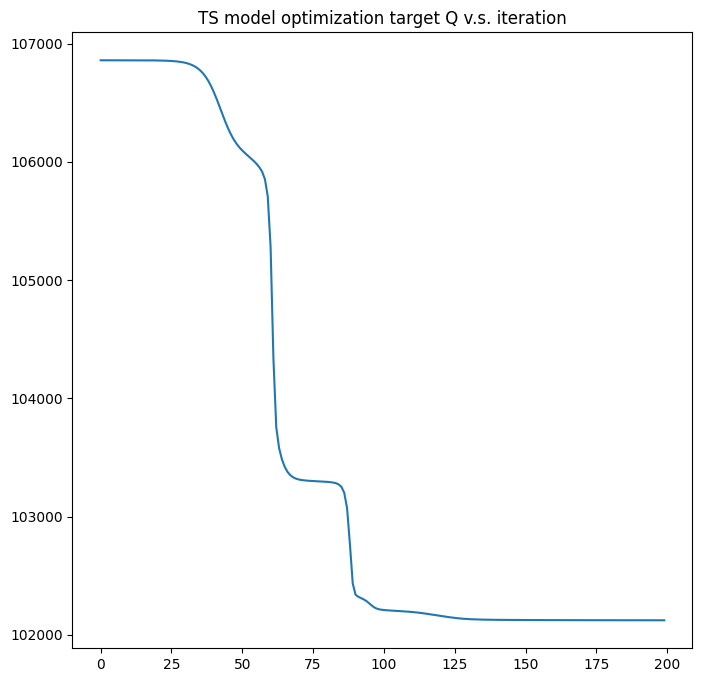

Epoch 1/50
16697/16697 [==============================] - 51s 3ms/step - loss: 50.8639 - root_mean_squared_error: 7.1319 - r_squared: 0.3687 - val_loss: 41.4769 - val_root_mean_squared_error: 6.4403 - val_r_squared: 0.1862
Epoch 2/50
16697/16697 [==============================] - 51s 3ms/step - loss: 40.1377 - root_mean_squared_error: 6.3354 - r_squared: 0.4974 - val_loss: 39.4091 - val_root_mean_squared_error: 6.2777 - val_r_squared: 0.2372
Epoch 3/50
16697/16697 [==============================] - 51s 3ms/step - loss: 38.7465 - root_mean_squared_error: 6.2247 - r_squared: 0.5133 - val_loss: 38.3601 - val_root_mean_squared_error: 6.1936 - val_r_squared: 0.2521
Epoch 4/50
16697/16697 [==============================] - 50s 3ms/step - loss: 37.9066 - root_mean_squared_error: 6.1568 - r_squared: 0.5239 - val_loss: 37.9005 - val_root_mean_squared_error: 6.1563 - val_r_squared: 0.2744
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 37.2908 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 51s 3ms/step - loss: 34.1619 - root_mean_squared_error: 5.8448 - r_squared: 0.5682 - val_loss: 34.1838 - val_root_mean_squared_error: 5.8467 - val_r_squared: 0.3610
Epoch 39/50
16697/16697 [==============================] - 51s 3ms/step - loss: 34.1518 - root_mean_squared_error: 5.8440 - r_squared: 0.5686 - val_loss: 34.1854 - val_root_mean_squared_error: 5.8468 - val_r_squared: 0.3618
Epoch 40/50
16697/16697 [==============================] - 51s 3ms/step - loss: 34.1255 - root_mean_squared_error: 5.8417 - r_squared: 0.5685 - val_loss: 34.2330 - val_root_mean_squared_error: 5.8509 - val_r_squared: 0.3554
Epoch 41/50
16697/16697 [==============================] - 51s 3ms/step - loss: 34.1099 - root_mean_squared_error: 5.8404 - r_squared: 0.5684 - val_loss: 34.1744 - val_root_mean_squared_error: 5.8459 - val_r_squared: 0.3574
Epoch 42/50
16697/16697 [==============================] - 51s 3ms/step - loss: 34.0960 - root_mean_squa

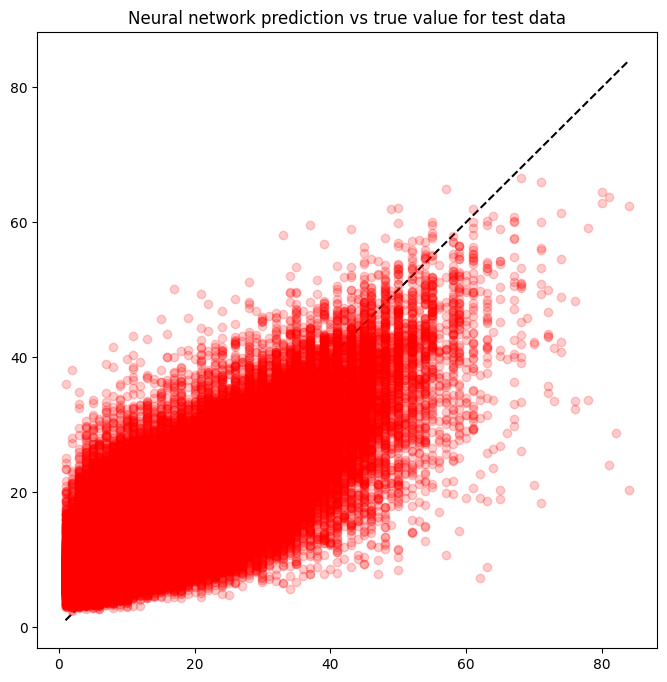

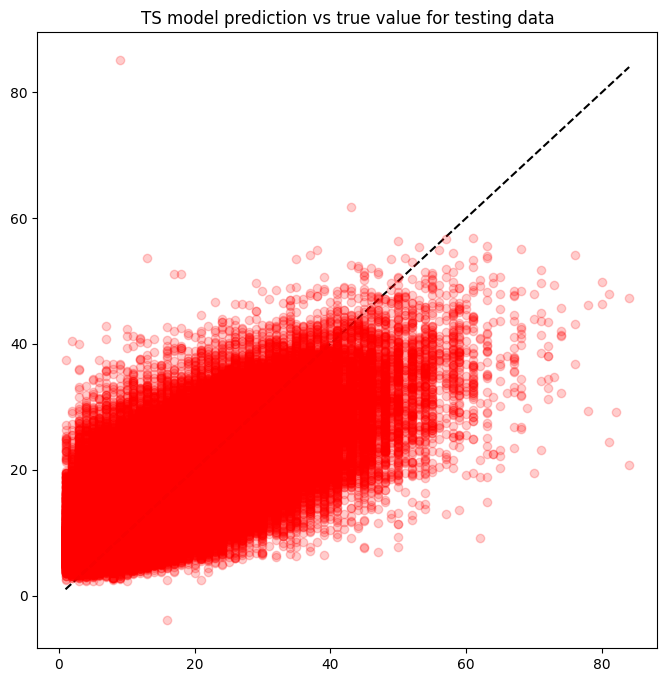

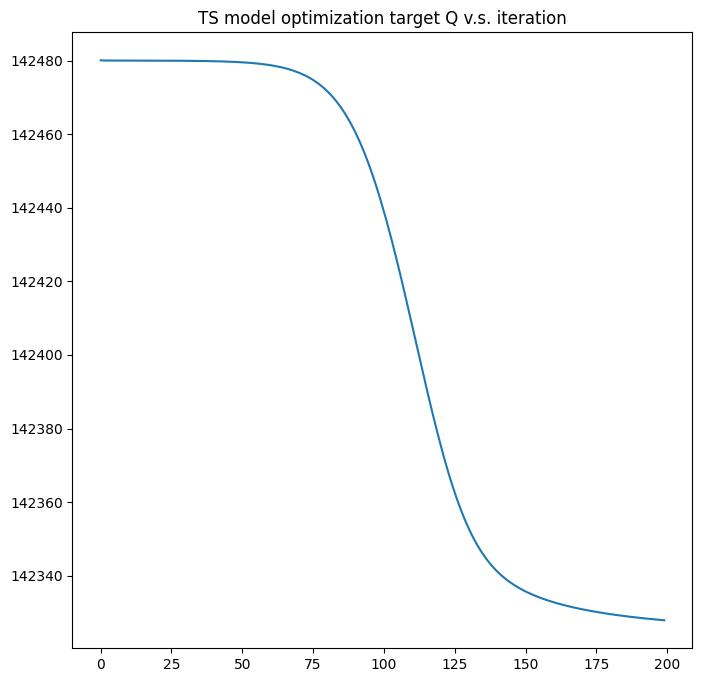

Epoch 1/50
16697/16697 [==============================] - 52s 3ms/step - loss: 48.7538 - root_mean_squared_error: 6.9824 - r_squared: 0.3950 - val_loss: 38.8227 - val_root_mean_squared_error: 6.2308 - val_r_squared: 0.2476
Epoch 2/50
16697/16697 [==============================] - 51s 3ms/step - loss: 37.1267 - root_mean_squared_error: 6.0932 - r_squared: 0.5350 - val_loss: 36.0297 - val_root_mean_squared_error: 6.0025 - val_r_squared: 0.3233
Epoch 3/50
16697/16697 [==============================] - 51s 3ms/step - loss: 35.2888 - root_mean_squared_error: 5.9404 - r_squared: 0.5567 - val_loss: 34.8646 - val_root_mean_squared_error: 5.9046 - val_r_squared: 0.3401
Epoch 4/50
16697/16697 [==============================] - 51s 3ms/step - loss: 34.5733 - root_mean_squared_error: 5.8799 - r_squared: 0.5646 - val_loss: 34.4369 - val_root_mean_squared_error: 5.8683 - val_r_squared: 0.3493
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 34.2244 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 54s 3ms/step - loss: 32.6906 - root_mean_squared_error: 5.7176 - r_squared: 0.5847 - val_loss: 32.8211 - val_root_mean_squared_error: 5.7290 - val_r_squared: 0.3899
Epoch 39/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.6660 - root_mean_squared_error: 5.7154 - r_squared: 0.5857 - val_loss: 32.8242 - val_root_mean_squared_error: 5.7292 - val_r_squared: 0.3860
Epoch 40/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.6727 - root_mean_squared_error: 5.7160 - r_squared: 0.5860 - val_loss: 32.9296 - val_root_mean_squared_error: 5.7384 - val_r_squared: 0.3862
Epoch 41/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.6746 - root_mean_squared_error: 5.7162 - r_squared: 0.5868 - val_loss: 32.7246 - val_root_mean_squared_error: 5.7205 - val_r_squared: 0.3929
Epoch 42/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.6631 - root_mean_squa

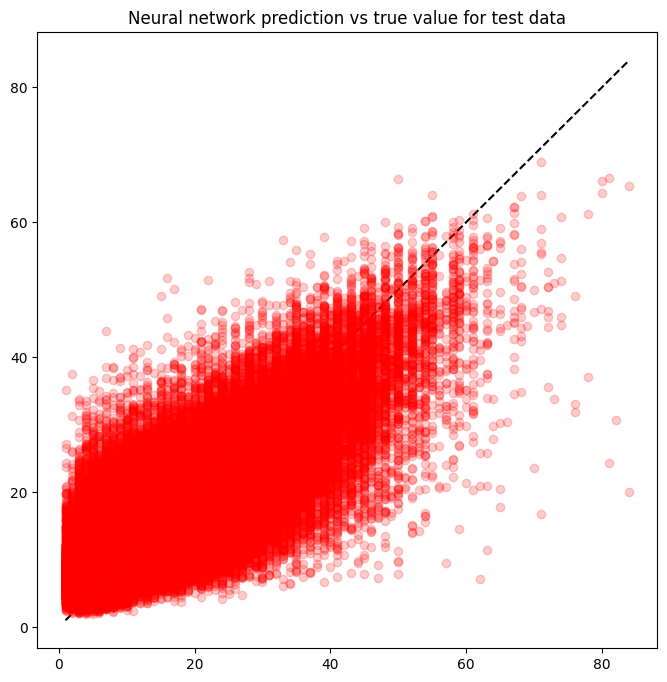

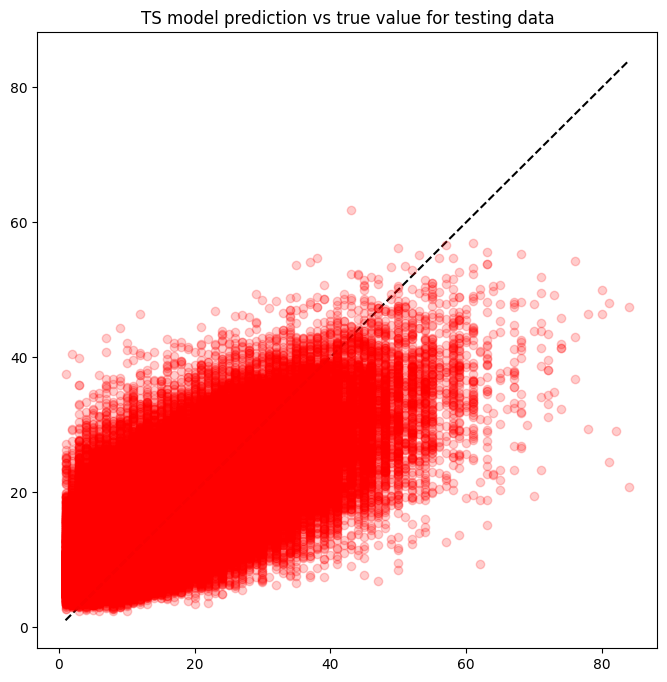

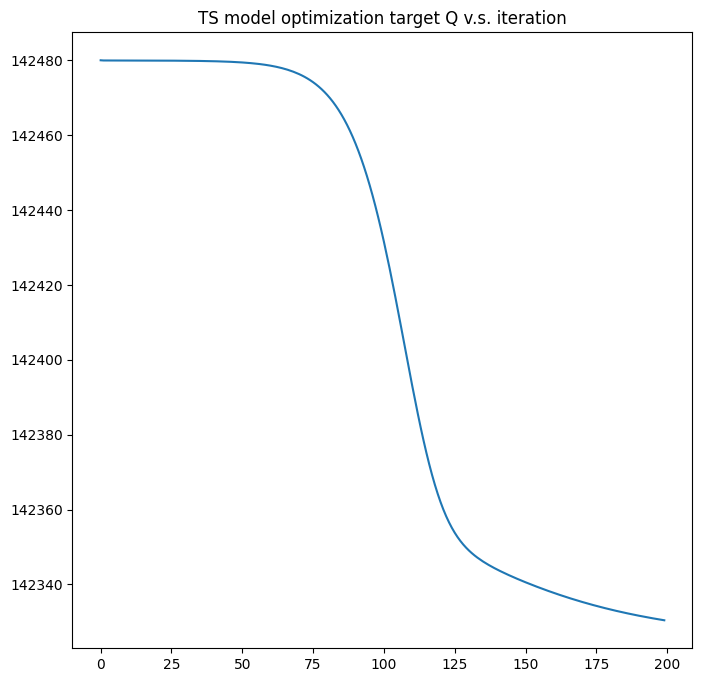

Epoch 1/50
16697/16697 [==============================] - 51s 3ms/step - loss: 48.2554 - root_mean_squared_error: 6.9466 - r_squared: 0.4023 - val_loss: 38.8246 - val_root_mean_squared_error: 6.2309 - val_r_squared: 0.2592
Epoch 2/50
16697/16697 [==============================] - 51s 3ms/step - loss: 37.2157 - root_mean_squared_error: 6.1005 - r_squared: 0.5337 - val_loss: 36.0267 - val_root_mean_squared_error: 6.0022 - val_r_squared: 0.3199
Epoch 3/50
16697/16697 [==============================] - 50s 3ms/step - loss: 35.2563 - root_mean_squared_error: 5.9377 - r_squared: 0.5566 - val_loss: 34.8588 - val_root_mean_squared_error: 5.9041 - val_r_squared: 0.3513
Epoch 4/50
16697/16697 [==============================] - 50s 3ms/step - loss: 34.5120 - root_mean_squared_error: 5.8747 - r_squared: 0.5652 - val_loss: 34.3849 - val_root_mean_squared_error: 5.8639 - val_r_squared: 0.3540
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 34.1591 - root_mean_squared_e

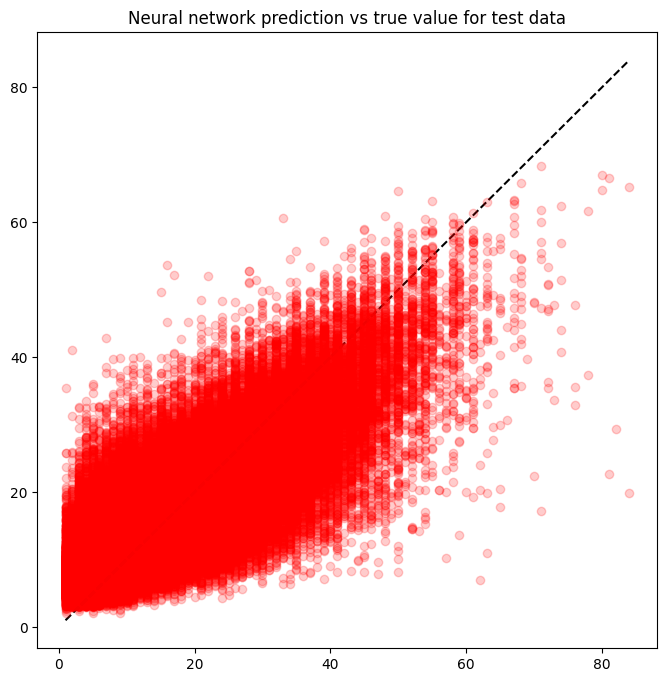

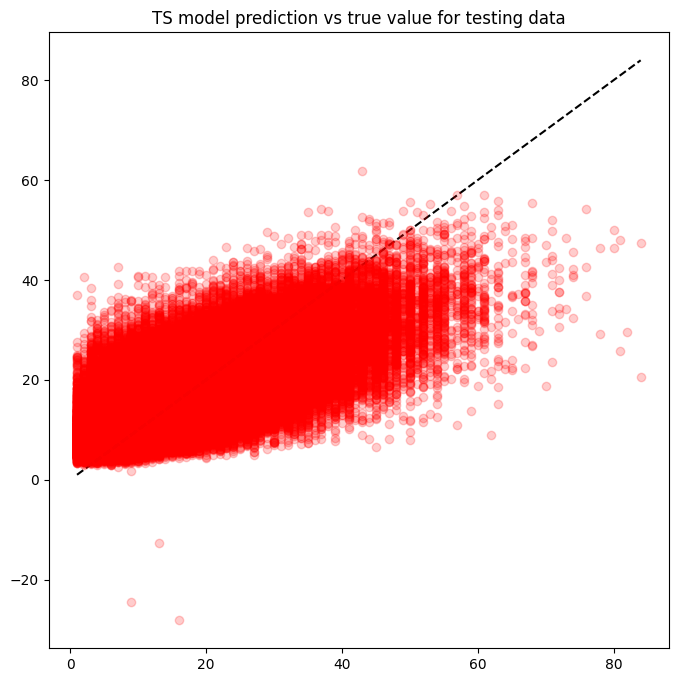

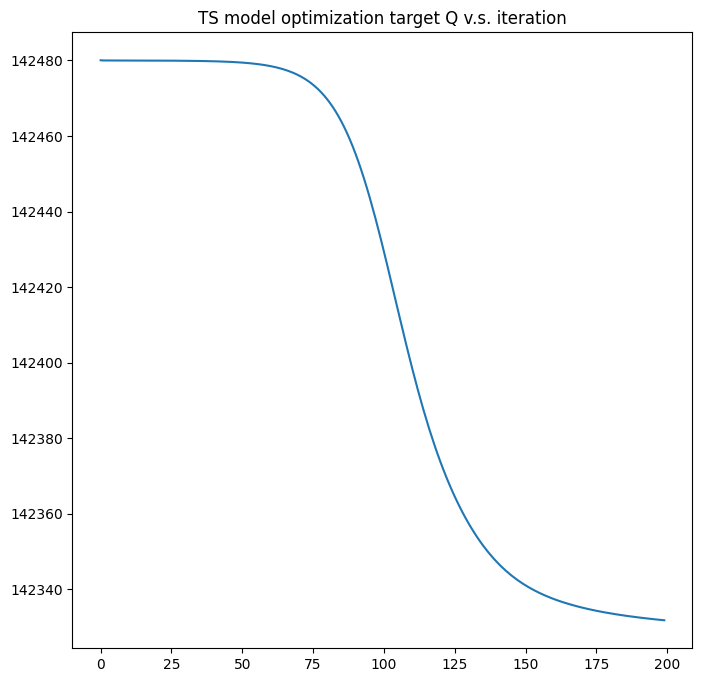

Epoch 1/50
16697/16697 [==============================] - 51s 3ms/step - loss: 48.2444 - root_mean_squared_error: 6.9458 - r_squared: 0.4029 - val_loss: 38.3055 - val_root_mean_squared_error: 6.1891 - val_r_squared: 0.2624
Epoch 2/50
16697/16697 [==============================] - 51s 3ms/step - loss: 36.7744 - root_mean_squared_error: 6.0642 - r_squared: 0.5398 - val_loss: 35.9314 - val_root_mean_squared_error: 5.9943 - val_r_squared: 0.3288
Epoch 3/50
16697/16697 [==============================] - 51s 3ms/step - loss: 35.2108 - root_mean_squared_error: 5.9339 - r_squared: 0.5579 - val_loss: 34.8468 - val_root_mean_squared_error: 5.9031 - val_r_squared: 0.3512
Epoch 4/50
16697/16697 [==============================] - 51s 3ms/step - loss: 34.5609 - root_mean_squared_error: 5.8789 - r_squared: 0.5654 - val_loss: 34.4100 - val_root_mean_squared_error: 5.8660 - val_r_squared: 0.3623
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 34.2216 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.7929 - root_mean_squared_error: 5.7265 - r_squared: 0.5845 - val_loss: 32.9350 - val_root_mean_squared_error: 5.7389 - val_r_squared: 0.3827
Epoch 39/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.7886 - root_mean_squared_error: 5.7261 - r_squared: 0.5850 - val_loss: 32.9287 - val_root_mean_squared_error: 5.7384 - val_r_squared: 0.3830
Epoch 40/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.7731 - root_mean_squared_error: 5.7248 - r_squared: 0.5853 - val_loss: 32.8906 - val_root_mean_squared_error: 5.7350 - val_r_squared: 0.3882
Epoch 41/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.7720 - root_mean_squared_error: 5.7247 - r_squared: 0.5847 - val_loss: 32.8928 - val_root_mean_squared_error: 5.7352 - val_r_squared: 0.3845
Epoch 42/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.7678 - root_mean_squa

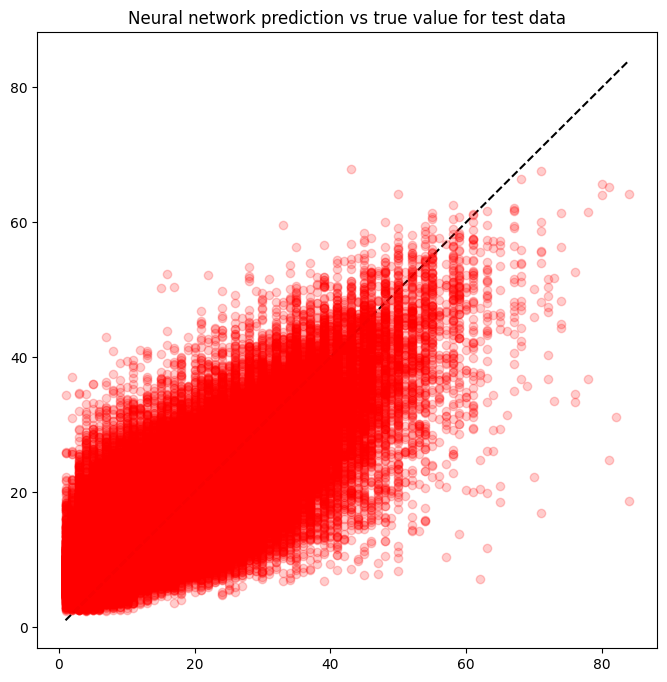

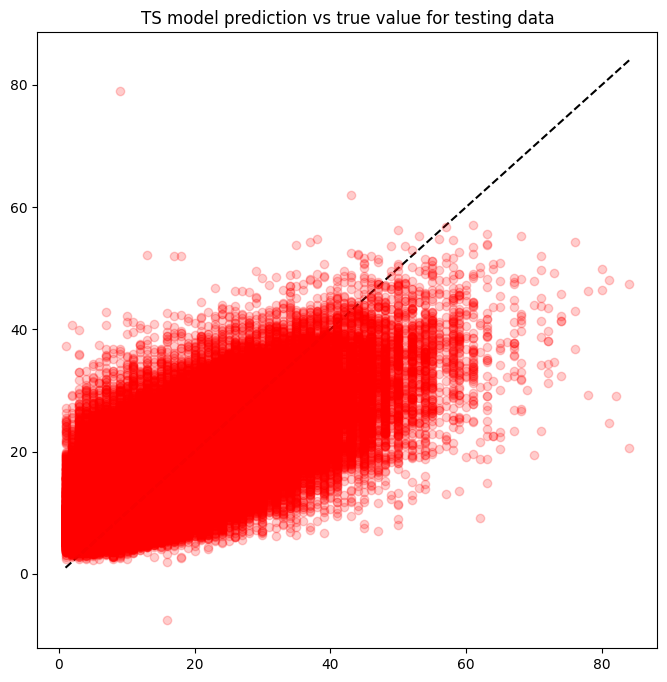

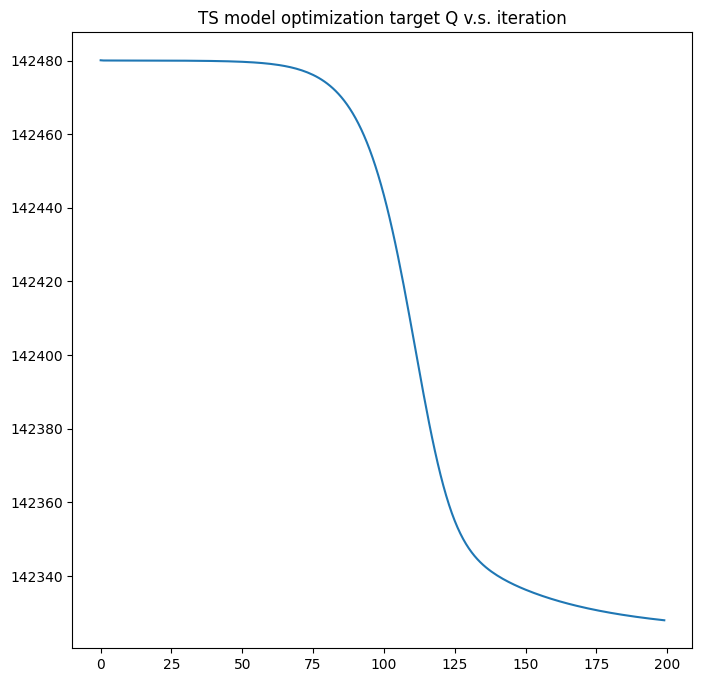

Epoch 1/50
16697/16697 [==============================] - 51s 3ms/step - loss: 48.1949 - root_mean_squared_error: 6.9423 - r_squared: 0.4025 - val_loss: 38.9301 - val_root_mean_squared_error: 6.2394 - val_r_squared: 0.2467
Epoch 2/50
16697/16697 [==============================] - 51s 3ms/step - loss: 37.2368 - root_mean_squared_error: 6.1022 - r_squared: 0.5334 - val_loss: 36.1917 - val_root_mean_squared_error: 6.0160 - val_r_squared: 0.3052
Epoch 3/50
16697/16697 [==============================] - 51s 3ms/step - loss: 35.2773 - root_mean_squared_error: 5.9395 - r_squared: 0.5569 - val_loss: 34.7623 - val_root_mean_squared_error: 5.8960 - val_r_squared: 0.3438
Epoch 4/50
16697/16697 [==============================] - 51s 3ms/step - loss: 34.5234 - root_mean_squared_error: 5.8757 - r_squared: 0.5654 - val_loss: 34.3925 - val_root_mean_squared_error: 5.8645 - val_r_squared: 0.3603
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 34.1754 - root_mean_squared_e

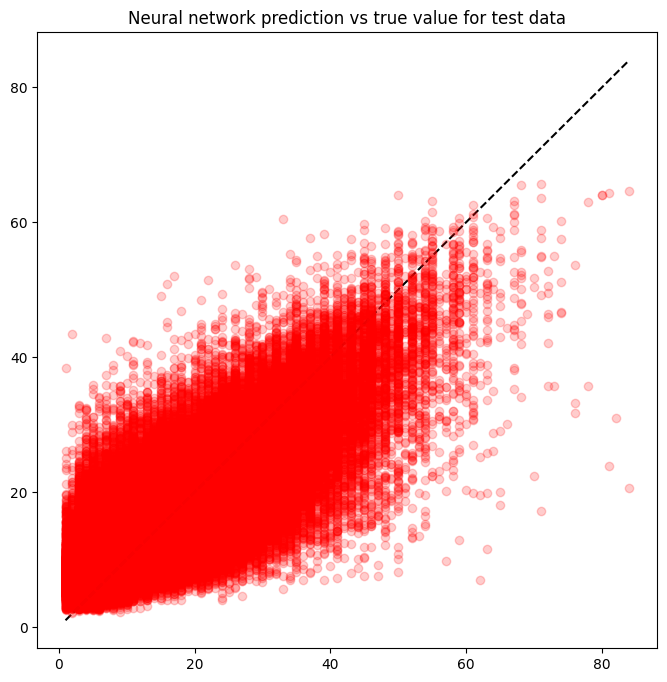

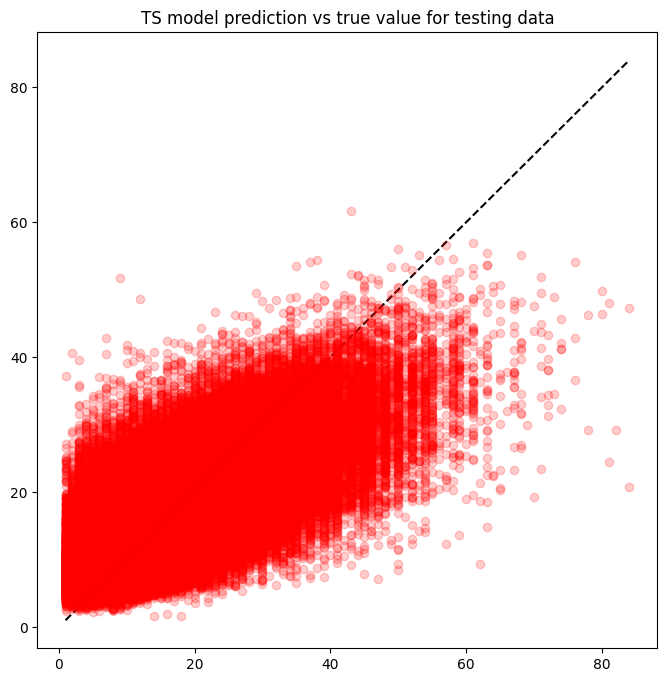

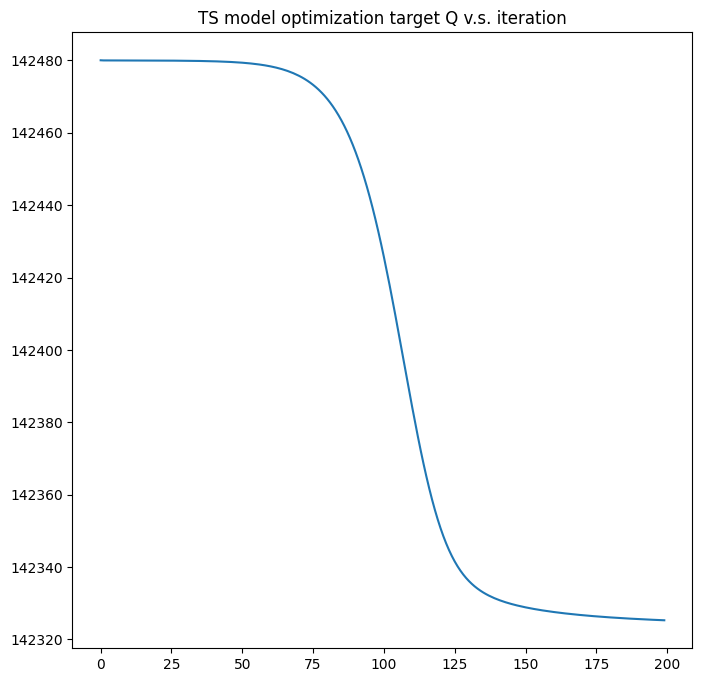

Epoch 1/50
16697/16697 [==============================] - 51s 3ms/step - loss: 48.4206 - root_mean_squared_error: 6.9585 - r_squared: 0.3986 - val_loss: 38.3564 - val_root_mean_squared_error: 6.1933 - val_r_squared: 0.2658
Epoch 2/50
16697/16697 [==============================] - 50s 3ms/step - loss: 36.8868 - root_mean_squared_error: 6.0734 - r_squared: 0.5380 - val_loss: 35.8176 - val_root_mean_squared_error: 5.9848 - val_r_squared: 0.3204
Epoch 3/50
16697/16697 [==============================] - 49s 3ms/step - loss: 35.0912 - root_mean_squared_error: 5.9238 - r_squared: 0.5595 - val_loss: 35.0044 - val_root_mean_squared_error: 5.9165 - val_r_squared: 0.3435
Epoch 4/50
16697/16697 [==============================] - 50s 3ms/step - loss: 34.3828 - root_mean_squared_error: 5.8637 - r_squared: 0.5664 - val_loss: 34.3508 - val_root_mean_squared_error: 5.8610 - val_r_squared: 0.3637
Epoch 5/50
16697/16697 [==============================] - 50s 3ms/step - loss: 34.0338 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.6949 - root_mean_squared_error: 5.7179 - r_squared: 0.5863 - val_loss: 32.8443 - val_root_mean_squared_error: 5.7310 - val_r_squared: 0.3831
Epoch 39/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.6865 - root_mean_squared_error: 5.7172 - r_squared: 0.5859 - val_loss: 32.8761 - val_root_mean_squared_error: 5.7338 - val_r_squared: 0.3889
Epoch 40/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.6803 - root_mean_squared_error: 5.7167 - r_squared: 0.5860 - val_loss: 32.9066 - val_root_mean_squared_error: 5.7364 - val_r_squared: 0.3868
Epoch 41/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.6715 - root_mean_squared_error: 5.7159 - r_squared: 0.5855 - val_loss: 32.7280 - val_root_mean_squared_error: 5.7208 - val_r_squared: 0.3898
Epoch 42/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.6615 - root_mean_squa

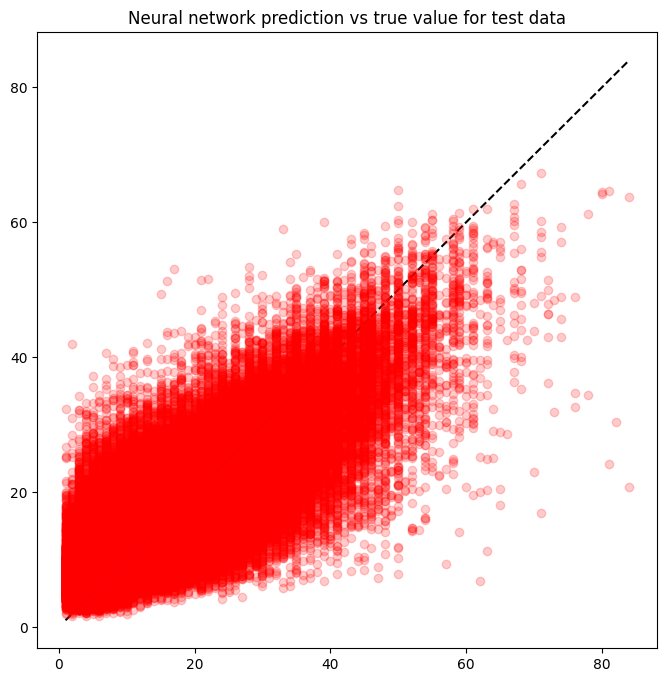

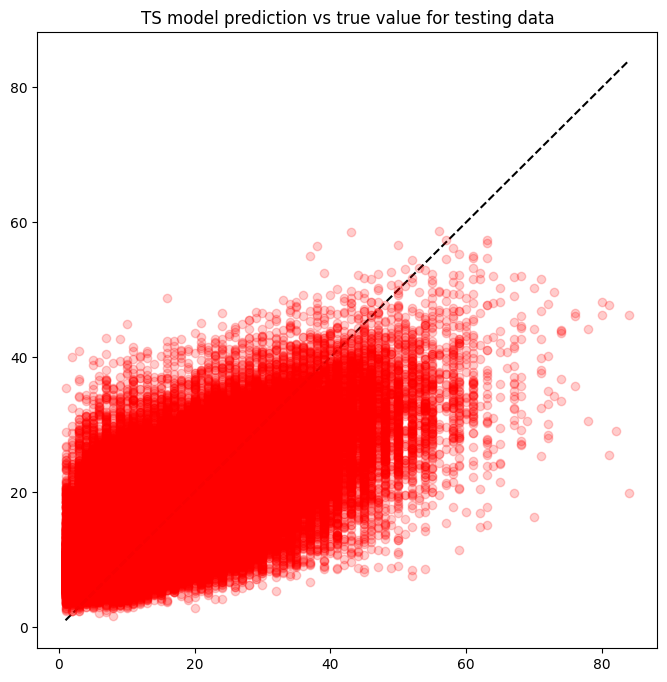

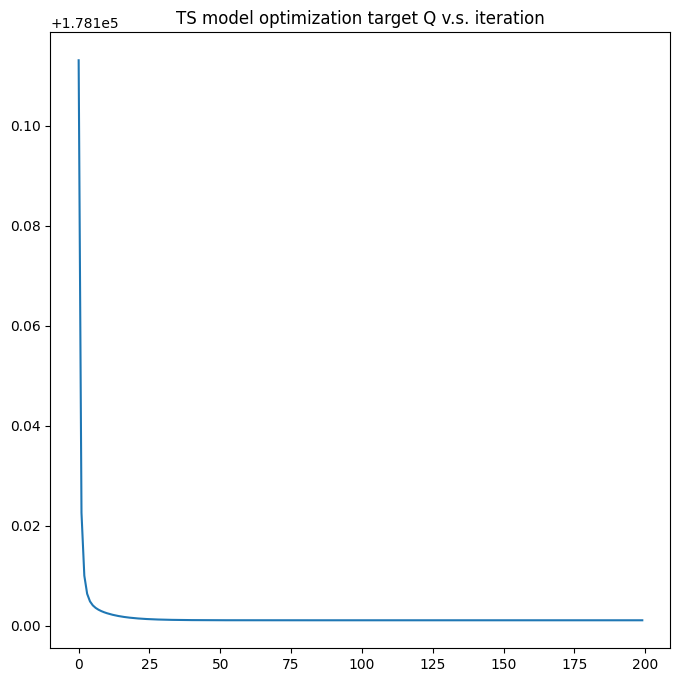

Epoch 1/50
16697/16697 [==============================] - 51s 3ms/step - loss: 45.3193 - root_mean_squared_error: 6.7320 - r_squared: 0.4361 - val_loss: 36.1671 - val_root_mean_squared_error: 6.0139 - val_r_squared: 0.3317
Epoch 2/50
16697/16697 [==============================] - 51s 3ms/step - loss: 35.2844 - root_mean_squared_error: 5.9401 - r_squared: 0.5574 - val_loss: 34.6925 - val_root_mean_squared_error: 5.8900 - val_r_squared: 0.3563
Epoch 3/50
16697/16697 [==============================] - 51s 3ms/step - loss: 34.2346 - root_mean_squared_error: 5.8510 - r_squared: 0.5692 - val_loss: 34.0778 - val_root_mean_squared_error: 5.8376 - val_r_squared: 0.3673
Epoch 4/50
16697/16697 [==============================] - 50s 3ms/step - loss: 33.7219 - root_mean_squared_error: 5.8071 - r_squared: 0.5762 - val_loss: 33.5566 - val_root_mean_squared_error: 5.7928 - val_r_squared: 0.3785
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 33.4401 - root_mean_squared_e

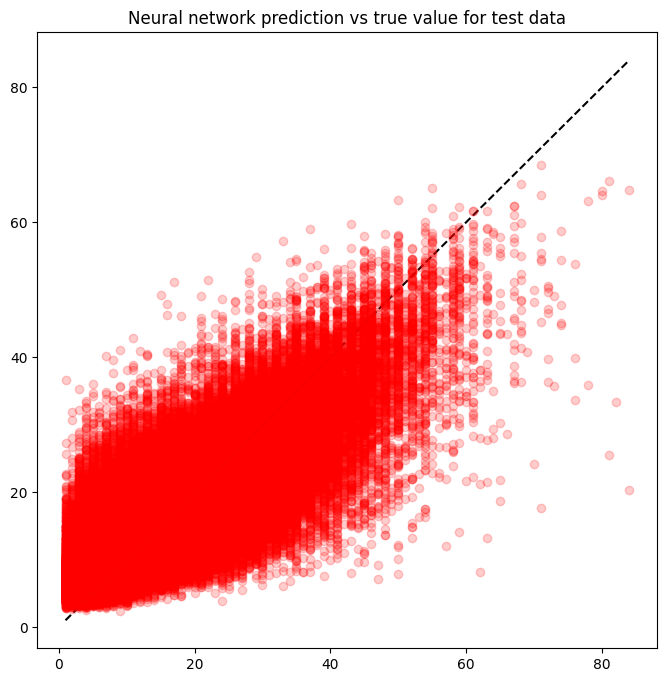

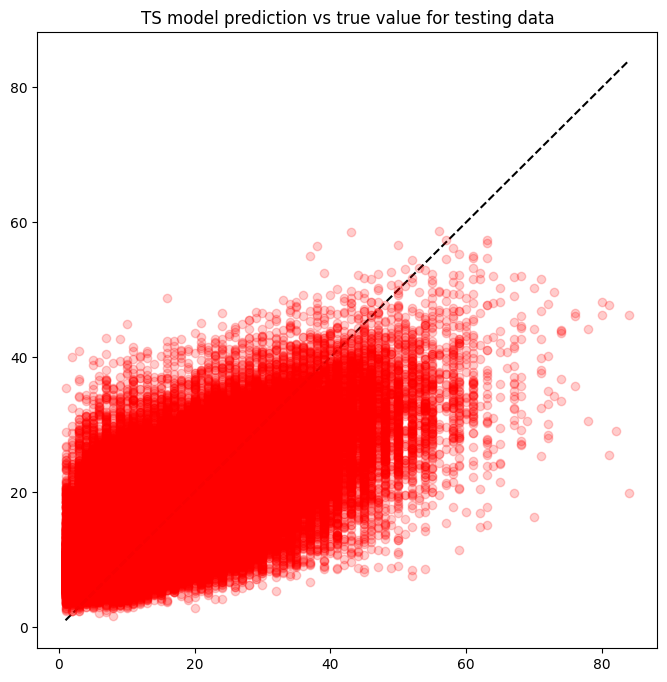

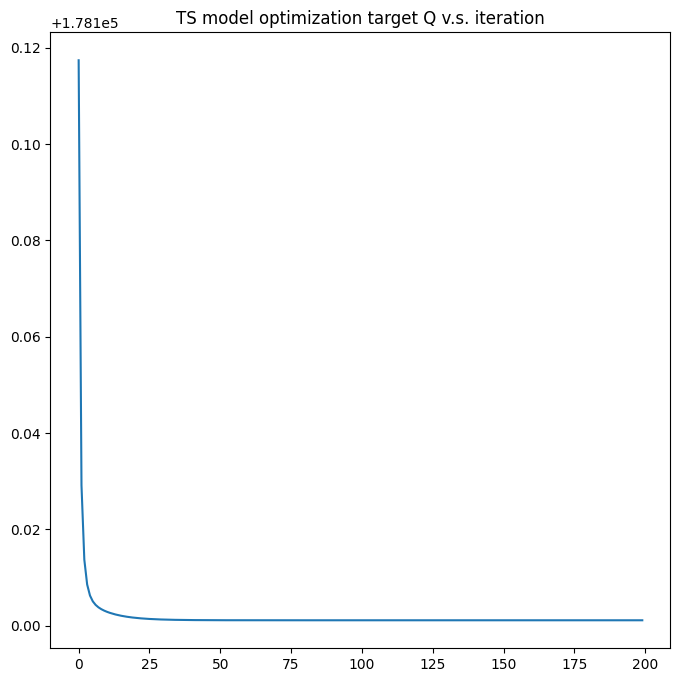

Epoch 1/50
16697/16697 [==============================] - 31s 2ms/step - loss: 45.8774 - root_mean_squared_error: 6.7733 - r_squared: 0.4307 - val_loss: 36.3776 - val_root_mean_squared_error: 6.0314 - val_r_squared: 0.3303
Epoch 2/50
16697/16697 [==============================] - 32s 2ms/step - loss: 35.4256 - root_mean_squared_error: 5.9519 - r_squared: 0.5563 - val_loss: 34.8638 - val_root_mean_squared_error: 5.9046 - val_r_squared: 0.3537
Epoch 3/50
16697/16697 [==============================] - 32s 2ms/step - loss: 34.2091 - root_mean_squared_error: 5.8489 - r_squared: 0.5707 - val_loss: 33.8406 - val_root_mean_squared_error: 5.8173 - val_r_squared: 0.3792
Epoch 4/50
16697/16697 [==============================] - 28s 2ms/step - loss: 33.5824 - root_mean_squared_error: 5.7950 - r_squared: 0.5765 - val_loss: 33.4166 - val_root_mean_squared_error: 5.7807 - val_r_squared: 0.3870
Epoch 5/50
16697/16697 [==============================] - 30s 2ms/step - loss: 33.2528 - root_mean_squared_e

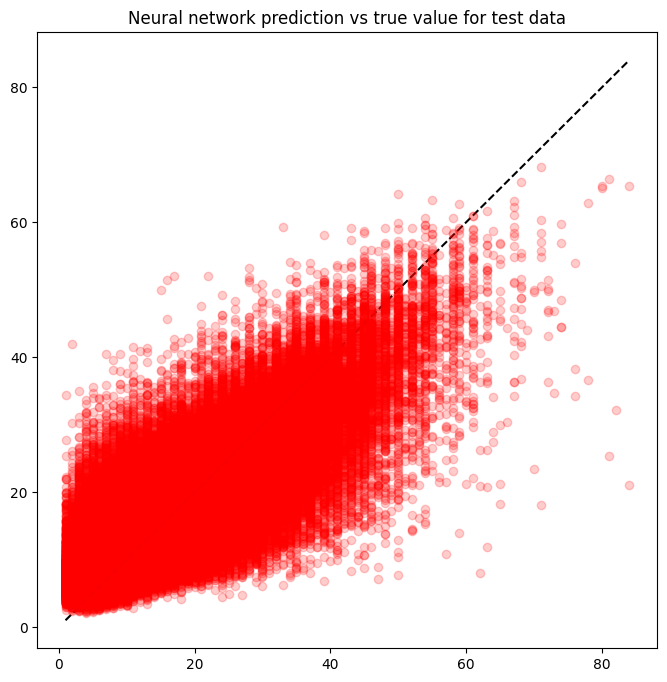

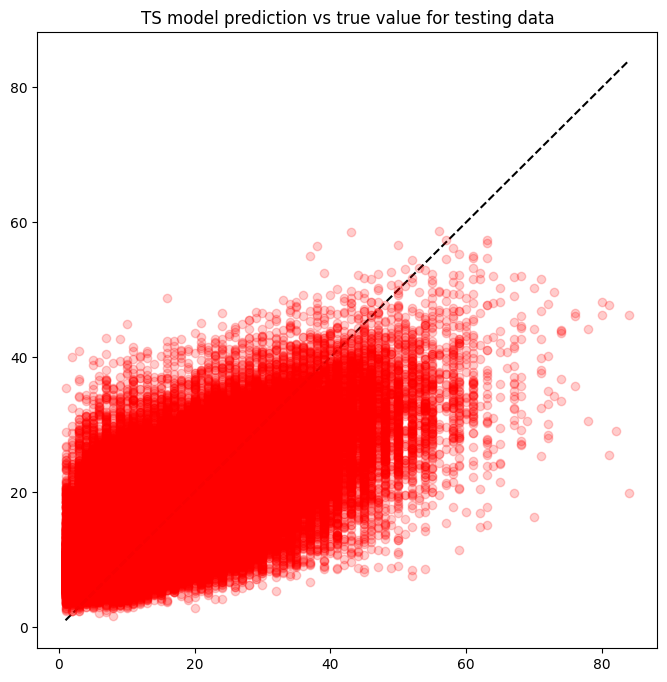

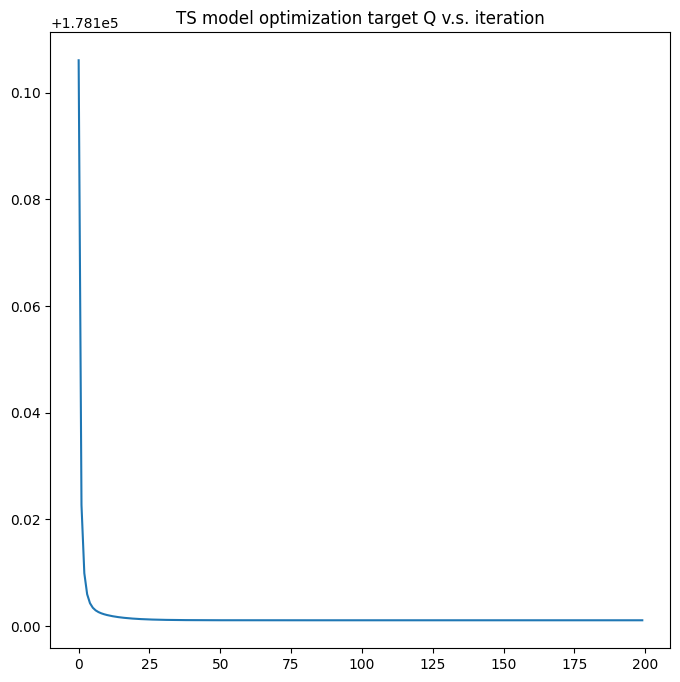

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 45.6798 - root_mean_squared_error: 6.7587 - r_squared: 0.4326 - val_loss: 36.3012 - val_root_mean_squared_error: 6.0250 - val_r_squared: 0.3355
Epoch 2/50
16697/16697 [==============================] - 29s 2ms/step - loss: 35.3315 - root_mean_squared_error: 5.9440 - r_squared: 0.5575 - val_loss: 34.6534 - val_root_mean_squared_error: 5.8867 - val_r_squared: 0.3702
Epoch 3/50
16697/16697 [==============================] - 30s 2ms/step - loss: 34.2010 - root_mean_squared_error: 5.8482 - r_squared: 0.5700 - val_loss: 33.8861 - val_root_mean_squared_error: 5.8212 - val_r_squared: 0.3788
Epoch 4/50
16697/16697 [==============================] - 31s 2ms/step - loss: 33.6681 - root_mean_squared_error: 5.8024 - r_squared: 0.5750 - val_loss: 33.6393 - val_root_mean_squared_error: 5.7999 - val_r_squared: 0.3734
Epoch 5/50
16697/16697 [==============================] - 30s 2ms/step - loss: 33.3915 - root_mean_squared_e

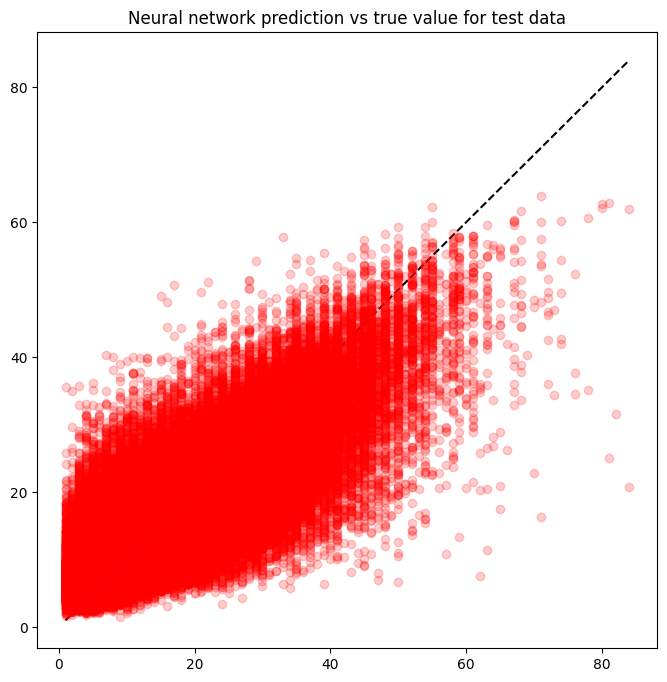

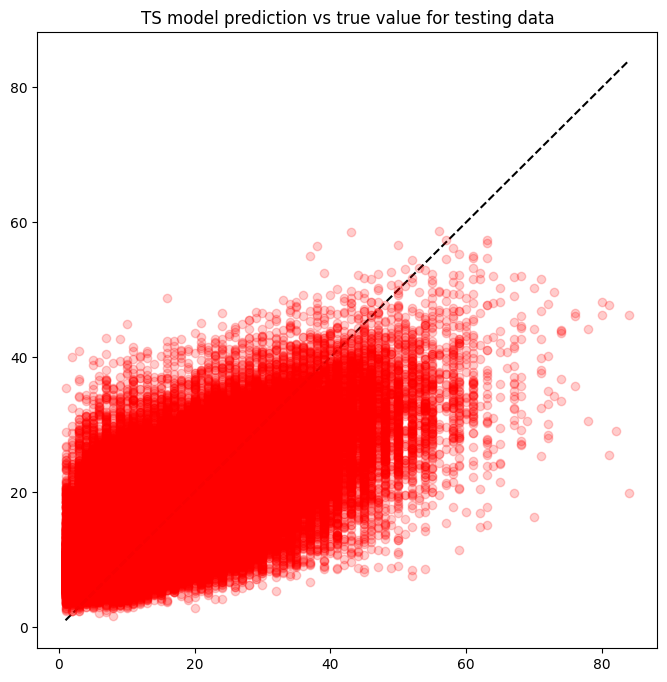

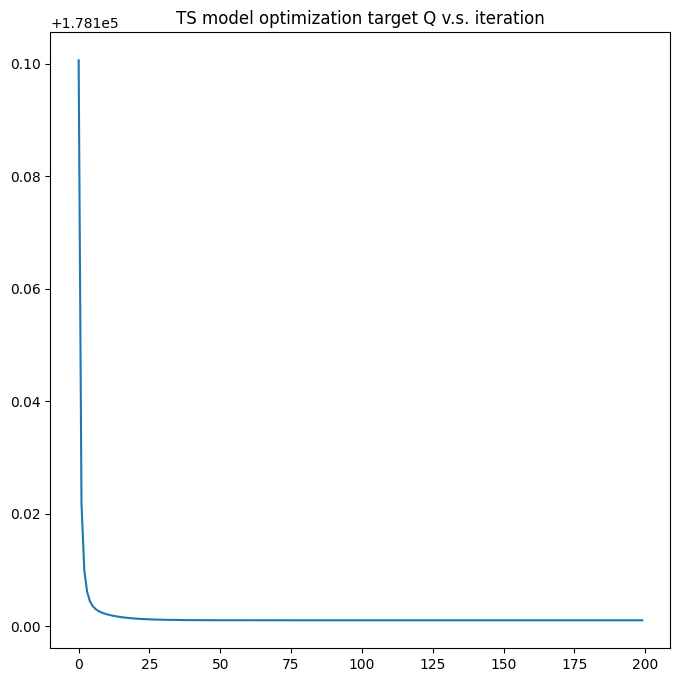

Epoch 1/50
16697/16697 [==============================] - 31s 2ms/step - loss: 46.9700 - root_mean_squared_error: 6.8535 - r_squared: 0.4179 - val_loss: 36.2109 - val_root_mean_squared_error: 6.0176 - val_r_squared: 0.3349
Epoch 2/50
16697/16697 [==============================] - 29s 2ms/step - loss: 35.2296 - root_mean_squared_error: 5.9355 - r_squared: 0.5587 - val_loss: 34.4799 - val_root_mean_squared_error: 5.8720 - val_r_squared: 0.3685
Epoch 3/50
16697/16697 [==============================] - 29s 2ms/step - loss: 34.0960 - root_mean_squared_error: 5.8392 - r_squared: 0.5710 - val_loss: 33.7197 - val_root_mean_squared_error: 5.8069 - val_r_squared: 0.3816
Epoch 4/50
16697/16697 [==============================] - 31s 2ms/step - loss: 33.5182 - root_mean_squared_error: 5.7895 - r_squared: 0.5779 - val_loss: 33.3090 - val_root_mean_squared_error: 5.7714 - val_r_squared: 0.3902
Epoch 5/50
16697/16697 [==============================] - 30s 2ms/step - loss: 33.2167 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.9605 - root_mean_squared_error: 5.6534 - r_squared: 0.5955 - val_loss: 32.1218 - val_root_mean_squared_error: 5.6676 - val_r_squared: 0.4051
Epoch 39/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.9365 - root_mean_squared_error: 5.6512 - r_squared: 0.5949 - val_loss: 31.9353 - val_root_mean_squared_error: 5.6511 - val_r_squared: 0.4086
Epoch 40/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.9370 - root_mean_squared_error: 5.6513 - r_squared: 0.5961 - val_loss: 32.0118 - val_root_mean_squared_error: 5.6579 - val_r_squared: 0.4095
Epoch 41/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.9246 - root_mean_squared_error: 5.6502 - r_squared: 0.5954 - val_loss: 31.9768 - val_root_mean_squared_error: 5.6548 - val_r_squared: 0.4102
Epoch 42/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.9274 - root_mean_squa

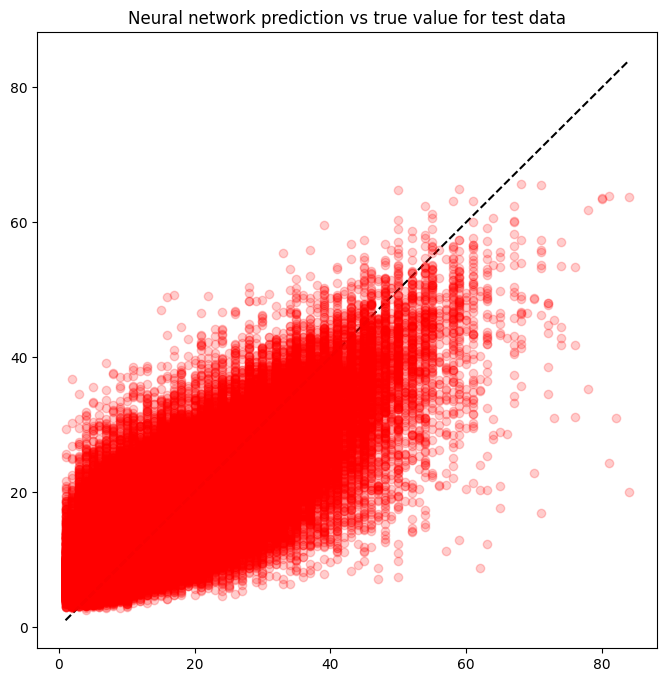

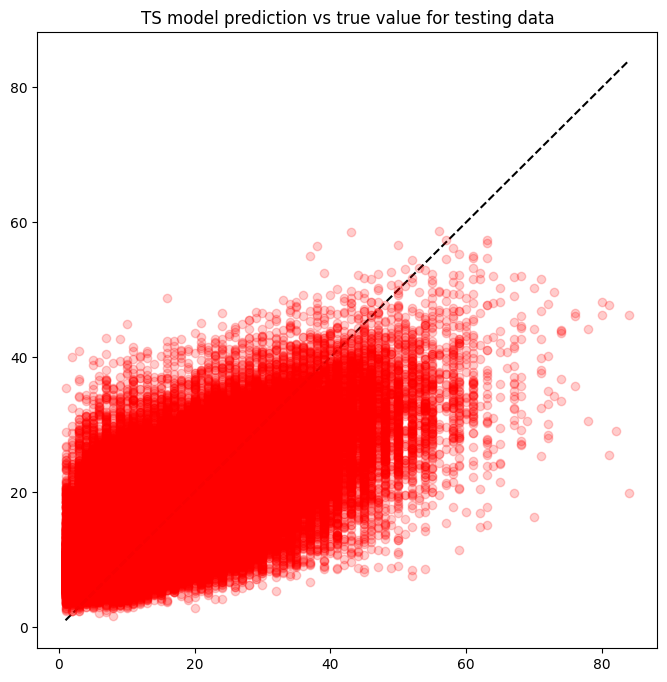

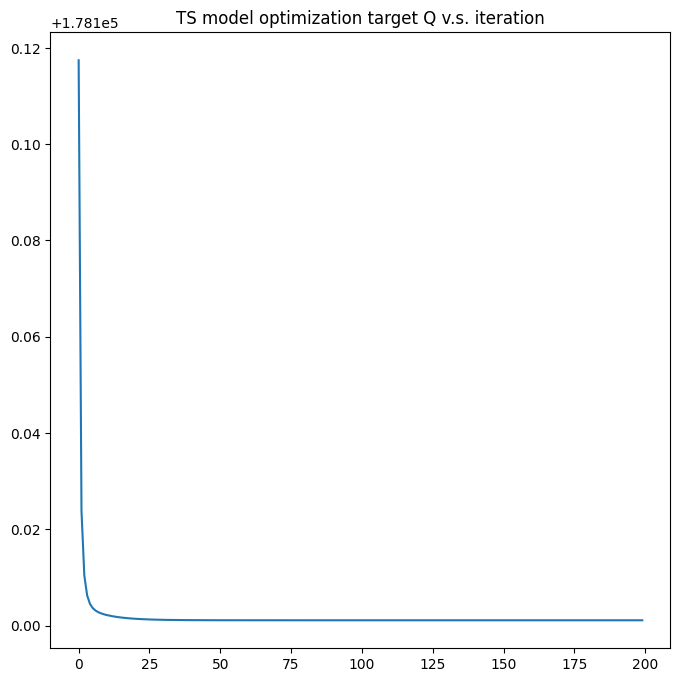

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 45.6886 - root_mean_squared_error: 6.7593 - r_squared: 0.4338 - val_loss: 36.4190 - val_root_mean_squared_error: 6.0348 - val_r_squared: 0.3352
Epoch 2/50
16697/16697 [==============================] - 32s 2ms/step - loss: 35.4849 - root_mean_squared_error: 5.9569 - r_squared: 0.5544 - val_loss: 34.8170 - val_root_mean_squared_error: 5.9006 - val_r_squared: 0.3651
Epoch 3/50
16697/16697 [==============================] - 32s 2ms/step - loss: 34.4348 - root_mean_squared_error: 5.8681 - r_squared: 0.5668 - val_loss: 34.0881 - val_root_mean_squared_error: 5.8385 - val_r_squared: 0.3717
Epoch 4/50
16697/16697 [==============================] - 31s 2ms/step - loss: 33.8900 - root_mean_squared_error: 5.8215 - r_squared: 0.5735 - val_loss: 33.6965 - val_root_mean_squared_error: 5.8049 - val_r_squared: 0.3850
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 33.5289 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.0584 - root_mean_squared_error: 5.6620 - r_squared: 0.5946 - val_loss: 32.2585 - val_root_mean_squared_error: 5.6797 - val_r_squared: 0.4017
Epoch 39/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.0491 - root_mean_squared_error: 5.6612 - r_squared: 0.5947 - val_loss: 32.2169 - val_root_mean_squared_error: 5.6760 - val_r_squared: 0.4000
Epoch 40/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.0383 - root_mean_squared_error: 5.6602 - r_squared: 0.5935 - val_loss: 32.2514 - val_root_mean_squared_error: 5.6790 - val_r_squared: 0.4026
Epoch 41/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.0382 - root_mean_squared_error: 5.6602 - r_squared: 0.5950 - val_loss: 32.1258 - val_root_mean_squared_error: 5.6680 - val_r_squared: 0.4083
Epoch 42/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.0253 - root_mean_squa

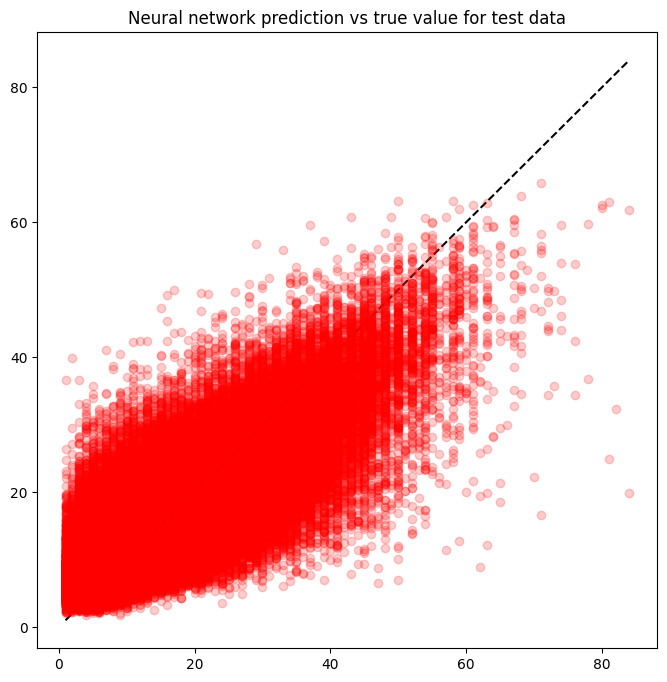

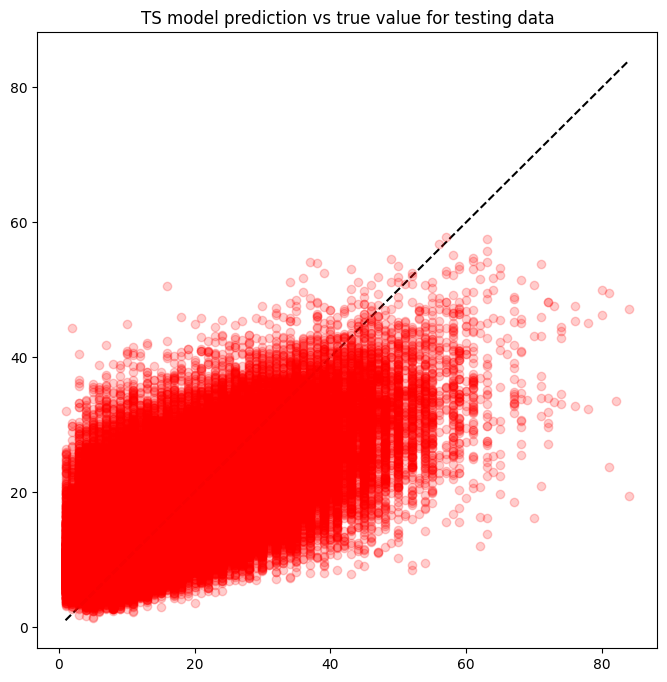

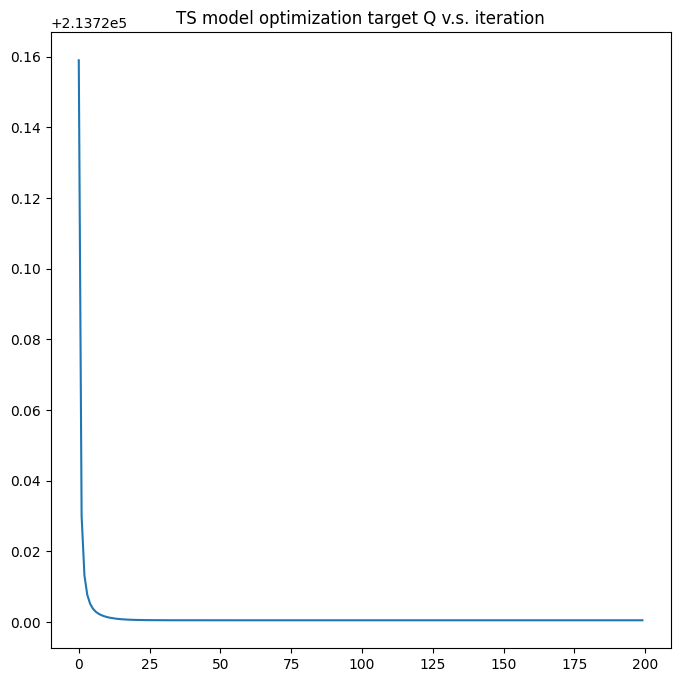

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 45.4069 - root_mean_squared_error: 6.7385 - r_squared: 0.4350 - val_loss: 35.9926 - val_root_mean_squared_error: 5.9994 - val_r_squared: 0.3401
Epoch 2/50
16697/16697 [==============================] - 30s 2ms/step - loss: 34.8571 - root_mean_squared_error: 5.9040 - r_squared: 0.5620 - val_loss: 34.3316 - val_root_mean_squared_error: 5.8593 - val_r_squared: 0.3642
Epoch 3/50
16697/16697 [==============================] - 32s 2ms/step - loss: 33.8115 - root_mean_squared_error: 5.8148 - r_squared: 0.5741 - val_loss: 33.5224 - val_root_mean_squared_error: 5.7899 - val_r_squared: 0.3766
Epoch 4/50
16697/16697 [==============================] - 32s 2ms/step - loss: 33.3200 - root_mean_squared_error: 5.7723 - r_squared: 0.5800 - val_loss: 33.1228 - val_root_mean_squared_error: 5.7552 - val_r_squared: 0.3848
Epoch 5/50
16697/16697 [==============================] - 32s 2ms/step - loss: 33.0253 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.5268 - root_mean_squared_error: 5.6149 - r_squared: 0.6004 - val_loss: 31.5800 - val_root_mean_squared_error: 5.6196 - val_r_squared: 0.4129
Epoch 39/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.5079 - root_mean_squared_error: 5.6132 - r_squared: 0.6001 - val_loss: 31.5952 - val_root_mean_squared_error: 5.6210 - val_r_squared: 0.4104
Epoch 40/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.4934 - root_mean_squared_error: 5.6119 - r_squared: 0.6005 - val_loss: 31.6284 - val_root_mean_squared_error: 5.6239 - val_r_squared: 0.4122
Epoch 41/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.4959 - root_mean_squared_error: 5.6121 - r_squared: 0.6011 - val_loss: 31.5124 - val_root_mean_squared_error: 5.6136 - val_r_squared: 0.4146
Epoch 42/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.4792 - root_mean_squa

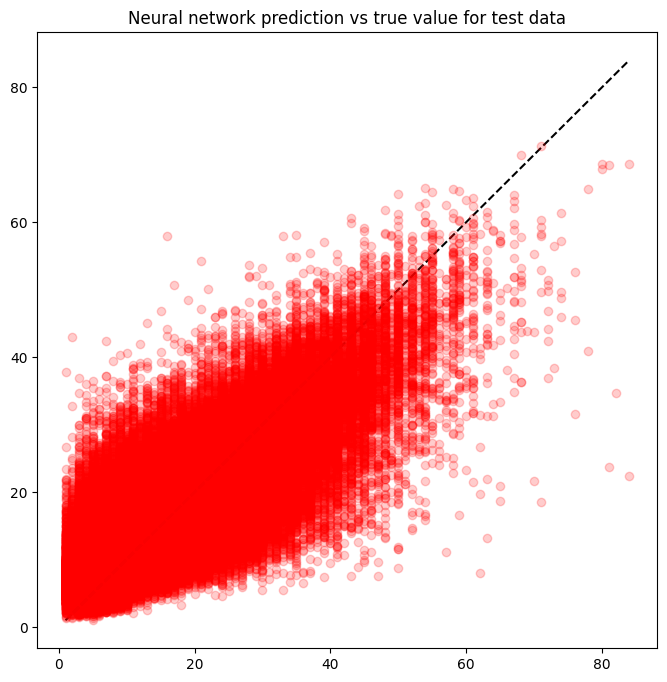

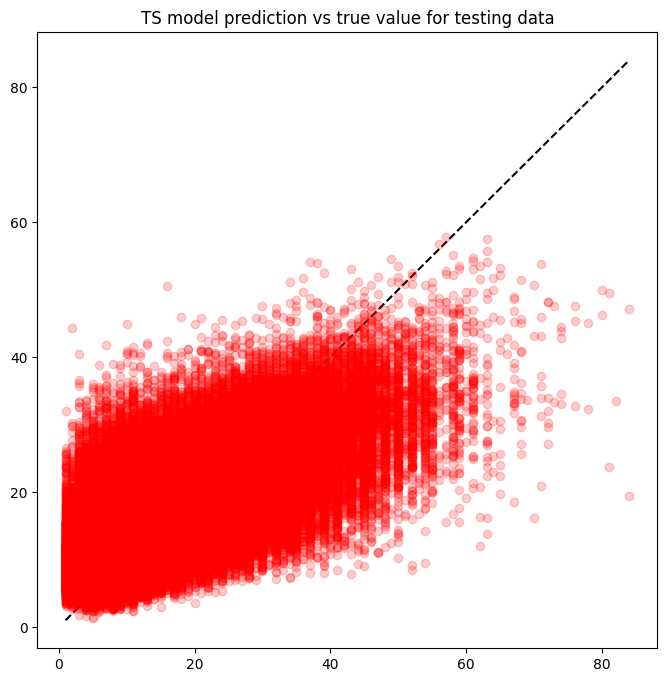

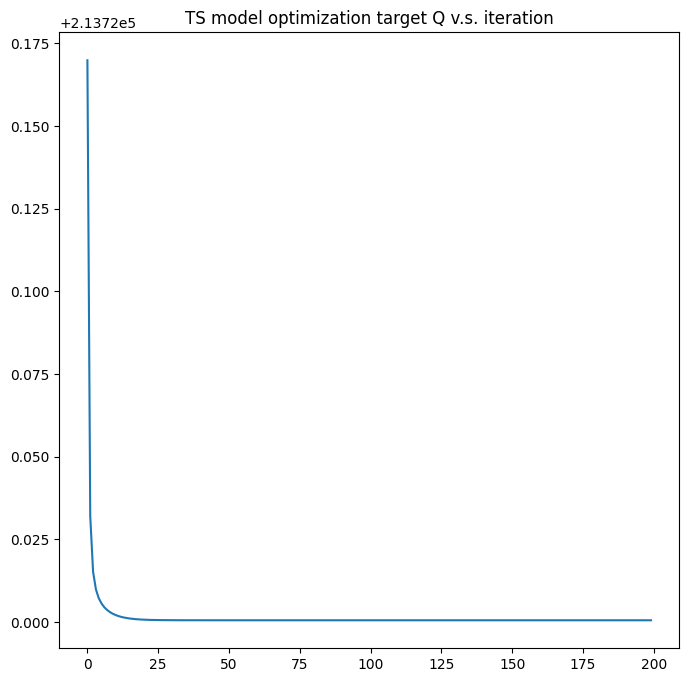

Epoch 1/50
16697/16697 [==============================] - 31s 2ms/step - loss: 46.4151 - root_mean_squared_error: 6.8129 - r_squared: 0.4278 - val_loss: 35.9265 - val_root_mean_squared_error: 5.9939 - val_r_squared: 0.3345
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 34.6602 - root_mean_squared_error: 5.8873 - r_squared: 0.5654 - val_loss: 34.0008 - val_root_mean_squared_error: 5.8310 - val_r_squared: 0.3736
Epoch 3/50
16697/16697 [==============================] - 30s 2ms/step - loss: 33.5017 - root_mean_squared_error: 5.7881 - r_squared: 0.5776 - val_loss: 33.4012 - val_root_mean_squared_error: 5.7794 - val_r_squared: 0.3756
Epoch 4/50
16697/16697 [==============================] - 30s 2ms/step - loss: 33.0467 - root_mean_squared_error: 5.7486 - r_squared: 0.5826 - val_loss: 32.9419 - val_root_mean_squared_error: 5.7395 - val_r_squared: 0.3863
Epoch 5/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.7969 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.5101 - root_mean_squared_error: 5.6134 - r_squared: 0.6005 - val_loss: 31.7170 - val_root_mean_squared_error: 5.6318 - val_r_squared: 0.4111
Epoch 39/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.5001 - root_mean_squared_error: 5.6125 - r_squared: 0.6011 - val_loss: 31.6772 - val_root_mean_squared_error: 5.6283 - val_r_squared: 0.4127
Epoch 40/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.4852 - root_mean_squared_error: 5.6112 - r_squared: 0.6003 - val_loss: 31.7113 - val_root_mean_squared_error: 5.6313 - val_r_squared: 0.4101
Epoch 41/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.4763 - root_mean_squared_error: 5.6104 - r_squared: 0.6009 - val_loss: 31.6141 - val_root_mean_squared_error: 5.6226 - val_r_squared: 0.4130
Epoch 42/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.4772 - root_mean_squa

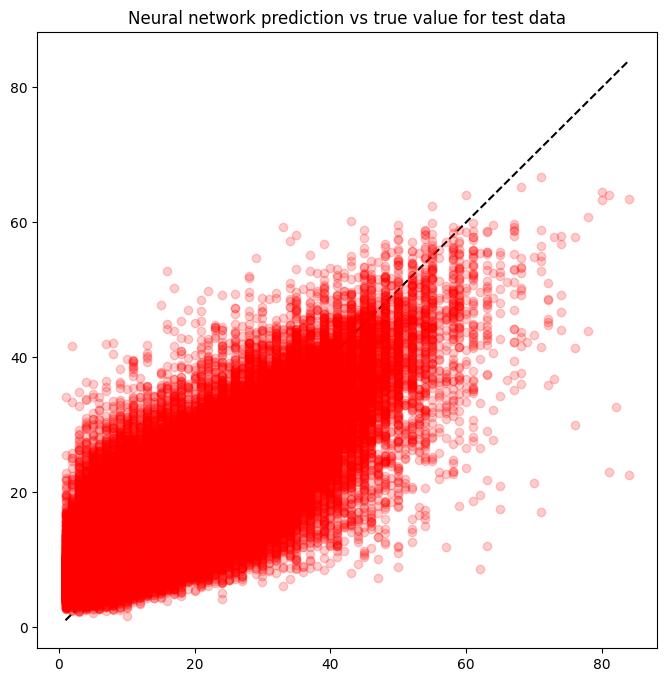

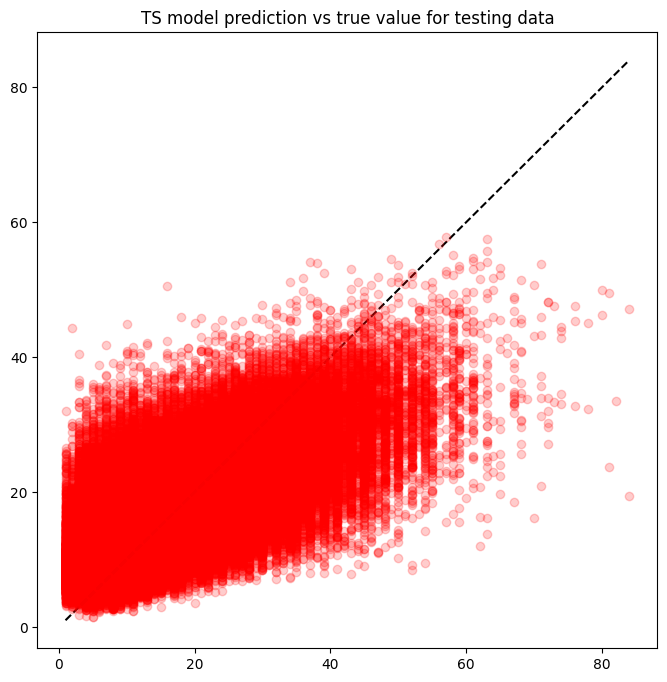

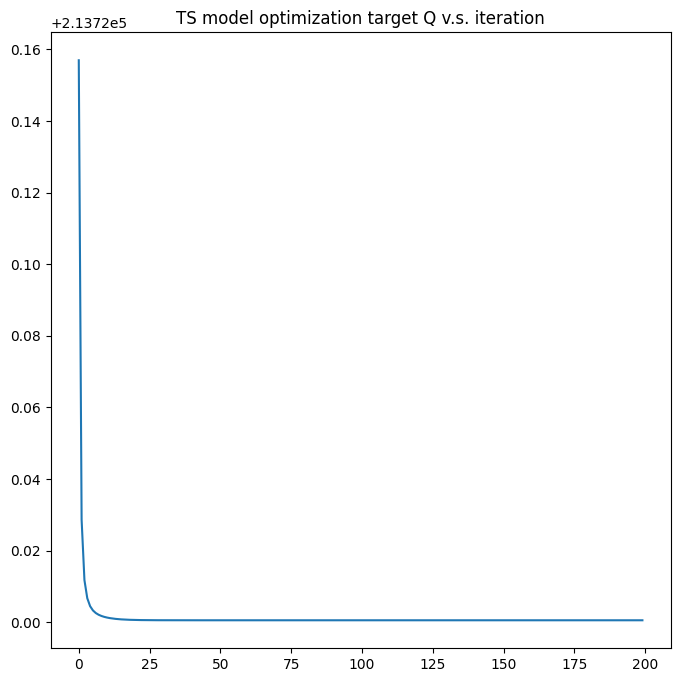

Epoch 1/50
16697/16697 [==============================] - 28s 2ms/step - loss: 46.1348 - root_mean_squared_error: 6.7923 - r_squared: 0.4285 - val_loss: 35.9622 - val_root_mean_squared_error: 5.9968 - val_r_squared: 0.3375
Epoch 2/50
16697/16697 [==============================] - 30s 2ms/step - loss: 34.8205 - root_mean_squared_error: 5.9009 - r_squared: 0.5627 - val_loss: 34.3499 - val_root_mean_squared_error: 5.8609 - val_r_squared: 0.3592
Epoch 3/50
16697/16697 [==============================] - 28s 2ms/step - loss: 33.7461 - root_mean_squared_error: 5.8091 - r_squared: 0.5748 - val_loss: 33.5241 - val_root_mean_squared_error: 5.7900 - val_r_squared: 0.3751
Epoch 4/50
16697/16697 [==============================] - 28s 2ms/step - loss: 33.1822 - root_mean_squared_error: 5.7604 - r_squared: 0.5823 - val_loss: 33.5158 - val_root_mean_squared_error: 5.7893 - val_r_squared: 0.3673
Epoch 5/50
16697/16697 [==============================] - 29s 2ms/step - loss: 32.9024 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.5610 - root_mean_squared_error: 5.6179 - r_squared: 0.6005 - val_loss: 31.6708 - val_root_mean_squared_error: 5.6277 - val_r_squared: 0.4148
Epoch 39/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.5485 - root_mean_squared_error: 5.6168 - r_squared: 0.6008 - val_loss: 31.5942 - val_root_mean_squared_error: 5.6209 - val_r_squared: 0.4121
Epoch 40/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.5398 - root_mean_squared_error: 5.6160 - r_squared: 0.6007 - val_loss: 31.7013 - val_root_mean_squared_error: 5.6304 - val_r_squared: 0.4132
Epoch 41/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.5344 - root_mean_squared_error: 5.6156 - r_squared: 0.5999 - val_loss: 31.5946 - val_root_mean_squared_error: 5.6209 - val_r_squared: 0.4128
Epoch 42/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.5118 - root_mean_squa

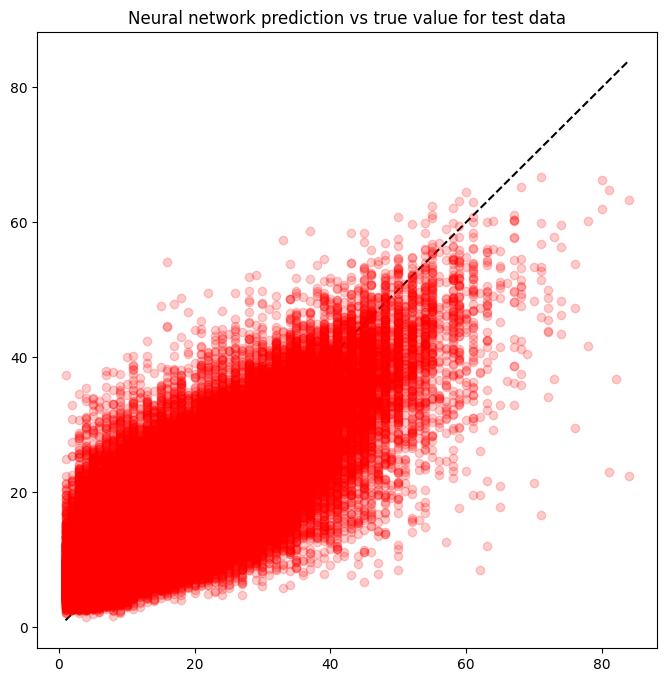

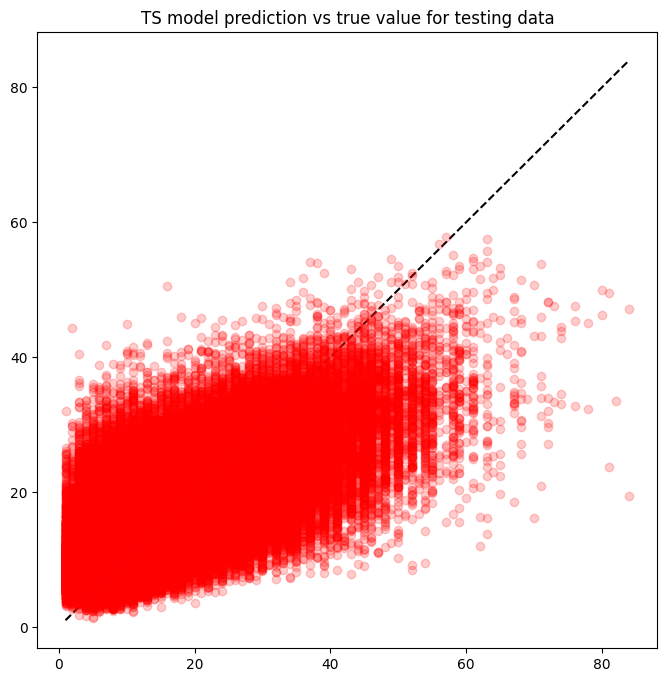

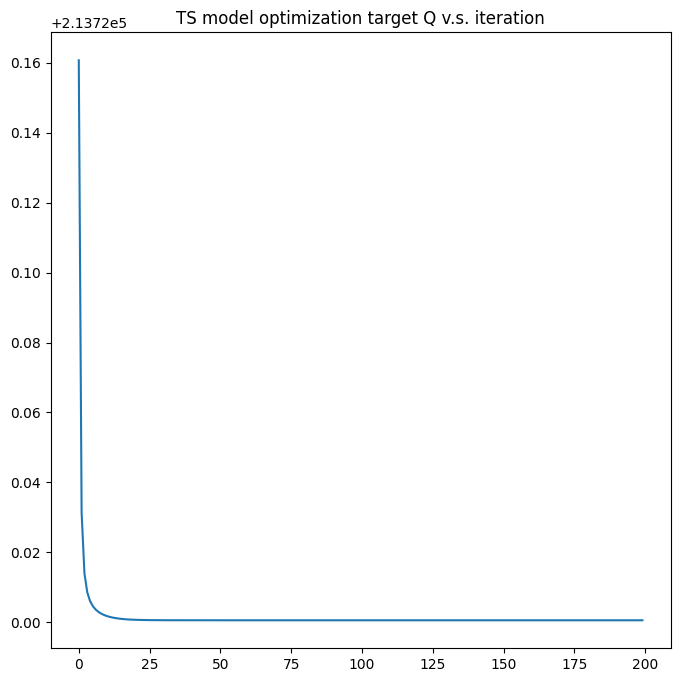

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 46.9764 - root_mean_squared_error: 6.8539 - r_squared: 0.4176 - val_loss: 35.5781 - val_root_mean_squared_error: 5.9647 - val_r_squared: 0.3472
Epoch 2/50
16697/16697 [==============================] - 32s 2ms/step - loss: 34.5339 - root_mean_squared_error: 5.8766 - r_squared: 0.5668 - val_loss: 33.9369 - val_root_mean_squared_error: 5.8255 - val_r_squared: 0.3691
Epoch 3/50
16697/16697 [==============================] - 32s 2ms/step - loss: 33.4881 - root_mean_squared_error: 5.7869 - r_squared: 0.5778 - val_loss: 33.3105 - val_root_mean_squared_error: 5.7715 - val_r_squared: 0.3764
Epoch 4/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.9860 - root_mean_squared_error: 5.7433 - r_squared: 0.5837 - val_loss: 33.0019 - val_root_mean_squared_error: 5.7447 - val_r_squared: 0.3800
Epoch 5/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.7153 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.4757 - root_mean_squared_error: 5.6103 - r_squared: 0.6011 - val_loss: 31.5429 - val_root_mean_squared_error: 5.6163 - val_r_squared: 0.4134
Epoch 39/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.4649 - root_mean_squared_error: 5.6094 - r_squared: 0.6010 - val_loss: 31.6088 - val_root_mean_squared_error: 5.6222 - val_r_squared: 0.4134
Epoch 40/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.4554 - root_mean_squared_error: 5.6085 - r_squared: 0.6012 - val_loss: 31.5429 - val_root_mean_squared_error: 5.6163 - val_r_squared: 0.4140
Epoch 41/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.4493 - root_mean_squared_error: 5.6080 - r_squared: 0.6023 - val_loss: 31.7956 - val_root_mean_squared_error: 5.6388 - val_r_squared: 0.4137
Epoch 42/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.4442 - root_mean_squa

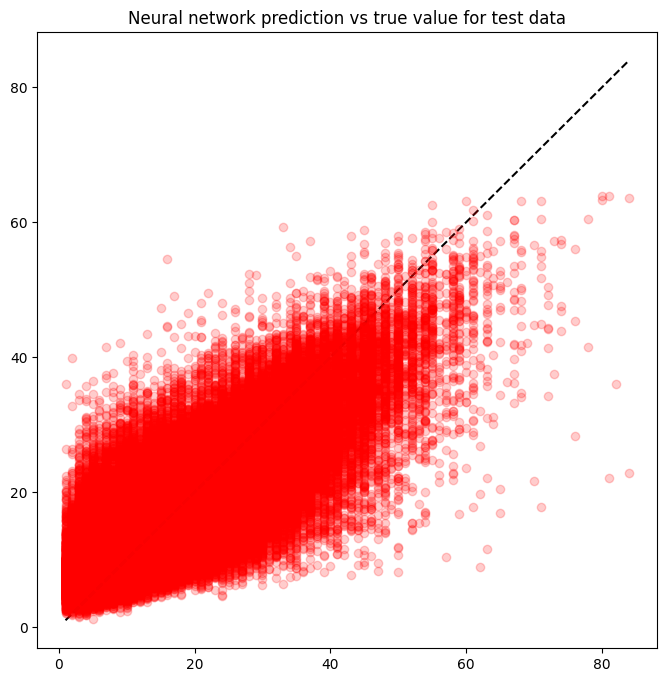

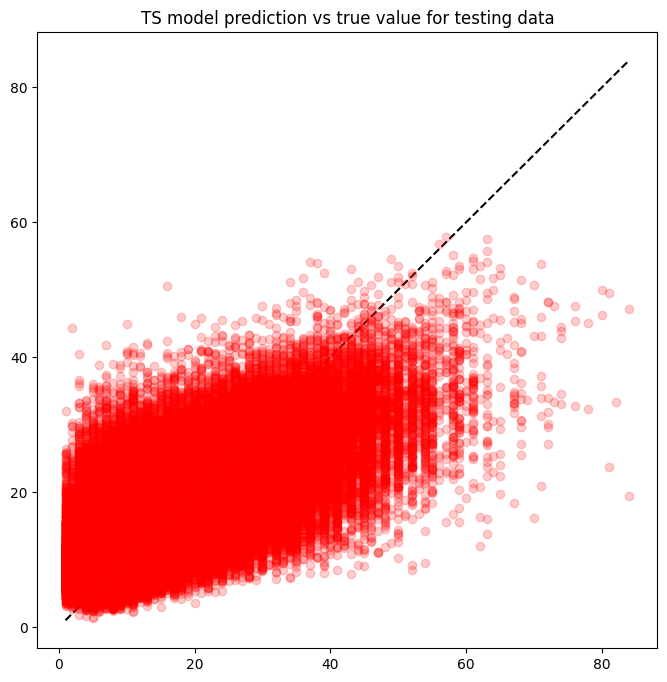

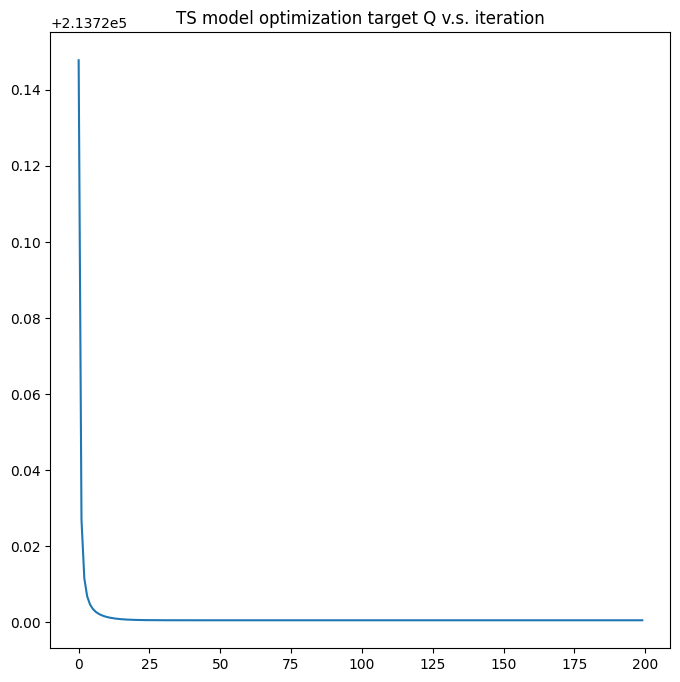

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 45.5543 - root_mean_squared_error: 6.7494 - r_squared: 0.4348 - val_loss: 35.8003 - val_root_mean_squared_error: 5.9833 - val_r_squared: 0.3322
Epoch 2/50
16697/16697 [==============================] - 32s 2ms/step - loss: 34.8087 - root_mean_squared_error: 5.8999 - r_squared: 0.5626 - val_loss: 34.2136 - val_root_mean_squared_error: 5.8492 - val_r_squared: 0.3674
Epoch 3/50
16697/16697 [==============================] - 32s 2ms/step - loss: 33.7892 - root_mean_squared_error: 5.8128 - r_squared: 0.5744 - val_loss: 33.5972 - val_root_mean_squared_error: 5.7963 - val_r_squared: 0.3745
Epoch 4/50
16697/16697 [==============================] - 31s 2ms/step - loss: 33.2367 - root_mean_squared_error: 5.7651 - r_squared: 0.5815 - val_loss: 33.1698 - val_root_mean_squared_error: 5.7593 - val_r_squared: 0.3812
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.8779 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.6827 - root_mean_squared_error: 5.6287 - r_squared: 0.5982 - val_loss: 31.7483 - val_root_mean_squared_error: 5.6346 - val_r_squared: 0.4071
Epoch 39/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.6714 - root_mean_squared_error: 5.6277 - r_squared: 0.5993 - val_loss: 31.7345 - val_root_mean_squared_error: 5.6333 - val_r_squared: 0.4076
Epoch 40/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.6537 - root_mean_squared_error: 5.6262 - r_squared: 0.5992 - val_loss: 31.8049 - val_root_mean_squared_error: 5.6396 - val_r_squared: 0.4110
Epoch 41/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.6402 - root_mean_squared_error: 5.6250 - r_squared: 0.5987 - val_loss: 31.7450 - val_root_mean_squared_error: 5.6343 - val_r_squared: 0.4122
Epoch 42/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.6247 - root_mean_squa

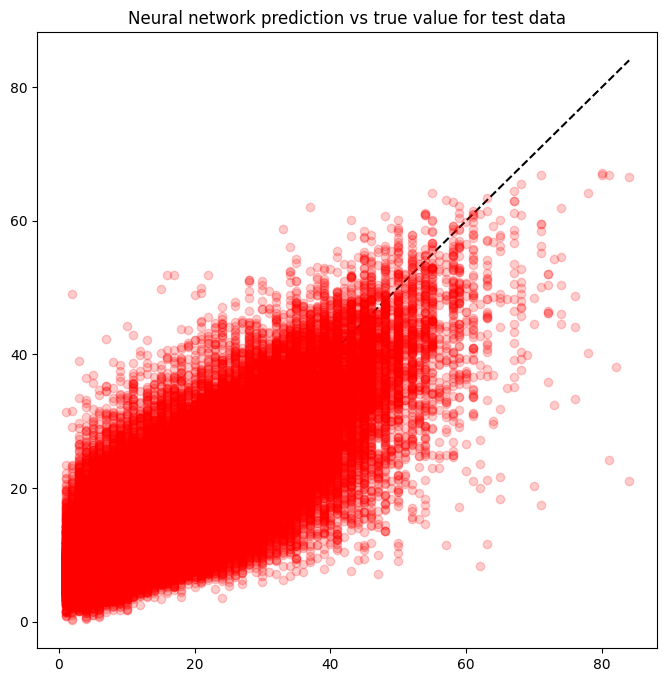

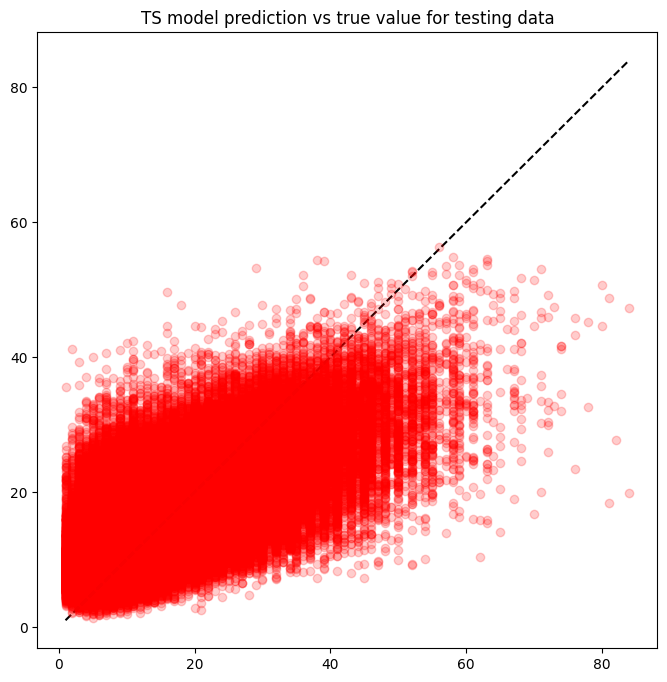

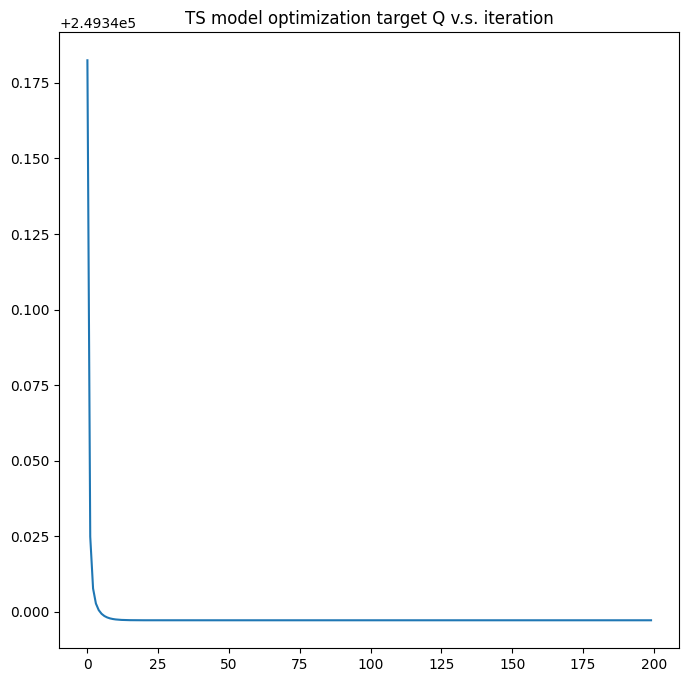

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 44.1186 - root_mean_squared_error: 6.6422 - r_squared: 0.4501 - val_loss: 34.5849 - val_root_mean_squared_error: 5.8809 - val_r_squared: 0.3552
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 33.4037 - root_mean_squared_error: 5.7796 - r_squared: 0.5795 - val_loss: 33.1017 - val_root_mean_squared_error: 5.7534 - val_r_squared: 0.3832
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.7050 - root_mean_squared_error: 5.7188 - r_squared: 0.5866 - val_loss: 32.5099 - val_root_mean_squared_error: 5.7017 - val_r_squared: 0.4007
Epoch 4/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.3998 - root_mean_squared_error: 5.6921 - r_squared: 0.5900 - val_loss: 32.4601 - val_root_mean_squared_error: 5.6974 - val_r_squared: 0.4001
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.2512 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.3551 - root_mean_squared_error: 5.5996 - r_squared: 0.6027 - val_loss: 31.5131 - val_root_mean_squared_error: 5.6136 - val_r_squared: 0.4180
Epoch 39/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.3559 - root_mean_squared_error: 5.5996 - r_squared: 0.6029 - val_loss: 31.6362 - val_root_mean_squared_error: 5.6246 - val_r_squared: 0.4094
Epoch 40/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.3426 - root_mean_squared_error: 5.5984 - r_squared: 0.6020 - val_loss: 31.6108 - val_root_mean_squared_error: 5.6224 - val_r_squared: 0.4165
Epoch 41/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.3452 - root_mean_squared_error: 5.5987 - r_squared: 0.6029 - val_loss: 31.4637 - val_root_mean_squared_error: 5.6093 - val_r_squared: 0.4138
Epoch 42/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.3286 - root_mean_squa

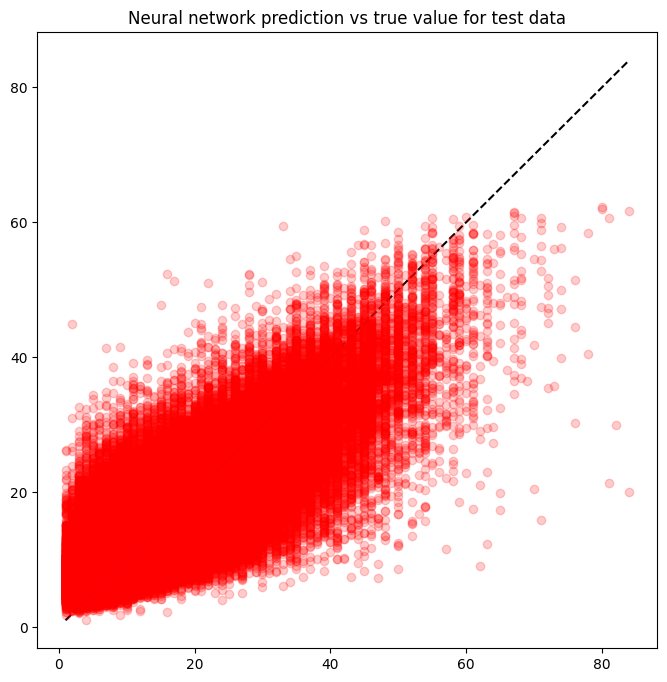

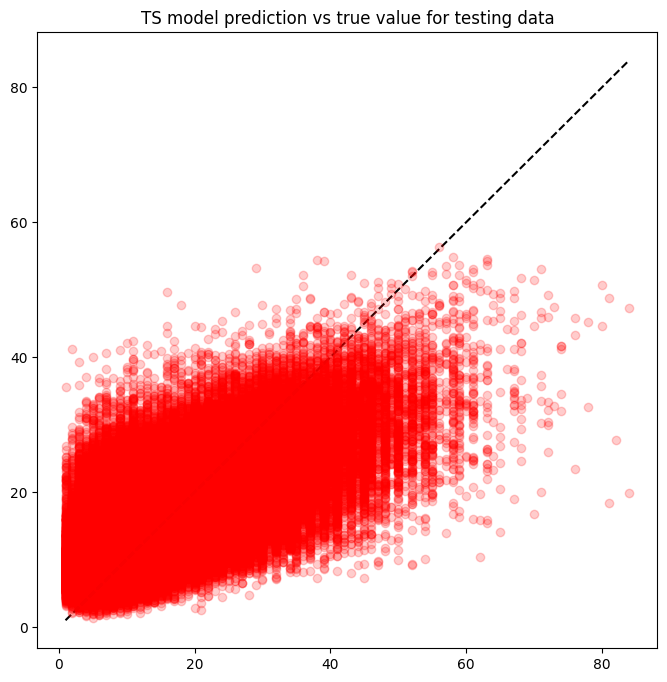

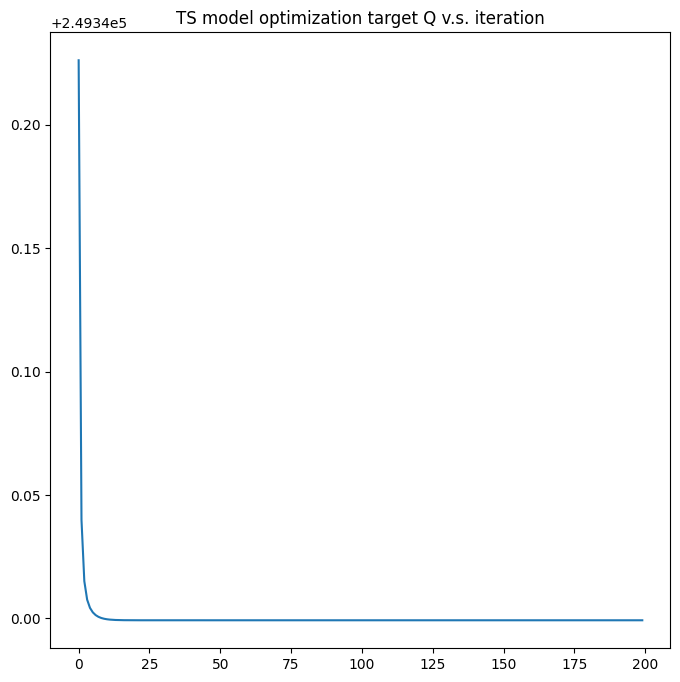

Epoch 1/50
16697/16697 [==============================] - 30s 2ms/step - loss: 44.6109 - root_mean_squared_error: 6.6791 - r_squared: 0.4469 - val_loss: 34.2676 - val_root_mean_squared_error: 5.8539 - val_r_squared: 0.3628
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 33.4680 - root_mean_squared_error: 5.7852 - r_squared: 0.5791 - val_loss: 32.9820 - val_root_mean_squared_error: 5.7430 - val_r_squared: 0.3901
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.7097 - root_mean_squared_error: 5.7192 - r_squared: 0.5868 - val_loss: 32.6831 - val_root_mean_squared_error: 5.7169 - val_r_squared: 0.3958
Epoch 4/50
16697/16697 [==============================] - 29s 2ms/step - loss: 32.4200 - root_mean_squared_error: 5.6939 - r_squared: 0.5904 - val_loss: 32.4925 - val_root_mean_squared_error: 5.7002 - val_r_squared: 0.3962
Epoch 5/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.2697 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 28s 2ms/step - loss: 31.2461 - root_mean_squared_error: 5.5898 - r_squared: 0.6045 - val_loss: 31.5121 - val_root_mean_squared_error: 5.6136 - val_r_squared: 0.4124
Epoch 39/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.2235 - root_mean_squared_error: 5.5878 - r_squared: 0.6046 - val_loss: 31.4304 - val_root_mean_squared_error: 5.6063 - val_r_squared: 0.4202
Epoch 40/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.2136 - root_mean_squared_error: 5.5869 - r_squared: 0.6040 - val_loss: 31.3869 - val_root_mean_squared_error: 5.6024 - val_r_squared: 0.4210
Epoch 41/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.1968 - root_mean_squared_error: 5.5854 - r_squared: 0.6043 - val_loss: 31.4270 - val_root_mean_squared_error: 5.6060 - val_r_squared: 0.4146
Epoch 42/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.1744 - root_mean_squa

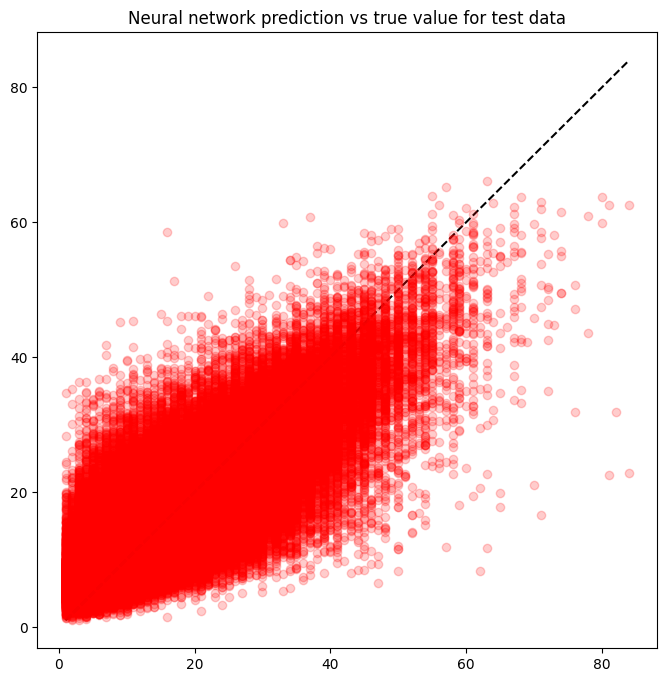

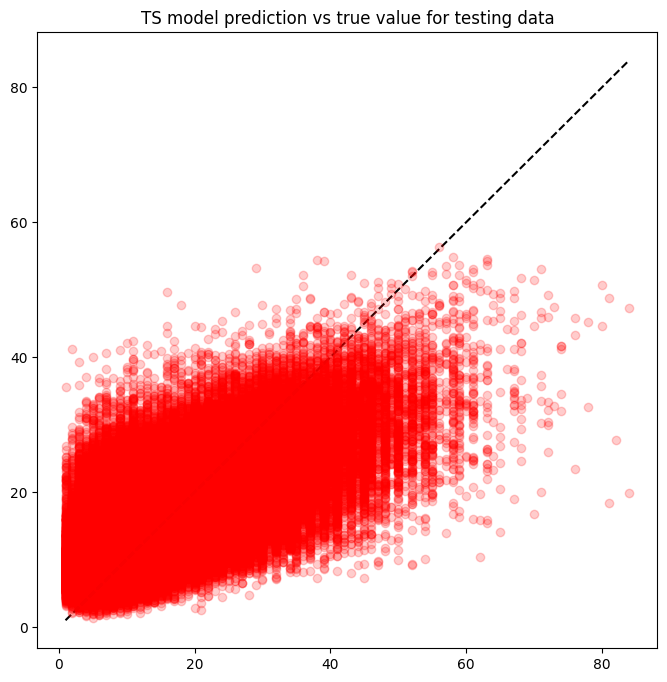

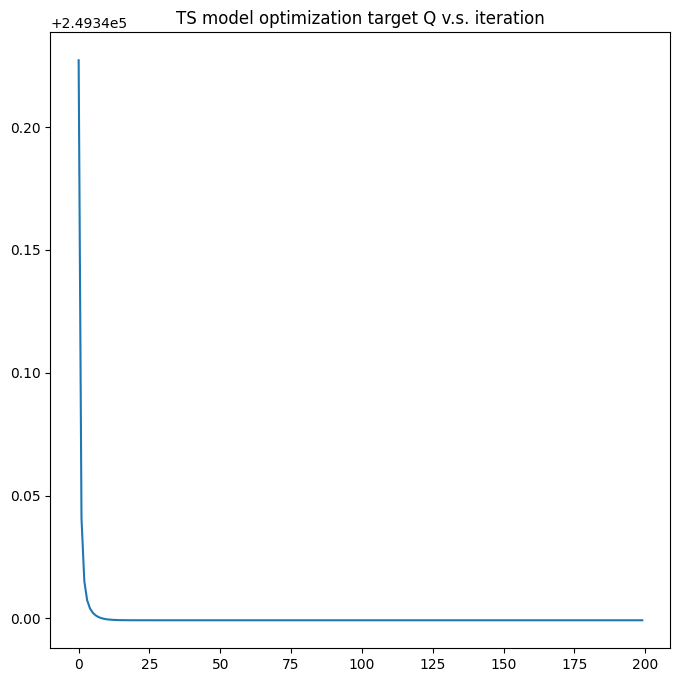

Epoch 1/50
16697/16697 [==============================] - 30s 2ms/step - loss: 43.5641 - root_mean_squared_error: 6.6003 - r_squared: 0.4585 - val_loss: 33.9826 - val_root_mean_squared_error: 5.8295 - val_r_squared: 0.3739
Epoch 2/50
16697/16697 [==============================] - 30s 2ms/step - loss: 33.3141 - root_mean_squared_error: 5.7718 - r_squared: 0.5798 - val_loss: 32.9622 - val_root_mean_squared_error: 5.7413 - val_r_squared: 0.3911
Epoch 3/50
16697/16697 [==============================] - 29s 2ms/step - loss: 32.6541 - root_mean_squared_error: 5.7144 - r_squared: 0.5874 - val_loss: 32.6021 - val_root_mean_squared_error: 5.7098 - val_r_squared: 0.3910
Epoch 4/50
16697/16697 [==============================] - 28s 2ms/step - loss: 32.3905 - root_mean_squared_error: 5.6913 - r_squared: 0.5907 - val_loss: 32.3640 - val_root_mean_squared_error: 5.6889 - val_r_squared: 0.3986
Epoch 5/50
16697/16697 [==============================] - 27s 2ms/step - loss: 32.2279 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.1671 - root_mean_squared_error: 5.5828 - r_squared: 0.6053 - val_loss: 31.2689 - val_root_mean_squared_error: 5.5919 - val_r_squared: 0.4212
Epoch 39/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.1587 - root_mean_squared_error: 5.5820 - r_squared: 0.6045 - val_loss: 31.3215 - val_root_mean_squared_error: 5.5966 - val_r_squared: 0.4160
Epoch 40/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.1449 - root_mean_squared_error: 5.5808 - r_squared: 0.6044 - val_loss: 31.3825 - val_root_mean_squared_error: 5.6020 - val_r_squared: 0.4168
Epoch 41/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.1328 - root_mean_squared_error: 5.5797 - r_squared: 0.6050 - val_loss: 31.2707 - val_root_mean_squared_error: 5.5920 - val_r_squared: 0.4204
Epoch 42/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.1240 - root_mean_squa

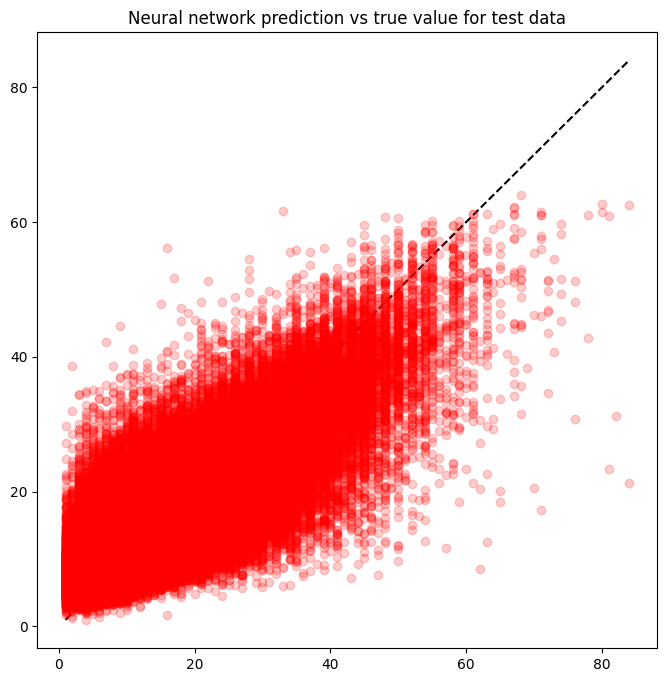

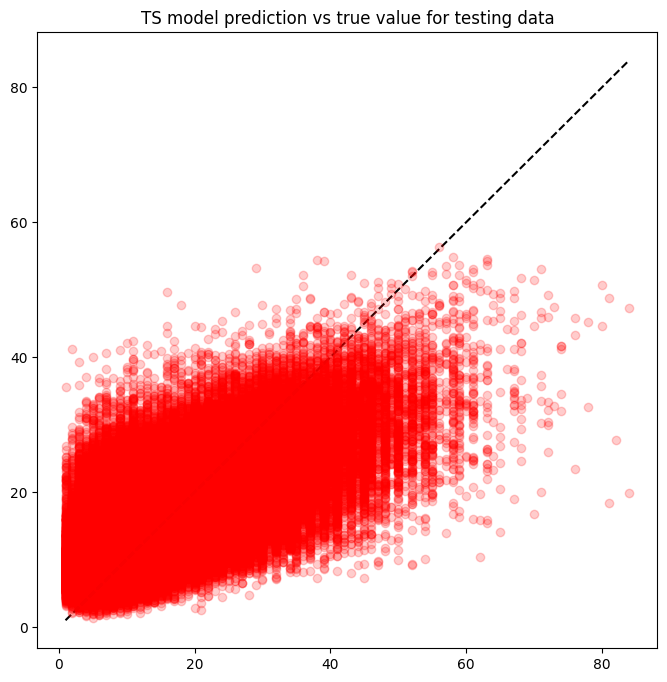

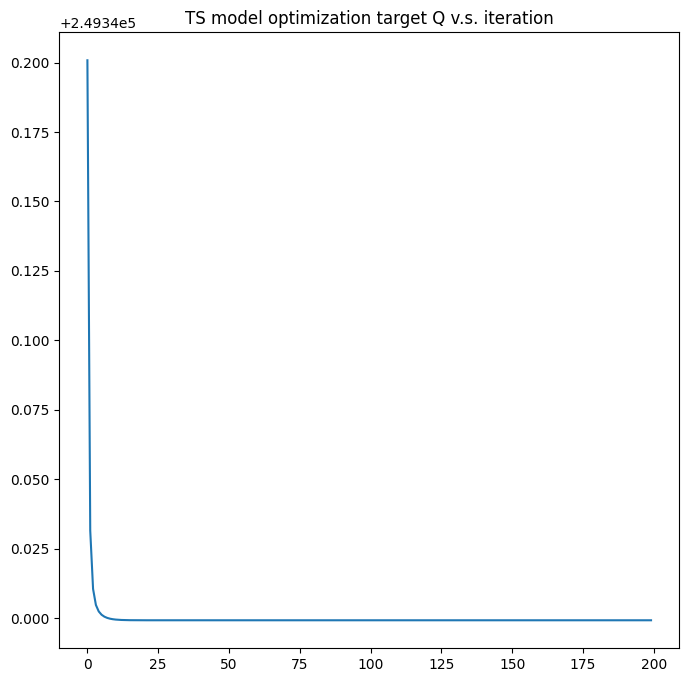

Epoch 1/50
16697/16697 [==============================] - 29s 2ms/step - loss: 45.0285 - root_mean_squared_error: 6.7103 - r_squared: 0.4432 - val_loss: 34.3577 - val_root_mean_squared_error: 5.8615 - val_r_squared: 0.3715
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 33.4823 - root_mean_squared_error: 5.7864 - r_squared: 0.5782 - val_loss: 33.1102 - val_root_mean_squared_error: 5.7541 - val_r_squared: 0.3870
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.7411 - root_mean_squared_error: 5.7220 - r_squared: 0.5864 - val_loss: 32.6261 - val_root_mean_squared_error: 5.7119 - val_r_squared: 0.3996
Epoch 4/50
16697/16697 [==============================] - 29s 2ms/step - loss: 32.4300 - root_mean_squared_error: 5.6947 - r_squared: 0.5900 - val_loss: 32.5442 - val_root_mean_squared_error: 5.7047 - val_r_squared: 0.3988
Epoch 5/50
16697/16697 [==============================] - 29s 2ms/step - loss: 32.2330 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.2442 - root_mean_squared_error: 5.5896 - r_squared: 0.6038 - val_loss: 31.3582 - val_root_mean_squared_error: 5.5998 - val_r_squared: 0.4192
Epoch 39/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.2409 - root_mean_squared_error: 5.5894 - r_squared: 0.6035 - val_loss: 31.3499 - val_root_mean_squared_error: 5.5991 - val_r_squared: 0.4180
Epoch 40/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.2256 - root_mean_squared_error: 5.5880 - r_squared: 0.6039 - val_loss: 31.3408 - val_root_mean_squared_error: 5.5983 - val_r_squared: 0.4204
Epoch 41/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.2205 - root_mean_squared_error: 5.5875 - r_squared: 0.6045 - val_loss: 31.3762 - val_root_mean_squared_error: 5.6014 - val_r_squared: 0.4154
Epoch 42/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.2185 - root_mean_squa

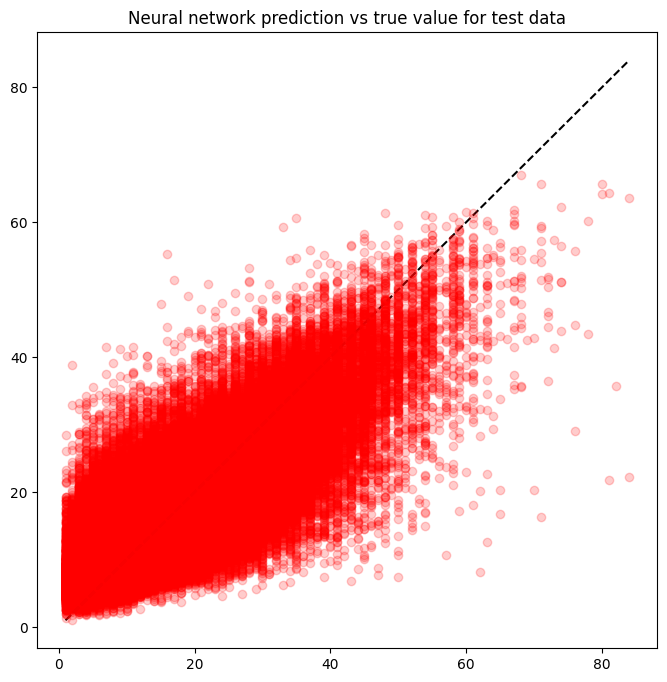

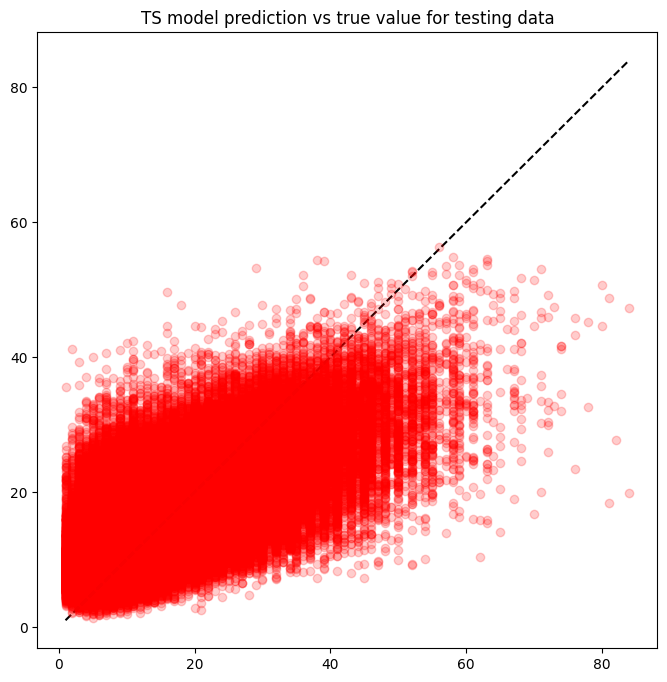

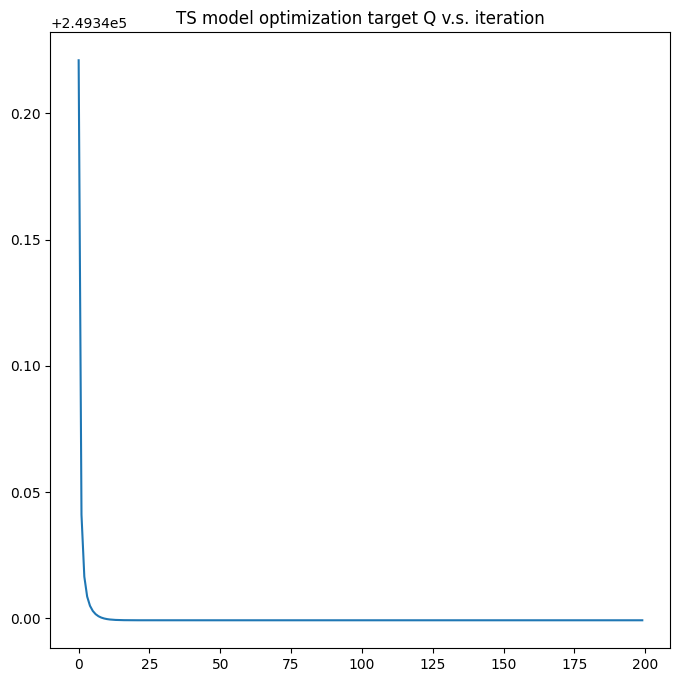

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 44.4123 - root_mean_squared_error: 6.6643 - r_squared: 0.4479 - val_loss: 34.1413 - val_root_mean_squared_error: 5.8431 - val_r_squared: 0.3623
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 33.3321 - root_mean_squared_error: 5.7734 - r_squared: 0.5800 - val_loss: 32.9510 - val_root_mean_squared_error: 5.7403 - val_r_squared: 0.3876
Epoch 3/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.6565 - root_mean_squared_error: 5.7146 - r_squared: 0.5888 - val_loss: 32.6123 - val_root_mean_squared_error: 5.7107 - val_r_squared: 0.4007
Epoch 4/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.3904 - root_mean_squared_error: 5.6913 - r_squared: 0.5908 - val_loss: 32.4450 - val_root_mean_squared_error: 5.6961 - val_r_squared: 0.3996
Epoch 5/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.2499 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.3688 - root_mean_squared_error: 5.6008 - r_squared: 0.6032 - val_loss: 31.6059 - val_root_mean_squared_error: 5.6219 - val_r_squared: 0.4167
Epoch 39/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.3591 - root_mean_squared_error: 5.5999 - r_squared: 0.6022 - val_loss: 31.5101 - val_root_mean_squared_error: 5.6134 - val_r_squared: 0.4143
Epoch 40/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.3472 - root_mean_squared_error: 5.5989 - r_squared: 0.6032 - val_loss: 31.4921 - val_root_mean_squared_error: 5.6118 - val_r_squared: 0.4163
Epoch 41/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.3325 - root_mean_squared_error: 5.5975 - r_squared: 0.6038 - val_loss: 31.6165 - val_root_mean_squared_error: 5.6229 - val_r_squared: 0.4140
Epoch 42/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.3208 - root_mean_squa

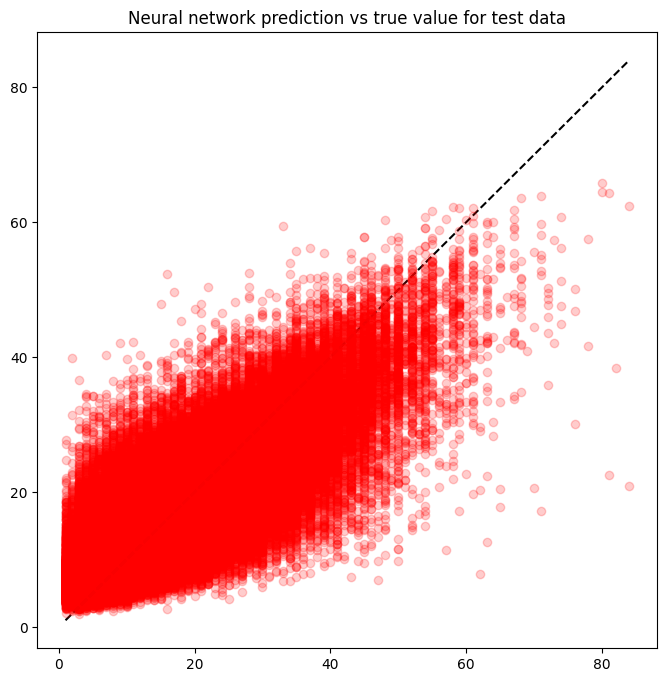

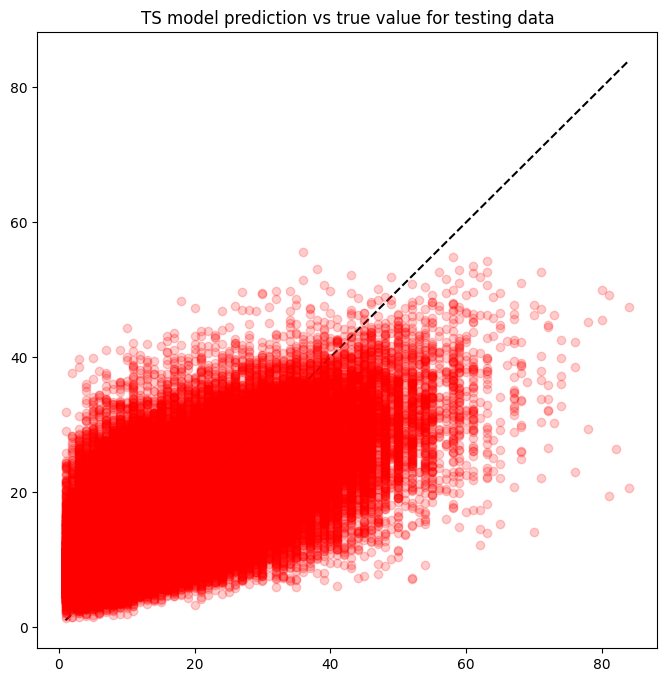

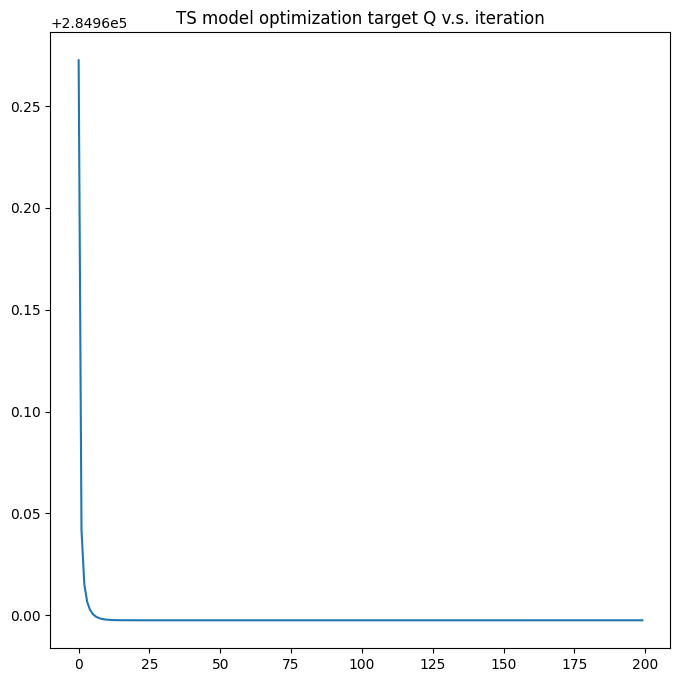

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 43.5025 - root_mean_squared_error: 6.5956 - r_squared: 0.4584 - val_loss: 34.2926 - val_root_mean_squared_error: 5.8560 - val_r_squared: 0.3765
Epoch 2/50
16697/16697 [==============================] - 32s 2ms/step - loss: 33.4360 - root_mean_squared_error: 5.7824 - r_squared: 0.5797 - val_loss: 33.0285 - val_root_mean_squared_error: 5.7470 - val_r_squared: 0.3855
Epoch 3/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.6992 - root_mean_squared_error: 5.7183 - r_squared: 0.5871 - val_loss: 32.8730 - val_root_mean_squared_error: 5.7335 - val_r_squared: 0.3863
Epoch 4/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.3812 - root_mean_squared_error: 5.6904 - r_squared: 0.5909 - val_loss: 32.4609 - val_root_mean_squared_error: 5.6975 - val_r_squared: 0.3959
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.1881 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.1481 - root_mean_squared_error: 5.5810 - r_squared: 0.6052 - val_loss: 31.3294 - val_root_mean_squared_error: 5.5973 - val_r_squared: 0.4213
Epoch 39/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.1395 - root_mean_squared_error: 5.5803 - r_squared: 0.6056 - val_loss: 31.2312 - val_root_mean_squared_error: 5.5885 - val_r_squared: 0.4218
Epoch 40/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.1196 - root_mean_squared_error: 5.5785 - r_squared: 0.6048 - val_loss: 31.2532 - val_root_mean_squared_error: 5.5905 - val_r_squared: 0.4236
Epoch 41/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.1165 - root_mean_squared_error: 5.5782 - r_squared: 0.6051 - val_loss: 31.2206 - val_root_mean_squared_error: 5.5875 - val_r_squared: 0.4213
Epoch 42/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.0979 - root_mean_squa

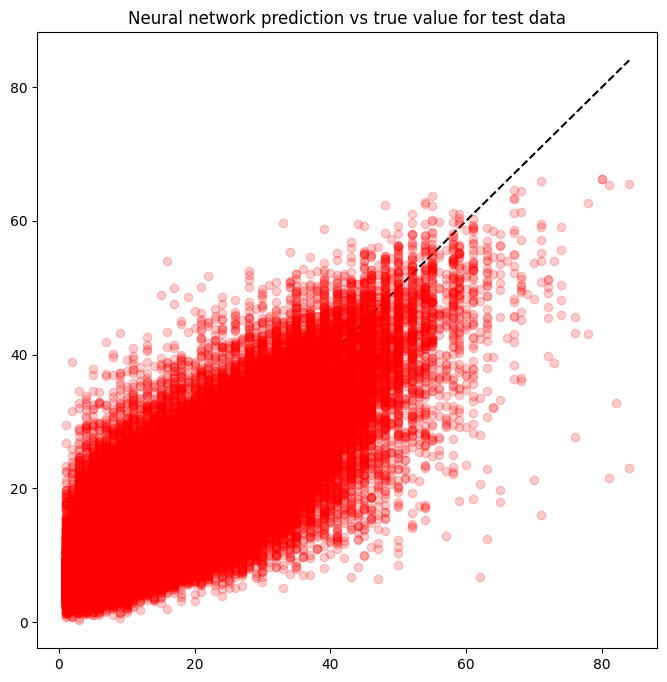

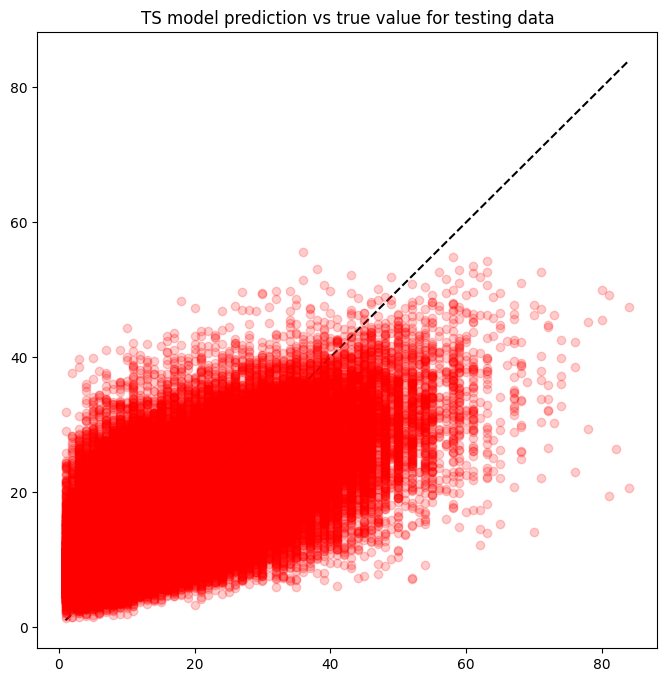

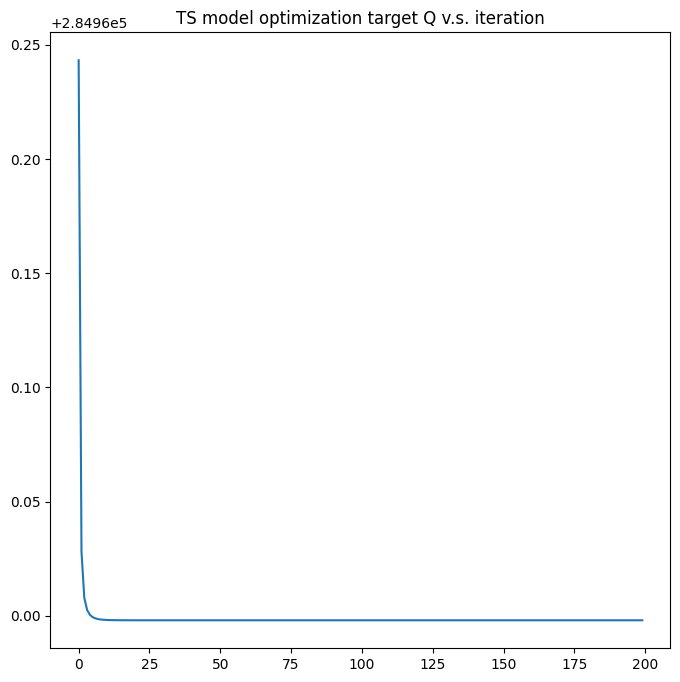

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 43.5748 - root_mean_squared_error: 6.6011 - r_squared: 0.4590 - val_loss: 34.1920 - val_root_mean_squared_error: 5.8474 - val_r_squared: 0.3671
Epoch 2/50
16697/16697 [==============================] - 32s 2ms/step - loss: 33.4722 - root_mean_squared_error: 5.7855 - r_squared: 0.5791 - val_loss: 33.1361 - val_root_mean_squared_error: 5.7564 - val_r_squared: 0.3968
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.7317 - root_mean_squared_error: 5.7212 - r_squared: 0.5872 - val_loss: 32.7312 - val_root_mean_squared_error: 5.7211 - val_r_squared: 0.3937
Epoch 4/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.4054 - root_mean_squared_error: 5.6926 - r_squared: 0.5910 - val_loss: 32.3303 - val_root_mean_squared_error: 5.6860 - val_r_squared: 0.3988
Epoch 5/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.2062 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 52s 3ms/step - loss: 31.0183 - root_mean_squared_error: 5.5694 - r_squared: 0.6064 - val_loss: 31.1515 - val_root_mean_squared_error: 5.5814 - val_r_squared: 0.4219
Epoch 39/50
16697/16697 [==============================] - 52s 3ms/step - loss: 30.9984 - root_mean_squared_error: 5.5676 - r_squared: 0.6070 - val_loss: 31.1037 - val_root_mean_squared_error: 5.5771 - val_r_squared: 0.4216
Epoch 40/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.0045 - root_mean_squared_error: 5.5682 - r_squared: 0.6072 - val_loss: 31.1654 - val_root_mean_squared_error: 5.5826 - val_r_squared: 0.4241
Epoch 41/50
16697/16697 [==============================] - 52s 3ms/step - loss: 30.9906 - root_mean_squared_error: 5.5669 - r_squared: 0.6071 - val_loss: 31.2617 - val_root_mean_squared_error: 5.5912 - val_r_squared: 0.4145
Epoch 42/50
16697/16697 [==============================] - 52s 3ms/step - loss: 30.9725 - root_mean_squa

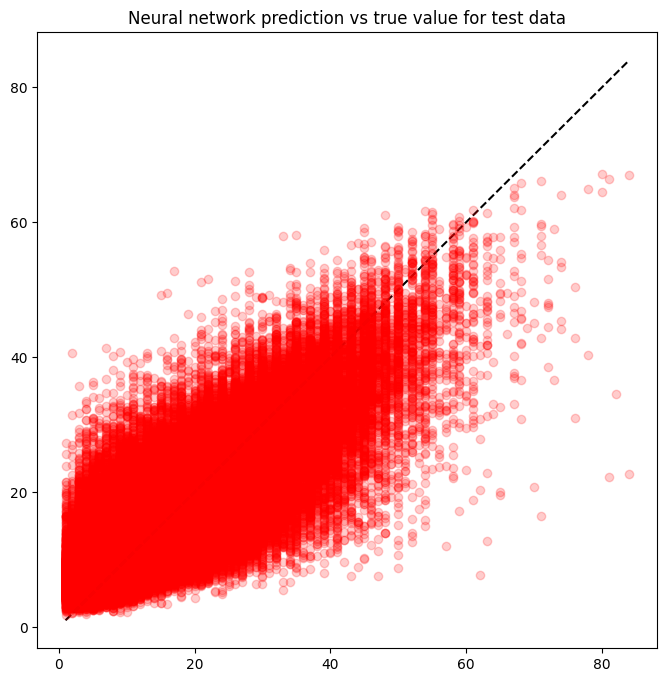

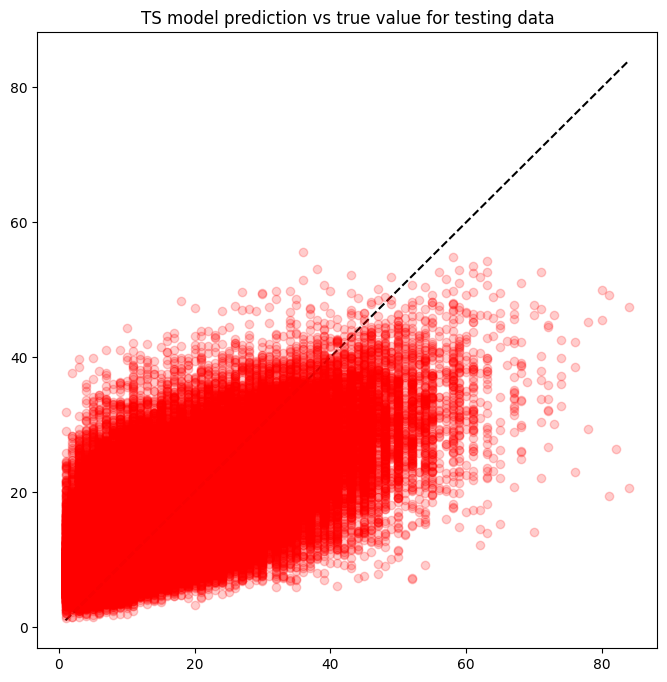

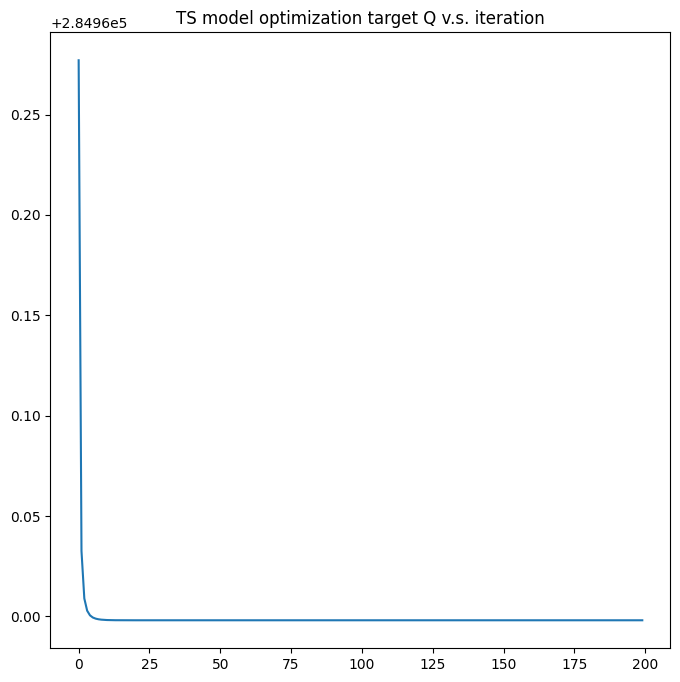

Epoch 1/50
16697/16697 [==============================] - 33s 2ms/step - loss: 44.6920 - root_mean_squared_error: 6.6852 - r_squared: 0.4472 - val_loss: 34.0729 - val_root_mean_squared_error: 5.8372 - val_r_squared: 0.3739
Epoch 2/50
16697/16697 [==============================] - 32s 2ms/step - loss: 33.2787 - root_mean_squared_error: 5.7688 - r_squared: 0.5819 - val_loss: 33.2736 - val_root_mean_squared_error: 5.7683 - val_r_squared: 0.3803
Epoch 3/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.6098 - root_mean_squared_error: 5.7105 - r_squared: 0.5886 - val_loss: 32.5731 - val_root_mean_squared_error: 5.7073 - val_r_squared: 0.4006
Epoch 4/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.3011 - root_mean_squared_error: 5.6834 - r_squared: 0.5927 - val_loss: 32.2535 - val_root_mean_squared_error: 5.6792 - val_r_squared: 0.3996
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.1392 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.1753 - root_mean_squared_error: 5.5835 - r_squared: 0.6040 - val_loss: 31.3727 - val_root_mean_squared_error: 5.6011 - val_r_squared: 0.4178
Epoch 39/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.1749 - root_mean_squared_error: 5.5834 - r_squared: 0.6051 - val_loss: 31.2887 - val_root_mean_squared_error: 5.5936 - val_r_squared: 0.4221
Epoch 40/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.1455 - root_mean_squared_error: 5.5808 - r_squared: 0.6049 - val_loss: 31.3420 - val_root_mean_squared_error: 5.5984 - val_r_squared: 0.4182
Epoch 41/50
16697/16697 [==============================] - 28s 2ms/step - loss: 31.1329 - root_mean_squared_error: 5.5797 - r_squared: 0.6056 - val_loss: 31.3879 - val_root_mean_squared_error: 5.6025 - val_r_squared: 0.4127
Epoch 42/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.1314 - root_mean_squa

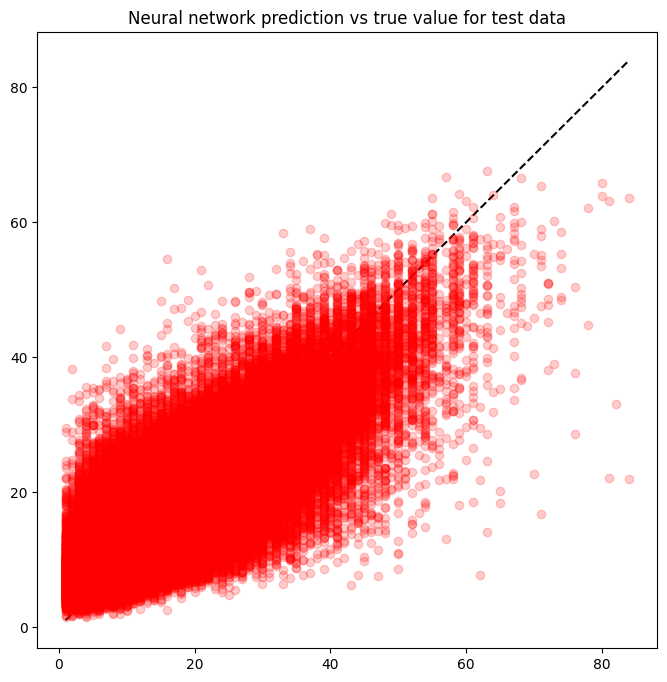

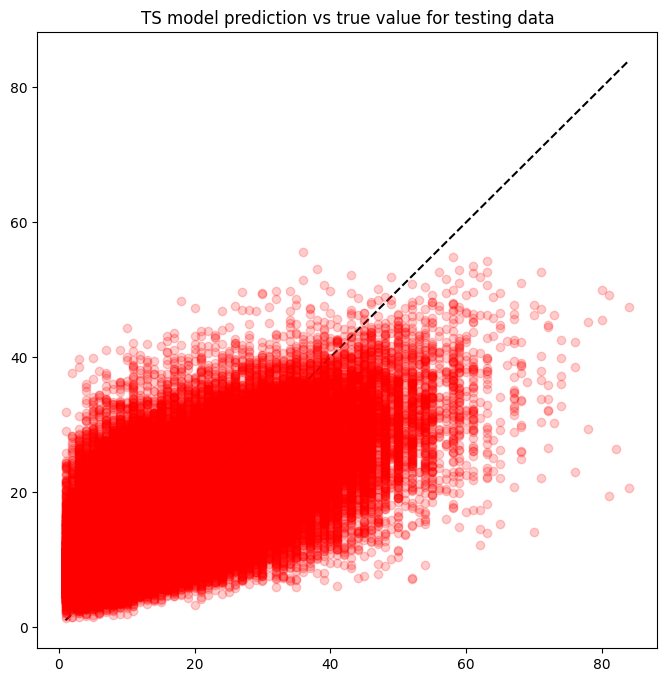

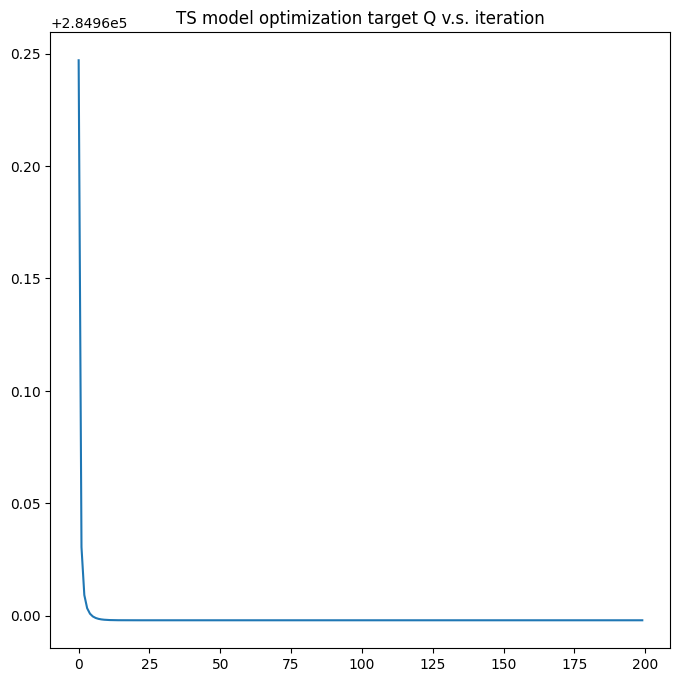

Epoch 1/50
16697/16697 [==============================] - 31s 2ms/step - loss: 44.4297 - root_mean_squared_error: 6.6656 - r_squared: 0.4485 - val_loss: 34.0732 - val_root_mean_squared_error: 5.8372 - val_r_squared: 0.3763
Epoch 2/50
16697/16697 [==============================] - 30s 2ms/step - loss: 33.3675 - root_mean_squared_error: 5.7765 - r_squared: 0.5794 - val_loss: 33.0651 - val_root_mean_squared_error: 5.7502 - val_r_squared: 0.4000
Epoch 3/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.6368 - root_mean_squared_error: 5.7129 - r_squared: 0.5885 - val_loss: 32.5080 - val_root_mean_squared_error: 5.7016 - val_r_squared: 0.4006
Epoch 4/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.3325 - root_mean_squared_error: 5.6862 - r_squared: 0.5914 - val_loss: 32.6034 - val_root_mean_squared_error: 5.7099 - val_r_squared: 0.4024
Epoch 5/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.1621 - root_mean_squared_e

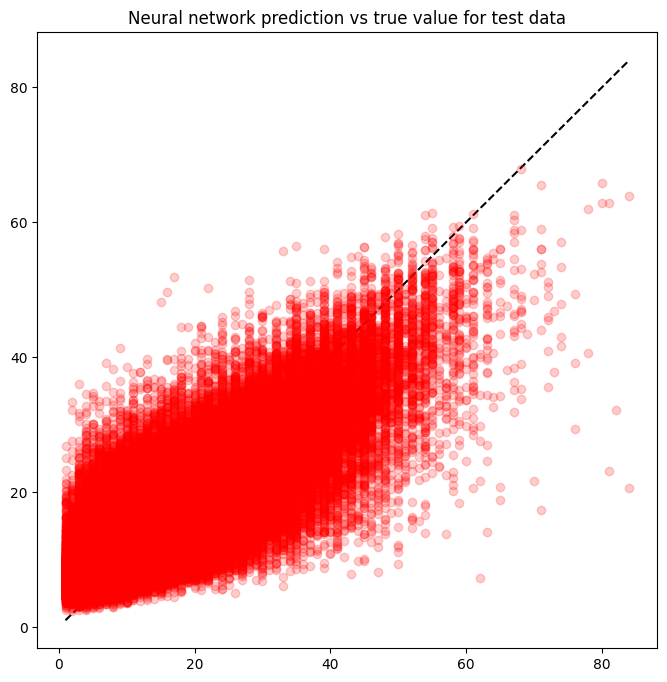

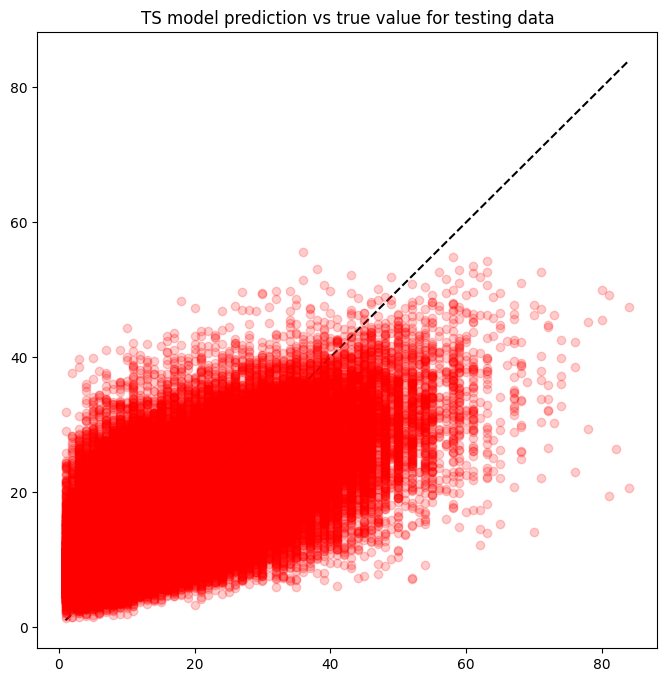

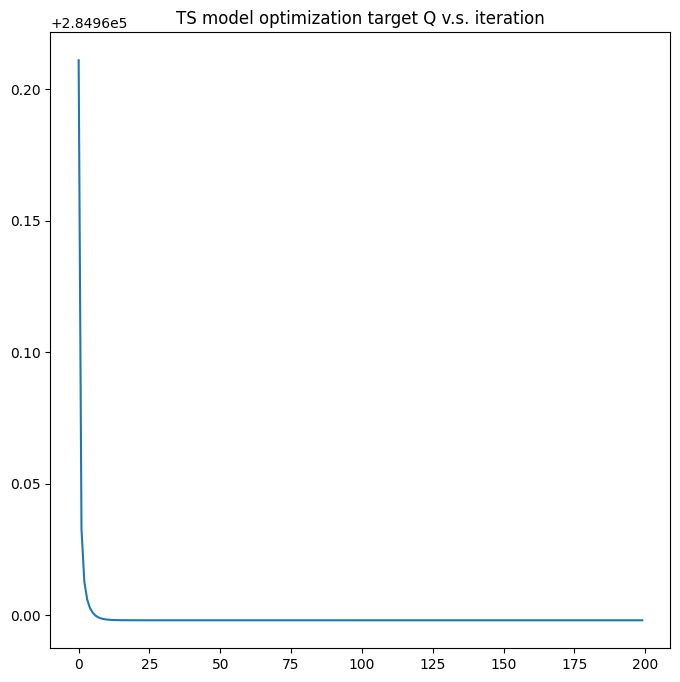

Epoch 1/50
16697/16697 [==============================] - 30s 2ms/step - loss: 44.0433 - root_mean_squared_error: 6.6365 - r_squared: 0.4517 - val_loss: 34.2535 - val_root_mean_squared_error: 5.8526 - val_r_squared: 0.3740
Epoch 2/50
16697/16697 [==============================] - 30s 2ms/step - loss: 33.5415 - root_mean_squared_error: 5.7915 - r_squared: 0.5781 - val_loss: 33.1350 - val_root_mean_squared_error: 5.7563 - val_r_squared: 0.3919
Epoch 3/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.8167 - root_mean_squared_error: 5.7286 - r_squared: 0.5868 - val_loss: 32.6393 - val_root_mean_squared_error: 5.7131 - val_r_squared: 0.3961
Epoch 4/50
16697/16697 [==============================] - 29s 2ms/step - loss: 32.4622 - root_mean_squared_error: 5.6976 - r_squared: 0.5907 - val_loss: 32.5244 - val_root_mean_squared_error: 5.7030 - val_r_squared: 0.3941
Epoch 5/50
16697/16697 [==============================] - 28s 2ms/step - loss: 32.2130 - root_mean_squared_e

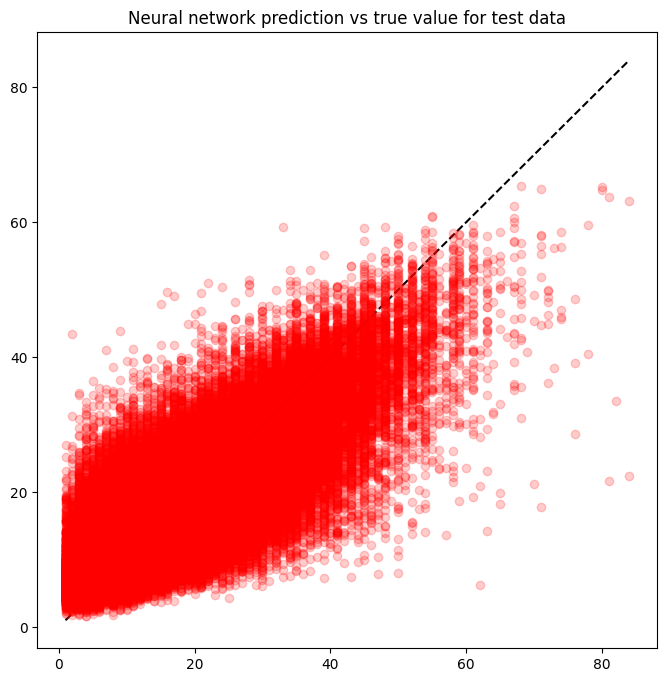

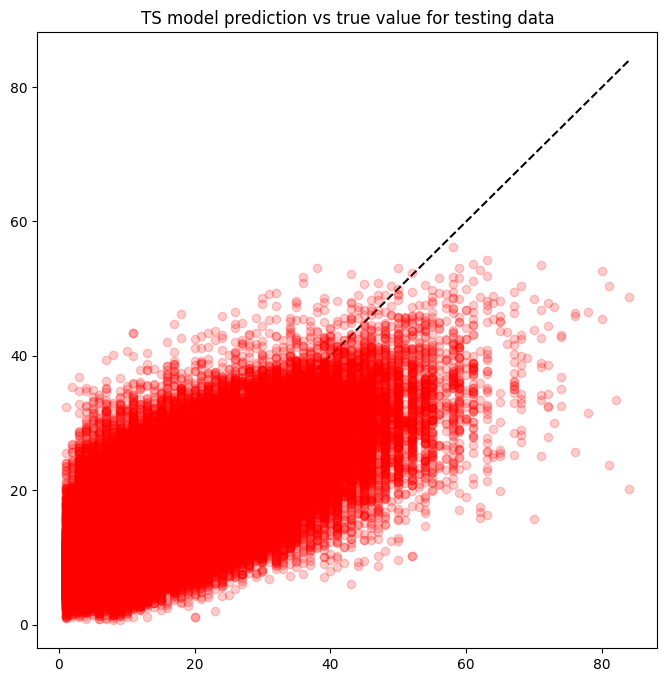

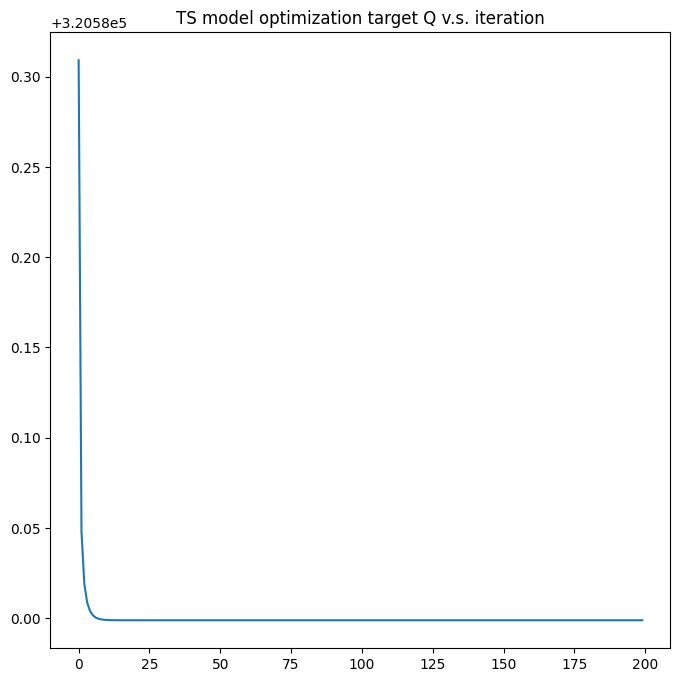

Epoch 1/50
16697/16697 [==============================] - 31s 2ms/step - loss: 43.3535 - root_mean_squared_error: 6.5843 - r_squared: 0.4632 - val_loss: 33.4202 - val_root_mean_squared_error: 5.7810 - val_r_squared: 0.3911
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.8197 - root_mean_squared_error: 5.7288 - r_squared: 0.5868 - val_loss: 32.3954 - val_root_mean_squared_error: 5.6917 - val_r_squared: 0.4040
Epoch 3/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.2786 - root_mean_squared_error: 5.6814 - r_squared: 0.5928 - val_loss: 32.2151 - val_root_mean_squared_error: 5.6758 - val_r_squared: 0.4067
Epoch 4/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.0358 - root_mean_squared_error: 5.6600 - r_squared: 0.5947 - val_loss: 31.9159 - val_root_mean_squared_error: 5.6494 - val_r_squared: 0.4072
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.8838 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.9760 - root_mean_squared_error: 5.5656 - r_squared: 0.6074 - val_loss: 31.0659 - val_root_mean_squared_error: 5.5737 - val_r_squared: 0.4243
Epoch 39/50
16697/16697 [==============================] - 33s 2ms/step - loss: 30.9586 - root_mean_squared_error: 5.5640 - r_squared: 0.6075 - val_loss: 31.4028 - val_root_mean_squared_error: 5.6038 - val_r_squared: 0.4161
Epoch 40/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.9520 - root_mean_squared_error: 5.5635 - r_squared: 0.6073 - val_loss: 31.1377 - val_root_mean_squared_error: 5.5801 - val_r_squared: 0.4237
Epoch 41/50
16697/16697 [==============================] - 31s 2ms/step - loss: 30.9411 - root_mean_squared_error: 5.5625 - r_squared: 0.6074 - val_loss: 31.1280 - val_root_mean_squared_error: 5.5792 - val_r_squared: 0.4254
Epoch 42/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.9292 - root_mean_squa

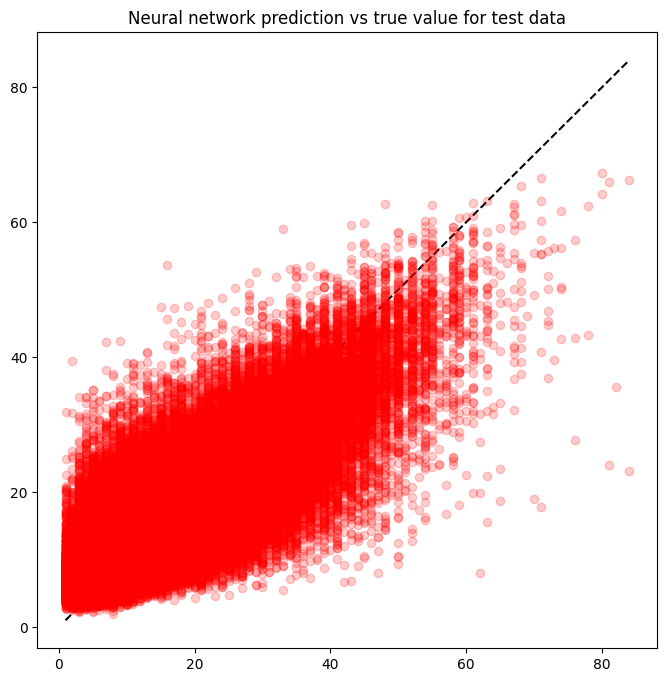

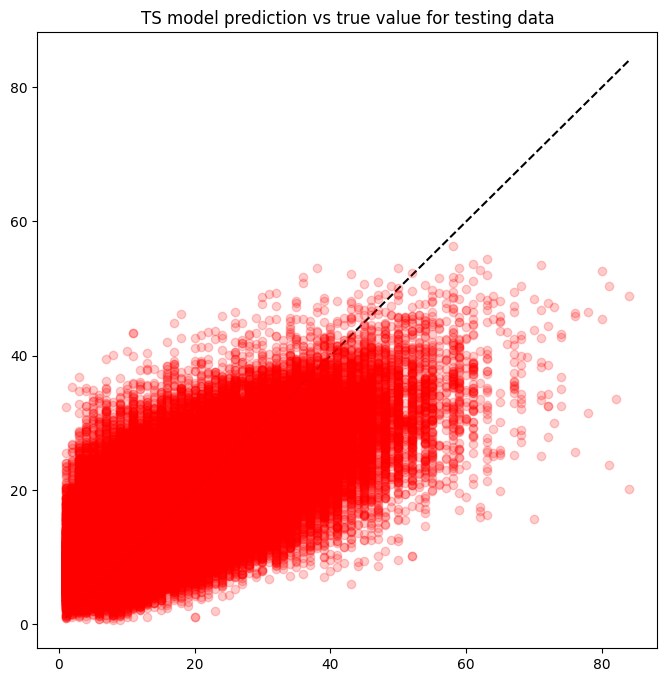

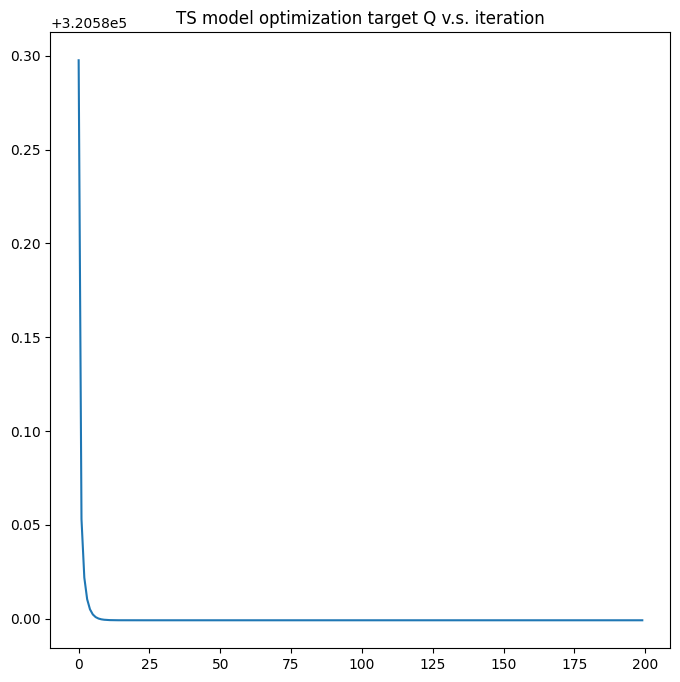

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 43.0903 - root_mean_squared_error: 6.5643 - r_squared: 0.4657 - val_loss: 33.3423 - val_root_mean_squared_error: 5.7743 - val_r_squared: 0.3909
Epoch 2/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.8667 - root_mean_squared_error: 5.7329 - r_squared: 0.5863 - val_loss: 32.5174 - val_root_mean_squared_error: 5.7024 - val_r_squared: 0.3991
Epoch 3/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.3230 - root_mean_squared_error: 5.6853 - r_squared: 0.5915 - val_loss: 32.1571 - val_root_mean_squared_error: 5.6707 - val_r_squared: 0.4037
Epoch 4/50
16697/16697 [==============================] - 29s 2ms/step - loss: 32.0669 - root_mean_squared_error: 5.6628 - r_squared: 0.5950 - val_loss: 31.9542 - val_root_mean_squared_error: 5.6528 - val_r_squared: 0.4090
Epoch 5/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.8944 - root_mean_squared_e

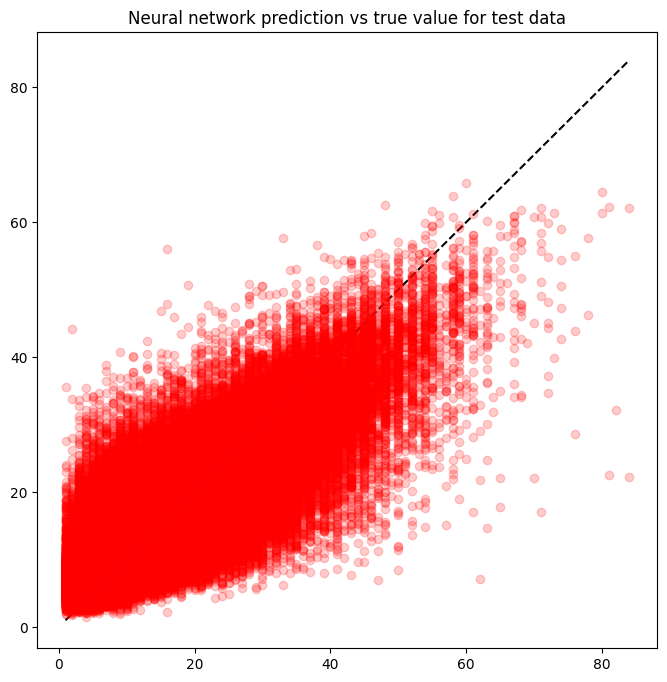

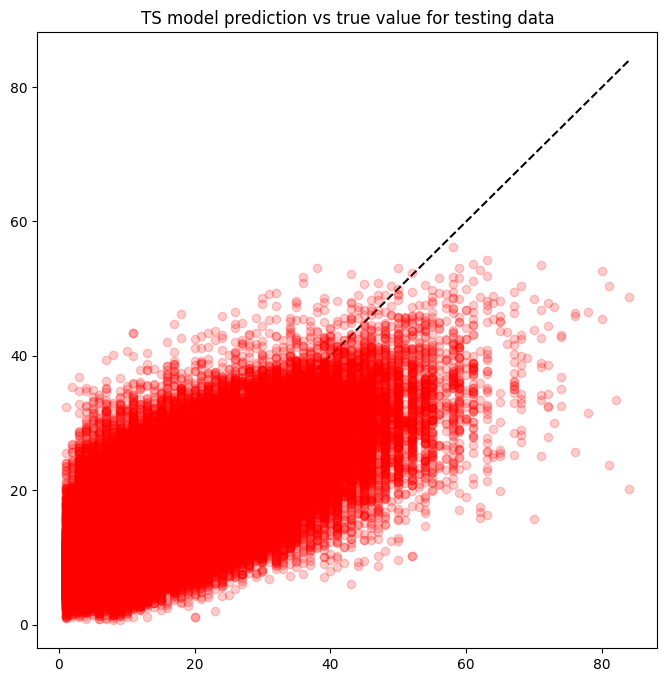

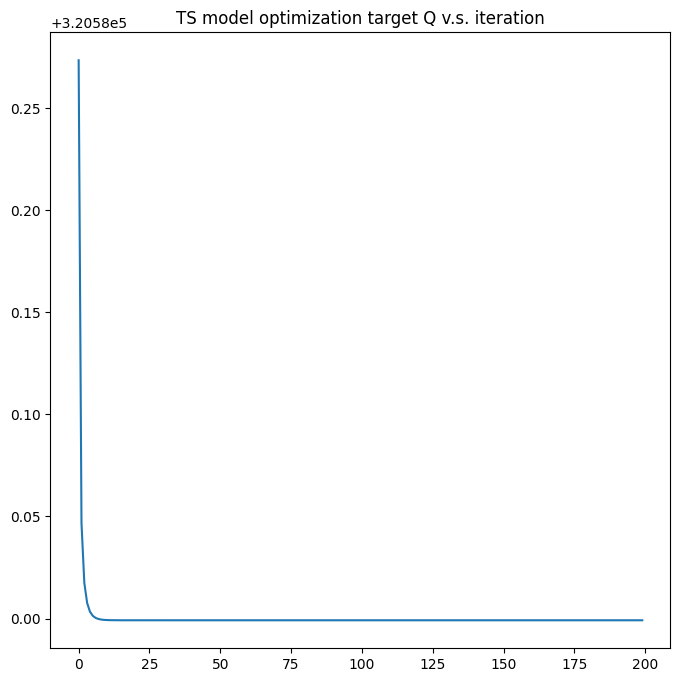

Epoch 1/50
16697/16697 [==============================] - 30s 2ms/step - loss: 42.5914 - root_mean_squared_error: 6.5262 - r_squared: 0.4691 - val_loss: 33.3392 - val_root_mean_squared_error: 5.7740 - val_r_squared: 0.3911
Epoch 2/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.9185 - root_mean_squared_error: 5.7375 - r_squared: 0.5848 - val_loss: 32.5365 - val_root_mean_squared_error: 5.7041 - val_r_squared: 0.3973
Epoch 3/50
16697/16697 [==============================] - 29s 2ms/step - loss: 32.3242 - root_mean_squared_error: 5.6854 - r_squared: 0.5914 - val_loss: 32.1362 - val_root_mean_squared_error: 5.6689 - val_r_squared: 0.4062
Epoch 4/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.0286 - root_mean_squared_error: 5.6594 - r_squared: 0.5947 - val_loss: 32.0532 - val_root_mean_squared_error: 5.6616 - val_r_squared: 0.4030
Epoch 5/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.8452 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 29s 2ms/step - loss: 30.9348 - root_mean_squared_error: 5.5619 - r_squared: 0.6082 - val_loss: 31.0878 - val_root_mean_squared_error: 5.5756 - val_r_squared: 0.4226
Epoch 39/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.9112 - root_mean_squared_error: 5.5598 - r_squared: 0.6082 - val_loss: 31.0913 - val_root_mean_squared_error: 5.5760 - val_r_squared: 0.4198
Epoch 40/50
16697/16697 [==============================] - 29s 2ms/step - loss: 30.9037 - root_mean_squared_error: 5.5591 - r_squared: 0.6080 - val_loss: 31.0270 - val_root_mean_squared_error: 5.5702 - val_r_squared: 0.4252
Epoch 41/50
16697/16697 [==============================] - 30s 2ms/step - loss: 30.8921 - root_mean_squared_error: 5.5581 - r_squared: 0.6090 - val_loss: 31.1518 - val_root_mean_squared_error: 5.5814 - val_r_squared: 0.4204
Epoch 42/50
16697/16697 [==============================] - 30s 2ms/step - loss: 30.8936 - root_mean_squa

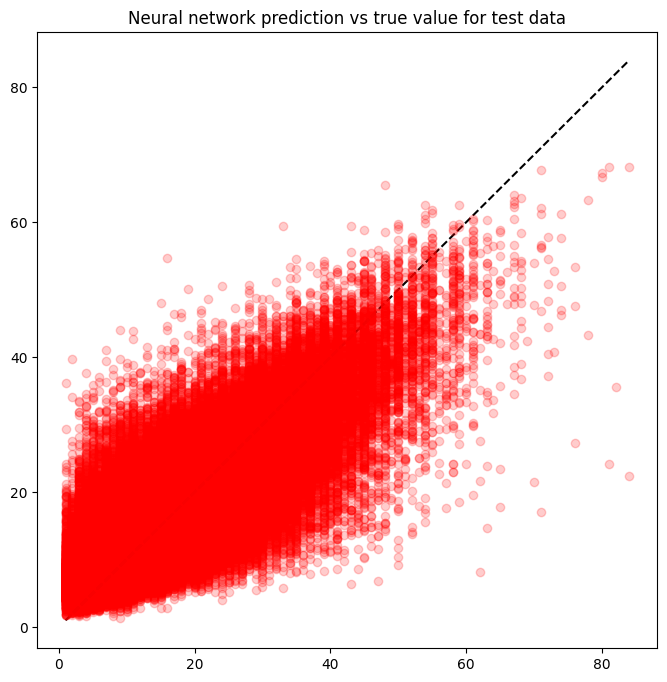

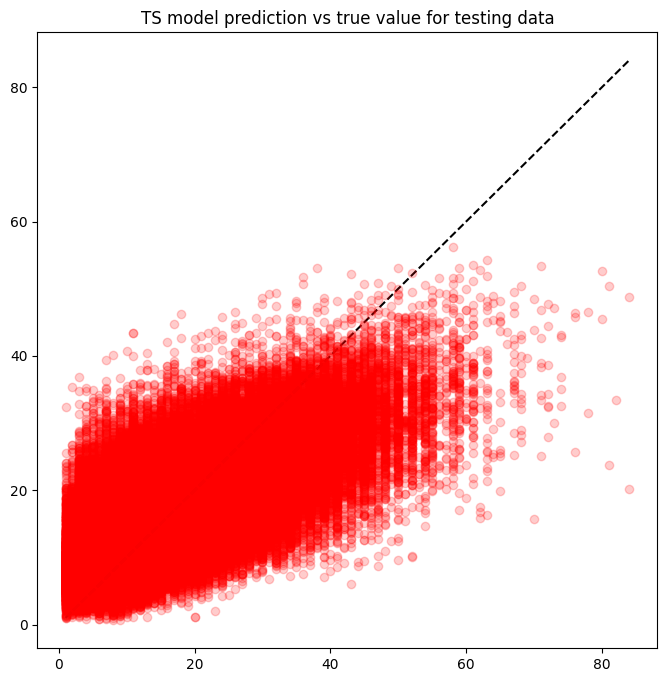

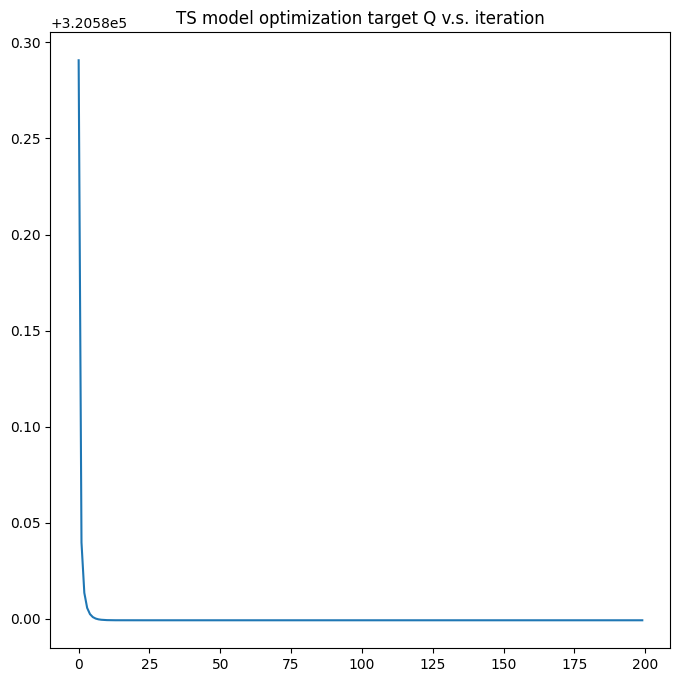

Epoch 1/50
16697/16697 [==============================] - 29s 2ms/step - loss: 42.5419 - root_mean_squared_error: 6.5224 - r_squared: 0.4700 - val_loss: 33.5999 - val_root_mean_squared_error: 5.7965 - val_r_squared: 0.3866
Epoch 2/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.9239 - root_mean_squared_error: 5.7379 - r_squared: 0.5859 - val_loss: 32.8279 - val_root_mean_squared_error: 5.7296 - val_r_squared: 0.3997
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.3613 - root_mean_squared_error: 5.6887 - r_squared: 0.5920 - val_loss: 32.3099 - val_root_mean_squared_error: 5.6842 - val_r_squared: 0.3974
Epoch 4/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.0762 - root_mean_squared_error: 5.6636 - r_squared: 0.5946 - val_loss: 31.9972 - val_root_mean_squared_error: 5.6566 - val_r_squared: 0.4076
Epoch 5/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.9042 - root_mean_squared_e

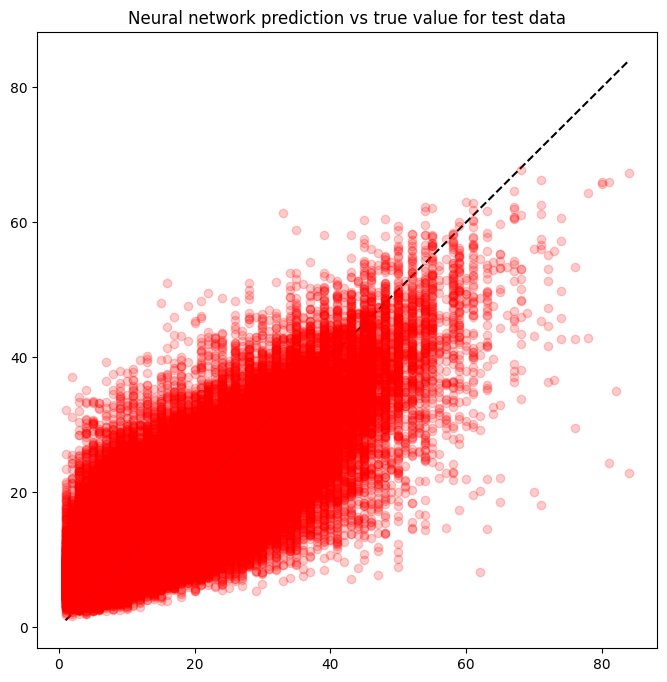

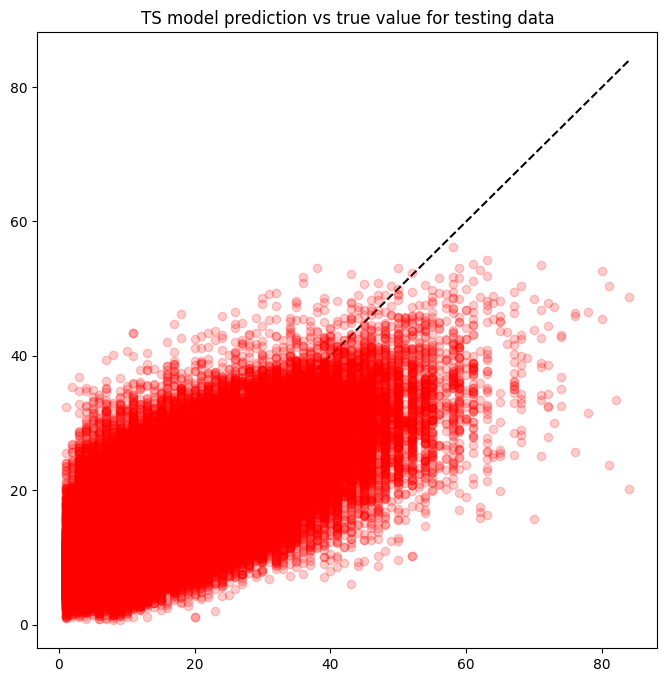

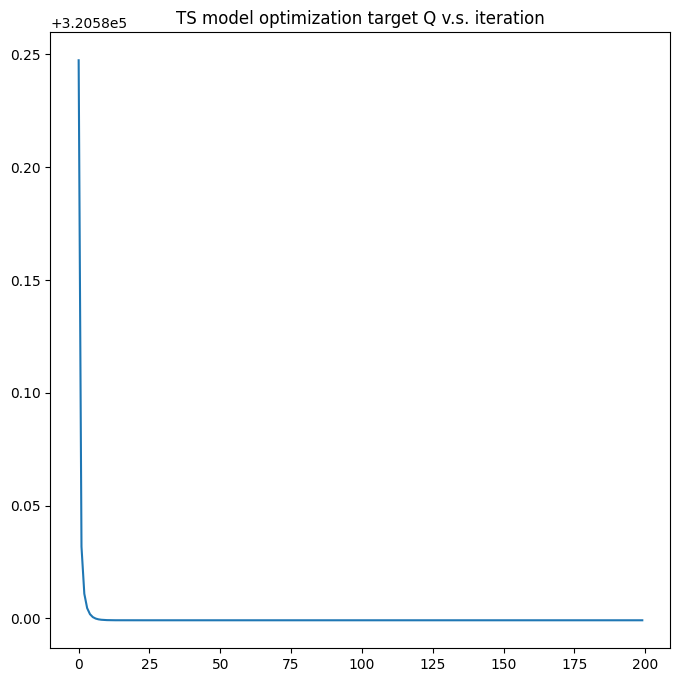

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 43.0679 - root_mean_squared_error: 6.5626 - r_squared: 0.4653 - val_loss: 33.5249 - val_root_mean_squared_error: 5.7901 - val_r_squared: 0.3877
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.9269 - root_mean_squared_error: 5.7382 - r_squared: 0.5854 - val_loss: 32.5852 - val_root_mean_squared_error: 5.7083 - val_r_squared: 0.3977
Epoch 3/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.3522 - root_mean_squared_error: 5.6879 - r_squared: 0.5914 - val_loss: 32.2058 - val_root_mean_squared_error: 5.6750 - val_r_squared: 0.4022
Epoch 4/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.0728 - root_mean_squared_error: 5.6633 - r_squared: 0.5935 - val_loss: 32.2885 - val_root_mean_squared_error: 5.6823 - val_r_squared: 0.3968
Epoch 5/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.9099 - root_mean_squared_e

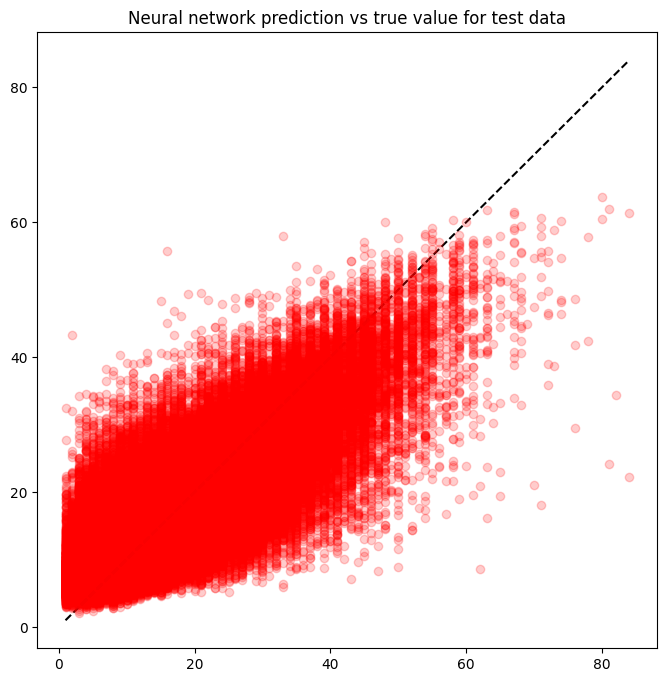

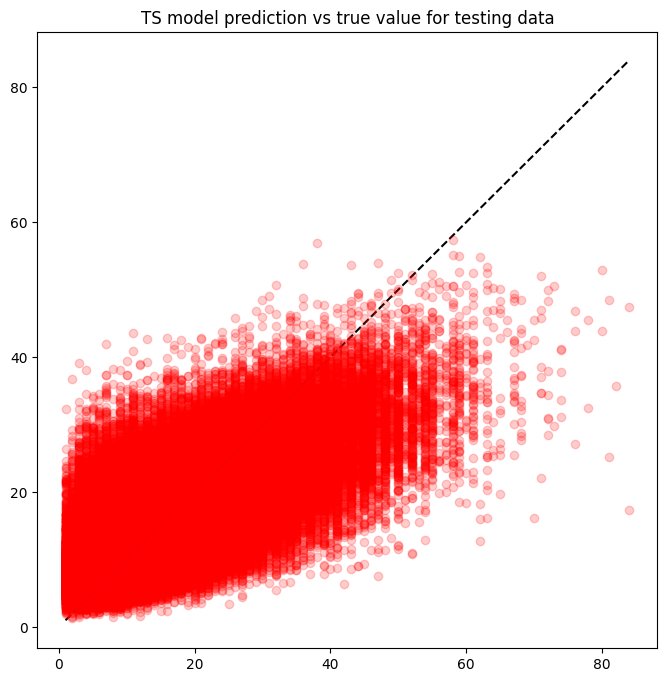

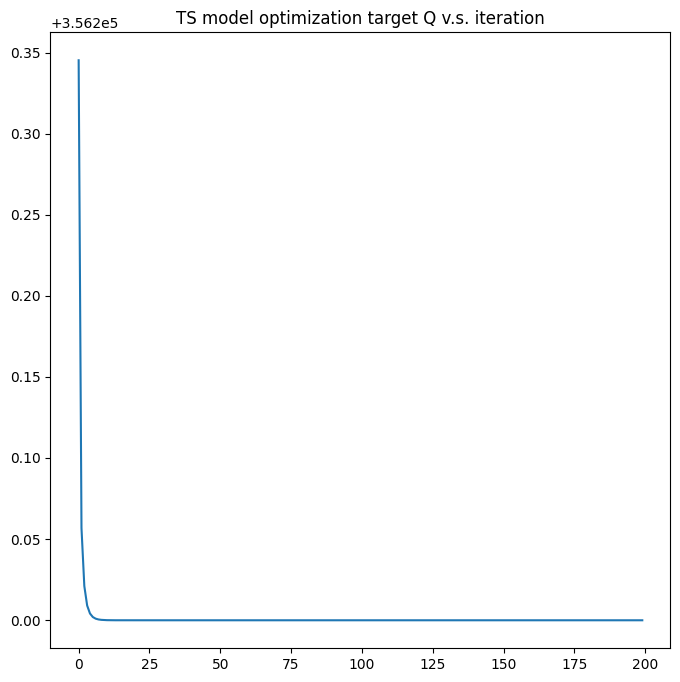

Epoch 1/50
16697/16697 [==============================] - 30s 2ms/step - loss: 43.4447 - root_mean_squared_error: 6.5913 - r_squared: 0.4604 - val_loss: 33.5437 - val_root_mean_squared_error: 5.7917 - val_r_squared: 0.3857
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.8912 - root_mean_squared_error: 5.7351 - r_squared: 0.5863 - val_loss: 32.7032 - val_root_mean_squared_error: 5.7187 - val_r_squared: 0.3949
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.3037 - root_mean_squared_error: 5.6836 - r_squared: 0.5931 - val_loss: 32.3564 - val_root_mean_squared_error: 5.6883 - val_r_squared: 0.4050
Epoch 4/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.0310 - root_mean_squared_error: 5.6596 - r_squared: 0.5953 - val_loss: 32.1856 - val_root_mean_squared_error: 5.6732 - val_r_squared: 0.4030
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.8761 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 29s 2ms/step - loss: 30.9051 - root_mean_squared_error: 5.5592 - r_squared: 0.6077 - val_loss: 31.0243 - val_root_mean_squared_error: 5.5699 - val_r_squared: 0.4214
Epoch 39/50
16697/16697 [==============================] - 29s 2ms/step - loss: 30.8805 - root_mean_squared_error: 5.5570 - r_squared: 0.6083 - val_loss: 31.1443 - val_root_mean_squared_error: 5.5807 - val_r_squared: 0.4249
Epoch 40/50
16697/16697 [==============================] - 30s 2ms/step - loss: 30.8658 - root_mean_squared_error: 5.5557 - r_squared: 0.6081 - val_loss: 31.0498 - val_root_mean_squared_error: 5.5722 - val_r_squared: 0.4206
Epoch 41/50
16697/16697 [==============================] - 29s 2ms/step - loss: 30.8642 - root_mean_squared_error: 5.5556 - r_squared: 0.6085 - val_loss: 31.0888 - val_root_mean_squared_error: 5.5757 - val_r_squared: 0.4201
Epoch 42/50
16697/16697 [==============================] - 30s 2ms/step - loss: 30.8574 - root_mean_squa

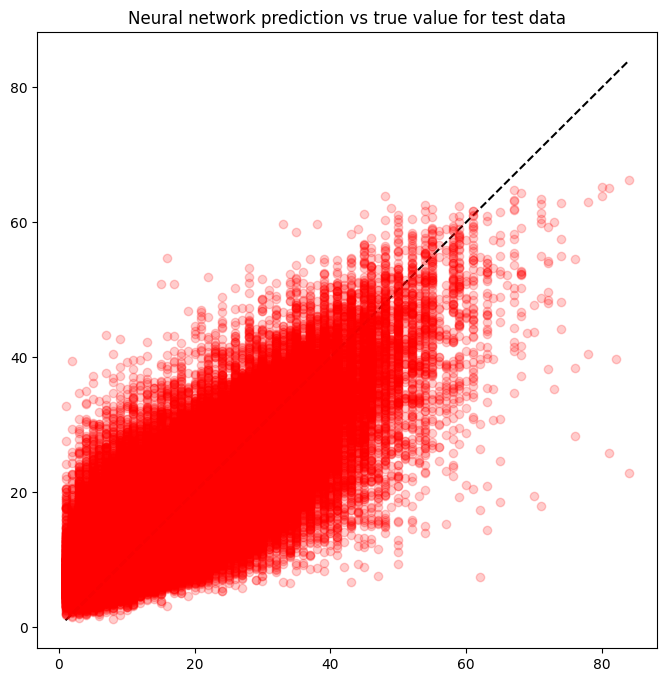

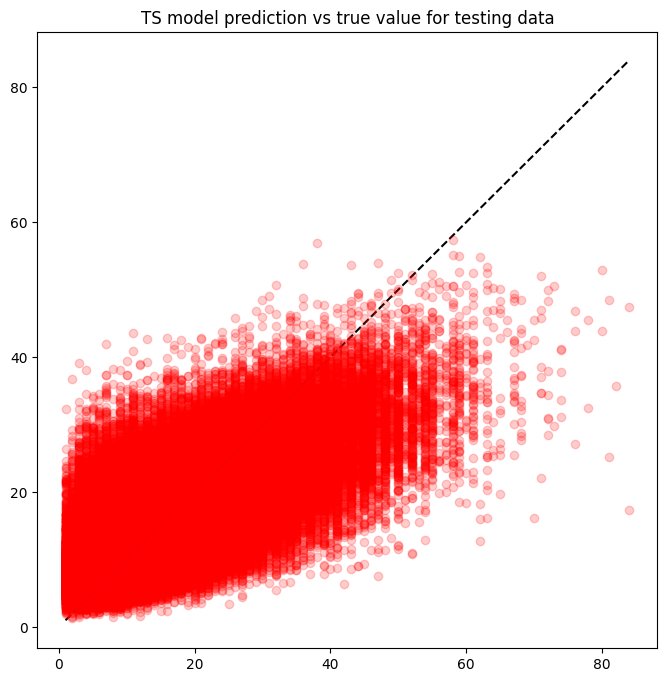

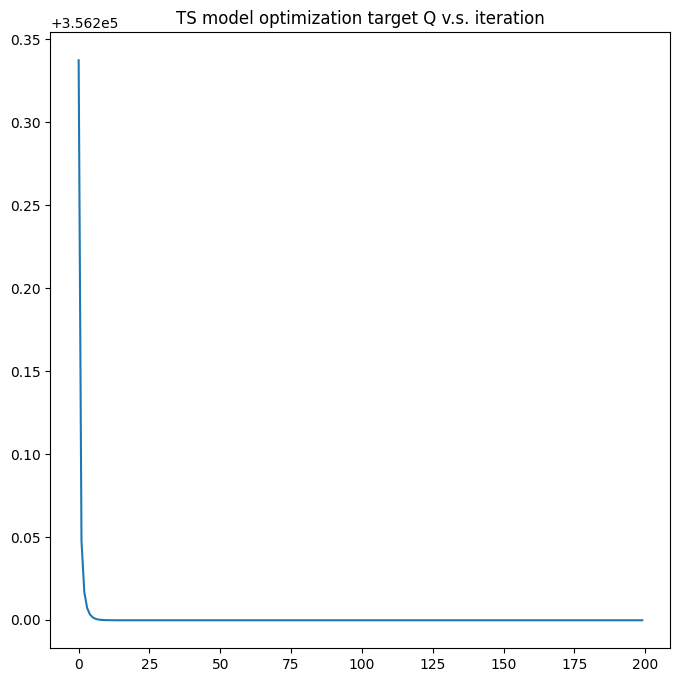

Epoch 1/50
16697/16697 [==============================] - 28s 2ms/step - loss: 43.4881 - root_mean_squared_error: 6.5945 - r_squared: 0.4594 - val_loss: 33.4792 - val_root_mean_squared_error: 5.7861 - val_r_squared: 0.3847
Epoch 2/50
16697/16697 [==============================] - 29s 2ms/step - loss: 32.9470 - root_mean_squared_error: 5.7399 - r_squared: 0.5850 - val_loss: 32.6632 - val_root_mean_squared_error: 5.7152 - val_r_squared: 0.3975
Epoch 3/50
16697/16697 [==============================] - 28s 2ms/step - loss: 32.3550 - root_mean_squared_error: 5.6881 - r_squared: 0.5911 - val_loss: 32.3926 - val_root_mean_squared_error: 5.6914 - val_r_squared: 0.3978
Epoch 4/50
16697/16697 [==============================] - 28s 2ms/step - loss: 32.0702 - root_mean_squared_error: 5.6631 - r_squared: 0.5942 - val_loss: 32.1621 - val_root_mean_squared_error: 5.6712 - val_r_squared: 0.4034
Epoch 5/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.8931 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 28s 2ms/step - loss: 30.9703 - root_mean_squared_error: 5.5651 - r_squared: 0.6072 - val_loss: 31.3073 - val_root_mean_squared_error: 5.5953 - val_r_squared: 0.4164
Epoch 39/50
16697/16697 [==============================] - 30s 2ms/step - loss: 30.9603 - root_mean_squared_error: 5.5642 - r_squared: 0.6068 - val_loss: 31.1761 - val_root_mean_squared_error: 5.5836 - val_r_squared: 0.4187
Epoch 40/50
16697/16697 [==============================] - 30s 2ms/step - loss: 30.9328 - root_mean_squared_error: 5.5617 - r_squared: 0.6078 - val_loss: 31.2895 - val_root_mean_squared_error: 5.5937 - val_r_squared: 0.4172
Epoch 41/50
16697/16697 [==============================] - 30s 2ms/step - loss: 30.9308 - root_mean_squared_error: 5.5615 - r_squared: 0.6083 - val_loss: 31.1593 - val_root_mean_squared_error: 5.5821 - val_r_squared: 0.4170
Epoch 42/50
16697/16697 [==============================] - 29s 2ms/step - loss: 30.9124 - root_mean_squa

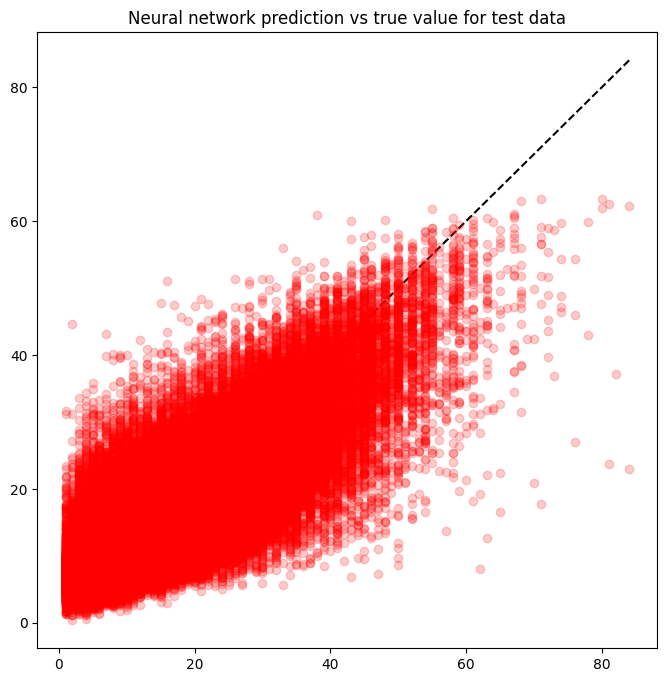

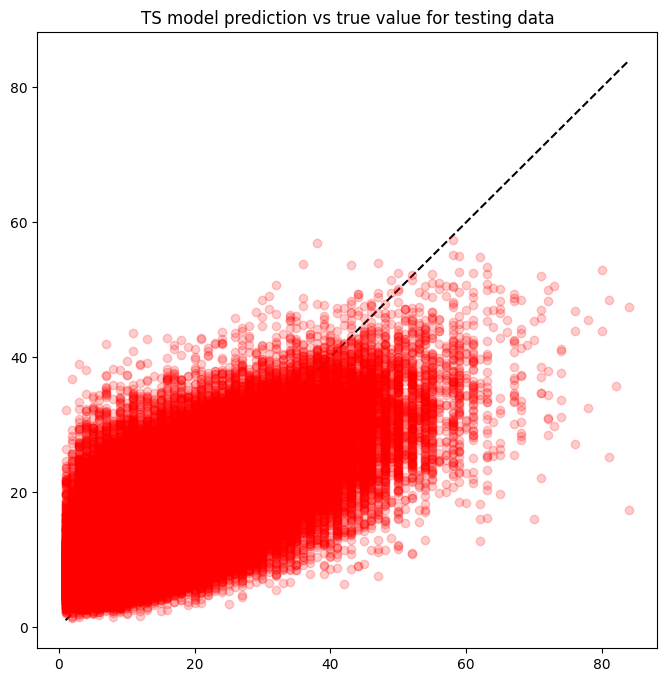

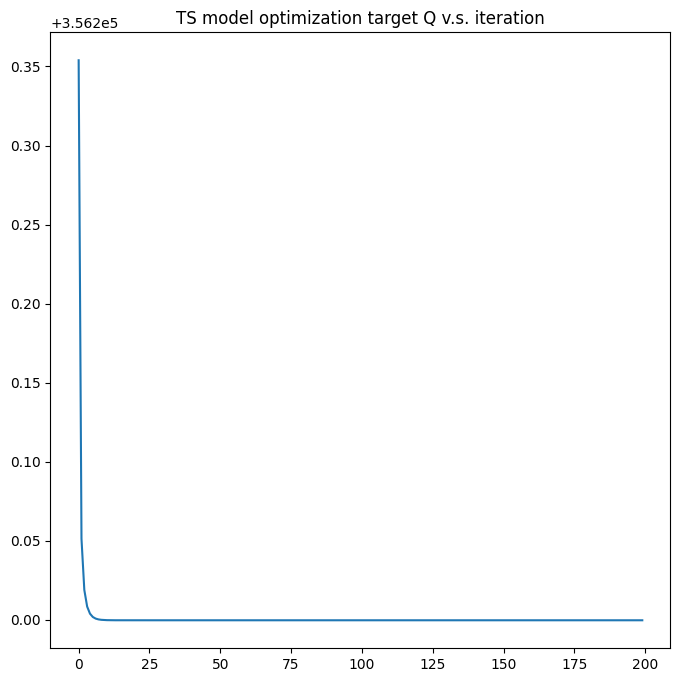

Epoch 1/50
16697/16697 [==============================] - 29s 2ms/step - loss: 42.7242 - root_mean_squared_error: 6.5364 - r_squared: 0.4673 - val_loss: 33.4018 - val_root_mean_squared_error: 5.7794 - val_r_squared: 0.3850
Epoch 2/50
16697/16697 [==============================] - 29s 2ms/step - loss: 32.7966 - root_mean_squared_error: 5.7268 - r_squared: 0.5864 - val_loss: 32.5807 - val_root_mean_squared_error: 5.7080 - val_r_squared: 0.3949
Epoch 3/50
16697/16697 [==============================] - 28s 2ms/step - loss: 32.2323 - root_mean_squared_error: 5.6773 - r_squared: 0.5925 - val_loss: 32.1455 - val_root_mean_squared_error: 5.6697 - val_r_squared: 0.4025
Epoch 4/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.9789 - root_mean_squared_error: 5.6550 - r_squared: 0.5958 - val_loss: 32.2144 - val_root_mean_squared_error: 5.6758 - val_r_squared: 0.4031
Epoch 5/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.8391 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 29s 2ms/step - loss: 30.9048 - root_mean_squared_error: 5.5592 - r_squared: 0.6085 - val_loss: 31.1070 - val_root_mean_squared_error: 5.5774 - val_r_squared: 0.4245
Epoch 39/50
16697/16697 [==============================] - 29s 2ms/step - loss: 30.8865 - root_mean_squared_error: 5.5576 - r_squared: 0.6083 - val_loss: 31.0733 - val_root_mean_squared_error: 5.5743 - val_r_squared: 0.4214
Epoch 40/50
16697/16697 [==============================] - 30s 2ms/step - loss: 30.8714 - root_mean_squared_error: 5.5562 - r_squared: 0.6081 - val_loss: 31.1817 - val_root_mean_squared_error: 5.5841 - val_r_squared: 0.4222
Epoch 41/50
16697/16697 [==============================] - 28s 2ms/step - loss: 30.8588 - root_mean_squared_error: 5.5551 - r_squared: 0.6082 - val_loss: 31.1713 - val_root_mean_squared_error: 5.5831 - val_r_squared: 0.4221
Epoch 42/50
16697/16697 [==============================] - 30s 2ms/step - loss: 30.8359 - root_mean_squa

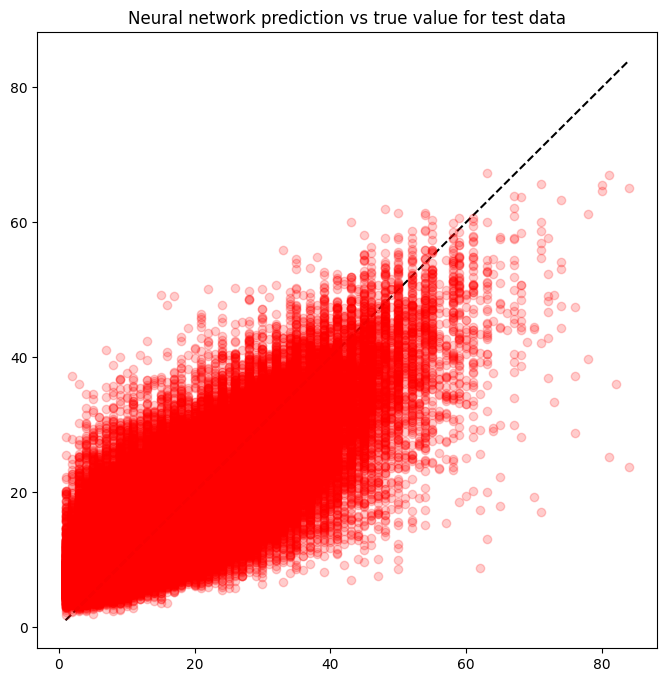

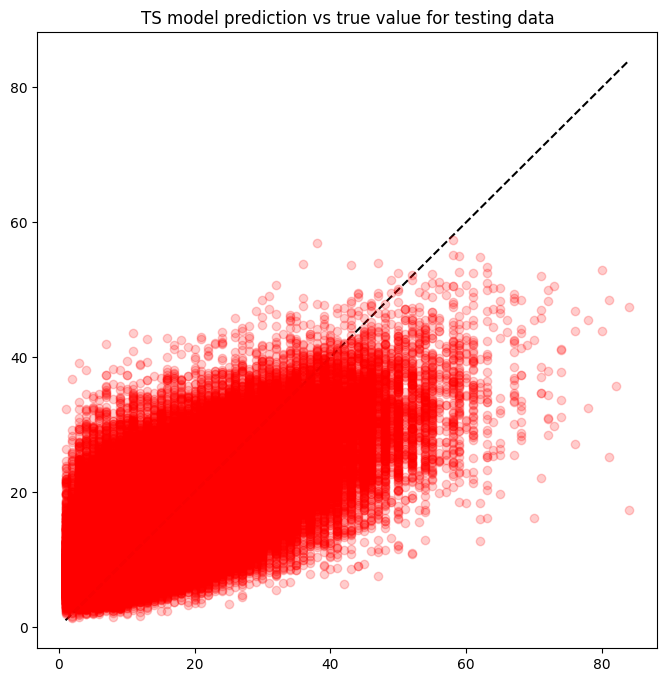

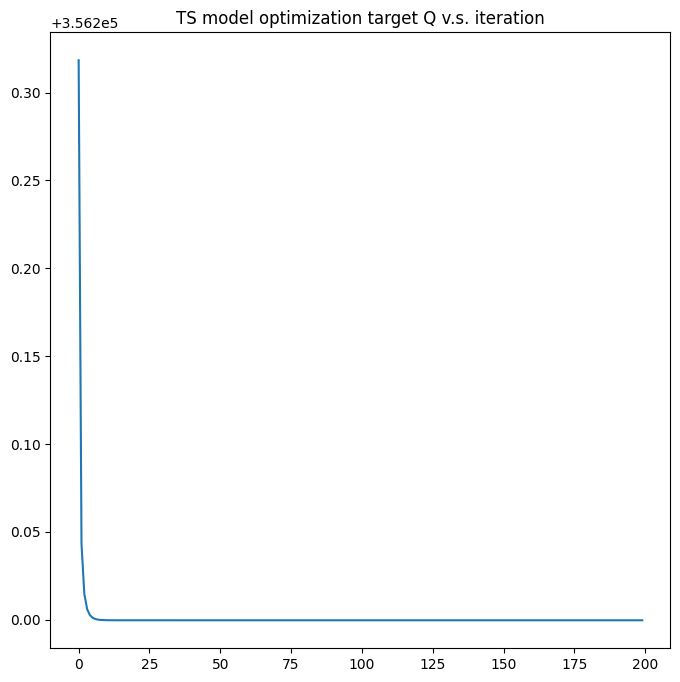

Epoch 1/50
16697/16697 [==============================] - 31s 2ms/step - loss: 42.9035 - root_mean_squared_error: 6.5501 - r_squared: 0.4653 - val_loss: 33.6790 - val_root_mean_squared_error: 5.8034 - val_r_squared: 0.3837
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 33.0133 - root_mean_squared_error: 5.7457 - r_squared: 0.5841 - val_loss: 32.7411 - val_root_mean_squared_error: 5.7220 - val_r_squared: 0.3930
Epoch 3/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.3511 - root_mean_squared_error: 5.6878 - r_squared: 0.5917 - val_loss: 32.3423 - val_root_mean_squared_error: 5.6870 - val_r_squared: 0.4034
Epoch 4/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.0888 - root_mean_squared_error: 5.6647 - r_squared: 0.5946 - val_loss: 32.0642 - val_root_mean_squared_error: 5.6625 - val_r_squared: 0.4063
Epoch 5/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.9150 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.0295 - root_mean_squared_error: 5.5704 - r_squared: 0.6056 - val_loss: 31.4236 - val_root_mean_squared_error: 5.6057 - val_r_squared: 0.4139
Epoch 39/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.0248 - root_mean_squared_error: 5.5700 - r_squared: 0.6063 - val_loss: 31.3454 - val_root_mean_squared_error: 5.5987 - val_r_squared: 0.4222
Epoch 40/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.0121 - root_mean_squared_error: 5.5689 - r_squared: 0.6067 - val_loss: 31.1864 - val_root_mean_squared_error: 5.5845 - val_r_squared: 0.4227
Epoch 41/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.0078 - root_mean_squared_error: 5.5685 - r_squared: 0.6065 - val_loss: 31.4203 - val_root_mean_squared_error: 5.6054 - val_r_squared: 0.4199
Epoch 42/50
16697/16697 [==============================] - 31s 2ms/step - loss: 30.9732 - root_mean_squa

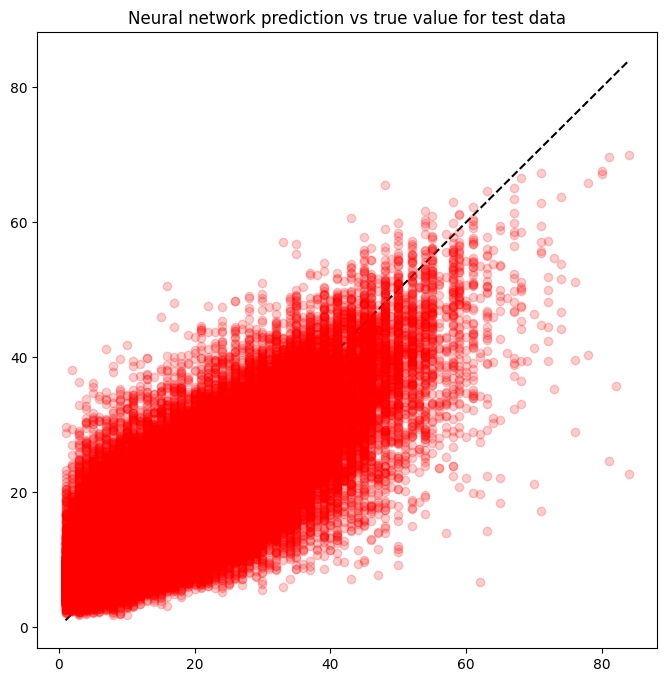

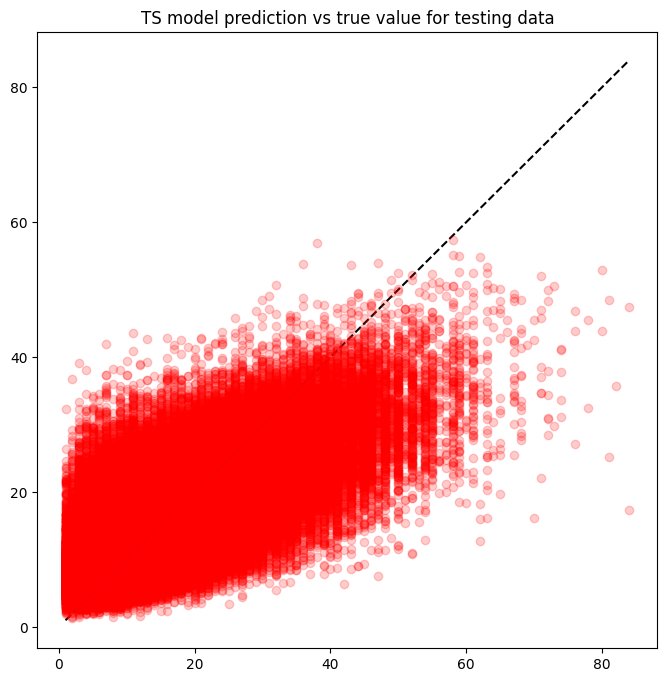

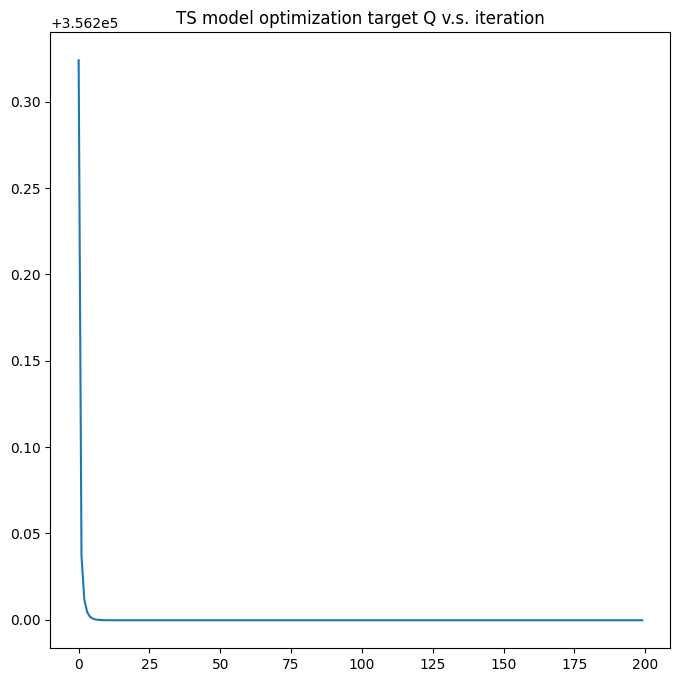

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 42.8890 - root_mean_squared_error: 6.5490 - r_squared: 0.4676 - val_loss: 33.7115 - val_root_mean_squared_error: 5.8062 - val_r_squared: 0.3859
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.9280 - root_mean_squared_error: 5.7383 - r_squared: 0.5847 - val_loss: 32.6712 - val_root_mean_squared_error: 5.7159 - val_r_squared: 0.3916
Epoch 3/50
16697/16697 [==============================] - 36s 2ms/step - loss: 32.2954 - root_mean_squared_error: 5.6829 - r_squared: 0.5930 - val_loss: 32.5519 - val_root_mean_squared_error: 5.7054 - val_r_squared: 0.3960
Epoch 4/50
16697/16697 [==============================] - 52s 3ms/step - loss: 32.0005 - root_mean_squared_error: 5.6569 - r_squared: 0.5950 - val_loss: 32.0692 - val_root_mean_squared_error: 5.6630 - val_r_squared: 0.4088
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.8365 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 55s 3ms/step - loss: 30.8796 - root_mean_squared_error: 5.5569 - r_squared: 0.6083 - val_loss: 31.0650 - val_root_mean_squared_error: 5.5736 - val_r_squared: 0.4247
Epoch 39/50
16697/16697 [==============================] - 55s 3ms/step - loss: 30.8659 - root_mean_squared_error: 5.5557 - r_squared: 0.6080 - val_loss: 31.0437 - val_root_mean_squared_error: 5.5717 - val_r_squared: 0.4274
Epoch 40/50
16697/16697 [==============================] - 55s 3ms/step - loss: 30.8591 - root_mean_squared_error: 5.5551 - r_squared: 0.6085 - val_loss: 31.0692 - val_root_mean_squared_error: 5.5740 - val_r_squared: 0.4219
Epoch 41/50
16697/16697 [==============================] - 55s 3ms/step - loss: 30.8471 - root_mean_squared_error: 5.5540 - r_squared: 0.6079 - val_loss: 31.2288 - val_root_mean_squared_error: 5.5883 - val_r_squared: 0.4272
Epoch 42/50
16697/16697 [==============================] - 55s 3ms/step - loss: 30.8364 - root_mean_squa

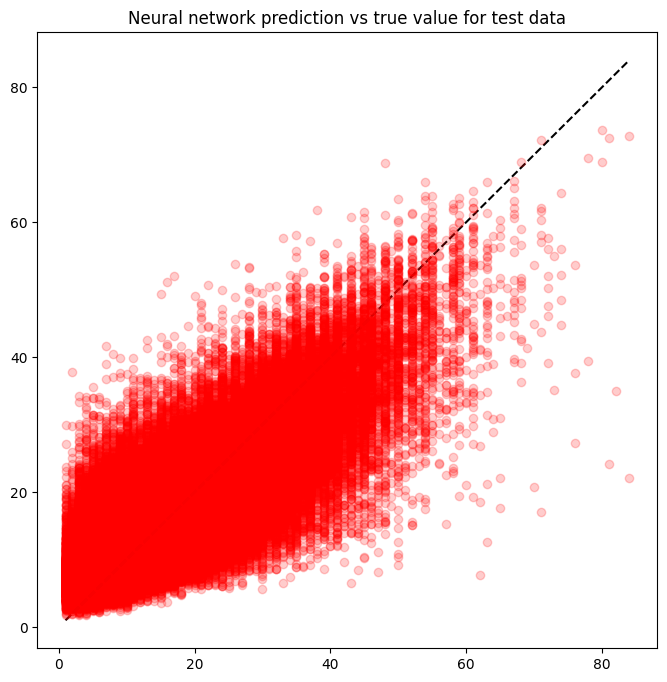

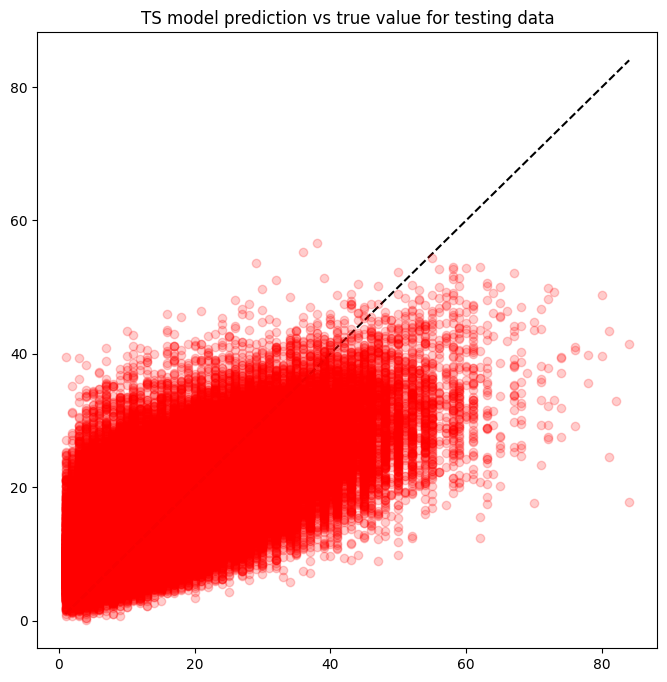

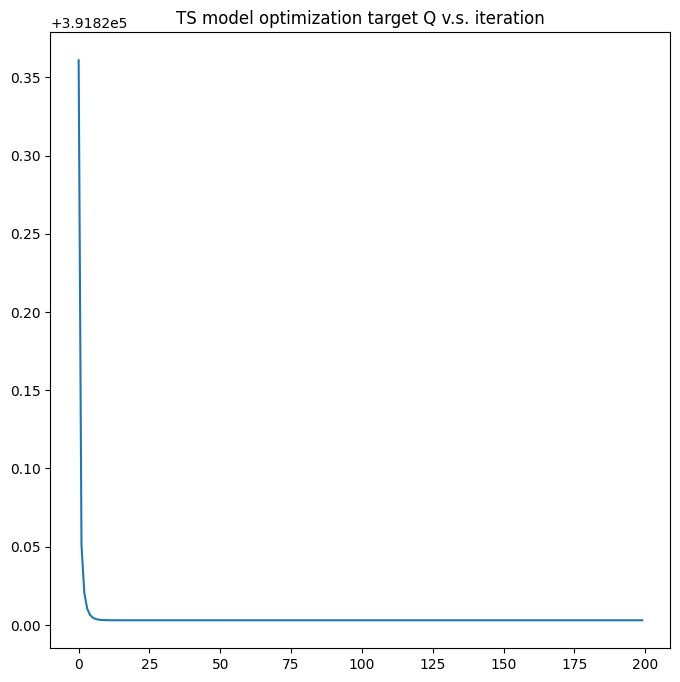

Epoch 1/50
16697/16697 [==============================] - 52s 3ms/step - loss: 43.0417 - root_mean_squared_error: 6.5606 - r_squared: 0.4660 - val_loss: 33.6245 - val_root_mean_squared_error: 5.7987 - val_r_squared: 0.3826
Epoch 2/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.8773 - root_mean_squared_error: 5.7339 - r_squared: 0.5857 - val_loss: 32.5990 - val_root_mean_squared_error: 5.7096 - val_r_squared: 0.3954
Epoch 3/50
16697/16697 [==============================] - 52s 3ms/step - loss: 32.2362 - root_mean_squared_error: 5.6777 - r_squared: 0.5927 - val_loss: 32.1602 - val_root_mean_squared_error: 5.6710 - val_r_squared: 0.4004
Epoch 4/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.9708 - root_mean_squared_error: 5.6543 - r_squared: 0.5953 - val_loss: 32.3016 - val_root_mean_squared_error: 5.6834 - val_r_squared: 0.4063
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.8135 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.9880 - root_mean_squared_error: 5.5667 - r_squared: 0.6061 - val_loss: 31.2663 - val_root_mean_squared_error: 5.5916 - val_r_squared: 0.4155
Epoch 39/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.9748 - root_mean_squared_error: 5.5655 - r_squared: 0.6061 - val_loss: 31.3419 - val_root_mean_squared_error: 5.5984 - val_r_squared: 0.4122
Epoch 40/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.9727 - root_mean_squared_error: 5.5653 - r_squared: 0.6067 - val_loss: 31.3503 - val_root_mean_squared_error: 5.5991 - val_r_squared: 0.4151
Epoch 41/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.9453 - root_mean_squared_error: 5.5628 - r_squared: 0.6075 - val_loss: 31.2283 - val_root_mean_squared_error: 5.5882 - val_r_squared: 0.4185
Epoch 42/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.9422 - root_mean_squa

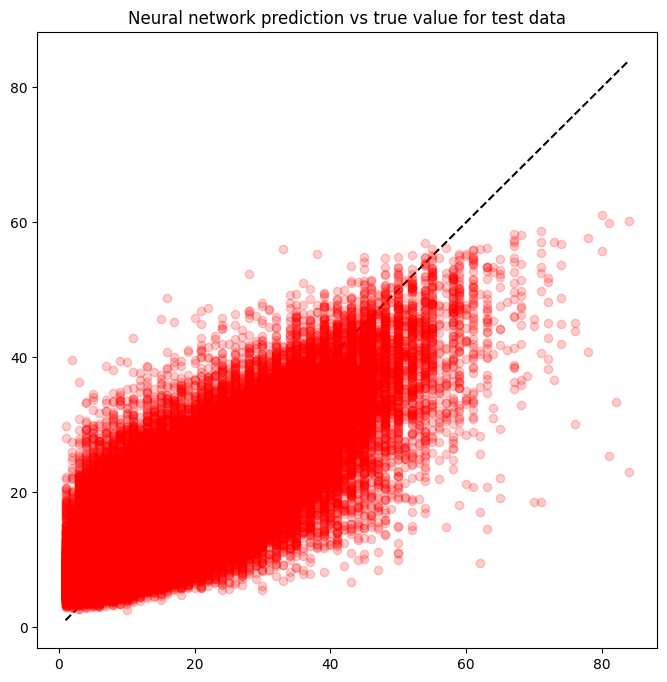

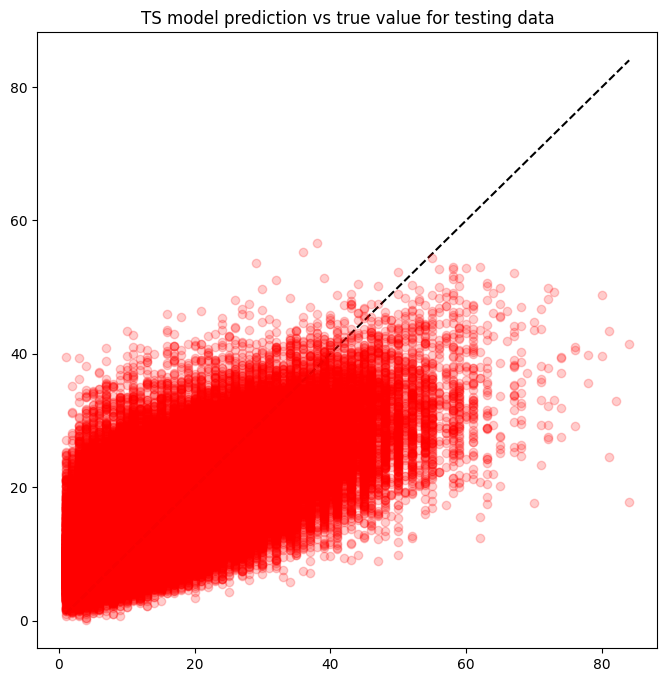

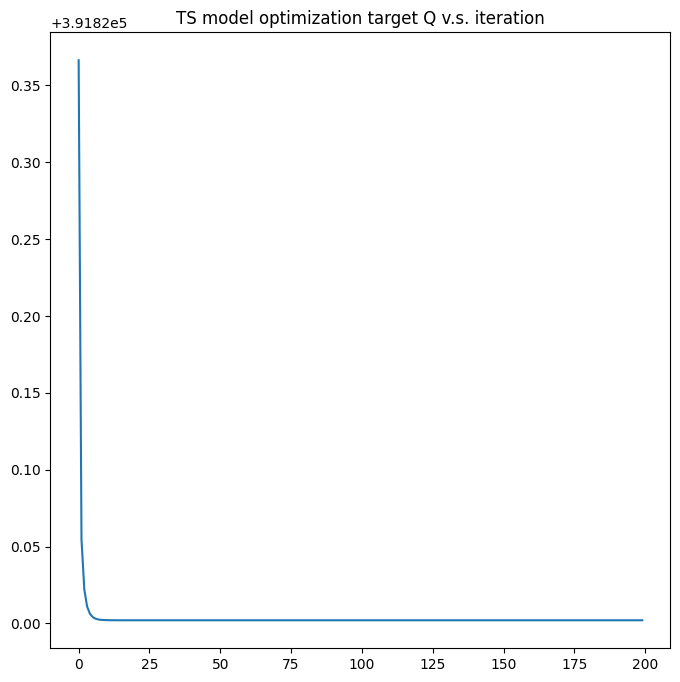

Epoch 1/50
16697/16697 [==============================] - 61s 4ms/step - loss: 42.9133 - root_mean_squared_error: 6.5508 - r_squared: 0.4652 - val_loss: 33.5229 - val_root_mean_squared_error: 5.7899 - val_r_squared: 0.3804
Epoch 2/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.8155 - root_mean_squared_error: 5.7285 - r_squared: 0.5859 - val_loss: 32.7385 - val_root_mean_squared_error: 5.7218 - val_r_squared: 0.4034
Epoch 3/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.2267 - root_mean_squared_error: 5.6769 - r_squared: 0.5934 - val_loss: 32.1734 - val_root_mean_squared_error: 5.6722 - val_r_squared: 0.4061
Epoch 4/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.9587 - root_mean_squared_error: 5.6532 - r_squared: 0.5955 - val_loss: 32.1172 - val_root_mean_squared_error: 5.6672 - val_r_squared: 0.4036
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.8165 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8843 - root_mean_squared_error: 5.5574 - r_squared: 0.6077 - val_loss: 31.1373 - val_root_mean_squared_error: 5.5801 - val_r_squared: 0.4227
Epoch 39/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8799 - root_mean_squared_error: 5.5570 - r_squared: 0.6096 - val_loss: 31.1236 - val_root_mean_squared_error: 5.5788 - val_r_squared: 0.4232
Epoch 40/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8620 - root_mean_squared_error: 5.5554 - r_squared: 0.6084 - val_loss: 31.1618 - val_root_mean_squared_error: 5.5823 - val_r_squared: 0.4233
Epoch 41/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8388 - root_mean_squared_error: 5.5533 - r_squared: 0.6085 - val_loss: 31.1650 - val_root_mean_squared_error: 5.5826 - val_r_squared: 0.4183
Epoch 42/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8459 - root_mean_squa

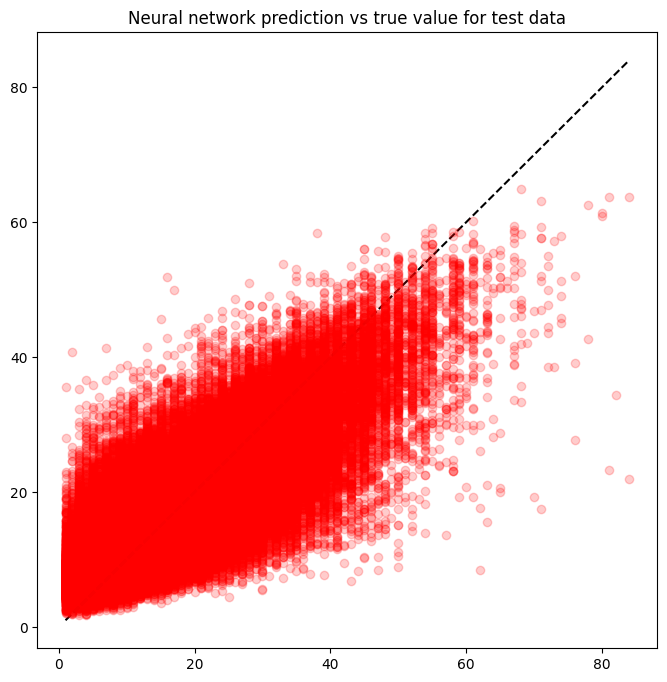

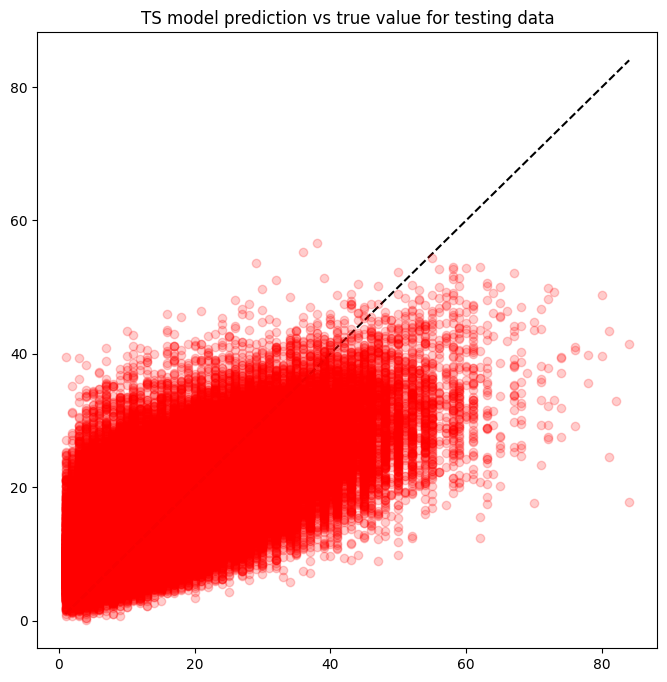

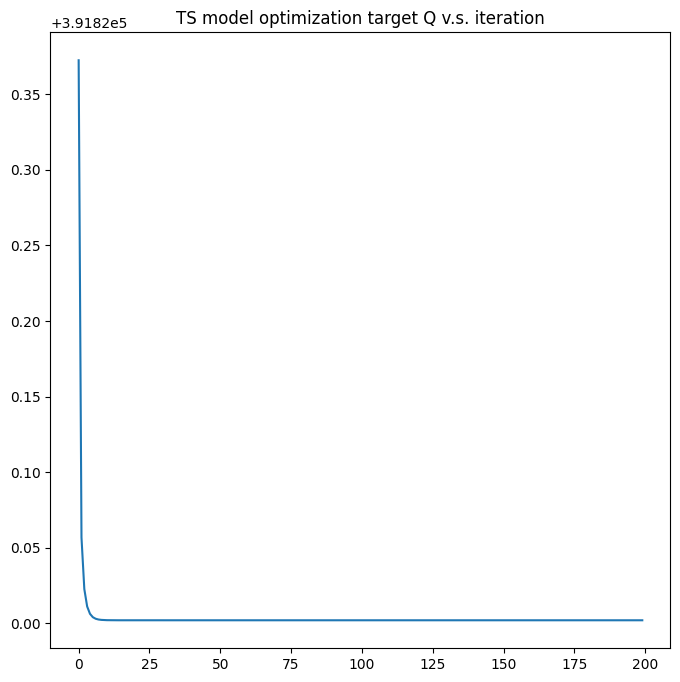

Epoch 1/50
16697/16697 [==============================] - 52s 3ms/step - loss: 42.7844 - root_mean_squared_error: 6.5410 - r_squared: 0.4674 - val_loss: 33.3260 - val_root_mean_squared_error: 5.7729 - val_r_squared: 0.3843
Epoch 2/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.7240 - root_mean_squared_error: 5.7205 - r_squared: 0.5871 - val_loss: 32.5519 - val_root_mean_squared_error: 5.7054 - val_r_squared: 0.4004
Epoch 3/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.1804 - root_mean_squared_error: 5.6728 - r_squared: 0.5943 - val_loss: 32.1283 - val_root_mean_squared_error: 5.6682 - val_r_squared: 0.4085
Epoch 4/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.9442 - root_mean_squared_error: 5.6519 - r_squared: 0.5947 - val_loss: 32.0823 - val_root_mean_squared_error: 5.6641 - val_r_squared: 0.4104
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.7813 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 61s 4ms/step - loss: 30.8841 - root_mean_squared_error: 5.5573 - r_squared: 0.6079 - val_loss: 31.0714 - val_root_mean_squared_error: 5.5742 - val_r_squared: 0.4244
Epoch 39/50
16697/16697 [==============================] - 54s 3ms/step - loss: 30.8828 - root_mean_squared_error: 5.5572 - r_squared: 0.6083 - val_loss: 31.2103 - val_root_mean_squared_error: 5.5866 - val_r_squared: 0.4186
Epoch 40/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8613 - root_mean_squared_error: 5.5553 - r_squared: 0.6078 - val_loss: 31.2484 - val_root_mean_squared_error: 5.5900 - val_r_squared: 0.4150
Epoch 41/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8500 - root_mean_squared_error: 5.5543 - r_squared: 0.6085 - val_loss: 31.0986 - val_root_mean_squared_error: 5.5766 - val_r_squared: 0.4195
Epoch 42/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8377 - root_mean_squa

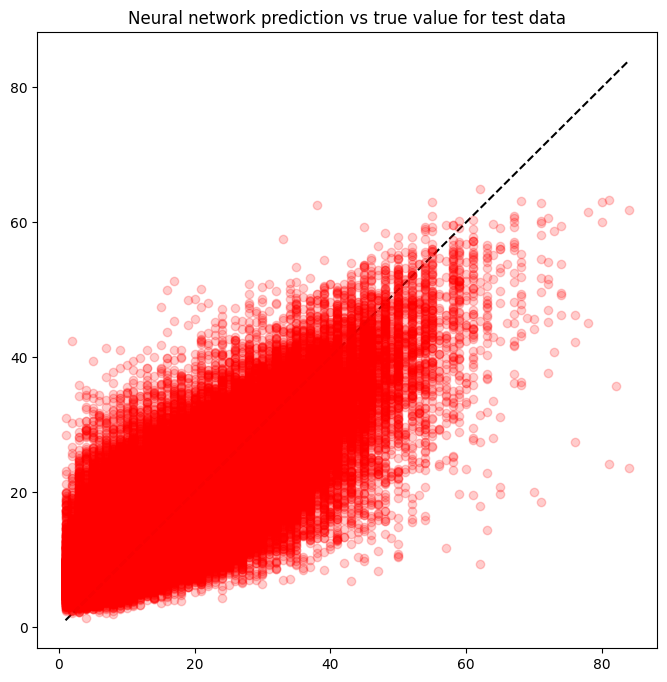

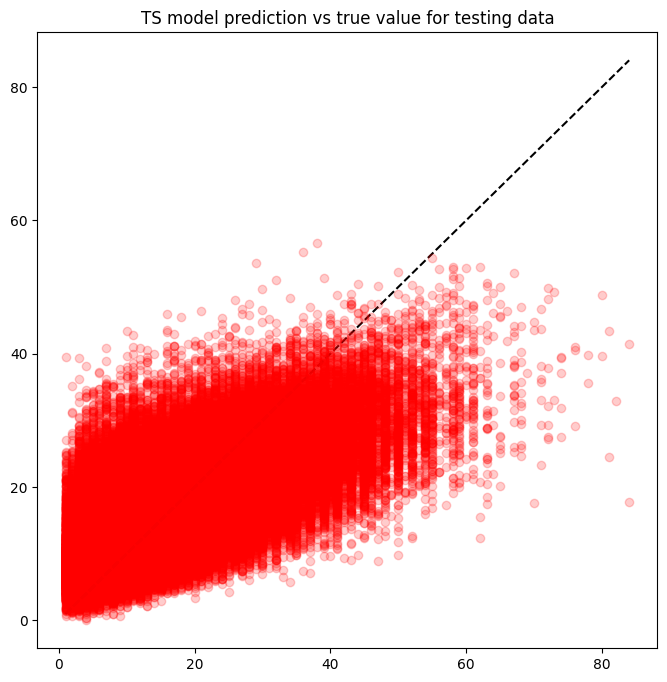

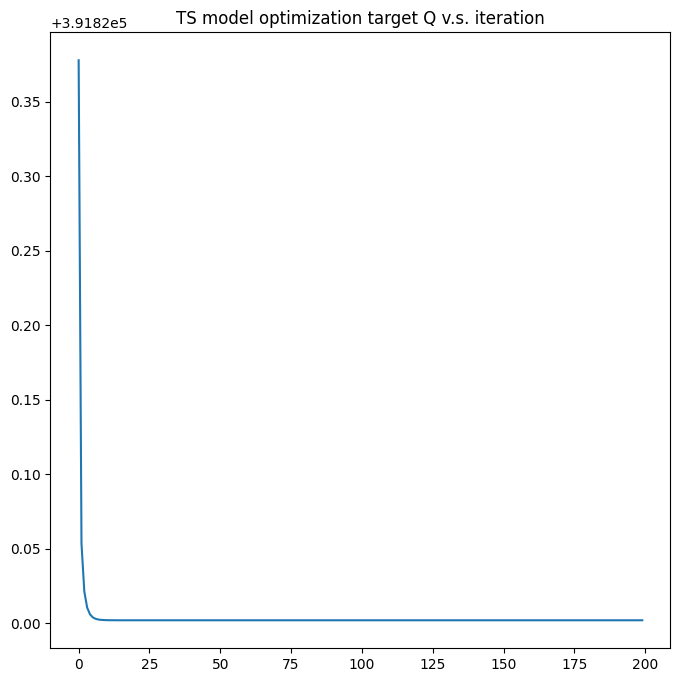

Epoch 1/50
16697/16697 [==============================] - 52s 3ms/step - loss: 42.8091 - root_mean_squared_error: 6.5429 - r_squared: 0.4682 - val_loss: 33.3153 - val_root_mean_squared_error: 5.7719 - val_r_squared: 0.3898
Epoch 2/50
16697/16697 [==============================] - 50s 3ms/step - loss: 32.6863 - root_mean_squared_error: 5.7172 - r_squared: 0.5878 - val_loss: 32.4468 - val_root_mean_squared_error: 5.6962 - val_r_squared: 0.3959
Epoch 3/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.1028 - root_mean_squared_error: 5.6659 - r_squared: 0.5950 - val_loss: 32.1326 - val_root_mean_squared_error: 5.6686 - val_r_squared: 0.4051
Epoch 4/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.8458 - root_mean_squared_error: 5.6432 - r_squared: 0.5968 - val_loss: 31.8564 - val_root_mean_squared_error: 5.6441 - val_r_squared: 0.4097
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.7086 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8645 - root_mean_squared_error: 5.5556 - r_squared: 0.6087 - val_loss: 31.1273 - val_root_mean_squared_error: 5.5792 - val_r_squared: 0.4200
Epoch 39/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8519 - root_mean_squared_error: 5.5545 - r_squared: 0.6086 - val_loss: 31.0539 - val_root_mean_squared_error: 5.5726 - val_r_squared: 0.4248
Epoch 40/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8189 - root_mean_squared_error: 5.5515 - r_squared: 0.6085 - val_loss: 31.1124 - val_root_mean_squared_error: 5.5778 - val_r_squared: 0.4250
Epoch 41/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8216 - root_mean_squared_error: 5.5517 - r_squared: 0.6092 - val_loss: 31.0413 - val_root_mean_squared_error: 5.5715 - val_r_squared: 0.4251
Epoch 42/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8166 - root_mean_squa

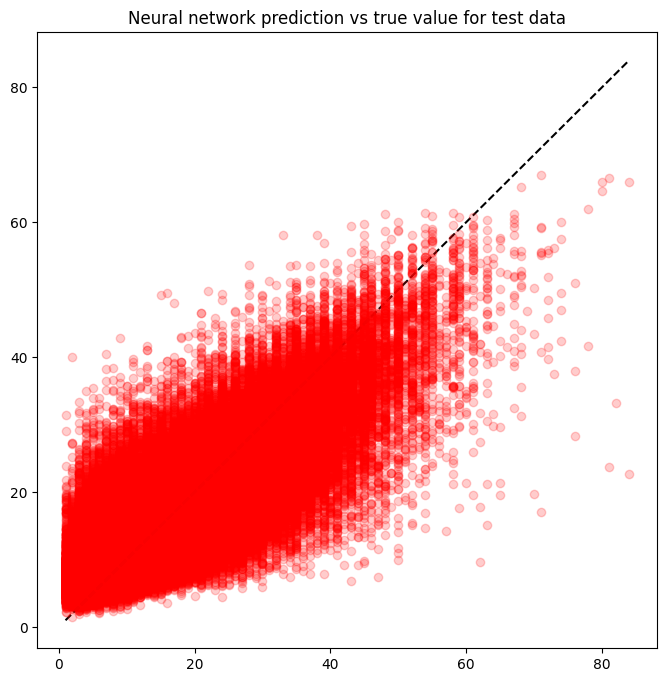

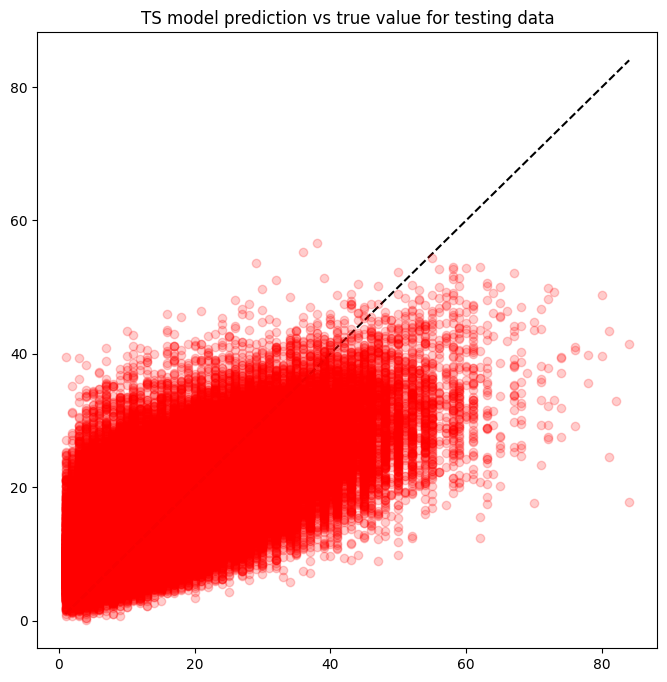

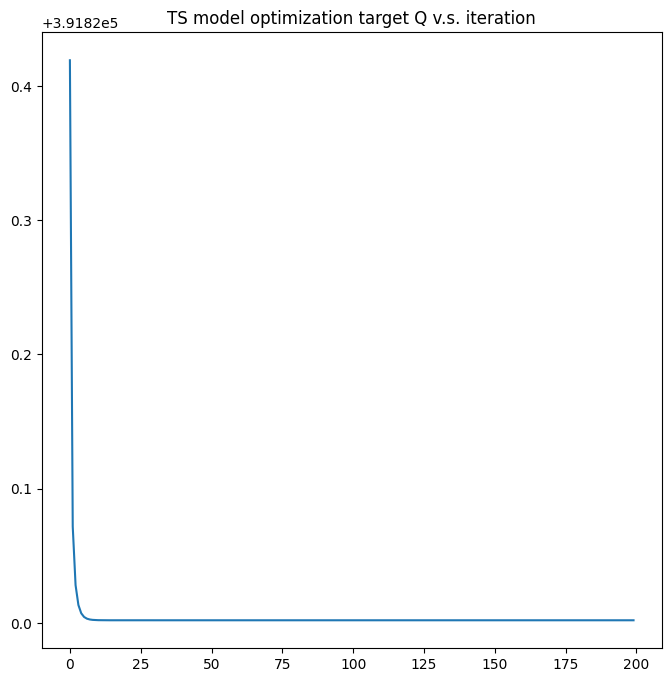

Epoch 1/50
16697/16697 [==============================] - 52s 3ms/step - loss: 42.6882 - root_mean_squared_error: 6.5336 - r_squared: 0.4671 - val_loss: 33.1880 - val_root_mean_squared_error: 5.7609 - val_r_squared: 0.3890
Epoch 2/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.6354 - root_mean_squared_error: 5.7127 - r_squared: 0.5886 - val_loss: 32.2885 - val_root_mean_squared_error: 5.6823 - val_r_squared: 0.3991
Epoch 3/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.1181 - root_mean_squared_error: 5.6673 - r_squared: 0.5943 - val_loss: 32.0081 - val_root_mean_squared_error: 5.6576 - val_r_squared: 0.4084
Epoch 4/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.8776 - root_mean_squared_error: 5.6460 - r_squared: 0.5962 - val_loss: 32.0148 - val_root_mean_squared_error: 5.6582 - val_r_squared: 0.4084
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.7567 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.9052 - root_mean_squared_error: 5.5592 - r_squared: 0.6078 - val_loss: 31.0820 - val_root_mean_squared_error: 5.5751 - val_r_squared: 0.4225
Epoch 39/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8775 - root_mean_squared_error: 5.5567 - r_squared: 0.6084 - val_loss: 31.2025 - val_root_mean_squared_error: 5.5859 - val_r_squared: 0.4199
Epoch 40/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8754 - root_mean_squared_error: 5.5566 - r_squared: 0.6080 - val_loss: 31.1235 - val_root_mean_squared_error: 5.5788 - val_r_squared: 0.4256
Epoch 41/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8591 - root_mean_squared_error: 5.5551 - r_squared: 0.6093 - val_loss: 31.1055 - val_root_mean_squared_error: 5.5772 - val_r_squared: 0.4208
Epoch 42/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8464 - root_mean_squa

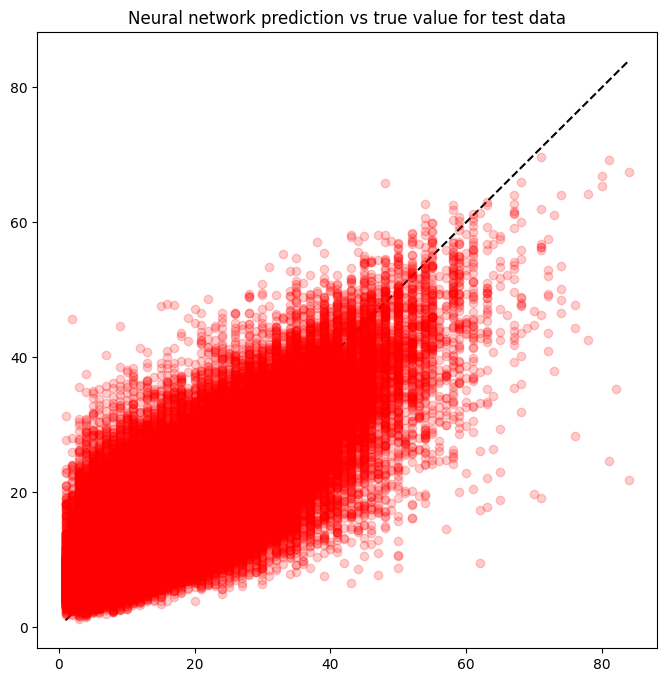

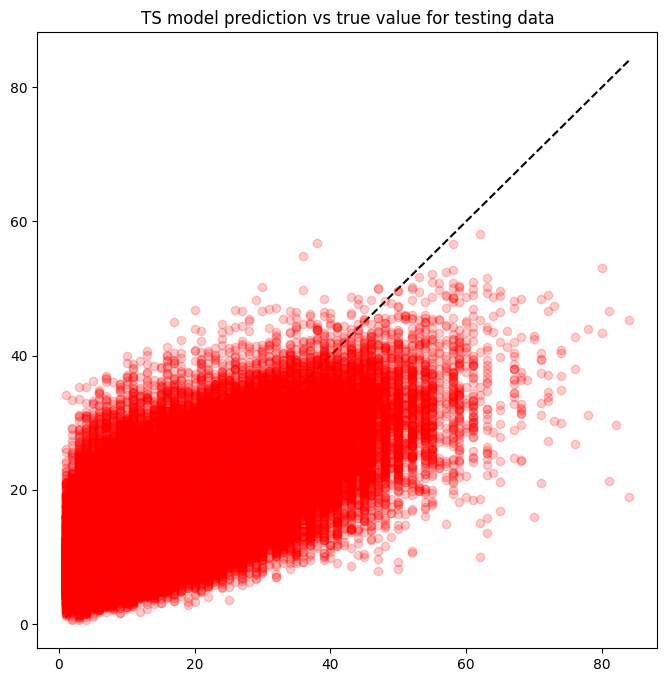

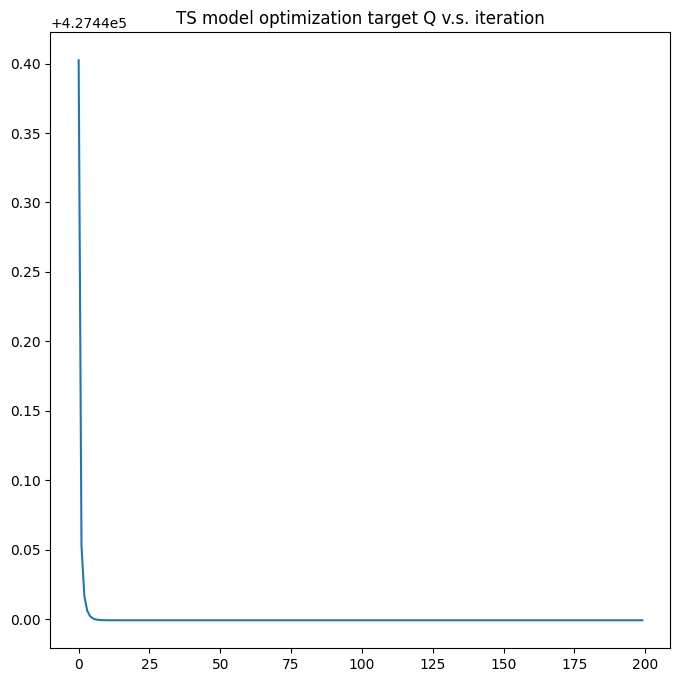

Epoch 1/50
16697/16697 [==============================] - 52s 3ms/step - loss: 43.0388 - root_mean_squared_error: 6.5604 - r_squared: 0.4648 - val_loss: 33.5799 - val_root_mean_squared_error: 5.7948 - val_r_squared: 0.3856
Epoch 2/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.9099 - root_mean_squared_error: 5.7367 - r_squared: 0.5858 - val_loss: 32.6119 - val_root_mean_squared_error: 5.7107 - val_r_squared: 0.3968
Epoch 3/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.2844 - root_mean_squared_error: 5.6819 - r_squared: 0.5925 - val_loss: 32.1289 - val_root_mean_squared_error: 5.6682 - val_r_squared: 0.4024
Epoch 4/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.9626 - root_mean_squared_error: 5.6536 - r_squared: 0.5950 - val_loss: 31.9204 - val_root_mean_squared_error: 5.6498 - val_r_squared: 0.4048
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.7813 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 52s 3ms/step - loss: 30.8990 - root_mean_squared_error: 5.5587 - r_squared: 0.6084 - val_loss: 31.0131 - val_root_mean_squared_error: 5.5689 - val_r_squared: 0.4245
Epoch 39/50
16697/16697 [==============================] - 61s 4ms/step - loss: 30.8833 - root_mean_squared_error: 5.5573 - r_squared: 0.6083 - val_loss: 31.1768 - val_root_mean_squared_error: 5.5836 - val_r_squared: 0.4257
Epoch 40/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8639 - root_mean_squared_error: 5.5555 - r_squared: 0.6082 - val_loss: 31.0280 - val_root_mean_squared_error: 5.5703 - val_r_squared: 0.4224
Epoch 41/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8535 - root_mean_squared_error: 5.5546 - r_squared: 0.6086 - val_loss: 31.0891 - val_root_mean_squared_error: 5.5758 - val_r_squared: 0.4199
Epoch 42/50
16697/16697 [==============================] - 51s 3ms/step - loss: 30.8435 - root_mean_squa

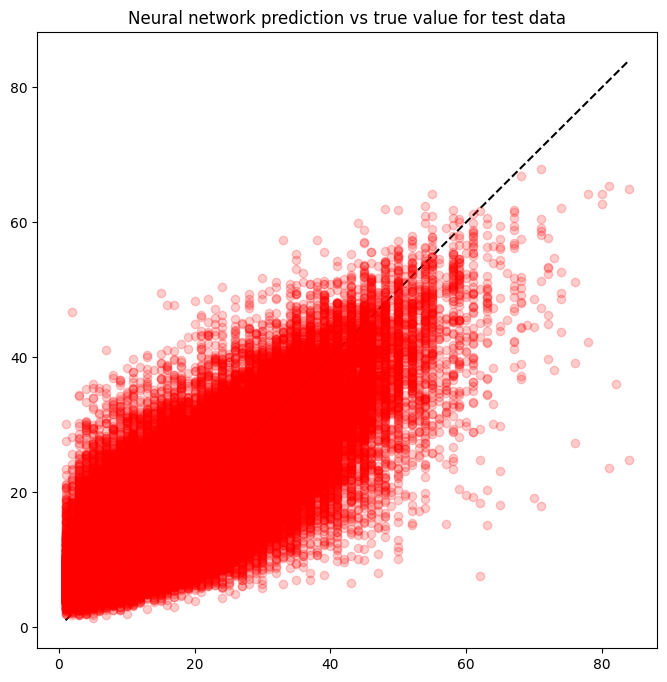

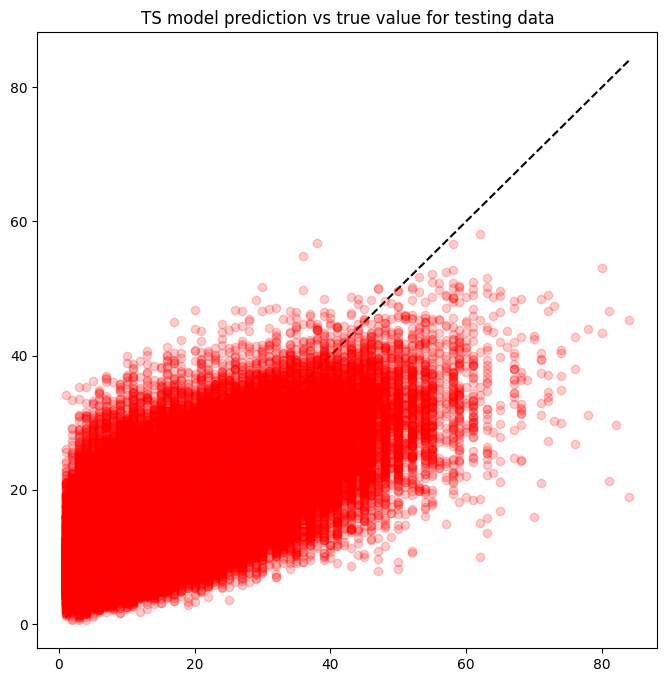

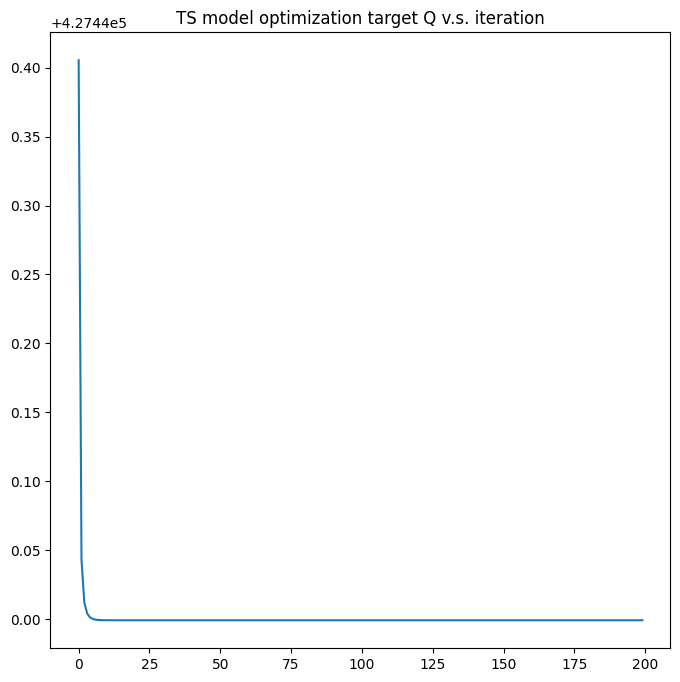

Epoch 1/50
16697/16697 [==============================] - 51s 3ms/step - loss: 42.8493 - root_mean_squared_error: 6.5459 - r_squared: 0.4657 - val_loss: 33.5447 - val_root_mean_squared_error: 5.7918 - val_r_squared: 0.3806
Epoch 2/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.8543 - root_mean_squared_error: 5.7319 - r_squared: 0.5863 - val_loss: 32.9066 - val_root_mean_squared_error: 5.7364 - val_r_squared: 0.3909
Epoch 3/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.2202 - root_mean_squared_error: 5.6763 - r_squared: 0.5934 - val_loss: 32.1088 - val_root_mean_squared_error: 5.6665 - val_r_squared: 0.4054
Epoch 4/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.8905 - root_mean_squared_error: 5.6472 - r_squared: 0.5959 - val_loss: 32.0906 - val_root_mean_squared_error: 5.6649 - val_r_squared: 0.4029
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.7014 - root_mean_squared_e

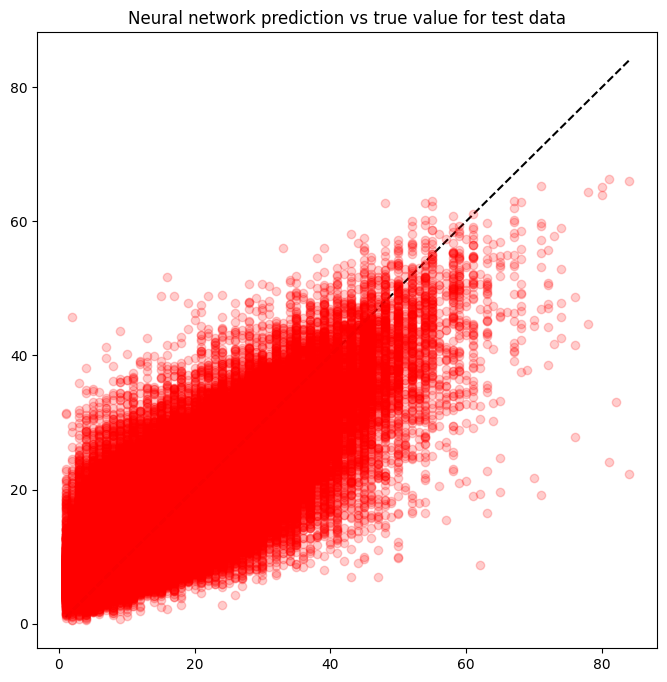

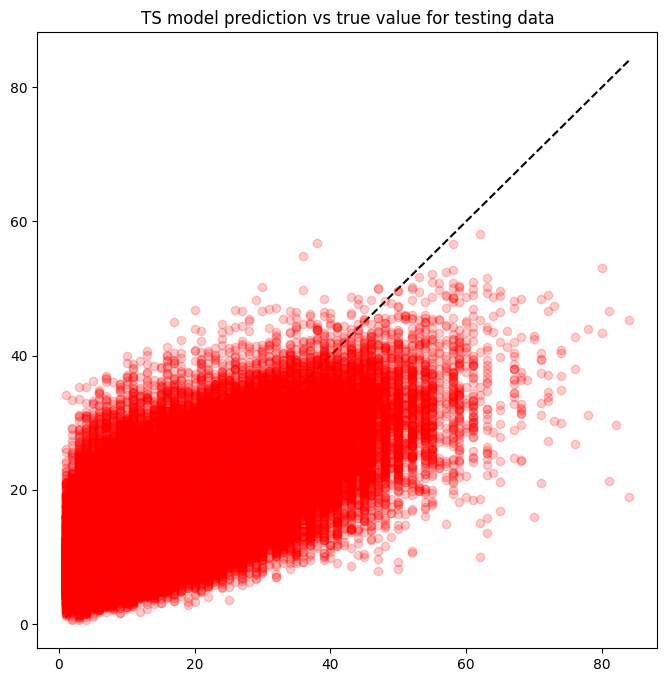

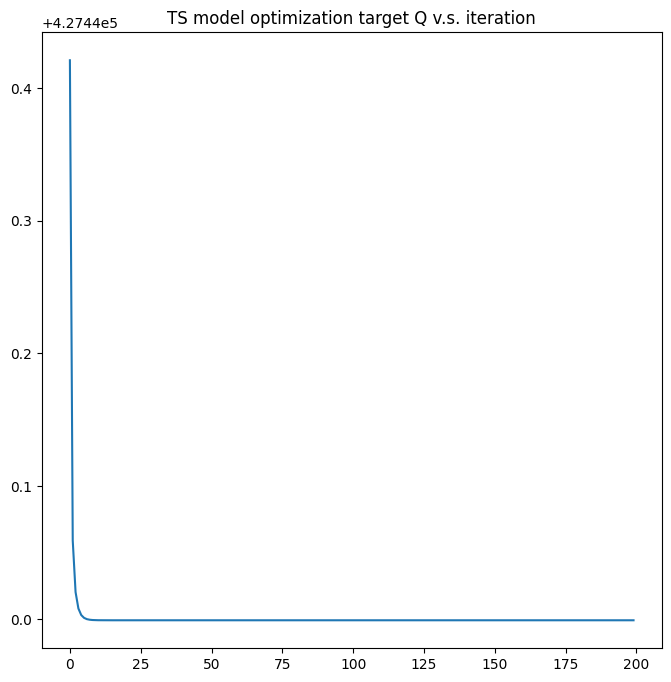

Epoch 1/50
16697/16697 [==============================] - 51s 3ms/step - loss: 43.0015 - root_mean_squared_error: 6.5576 - r_squared: 0.4643 - val_loss: 33.3936 - val_root_mean_squared_error: 5.7787 - val_r_squared: 0.3897
Epoch 2/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.8353 - root_mean_squared_error: 5.7302 - r_squared: 0.5859 - val_loss: 32.5918 - val_root_mean_squared_error: 5.7089 - val_r_squared: 0.3917
Epoch 3/50
16697/16697 [==============================] - 51s 3ms/step - loss: 32.2481 - root_mean_squared_error: 5.6787 - r_squared: 0.5920 - val_loss: 32.1729 - val_root_mean_squared_error: 5.6721 - val_r_squared: 0.4055
Epoch 4/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.9465 - root_mean_squared_error: 5.6521 - r_squared: 0.5956 - val_loss: 32.0602 - val_root_mean_squared_error: 5.6622 - val_r_squared: 0.4066
Epoch 5/50
16697/16697 [==============================] - 51s 3ms/step - loss: 31.7519 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 31s 2ms/step - loss: 30.8767 - root_mean_squared_error: 5.5567 - r_squared: 0.6075 - val_loss: 31.1716 - val_root_mean_squared_error: 5.5832 - val_r_squared: 0.4187
Epoch 39/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.8762 - root_mean_squared_error: 5.5566 - r_squared: 0.6086 - val_loss: 30.9720 - val_root_mean_squared_error: 5.5653 - val_r_squared: 0.4210
Epoch 40/50
16697/16697 [==============================] - 31s 2ms/step - loss: 30.8656 - root_mean_squared_error: 5.5557 - r_squared: 0.6081 - val_loss: 31.0575 - val_root_mean_squared_error: 5.5729 - val_r_squared: 0.4220
Epoch 41/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.8358 - root_mean_squared_error: 5.5530 - r_squared: 0.6086 - val_loss: 31.1488 - val_root_mean_squared_error: 5.5811 - val_r_squared: 0.4179
Epoch 42/50
16697/16697 [==============================] - 31s 2ms/step - loss: 30.8345 - root_mean_squa

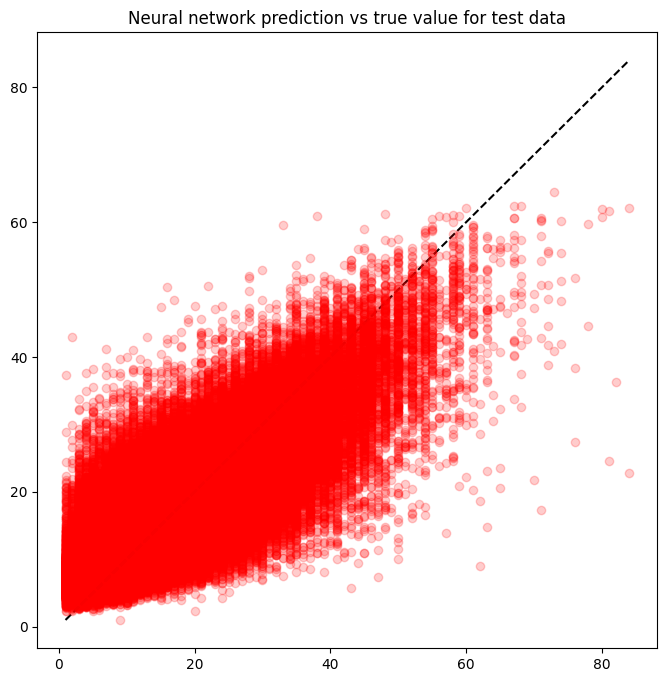

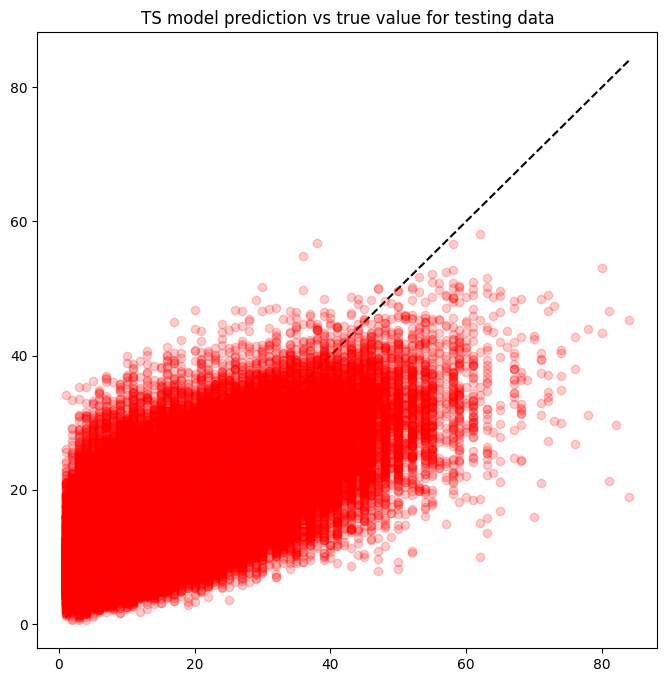

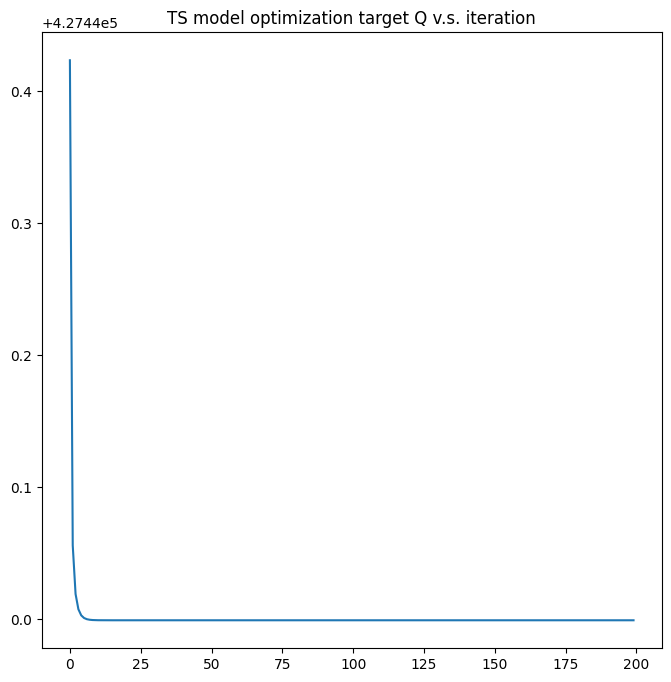

Epoch 1/50
16697/16697 [==============================] - 53s 3ms/step - loss: 43.0482 - root_mean_squared_error: 6.5611 - r_squared: 0.4627 - val_loss: 33.6453 - val_root_mean_squared_error: 5.8005 - val_r_squared: 0.3750
Epoch 2/50
16697/16697 [==============================] - 57s 3ms/step - loss: 32.7165 - root_mean_squared_error: 5.7198 - r_squared: 0.5868 - val_loss: 32.7844 - val_root_mean_squared_error: 5.7258 - val_r_squared: 0.3937
Epoch 3/50
16697/16697 [==============================] - 42s 2ms/step - loss: 32.1024 - root_mean_squared_error: 5.6659 - r_squared: 0.5938 - val_loss: 32.0974 - val_root_mean_squared_error: 5.6655 - val_r_squared: 0.4020
Epoch 4/50
16697/16697 [==============================] - 33s 2ms/step - loss: 31.8311 - root_mean_squared_error: 5.6419 - r_squared: 0.5971 - val_loss: 32.0023 - val_root_mean_squared_error: 5.6571 - val_r_squared: 0.4066
Epoch 5/50
16697/16697 [==============================] - 49s 3ms/step - loss: 31.6570 - root_mean_squared_e

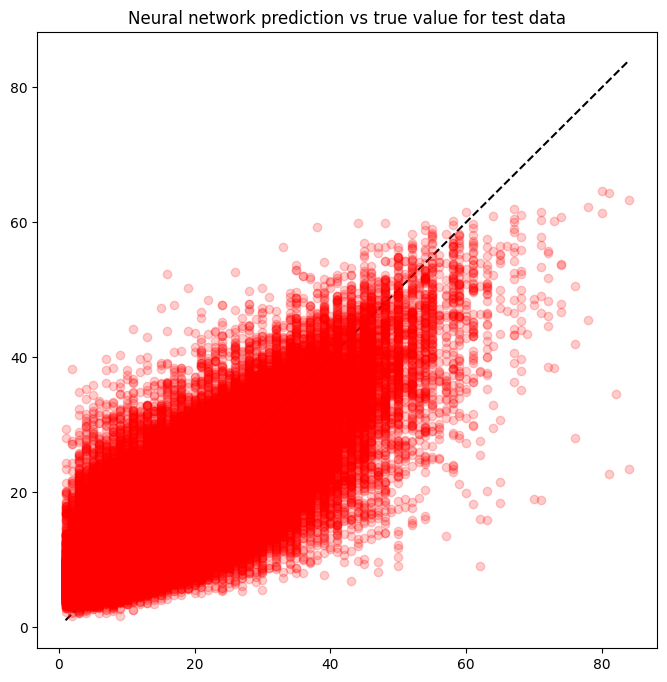

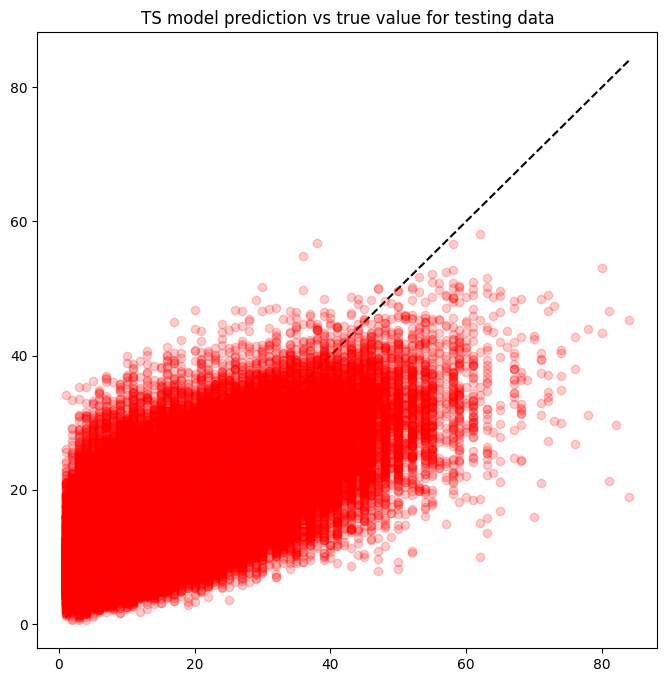

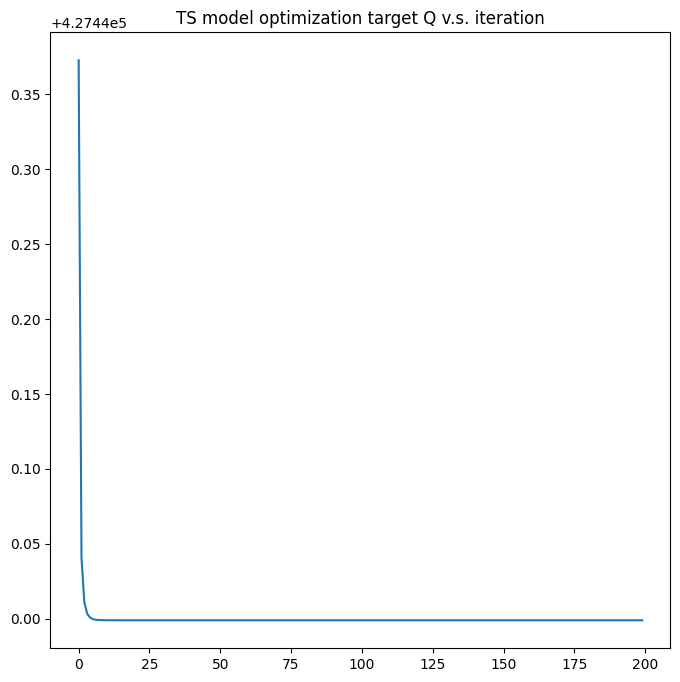

Epoch 1/50
16697/16697 [==============================] - 35s 2ms/step - loss: 43.5195 - root_mean_squared_error: 6.5969 - r_squared: 0.4600 - val_loss: 33.6046 - val_root_mean_squared_error: 5.7970 - val_r_squared: 0.3886
Epoch 2/50
16697/16697 [==============================] - 34s 2ms/step - loss: 32.8174 - root_mean_squared_error: 5.7286 - r_squared: 0.5860 - val_loss: 32.6309 - val_root_mean_squared_error: 5.7124 - val_r_squared: 0.3943
Epoch 3/50
16697/16697 [==============================] - 34s 2ms/step - loss: 32.2045 - root_mean_squared_error: 5.6749 - r_squared: 0.5936 - val_loss: 32.2186 - val_root_mean_squared_error: 5.6761 - val_r_squared: 0.4059
Epoch 4/50
16697/16697 [==============================] - 34s 2ms/step - loss: 31.8724 - root_mean_squared_error: 5.6456 - r_squared: 0.5961 - val_loss: 32.1614 - val_root_mean_squared_error: 5.6711 - val_r_squared: 0.3995
Epoch 5/50
16697/16697 [==============================] - 33s 2ms/step - loss: 31.7127 - root_mean_squared_e

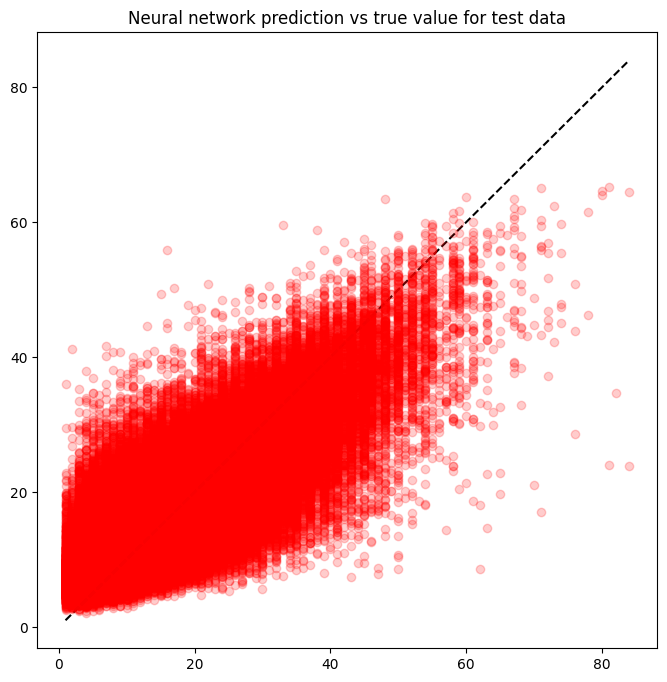

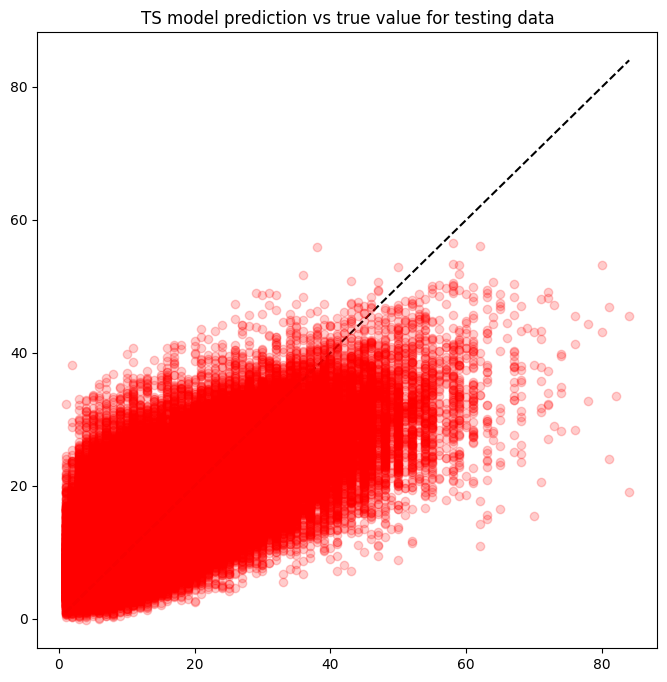

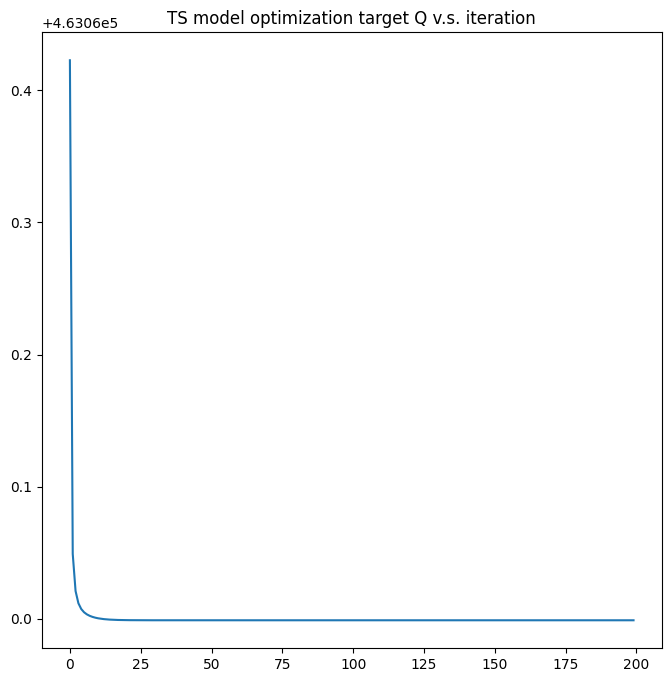

Epoch 1/50
16697/16697 [==============================] - 31s 2ms/step - loss: 43.4503 - root_mean_squared_error: 6.5917 - r_squared: 0.4632 - val_loss: 33.3538 - val_root_mean_squared_error: 5.7753 - val_r_squared: 0.3861
Epoch 2/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.7117 - root_mean_squared_error: 5.7194 - r_squared: 0.5877 - val_loss: 32.5218 - val_root_mean_squared_error: 5.7028 - val_r_squared: 0.3958
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.1231 - root_mean_squared_error: 5.6677 - r_squared: 0.5941 - val_loss: 31.9759 - val_root_mean_squared_error: 5.6547 - val_r_squared: 0.4077
Epoch 4/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.7860 - root_mean_squared_error: 5.6379 - r_squared: 0.5976 - val_loss: 31.7957 - val_root_mean_squared_error: 5.6388 - val_r_squared: 0.4100
Epoch 5/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.5761 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 31s 2ms/step - loss: 30.4852 - root_mean_squared_error: 5.5213 - r_squared: 0.6137 - val_loss: 30.8189 - val_root_mean_squared_error: 5.5515 - val_r_squared: 0.4224
Epoch 39/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.4786 - root_mean_squared_error: 5.5207 - r_squared: 0.6132 - val_loss: 30.6692 - val_root_mean_squared_error: 5.5380 - val_r_squared: 0.4295
Epoch 40/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.4802 - root_mean_squared_error: 5.5209 - r_squared: 0.6127 - val_loss: 30.7547 - val_root_mean_squared_error: 5.5457 - val_r_squared: 0.4287
Epoch 41/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.4597 - root_mean_squared_error: 5.5190 - r_squared: 0.6125 - val_loss: 30.6922 - val_root_mean_squared_error: 5.5401 - val_r_squared: 0.4268
Epoch 42/50
16697/16697 [==============================] - 31s 2ms/step - loss: 30.4600 - root_mean_squa

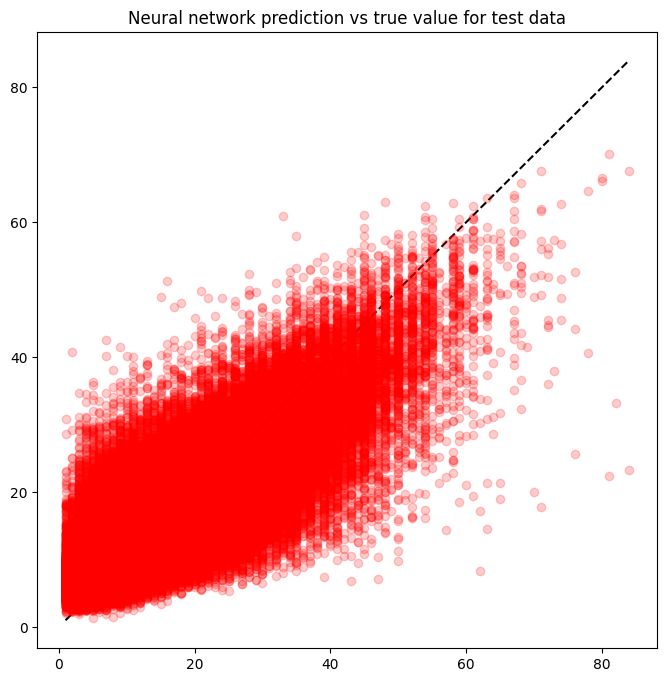

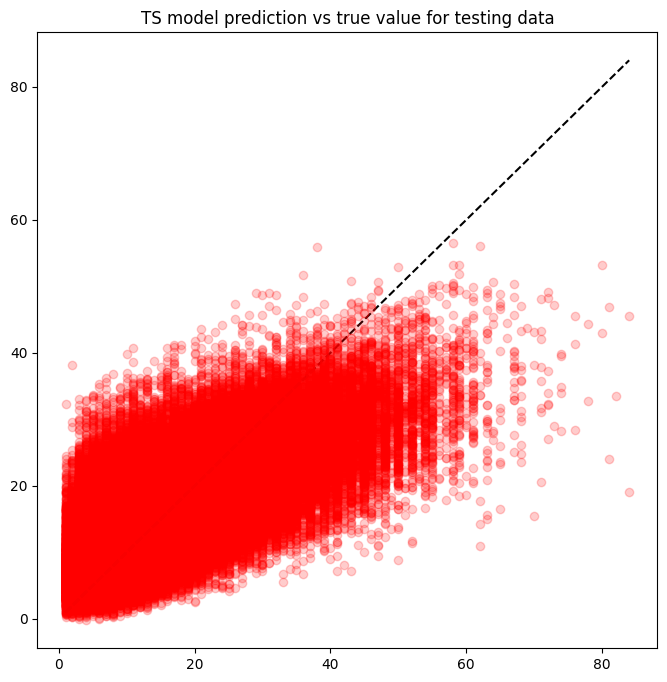

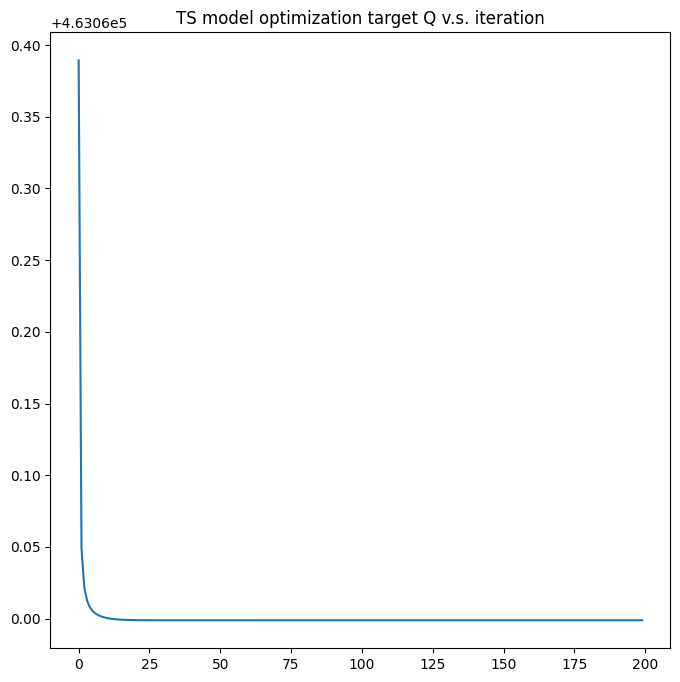

Epoch 1/50
16697/16697 [==============================] - 31s 2ms/step - loss: 43.0022 - root_mean_squared_error: 6.5576 - r_squared: 0.4655 - val_loss: 33.4084 - val_root_mean_squared_error: 5.7800 - val_r_squared: 0.3883
Epoch 2/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.8079 - root_mean_squared_error: 5.7278 - r_squared: 0.5863 - val_loss: 32.5627 - val_root_mean_squared_error: 5.7064 - val_r_squared: 0.4034
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.1980 - root_mean_squared_error: 5.6743 - r_squared: 0.5924 - val_loss: 32.2660 - val_root_mean_squared_error: 5.6803 - val_r_squared: 0.4034
Epoch 4/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.8951 - root_mean_squared_error: 5.6476 - r_squared: 0.5970 - val_loss: 31.8761 - val_root_mean_squared_error: 5.6459 - val_r_squared: 0.4063
Epoch 5/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.6809 - root_mean_squared_e

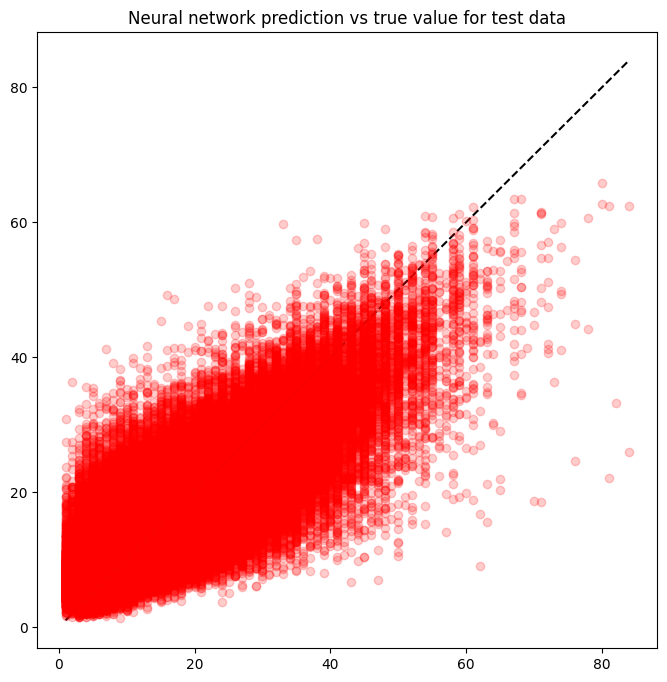

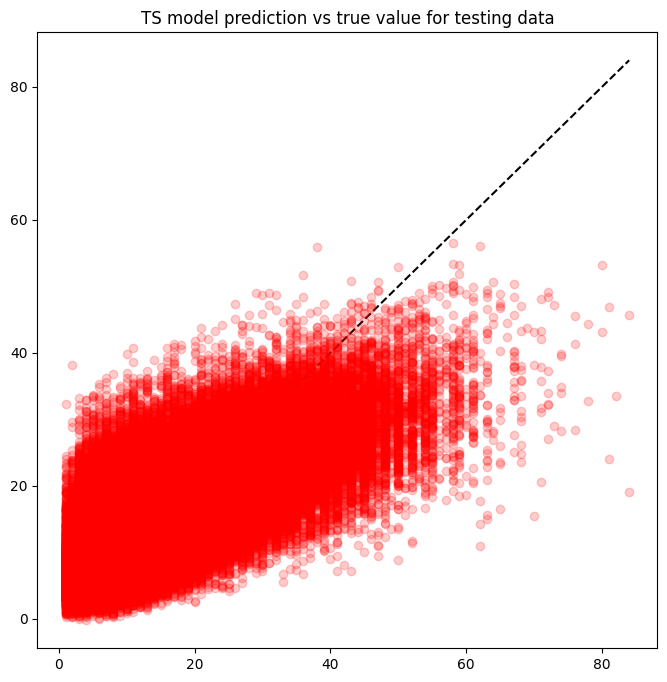

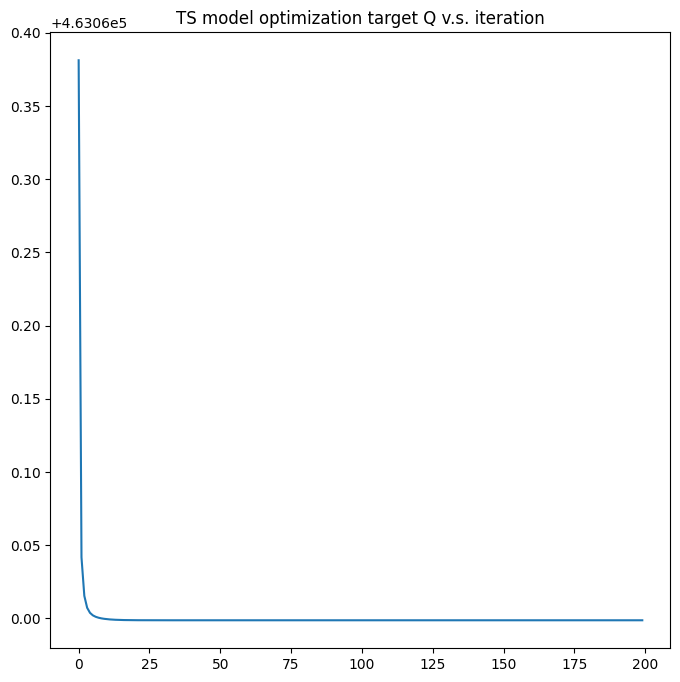

Epoch 1/50
16697/16697 [==============================] - 30s 2ms/step - loss: 42.7651 - root_mean_squared_error: 6.5395 - r_squared: 0.4671 - val_loss: 33.4676 - val_root_mean_squared_error: 5.7851 - val_r_squared: 0.3903
Epoch 2/50
16697/16697 [==============================] - 29s 2ms/step - loss: 32.8906 - root_mean_squared_error: 5.7350 - r_squared: 0.5853 - val_loss: 32.7537 - val_root_mean_squared_error: 5.7231 - val_r_squared: 0.3952
Epoch 3/50
16697/16697 [==============================] - 29s 2ms/step - loss: 32.2758 - root_mean_squared_error: 5.6812 - r_squared: 0.5926 - val_loss: 32.2264 - val_root_mean_squared_error: 5.6768 - val_r_squared: 0.3988
Epoch 4/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.9336 - root_mean_squared_error: 5.6510 - r_squared: 0.5967 - val_loss: 32.0657 - val_root_mean_squared_error: 5.6627 - val_r_squared: 0.4064
Epoch 5/50
16697/16697 [==============================] - 28s 2ms/step - loss: 31.7068 - root_mean_squared_e

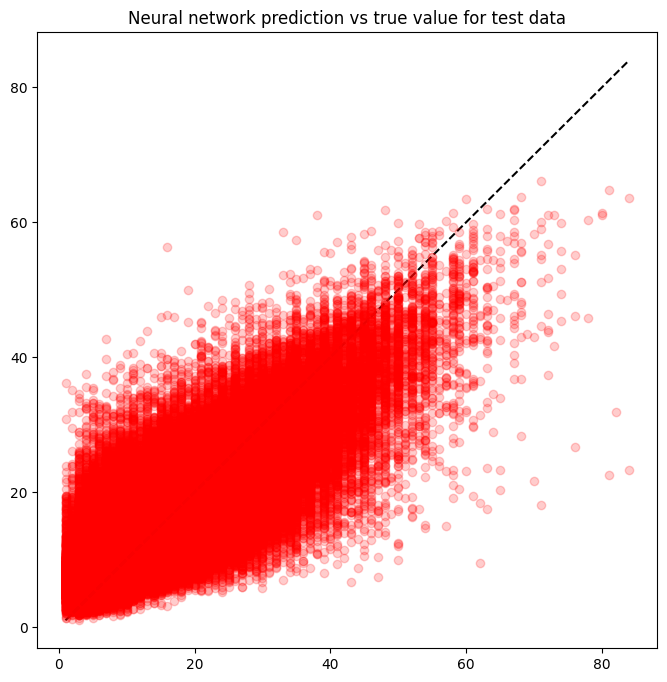

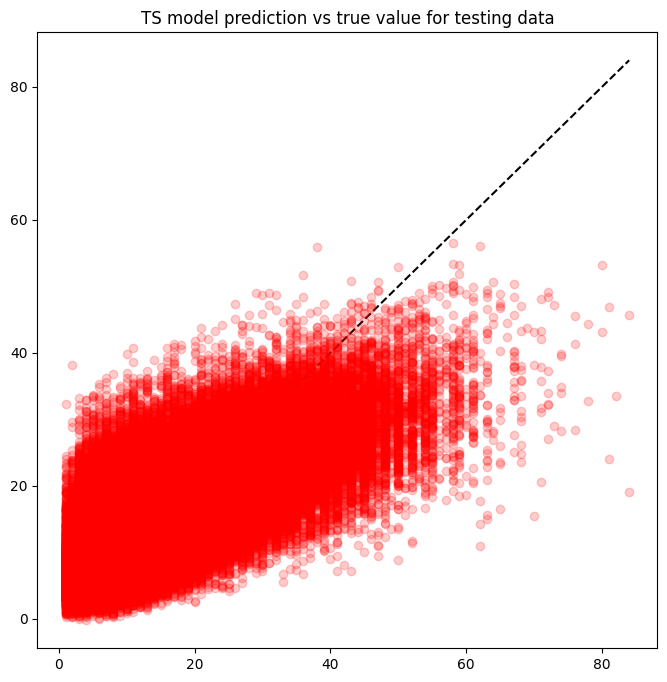

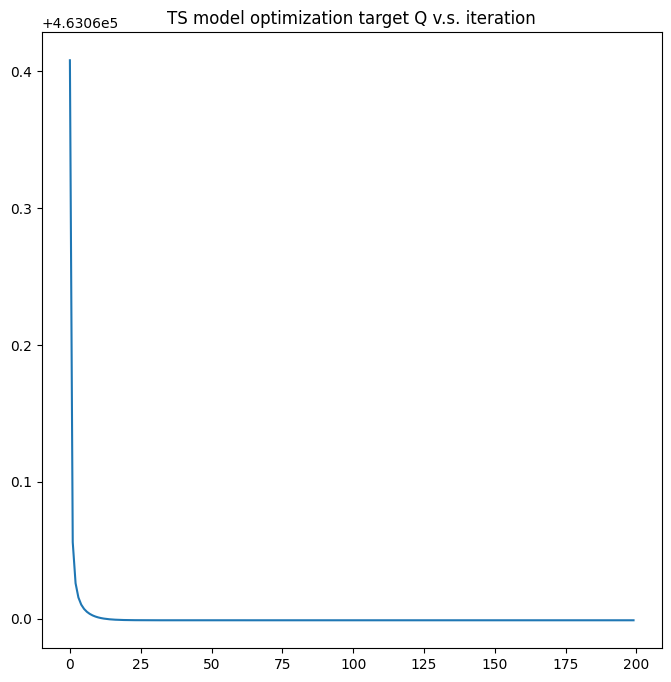

Epoch 1/50
16697/16697 [==============================] - 30s 2ms/step - loss: 42.5729 - root_mean_squared_error: 6.5248 - r_squared: 0.4692 - val_loss: 33.4680 - val_root_mean_squared_error: 5.7852 - val_r_squared: 0.3846
Epoch 2/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.8161 - root_mean_squared_error: 5.7285 - r_squared: 0.5870 - val_loss: 32.4821 - val_root_mean_squared_error: 5.6993 - val_r_squared: 0.4009
Epoch 3/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.1602 - root_mean_squared_error: 5.6710 - r_squared: 0.5944 - val_loss: 32.3892 - val_root_mean_squared_error: 5.6912 - val_r_squared: 0.4104
Epoch 4/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.8143 - root_mean_squared_error: 5.6404 - r_squared: 0.5974 - val_loss: 31.8048 - val_root_mean_squared_error: 5.6396 - val_r_squared: 0.4148
Epoch 5/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.6075 - root_mean_squared_e

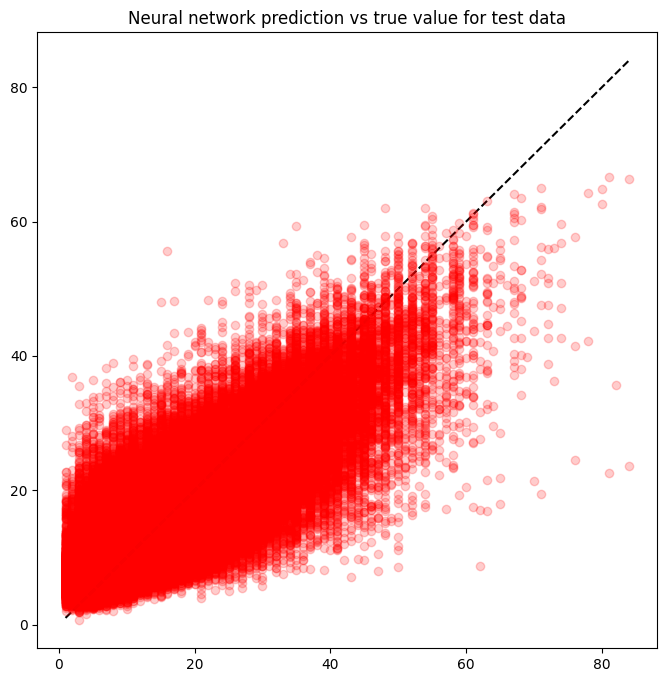

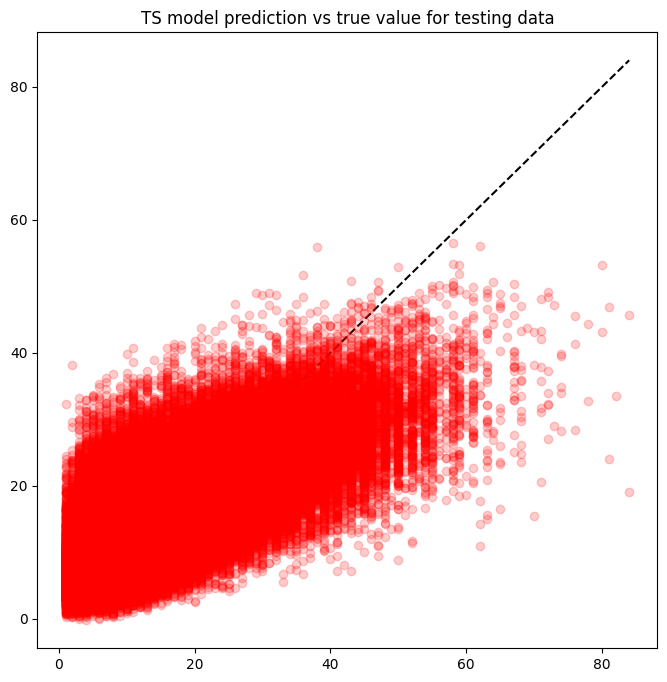

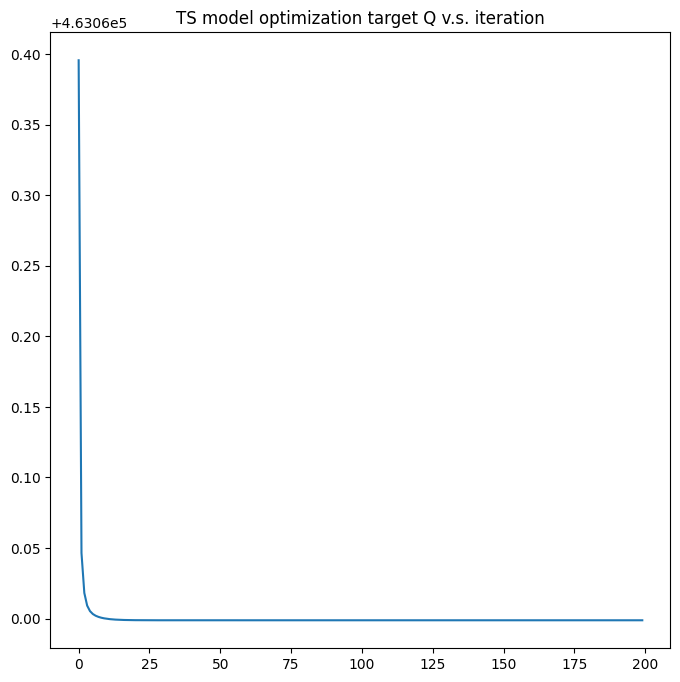

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 43.3223 - root_mean_squared_error: 6.5820 - r_squared: 0.4588 - val_loss: 33.4168 - val_root_mean_squared_error: 5.7807 - val_r_squared: 0.3899
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.7828 - root_mean_squared_error: 5.7256 - r_squared: 0.5875 - val_loss: 32.4906 - val_root_mean_squared_error: 5.7001 - val_r_squared: 0.3980
Epoch 3/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.1932 - root_mean_squared_error: 5.6739 - r_squared: 0.5934 - val_loss: 32.0732 - val_root_mean_squared_error: 5.6633 - val_r_squared: 0.4036
Epoch 4/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.8933 - root_mean_squared_error: 5.6474 - r_squared: 0.5963 - val_loss: 31.8757 - val_root_mean_squared_error: 5.6459 - val_r_squared: 0.4067
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.7191 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.6796 - root_mean_squared_error: 5.5389 - r_squared: 0.6105 - val_loss: 30.9149 - val_root_mean_squared_error: 5.5601 - val_r_squared: 0.4241
Epoch 39/50
16697/16697 [==============================] - 31s 2ms/step - loss: 30.6696 - root_mean_squared_error: 5.5380 - r_squared: 0.6101 - val_loss: 31.0205 - val_root_mean_squared_error: 5.5696 - val_r_squared: 0.4216
Epoch 40/50
16697/16697 [==============================] - 31s 2ms/step - loss: 30.6629 - root_mean_squared_error: 5.5374 - r_squared: 0.6108 - val_loss: 30.9559 - val_root_mean_squared_error: 5.5638 - val_r_squared: 0.4280
Epoch 41/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.6524 - root_mean_squared_error: 5.5365 - r_squared: 0.6105 - val_loss: 30.8241 - val_root_mean_squared_error: 5.5519 - val_r_squared: 0.4251
Epoch 42/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.6274 - root_mean_squa

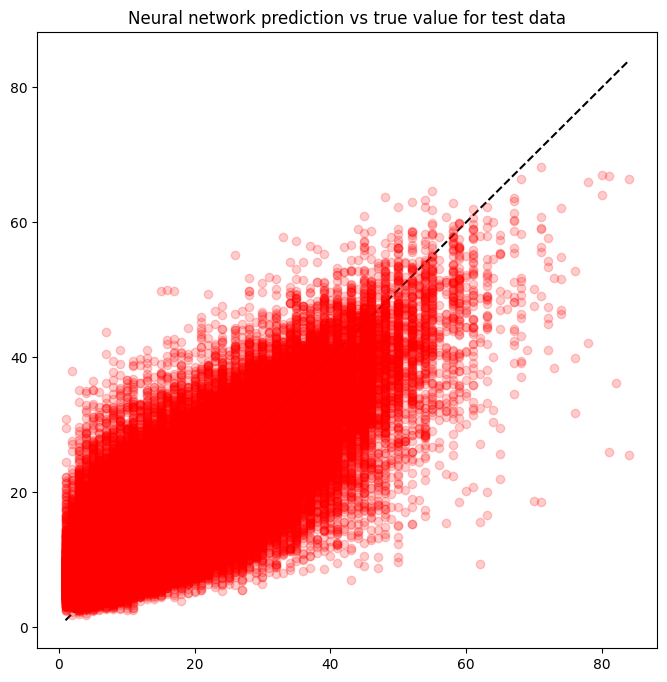

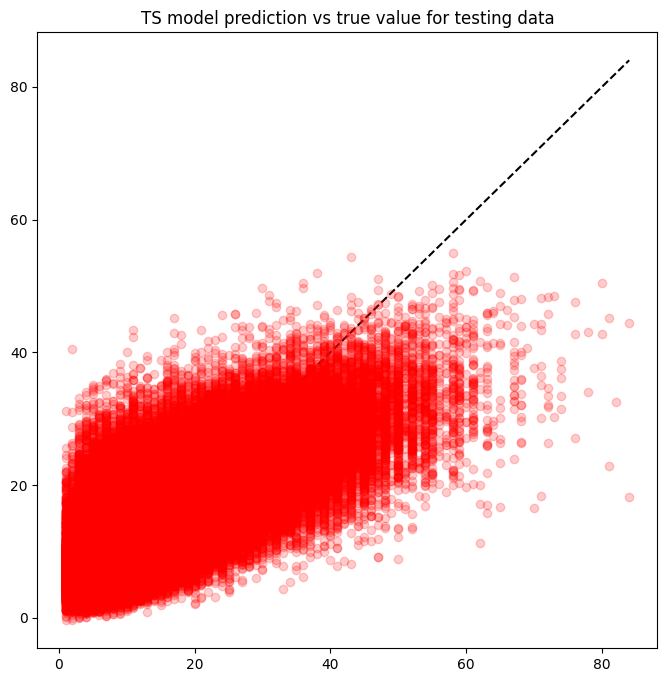

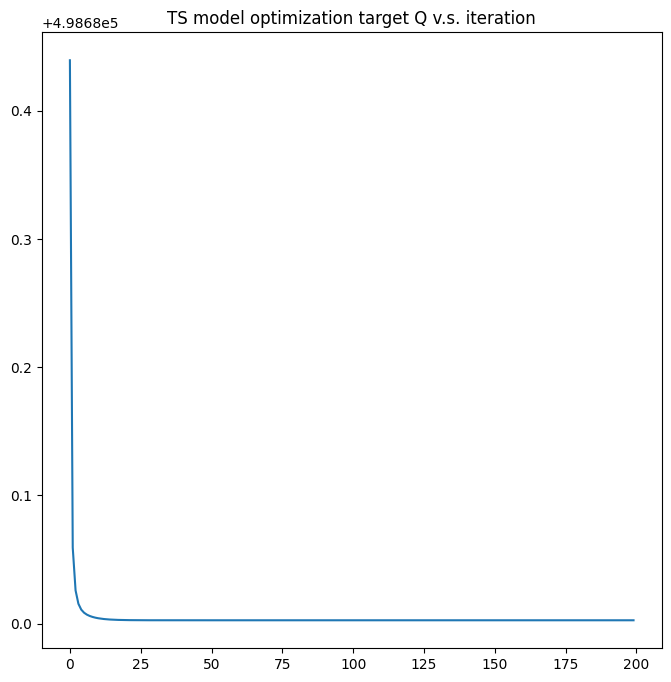

Epoch 1/50
16697/16697 [==============================] - 31s 2ms/step - loss: 42.7078 - root_mean_squared_error: 6.5351 - r_squared: 0.4695 - val_loss: 33.4253 - val_root_mean_squared_error: 5.7815 - val_r_squared: 0.3895
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.7588 - root_mean_squared_error: 5.7235 - r_squared: 0.5871 - val_loss: 32.3717 - val_root_mean_squared_error: 5.6896 - val_r_squared: 0.4029
Epoch 3/50
16697/16697 [==============================] - 29s 2ms/step - loss: 32.1234 - root_mean_squared_error: 5.6677 - r_squared: 0.5947 - val_loss: 31.9680 - val_root_mean_squared_error: 5.6540 - val_r_squared: 0.4073
Epoch 4/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.8494 - root_mean_squared_error: 5.6435 - r_squared: 0.5967 - val_loss: 31.8608 - val_root_mean_squared_error: 5.6445 - val_r_squared: 0.4097
Epoch 5/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.7129 - root_mean_squared_e

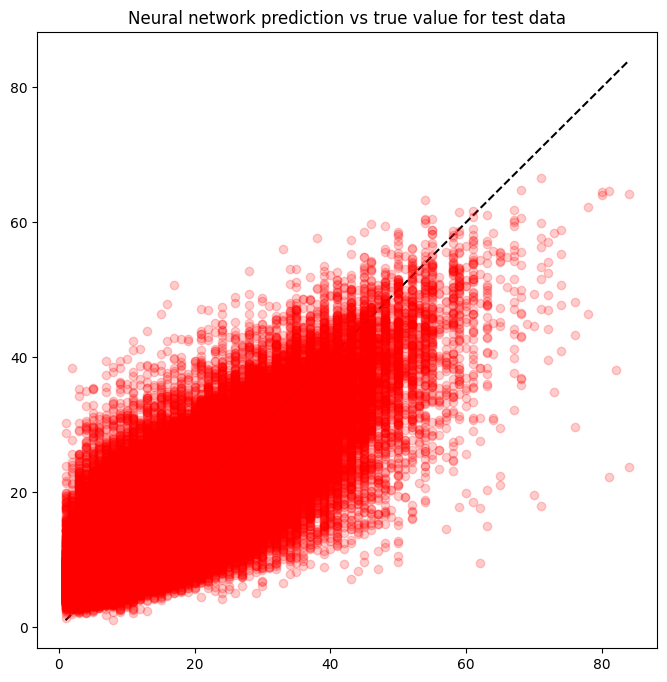

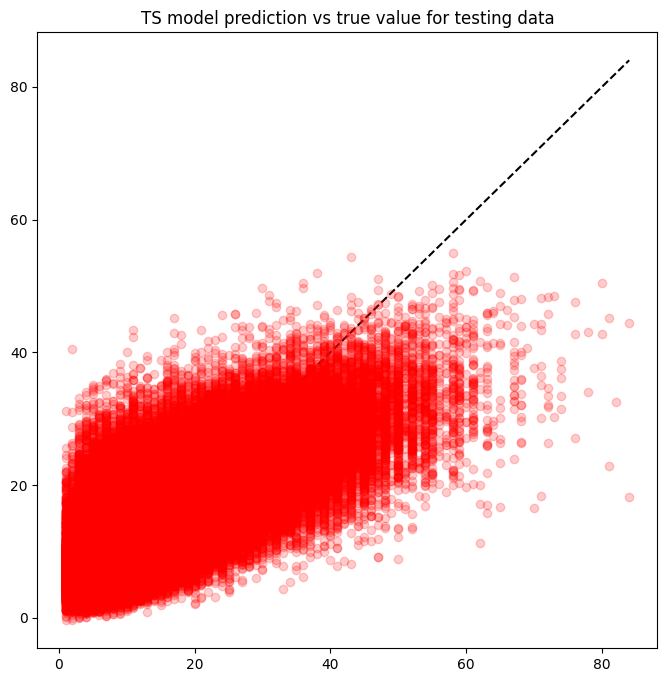

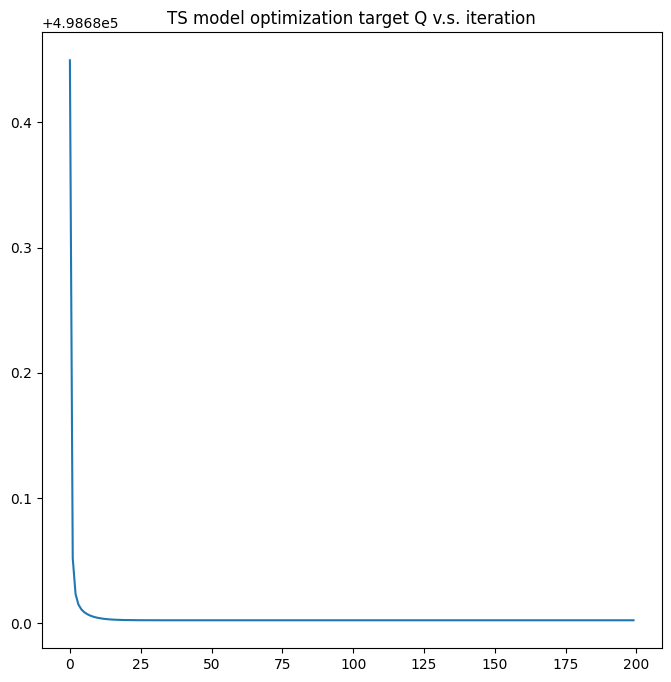

Epoch 1/50
16697/16697 [==============================] - 30s 2ms/step - loss: 43.1821 - root_mean_squared_error: 6.5713 - r_squared: 0.4614 - val_loss: 33.2525 - val_root_mean_squared_error: 5.7665 - val_r_squared: 0.3925
Epoch 2/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.7520 - root_mean_squared_error: 5.7229 - r_squared: 0.5871 - val_loss: 32.3477 - val_root_mean_squared_error: 5.6875 - val_r_squared: 0.4012
Epoch 3/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.1003 - root_mean_squared_error: 5.6657 - r_squared: 0.5947 - val_loss: 31.8746 - val_root_mean_squared_error: 5.6458 - val_r_squared: 0.4079
Epoch 4/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.8086 - root_mean_squared_error: 5.6399 - r_squared: 0.5976 - val_loss: 31.9482 - val_root_mean_squared_error: 5.6523 - val_r_squared: 0.4070
Epoch 5/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.6328 - root_mean_squared_e

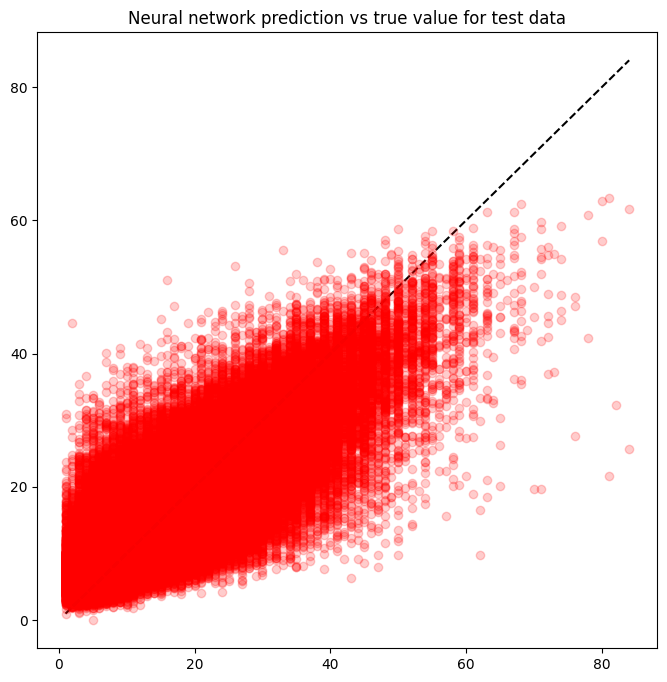

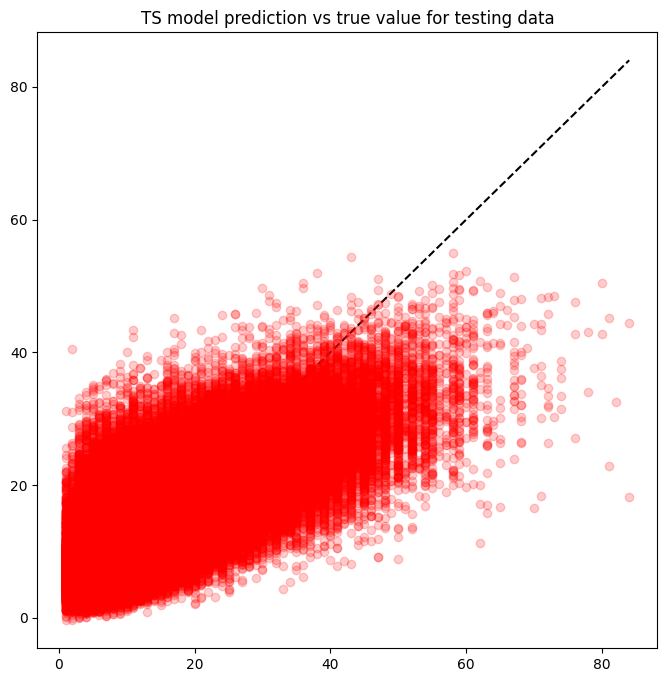

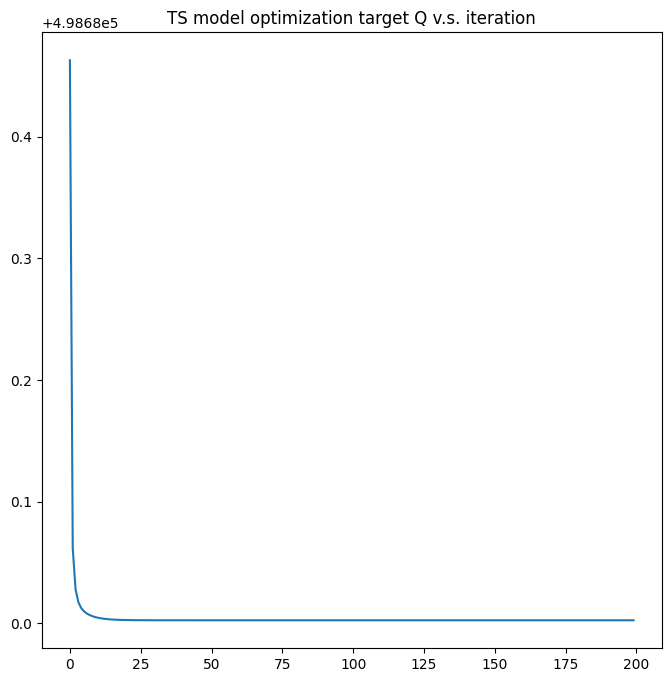

Epoch 1/50
16697/16697 [==============================] - 33s 2ms/step - loss: 42.9138 - root_mean_squared_error: 6.5509 - r_squared: 0.4642 - val_loss: 33.6671 - val_root_mean_squared_error: 5.8023 - val_r_squared: 0.3760
Epoch 2/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.9744 - root_mean_squared_error: 5.7423 - r_squared: 0.5842 - val_loss: 32.6604 - val_root_mean_squared_error: 5.7149 - val_r_squared: 0.3995
Epoch 3/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.2399 - root_mean_squared_error: 5.6780 - r_squared: 0.5934 - val_loss: 31.9972 - val_root_mean_squared_error: 5.6566 - val_r_squared: 0.4102
Epoch 4/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.8972 - root_mean_squared_error: 5.6478 - r_squared: 0.5976 - val_loss: 31.8240 - val_root_mean_squared_error: 5.6413 - val_r_squared: 0.4122
Epoch 5/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.7318 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 31s 2ms/step - loss: 30.8267 - root_mean_squared_error: 5.5522 - r_squared: 0.6092 - val_loss: 30.9835 - val_root_mean_squared_error: 5.5663 - val_r_squared: 0.4255
Epoch 39/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.8145 - root_mean_squared_error: 5.5511 - r_squared: 0.6083 - val_loss: 30.9574 - val_root_mean_squared_error: 5.5639 - val_r_squared: 0.4241
Epoch 40/50
16697/16697 [==============================] - 31s 2ms/step - loss: 30.8184 - root_mean_squared_error: 5.5514 - r_squared: 0.6086 - val_loss: 30.9664 - val_root_mean_squared_error: 5.5647 - val_r_squared: 0.4254
Epoch 41/50
16697/16697 [==============================] - 31s 2ms/step - loss: 30.7656 - root_mean_squared_error: 5.5467 - r_squared: 0.6090 - val_loss: 31.0507 - val_root_mean_squared_error: 5.5723 - val_r_squared: 0.4255
Epoch 42/50
16697/16697 [==============================] - 31s 2ms/step - loss: 30.7744 - root_mean_squa

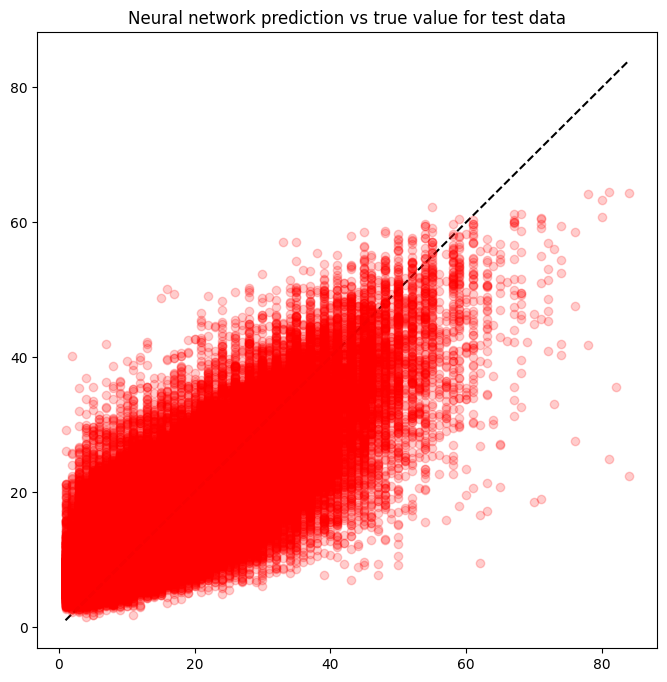

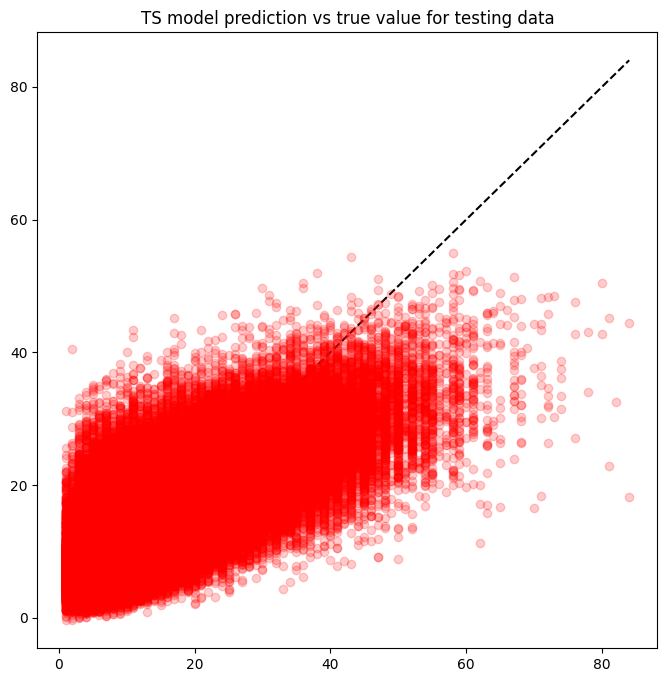

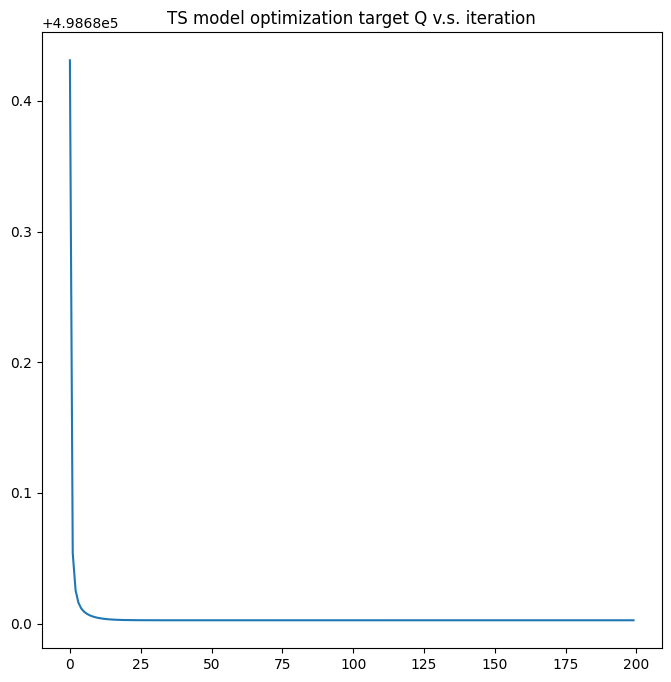

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 42.4694 - root_mean_squared_error: 6.5169 - r_squared: 0.4715 - val_loss: 33.3764 - val_root_mean_squared_error: 5.7772 - val_r_squared: 0.3897
Epoch 2/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.6549 - root_mean_squared_error: 5.7144 - r_squared: 0.5888 - val_loss: 32.2583 - val_root_mean_squared_error: 5.6796 - val_r_squared: 0.4081
Epoch 3/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.0104 - root_mean_squared_error: 5.6578 - r_squared: 0.5960 - val_loss: 32.0950 - val_root_mean_squared_error: 5.6652 - val_r_squared: 0.4054
Epoch 4/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.7434 - root_mean_squared_error: 5.6341 - r_squared: 0.5986 - val_loss: 31.8257 - val_root_mean_squared_error: 5.6414 - val_r_squared: 0.4086
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.5943 - root_mean_squared_e

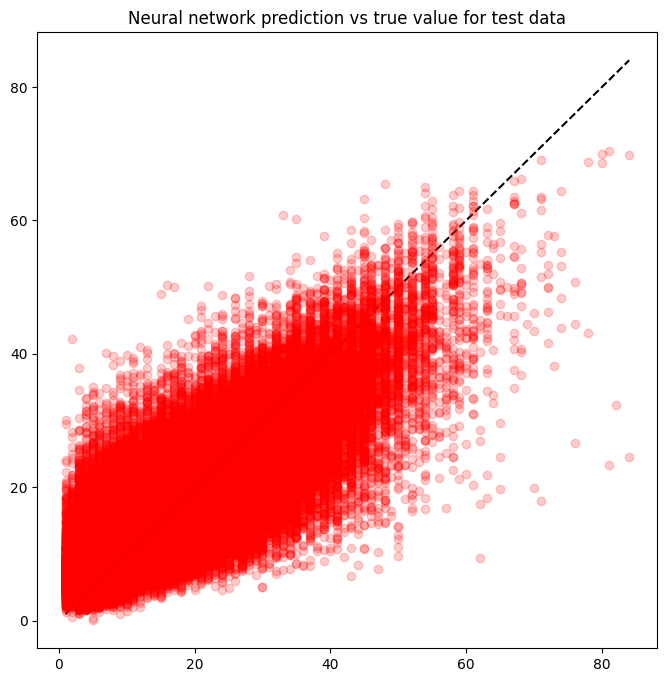

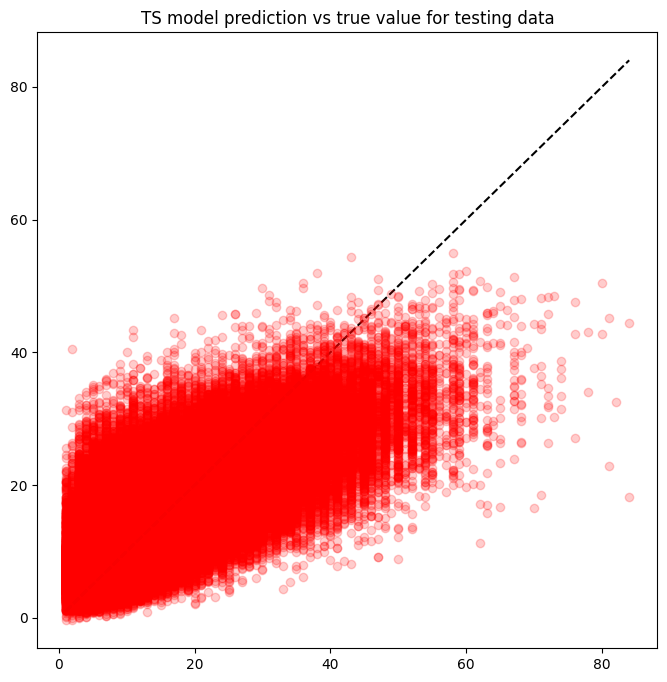

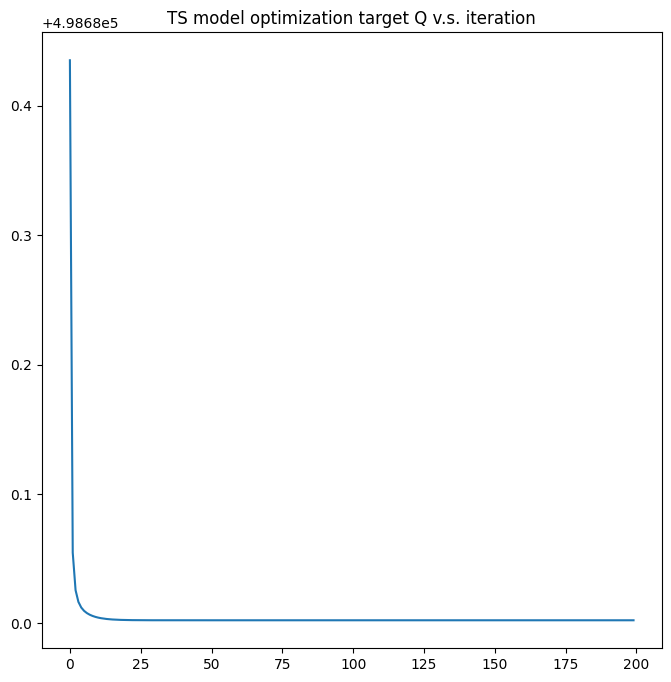

Epoch 1/50
16697/16697 [==============================] - 30s 2ms/step - loss: 43.9817 - root_mean_squared_error: 6.6319 - r_squared: 0.4523 - val_loss: 33.1451 - val_root_mean_squared_error: 5.7572 - val_r_squared: 0.3890
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.6144 - root_mean_squared_error: 5.7109 - r_squared: 0.5886 - val_loss: 32.4001 - val_root_mean_squared_error: 5.6921 - val_r_squared: 0.3990
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.0510 - root_mean_squared_error: 5.6614 - r_squared: 0.5950 - val_loss: 32.0255 - val_root_mean_squared_error: 5.6591 - val_r_squared: 0.4027
Epoch 4/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.8162 - root_mean_squared_error: 5.6406 - r_squared: 0.5976 - val_loss: 31.9700 - val_root_mean_squared_error: 5.6542 - val_r_squared: 0.4098
Epoch 5/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.6841 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 30s 2ms/step - loss: 30.6045 - root_mean_squared_error: 5.5321 - r_squared: 0.6121 - val_loss: 30.8434 - val_root_mean_squared_error: 5.5537 - val_r_squared: 0.4285
Epoch 39/50
16697/16697 [==============================] - 29s 2ms/step - loss: 30.5985 - root_mean_squared_error: 5.5316 - r_squared: 0.6127 - val_loss: 30.7295 - val_root_mean_squared_error: 5.5434 - val_r_squared: 0.4289
Epoch 40/50
16697/16697 [==============================] - 31s 2ms/step - loss: 30.5710 - root_mean_squared_error: 5.5291 - r_squared: 0.6119 - val_loss: 30.8075 - val_root_mean_squared_error: 5.5505 - val_r_squared: 0.4314
Epoch 41/50
16697/16697 [==============================] - 30s 2ms/step - loss: 30.5757 - root_mean_squared_error: 5.5295 - r_squared: 0.6118 - val_loss: 30.8085 - val_root_mean_squared_error: 5.5505 - val_r_squared: 0.4251
Epoch 42/50
16697/16697 [==============================] - 29s 2ms/step - loss: 30.5455 - root_mean_squa

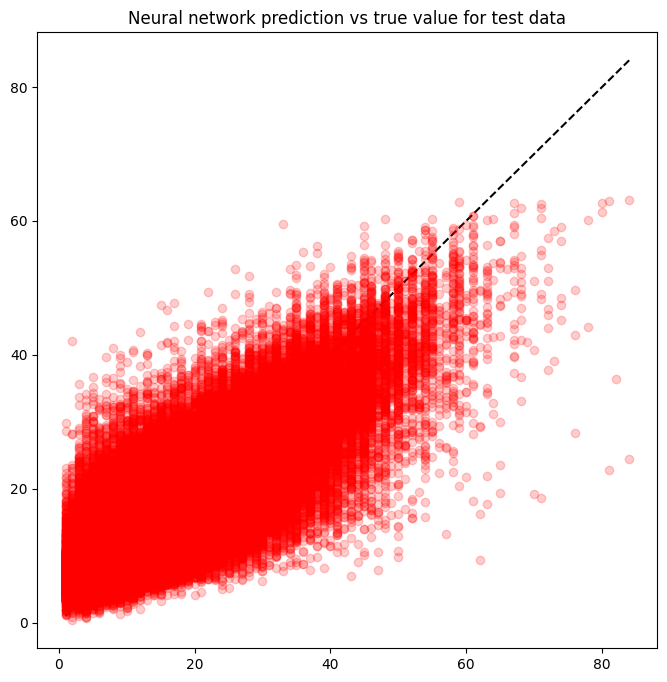

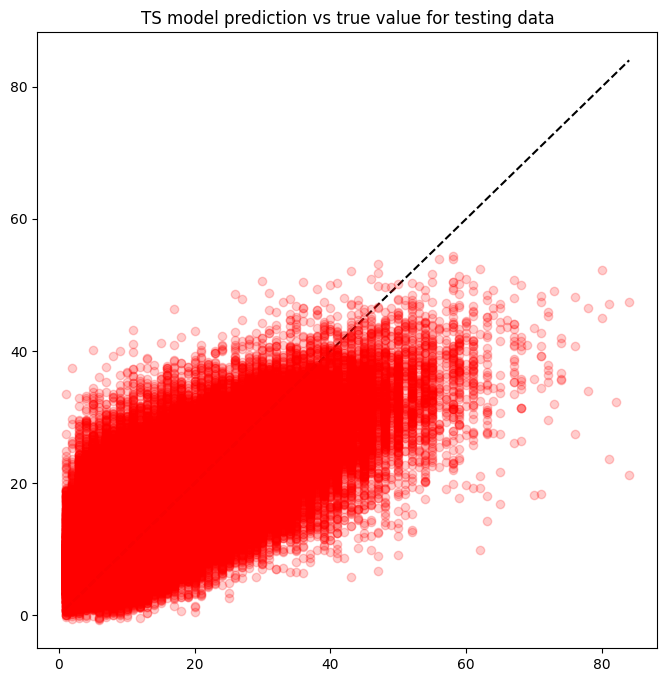

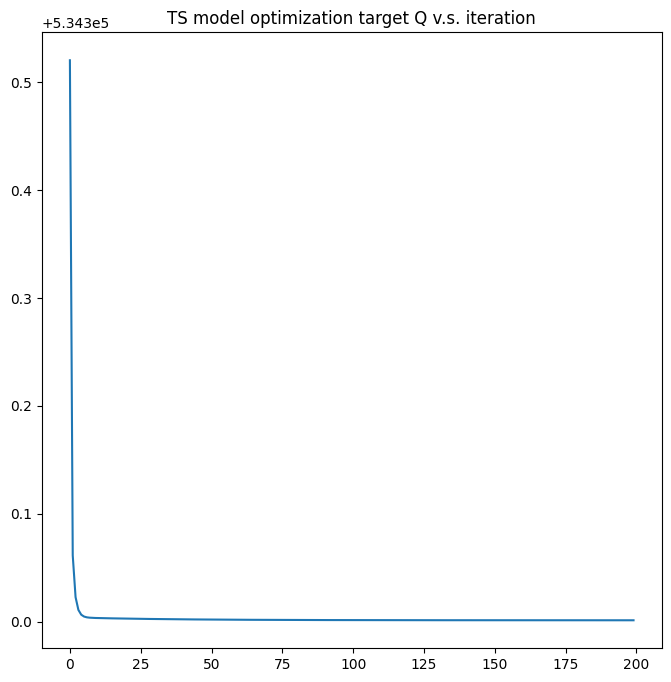

Epoch 1/50
16697/16697 [==============================] - 31s 2ms/step - loss: 43.4635 - root_mean_squared_error: 6.5927 - r_squared: 0.4572 - val_loss: 33.4664 - val_root_mean_squared_error: 5.7850 - val_r_squared: 0.3926
Epoch 2/50
16697/16697 [==============================] - 32s 2ms/step - loss: 32.8317 - root_mean_squared_error: 5.7299 - r_squared: 0.5848 - val_loss: 32.4858 - val_root_mean_squared_error: 5.6996 - val_r_squared: 0.4018
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.2092 - root_mean_squared_error: 5.6753 - r_squared: 0.5934 - val_loss: 32.1529 - val_root_mean_squared_error: 5.6704 - val_r_squared: 0.4012
Epoch 4/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.9279 - root_mean_squared_error: 5.6505 - r_squared: 0.5972 - val_loss: 31.8821 - val_root_mean_squared_error: 5.6464 - val_r_squared: 0.4111
Epoch 5/50
16697/16697 [==============================] - 32s 2ms/step - loss: 31.7406 - root_mean_squared_e

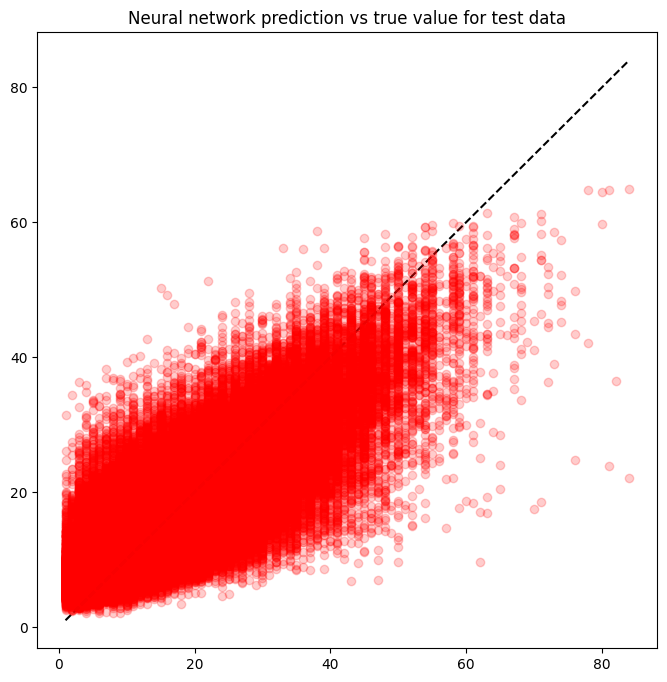

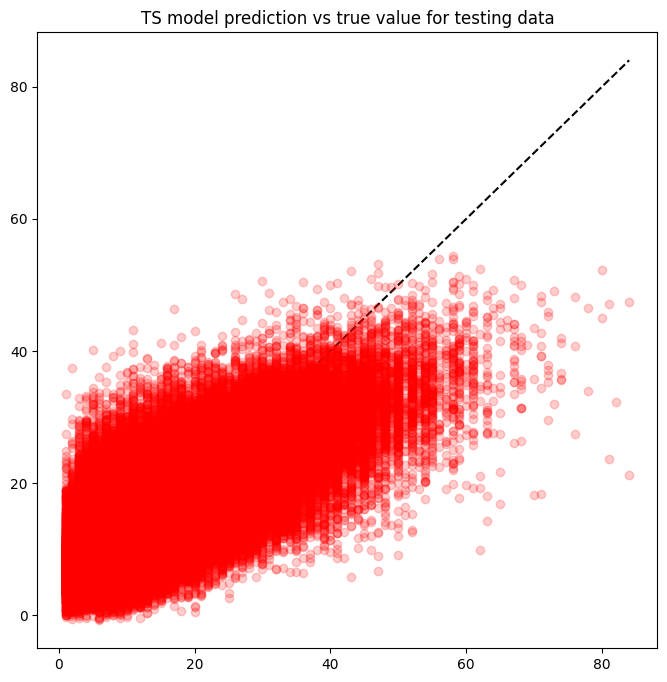

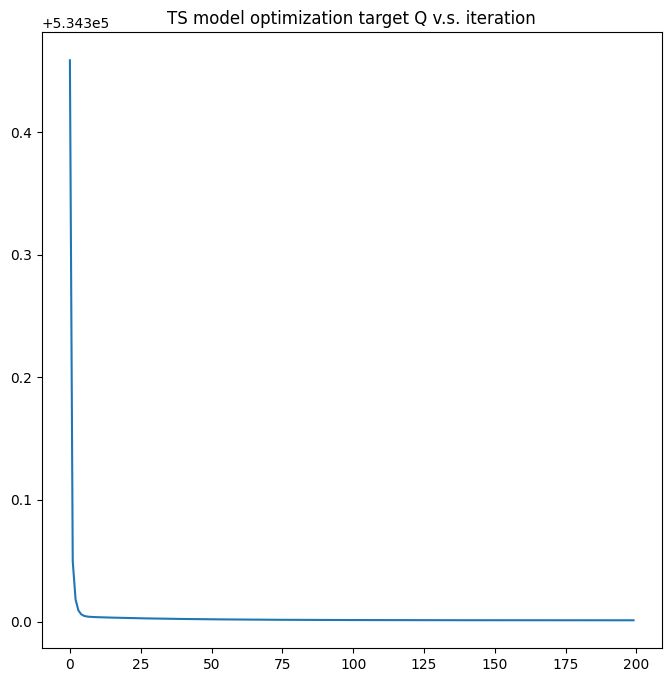

Epoch 1/50
16697/16697 [==============================] - 31s 2ms/step - loss: 43.1374 - root_mean_squared_error: 6.5679 - r_squared: 0.4616 - val_loss: 33.5800 - val_root_mean_squared_error: 5.7948 - val_r_squared: 0.3762
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.8348 - root_mean_squared_error: 5.7302 - r_squared: 0.5865 - val_loss: 32.4881 - val_root_mean_squared_error: 5.6998 - val_r_squared: 0.3955
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.1473 - root_mean_squared_error: 5.6699 - r_squared: 0.5947 - val_loss: 32.0955 - val_root_mean_squared_error: 5.6653 - val_r_squared: 0.4101
Epoch 4/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.8411 - root_mean_squared_error: 5.6428 - r_squared: 0.5971 - val_loss: 31.7260 - val_root_mean_squared_error: 5.6326 - val_r_squared: 0.4098
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.6821 - root_mean_squared_e

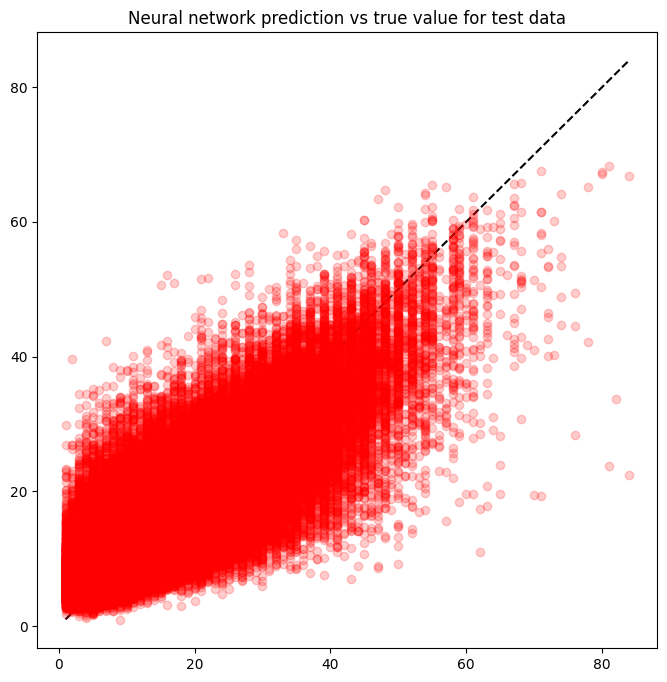

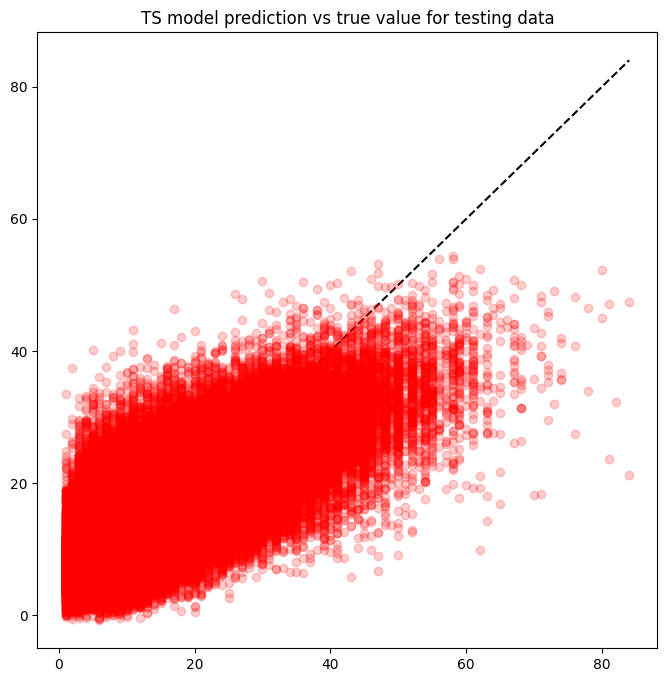

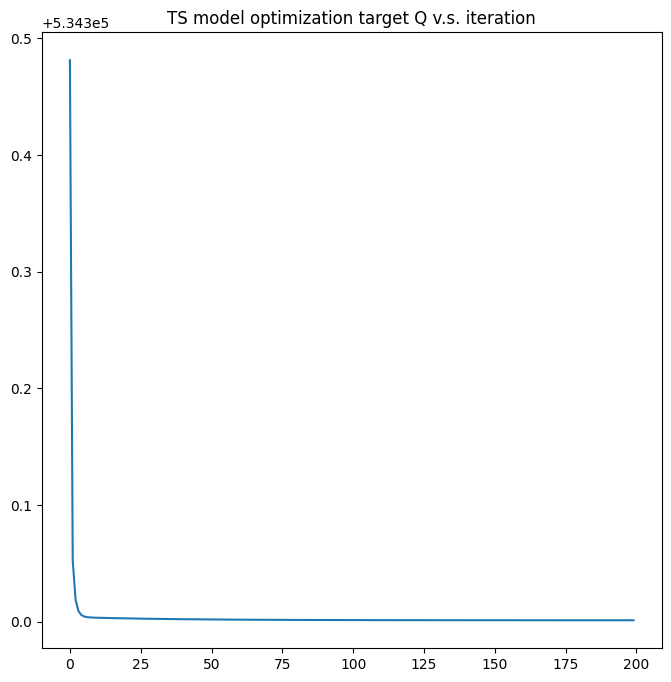

Epoch 1/50
16697/16697 [==============================] - 32s 2ms/step - loss: 43.5625 - root_mean_squared_error: 6.6002 - r_squared: 0.4579 - val_loss: 33.6373 - val_root_mean_squared_error: 5.7998 - val_r_squared: 0.3914
Epoch 2/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.9076 - root_mean_squared_error: 5.7365 - r_squared: 0.5855 - val_loss: 32.7818 - val_root_mean_squared_error: 5.7255 - val_r_squared: 0.4007
Epoch 3/50
16697/16697 [==============================] - 29s 2ms/step - loss: 32.2710 - root_mean_squared_error: 5.6808 - r_squared: 0.5927 - val_loss: 32.4395 - val_root_mean_squared_error: 5.6956 - val_r_squared: 0.3958
Epoch 4/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.9637 - root_mean_squared_error: 5.6536 - r_squared: 0.5960 - val_loss: 31.9557 - val_root_mean_squared_error: 5.6529 - val_r_squared: 0.4053
Epoch 5/50
16697/16697 [==============================] - 31s 2ms/step - loss: 31.7808 - root_mean_squared_e

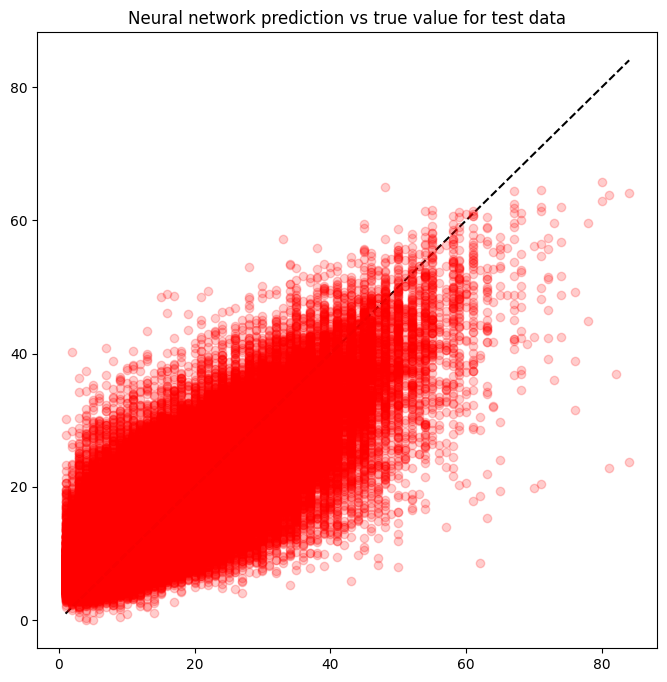

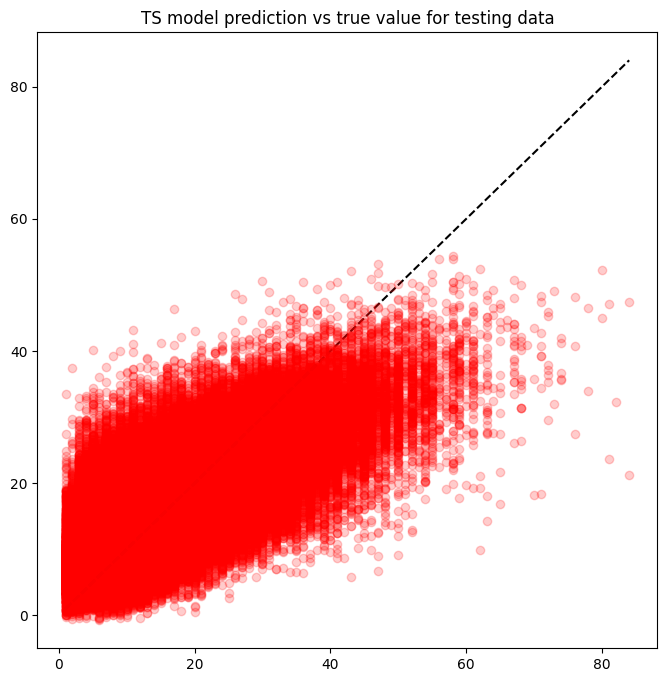

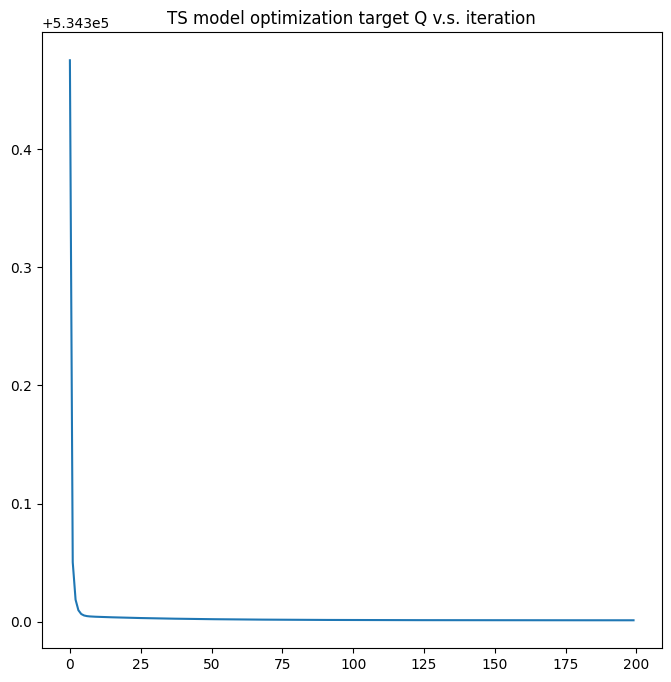

Epoch 1/50
16697/16697 [==============================] - 31s 2ms/step - loss: 43.2695 - root_mean_squared_error: 6.5780 - r_squared: 0.4602 - val_loss: 33.4533 - val_root_mean_squared_error: 5.7839 - val_r_squared: 0.3859
Epoch 2/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.6991 - root_mean_squared_error: 5.7183 - r_squared: 0.5878 - val_loss: 32.2978 - val_root_mean_squared_error: 5.6831 - val_r_squared: 0.4002
Epoch 3/50
16697/16697 [==============================] - 30s 2ms/step - loss: 32.0780 - root_mean_squared_error: 5.6637 - r_squared: 0.5947 - val_loss: 31.9379 - val_root_mean_squared_error: 5.6514 - val_r_squared: 0.4118
Epoch 4/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.8105 - root_mean_squared_error: 5.6401 - r_squared: 0.5978 - val_loss: 31.9139 - val_root_mean_squared_error: 5.6492 - val_r_squared: 0.4082
Epoch 5/50
16697/16697 [==============================] - 30s 2ms/step - loss: 31.6603 - root_mean_squared_e

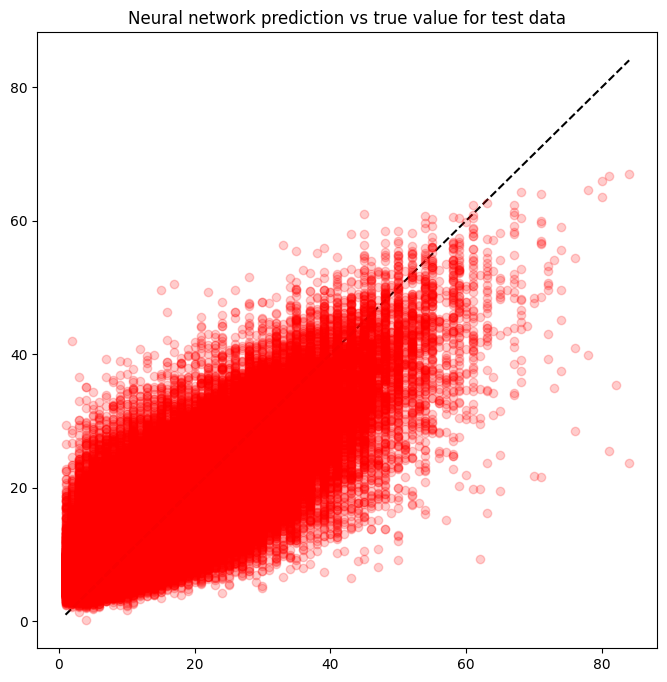

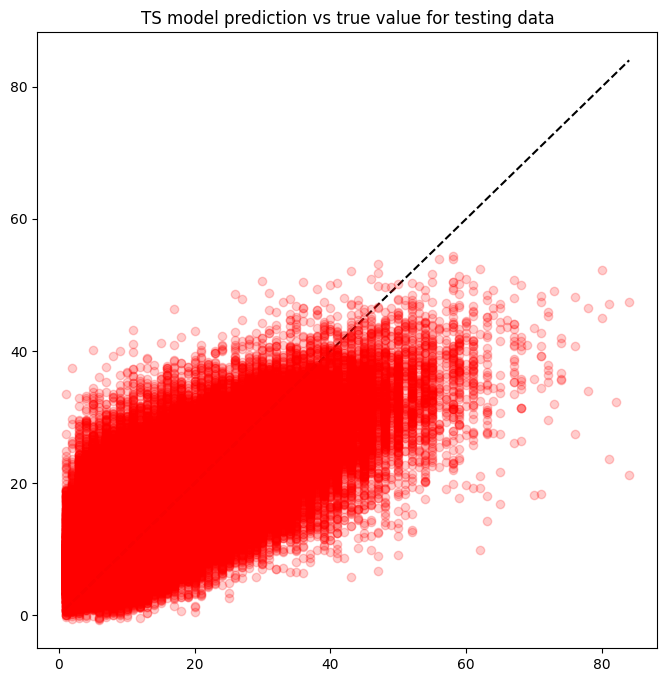

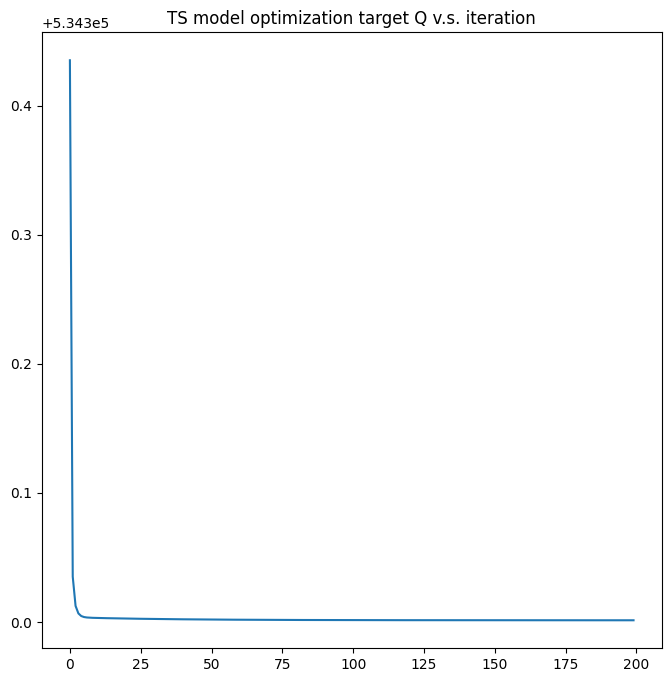

Epoch 1/50
16697/16697 [==============================] - 29s 2ms/step - loss: 42.7206 - root_mean_squared_error: 6.5361 - r_squared: 0.4693 - val_loss: 33.4663 - val_root_mean_squared_error: 5.7850 - val_r_squared: 0.3834
Epoch 2/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.8753 - root_mean_squared_error: 5.7337 - r_squared: 0.5858 - val_loss: 32.5672 - val_root_mean_squared_error: 5.7068 - val_r_squared: 0.4027
Epoch 3/50
16697/16697 [==============================] - 31s 2ms/step - loss: 32.1873 - root_mean_squared_error: 5.6734 - r_squared: 0.5948 - val_loss: 32.0639 - val_root_mean_squared_error: 5.6625 - val_r_squared: 0.4084
Epoch 4/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.8737 - root_mean_squared_error: 5.6457 - r_squared: 0.5963 - val_loss: 31.7776 - val_root_mean_squared_error: 5.6372 - val_r_squared: 0.4073
Epoch 5/50
16697/16697 [==============================] - 29s 2ms/step - loss: 31.6863 - root_mean_squared_e

Epoch 38/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.6581 - root_mean_squared_error: 5.5370 - r_squared: 0.6108 - val_loss: 31.0649 - val_root_mean_squared_error: 5.5736 - val_r_squared: 0.4238
Epoch 39/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.6353 - root_mean_squared_error: 5.5349 - r_squared: 0.6111 - val_loss: 30.8496 - val_root_mean_squared_error: 5.5542 - val_r_squared: 0.4263
Epoch 40/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.6182 - root_mean_squared_error: 5.5334 - r_squared: 0.6113 - val_loss: 30.9890 - val_root_mean_squared_error: 5.5668 - val_r_squared: 0.4241
Epoch 41/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.6082 - root_mean_squared_error: 5.5325 - r_squared: 0.6119 - val_loss: 30.7807 - val_root_mean_squared_error: 5.5480 - val_r_squared: 0.4274
Epoch 42/50
16697/16697 [==============================] - 32s 2ms/step - loss: 30.5860 - root_mean_squa

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

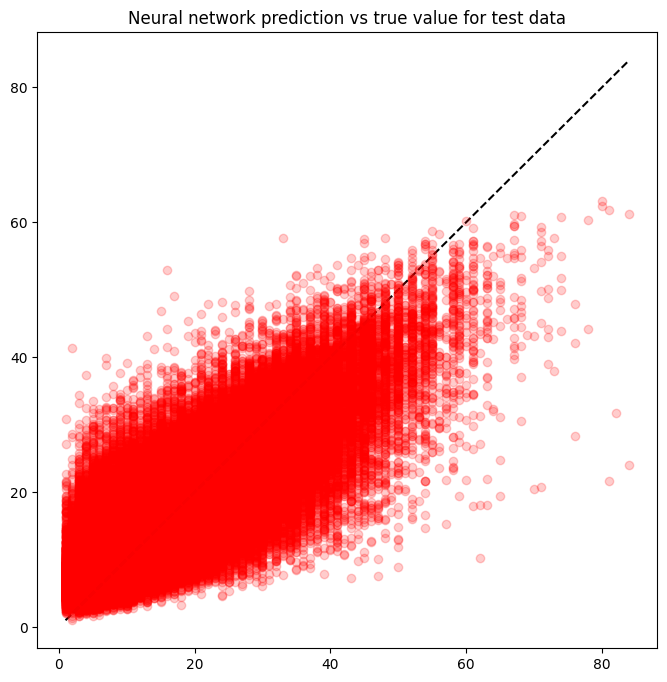

In [13]:
do_experiment(number_of_neighbour_stations, train_data, test_data)

In [3]:
training_results

NameError: name 'training_results' is not defined

exp
7.3231000900268555±0.0
7.0697±0.0016
7.127±0.0063
exp
7.1732001304626465±0.0
6.5871±0.0029
6.3975±0.0115
exp
7.019700050354004±0.0
6.4421±0.0166
5.9412±0.008
exp
6.906799793243408±0.0
6.6031±0.0277
5.78±0.0031
exp
6.777200222015381±0.0
6.7772±0.0
5.7138±0.005
exp
6.840400218963623±0.0
6.8404±0.0
5.6744±0.0061
exp
6.932799816131592±0.0
6.9328±0.0
5.64±0.0063
exp
6.945499897003174±0.0
6.9455±0.0
5.6283±0.0039
exp
6.74560022354126±0.0
6.7456±0.0
5.6088±0.0017
exp
6.809599876403809±0.0
6.8096±0.0
5.6074±0.005
exp
6.924200057983398±0.0
6.9242±0.0
5.6023±0.004
exp
6.903200149536133±0.0
6.9032±0.0
5.5962±0.0043
exp
6.746500015258789±0.0
6.7465±0.0
5.5828±0.0058
exp
6.725599765777588±0.0
6.7256±0.0
5.5884±0.0068
exp
6.784900188446045±0.0
6.4616±0.0
5.5917±0.005


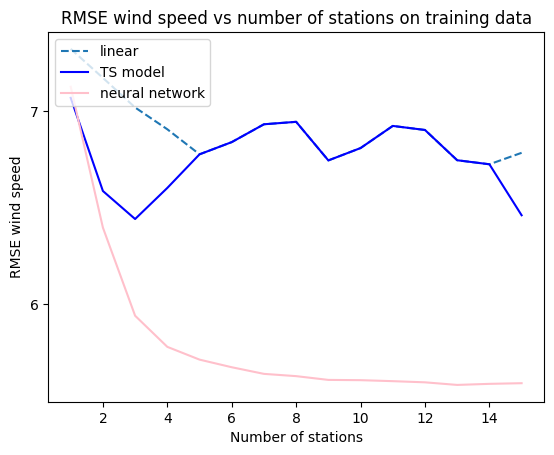

In [14]:
li_train_plot = []
fcm_train_plot = []
nn_train_plot = []
x_axis =  [1,2,3,4,5,6,7,8,9, 10,11,12,13,14, 15]
for exp in training_results:
     li_train_plot.append(np.mean([d['linear_train'] for d in exp if 'linear_train' in d]))
     fcm_train_plot.append(np.mean([d['fcm_train'] for d in exp if 'fcm_train' in d]))
     nn_train_plot.append(np.mean([d['nn_train'] for d in exp if 'nn_train' in d]))

# insert the optimal value from previous experiments 
# li_train_plot.insert(1, 6.7202)
# fcm_train_plot.insert(1, 6.6459)
# nn_train_plot.insert(1, 5.8963)

fig, ax = plt.subplots()
for axis in [ax.xaxis, ax.yaxis]:
    axis.set_major_locator(ticker.MaxNLocator(integer=True))
    
plt.plot(x_axis, li_train_plot, '--', label='linear')
plt.plot(x_axis, fcm_train_plot, label='TS model', c='blue')
plt.plot(x_axis, nn_train_plot, label='neural network', c='pink')
plt.legend(loc="upper left")
#plt.ylim(5)
plt.xlabel('Number of stations')
plt.ylabel('RMSE wind speed')
plt.title('RMSE wind speed vs number of stations on training data')

for exp in training_results:
    print('exp')
    print(f"{np.round(np.mean([d['linear_train'] for d in exp if 'linear_train' in d]), 4)}±{np.round(np.std([d['linear_train'] for d in exp if 'linear_train' in d]),4)}")
    print(f"{np.round(np.mean([d['fcm_train'] for d in exp if 'fcm_train' in d]), 4)}±{np.round(np.std([d['fcm_train'] for d in exp if 'fcm_train' in d]),4)}")
    print(f"{np.round(np.mean([d['nn_train'] for d in exp if 'nn_train' in d]), 4)}±{np.round(np.std([d['nn_train'] for d in exp if 'nn_train' in d]),4)}")


exp
7.332799911499023±0.0
7.0837±0.002
7.1308±0.0062
exp
7.180799961090088±0.0
6.5961±0.0026
6.3835±0.0109
exp
7.0304999351501465±0.0
6.4577±0.0165
5.9321±0.0081
exp
6.915299892425537±0.0
6.6199±0.0244
5.7712±0.0036
exp
6.783999919891357±0.0
6.784±0.0
5.7004±0.0065
exp
6.853300094604492±0.0
6.8533±0.0
5.6687±0.0054
exp
6.934899806976318±0.0
6.9349±0.0
5.6373±0.006
exp
6.954400062561035±0.0
6.9544±0.0
5.6256±0.003
exp
6.748300075531006±0.0
6.7483±0.0
5.6051±0.0017
exp
6.820300102233887±0.0
6.8203±0.0
5.6108±0.0055
exp
6.937900066375732±0.0
6.9379±0.0
5.6089±0.0051
exp
6.923600196838379±0.0
6.9236±0.0
5.6011±0.0042
exp
6.757699966430664±0.0
6.7577±0.0
5.5887±0.0065
exp
6.737199783325195±0.0
6.7372±0.0
5.5887±0.0062
exp
6.795400142669678±0.0
6.4678±0.0
5.5937±0.004


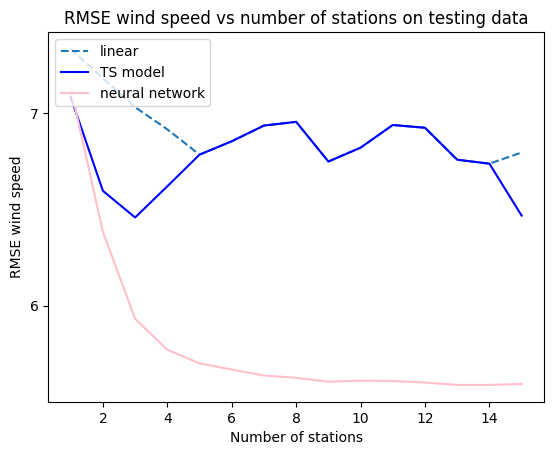

In [16]:
li_train_plot = []
fcm_train_plot = []
nn_train_plot = []
x_axis =  [1,2,3,4,5,6,7,8,9, 10,11,12,13,14, 15]
for exp in test_results:
     li_train_plot.append(np.mean([d['linear_test'] for d in exp if 'linear_test' in d]))
     fcm_train_plot.append(np.mean([d['fcm_test'] for d in exp if 'fcm_test' in d]))
     nn_train_plot.append(np.mean([d['nn_test'] for d in exp if 'nn_test' in d]))

fig, ax = plt.subplots()
for axis in [ax.xaxis, ax.yaxis]:
    axis.set_major_locator(ticker.MaxNLocator(integer=True))

# insert the optimal value from previous experiments 
# li_train_plot.insert(1, 6.7219)
# fcm_train_plot.insert(1, 6.6489)
# nn_train_plot.insert(1, 5.9011)


plt.plot(x_axis, li_train_plot, '--', label='linear')
plt.plot(x_axis, fcm_train_plot, label='TS model', c='blue')
plt.plot(x_axis, nn_train_plot, label='neural network', c='pink')
plt.legend(loc="upper left")
#plt.ylim(5)
plt.xlabel('Number of stations')
plt.ylabel('RMSE wind speed')
plt.title('RMSE wind speed vs number of stations on testing data')

for exp in test_results:
    print('exp')
    print(f"{np.round(np.mean([d['linear_test'] for d in exp if 'linear_test' in d]), 4)}±{np.round(np.std([d['linear_test'] for d in exp if 'linear_test' in d]),4)}")
    print(f"{np.round(np.mean([d['fcm_test'] for d in exp if 'fcm_test' in d]), 4)}±{np.round(np.std([d['fcm_test'] for d in exp if 'fcm_test' in d]),4)}")
    print(f"{np.round(np.mean([d['nn_test'] for d in exp if 'nn_test' in d]), 4)}±{np.round(np.std([d['nn_test'] for d in exp if 'nn_test' in d]),4)}")


In [49]:
training_times[9]

[{'linear_train': 1.233834981918335},
 {'fcm_train': 168.52606558799744},
 {'nn_train': 1426.8141462802887},
 {'linear_train': 1.1243205070495605},
 {'fcm_train': 167.27157425880432},
 {'nn_train': 1418.7499465942383},
 {'linear_train': 1.1265807151794434},
 {'fcm_train': 168.77304100990295},
 {'nn_train': 1422.0740575790405},
 {'linear_train': 1.1239032745361328},
 {'fcm_train': 167.49027013778687},
 {'nn_train': 1422.0440649986267},
 {'linear_train': 1.1374692916870117},
 {'fcm_train': 167.3704378604889},
 {'nn_train': 1425.1562218666077},
 {'linear_train': 1.1460168361663818},
 {'fcm_train': 167.51256680488586},
 {'nn_train': 1423.4568648338318},
 {'linear_train': 1.1390972137451172},
 {'fcm_train': 167.8305516242981},
 {'nn_train': 1410.3228833675385},
 {'linear_train': 1.2554047107696533},
 {'fcm_train': 167.51797580718994},
 {'nn_train': 1415.3795566558838},
 {'linear_train': 1.1346375942230225},
 {'fcm_train': 167.81351947784424},
 {'nn_train': 1423.5536696910858},
 {'linear_tra

[0.05779542922973633, 0.10512628555297851, 0.18140747547149658, 0.257893967628479, 0.3837465763092041, 0.46598703861236573, 0.5797907590866089, 0.7263056039810181, 0.9430693864822388, 1.158401608467102, 1.3563196659088135, 1.5057610273361206]
[131.03713357448578, 109.08597023487091, 116.40648560523987, 123.42344617843628, 127.10050435066223, 135.3686448097229, 141.49408173561096, 150.10453343391418, 158.57835369110109, 167.88107867240905, 177.2185900449753, 186.64140989780427]
[1611.671659898758, 1415.5011890411376, 1420.4644891500473, 1419.133735704422, 1420.8603631973267, 1410.7465843439102, 1394.5273993253709, 1394.9660172224044, 1414.7745237350464, 1419.8697877645493, 1412.235040140152, 1381.624940085411]


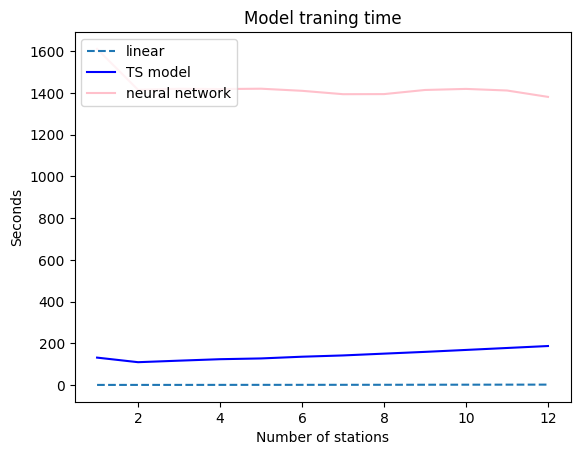

In [34]:
li_time_plot = []
fcm_time_plot = []
nn_time_plot = []
x_axis =  [1,2,3,4,5,6,7,8,9, 10, 11, 12]
for exp in training_times:
    li_time_plot.append(np.mean([d['linear_train'] for d in exp if 'linear_train' in d]))
    fcm_time_plot.append(np.mean([d['fcm_train'] for d in exp if 'fcm_train' in d]))
    nn_time_plot.append(np.mean([d['nn_train'] for d in exp if 'nn_train' in d]))

fig, ax = plt.subplots()
for axis in [ax.xaxis, ax.yaxis]:
    axis.set_major_locator(ticker.MaxNLocator(integer=True))
    
plt.plot(x_axis, li_time_plot, '--', label='linear')
plt.plot(x_axis, fcm_time_plot, label='TS model', c='blue')
plt.plot(x_axis, nn_time_plot, label='neural network', c='pink')
plt.legend(loc="upper left")
plt.xlabel('Number of stations')
plt.ylabel('Seconds')
plt.title('Model traning time')

print(li_time_plot)
print(fcm_time_plot)
print(nn_time_plot)

Text(0.5, 1.0, 'Loss vs number of epoches')

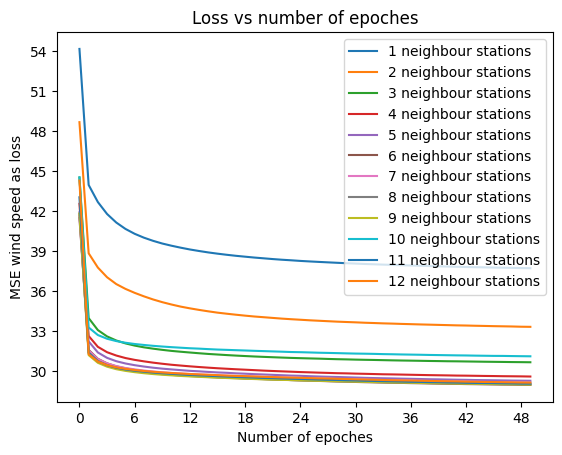

In [35]:
i = 1
fig, ax = plt.subplots()
for axis in [ax.xaxis, ax.yaxis]:
    axis.set_major_locator(ticker.MaxNLocator(integer=True))

for exp in nn_histories:
    nn_losses = []
    for fold in exp:
        nn_losses.append(fold['loss'])
    plt.plot(np.mean(nn_losses, axis=0), label=f"{i} neighbour stations")
    i = i+1


plt.legend(loc="upper right")
#plt.ylim(5)
plt.xlabel('Number of epoches')
plt.ylabel('MSE wind speed as loss')
plt.title('Loss vs number of epoches')

In [3]:
opt_x = pd.read_csv('Data/exp/5x_test.csv', index_col=0)
opt_y = pd.read_csv('Data/exp/5y_test.csv', index_col=0)

FCM traning RMSE: 8.16315534435806
FCM traning RMSE: 8.083711986919232
FCM traning RMSE: 7.970060591501671
FCM traning RMSE: 7.906636302399481
FCM traning RMSE: 7.878282731463363
FCM traning RMSE: 7.811867918051072
FCM traning RMSE: 7.733882628446361
FCM traning RMSE: 7.777428323862338
FCM traning RMSE: 7.714776222888085
FCM traning RMSE: 7.697975175523951
FCM traning RMSE: 7.681360151544759
FCM traning RMSE: 7.6623961272263
FCM traning RMSE: 7.6535745643432405


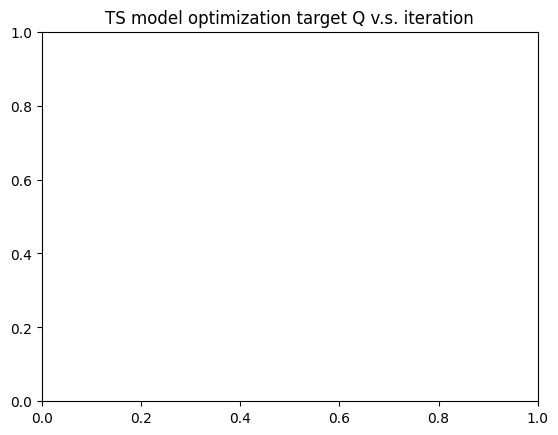

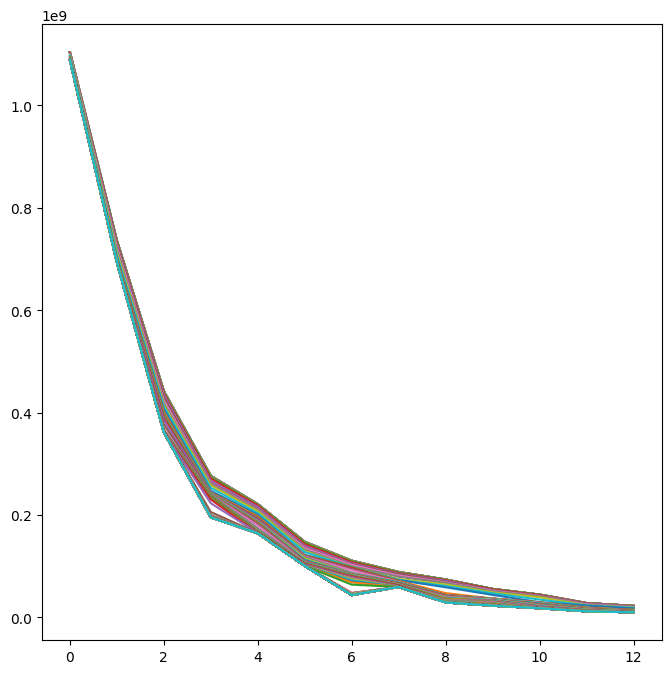

In [4]:
# Plot Q vs # of Nc
# Fcm hyperparameters
FCM_Ncs = [2,3,5,8,10,15,20,25,30,40,50,80,100]
FCM_m = 2
#tol = 1e-5
max_iter = 200
qs = []

for FCM_Nc in FCM_Ncs:   
    N = opt_x.shape[0]
    U = np.random.rand(N, FCM_Nc)
    U = U / np.sum(U, axis=1, keepdims=True)
    temp_qs = []

    # Fuzzy C-Means 聚类
    for _ in range(max_iter):
        U_old = U.copy()
        mf = U ** FCM_m
        cen = np.dot(mf.T, opt_x) / np.sum(mf, axis=0, keepdims=True).T
        dists = cdist(opt_x, cen)
        tmp = np.power(dists, -2 / (FCM_m - 1))
        U = tmp / np.sum(tmp, axis=1, keepdims=True)

        q = np.sum((U ** FCM_m) * (dists ** 2))
        temp_qs.append(q)

        # 检查是否收敛
#         if np.linalg.norm(U - U_old) < tol:
#             break
    # 模型训练 find if this can be optimized
    z = np.hstack((np.ones((N, 1)), opt_x))
    H = np.zeros((N, FCM_Nc * (opt_x.shape[1] + 1)))

    # 生成模糊规则矩阵 H
    for j in range(FCM_Nc):
        Uj = np.tile(U[:, j], (opt_x.shape[1] + 1, 1)).T
        H[:, (j * (opt_x.shape[1] + 1)):((j + 1) * (opt_x.shape[1] + 1))] = Uj * z

    # 计算权重 W
    W = pinv(np.dot(H.T, H)).dot(H.T).dot(opt_y)

        
    # 在训练集上进行预测
    y_hat_train = np.dot(H, W)
    mse_train = mean_squared_error(opt_y, y_hat_train)
    rmse_train = sqrt(mean_squared_error(opt_y, y_hat_train))
    print("FCM traning RMSE:", rmse_train)
    qs.append(temp_qs)
    
plt.title('TS model optimization target Q v.s. iteration')
plt.figure(figsize=(8,8))
plt.plot(qs)

Text(0.5, 1.0, 'TS model optimization target Q v.s. iteration for differenct number of rules')

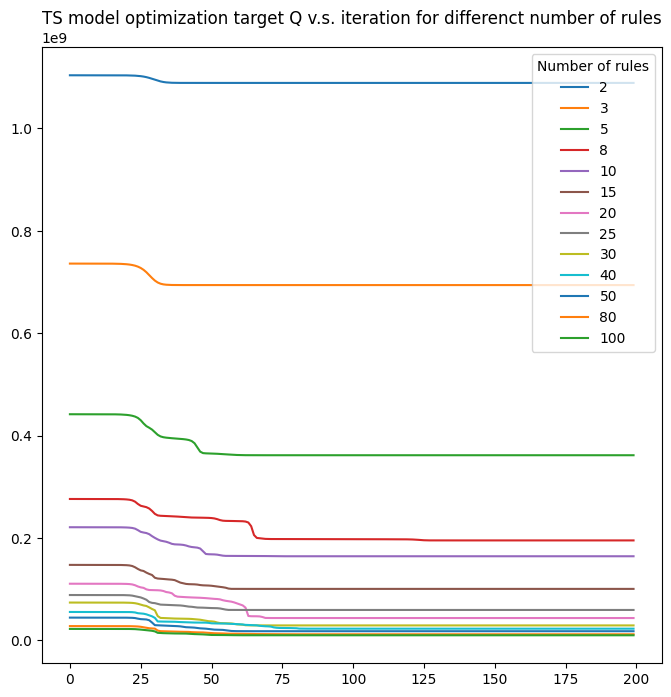

In [6]:
plt.figure(figsize=(8,8))

for exp in qs:
    plt.plot(exp)

plt.legend(FCM_Ncs, title="Number of rules")
plt.title('TS model optimization target Q v.s. iteration for differenct number of rules')